In [1]:
import os
import nibabel as nib  # pip install nibabel
import numpy as np
import pandas as pd
from tqdm import tqdm  # pip install tqdm
import matplotlib.pyplot as plt
from nilearn import datasets, image, plotting
import seaborn as sns

from scipy.interpolate import RegularGridInterpolator
from scipy.spatial.transform import Rotation as R
from scipy.ndimage import zoom, distance_transform_edt #, median_filter
from scipy.signal import medfilt2d, gaussian
from skimage.morphology import area_closing
from statsmodels.stats.anova import AnovaRM
from sklearn.metrics import roc_auc_score

import pickle

import importlib.util

import data_metrics as data_metrics
import mri_utils
import TCGA_utils
import nii_utils
from nilearn import datasets, image, plotting
from copy import deepcopy
from datetime import datetime
from hashlib import blake2s

import sys ## allow for imports from shared tree
script_path = os.path.realpath(os.path.dirname(__name__))
os.chdir(script_path)
sys.path.append("..")

from contralateral_code.mri_reg import ms_affreg, resize_template,vox_coords
from dipy.align.reslice import (affine_transform)



# import tensorflow as tf
# import tensorflow.keras as keras


/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/nilearn/datasets/__init__.py:89: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  "Numpy arrays.", FutureWarning)
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/dipy/viz/__init__.py:32: UserWarning: You do not have FURY installed. Some visualization functions might not work for you. For installation instructions, please visit: https://fury.gl/
  "You do not have FURY installed. "


In [2]:
root_dir = os.path.join('..')
orig_data_dir =  os.path.join(root_dir,'..','GBM_LGG_tradeoffs','data')
nii_dir = os.path.join(orig_data_dir,'image_data','GBM')

p_dirs = []
patients = []
for root, dirs, files in os.walk(nii_dir):
    for dn in dirs:
        patients.append(dn)
        p_dirs.append(os.path.join(root,dn))

In [3]:
print(patients)
print(p_dirs[0])

['TCGA-06-0138', 'TCGA-14-3477', 'TCGA-06-0240', 'TCGA-76-6664', 'TCGA-12-3650', 'TCGA-19-5958', 'TCGA-02-0068', 'TCGA-06-5413', 'TCGA-12-0829', 'TCGA-08-0512', 'TCGA-06-0162', 'TCGA-06-6389', 'TCGA-06-0187', 'TCGA-12-0616', 'TCGA-19-0963', 'TCGA-02-0087', 'TCGA-19-2624', 'TCGA-02-0070', 'TCGA-02-0069', 'TCGA-02-0011', 'TCGA-02-0116', 'TCGA-76-6663', 'TCGA-06-5408', 'TCGA-02-0009', 'TCGA-06-0182', 'TCGA-06-0188', 'TCGA-06-0176', 'TCGA-76-4932', 'TCGA-06-0139', 'TCGA-02-0059', 'TCGA-08-0360', 'TCGA-76-4935', 'TCGA-06-2570', 'TCGA-02-0086', 'TCGA-19-1789', 'TCGA-06-0184', 'TCGA-06-0145', 'TCGA-76-6285', 'TCGA-76-6661', 'TCGA-76-6656', 'TCGA-02-0006', 'TCGA-08-0355', 'TCGA-06-0164', 'TCGA-02-0106', 'TCGA-02-0027', 'TCGA-06-0137', 'TCGA-06-0179', 'TCGA-06-0190', 'TCGA-76-6191', 'TCGA-76-6657', 'TCGA-08-0385', 'TCGA-06-0154', 'TCGA-02-0075', 'TCGA-19-5960', 'TCGA-19-2631', 'TCGA-06-0122', 'TCGA-02-0046', 'TCGA-08-0356', 'TCGA-14-1794', 'TCGA-08-0389', 'TCGA-06-0177', 'TCGA-08-0520', 'TCGA-0

In [148]:
outImDir = os.path.join(root_dir,'data','images','atlases')
outRegDir = os.path.join(root_dir,'data','registration')

if not os.path.exists(outImDir):
    os.makedirs(outImDir)
if not os.path.exists(outRegDir):
    os.makedirs(outRegDir)
    
### https://nilearn.github.io/modules/generated/nilearn.datasets.load_mni152_template.html
# template_img = datasets.load_mni152_template()
orig_template = datasets.load_mni152_template()
template_img = orig_template
# orig_zooms = orig_template.header.get_zooms()[:3]
rerunAffine = False


imagedir = nii_dir

for pNo in range(1,2):
    pDir = patients[pNo]
    cDir = os.path.join(imagedir,pDir)
    
    (lbl_nib, imNibDict) = nii_utils.load_patient(cDir)
#     if not os.path.exists(cNIIFile):
#         continue
    TCGA_ID = os.path.basename(pDir)
    print('%s' % TCGA_ID)

#     moving_img = nib.load(cNIIFile)
    moving_img = imNibDict['t1w']
    if template_img.shape != moving_img.shape:
        print('Resizing template from: ', template_img.shape, ' to ', moving_img.shape)
        template_img = resize_template(orig_template,moving_img)
    print(pDir)    
#     cLblFile = os.path.join(cDir,'truth.nii.gz')
#     if not os.path.exists(cLblFile):
#         continue
#     label_img = nib.load(cLblFile)
    label_img = lbl_nib
    label_arr = label_img.get_fdata().astype(np.float64)
    moving_arr2 = deepcopy(moving_img.get_fdata())
    bMask = np.logical_and(moving_arr2 > 0,label_arr == 0)
    medianVal = np.median(moving_arr2[bMask])
    moving_arr2[np.where(label_arr>0)] = medianVal
    # run the multi-step registration (mri_reg.py)
    # (affine,_) = ms_affreg(moving_img,template_img=template_img)
#     moving_zooms = moving_img.header.get_zooms()[:3]
#     temp_rz, temp_aff_rz = reslice(orig_template.get_data(), orig_template.affine, orig_zooms, moving_zooms)
# #     header = orig_template.header
#     template_img = nib.nifti1.Nifti1Image(temp_rz,temp_aff_rz,header = orig_template.header)
#     template_img = orig_template
#     print(template_img)
#     print(template_img.shape,moving_img.shape)
#     print('MNI')
#     f, ax = plt.subplots(figsize=(15, 10))
#     plotting.plot_anat(template_img,axes=ax,cut_coords =(0,0,0))
#     plt.show()
    
    # run the multi-step registration (mri_reg.py)
    cRegDir = os.path.join(outRegDir,pDir)
    if not os.path.exists(outImDir):
        os.makedirs(outImDir)
    cTrMapFile = os.path.join(cDir,'affine_map_2.pkl')
    if rerunAffine or not os.path.isfile(cTrMapFile):
        (affine,_) = ms_affreg(moving_img,template_img=template_img,reg_type=3)
        f = open(cTrMapFile,"wb")
        pickle.dump(affine,f)
        f.close()
    else:
        f = open(cTrMapFile, 'rb')
        affine = pickle.load(f)
        f.close()

    
    transformed = affine.transform(moving_img.get_fdata(),interpolation = 'nearest')
    transf_nib = nib.nifti1.Nifti1Image(transformed,template_img.affine,header=moving_img.header)
    tr_label = np.round(affine.transform(label_arr,interpolation = 'nearest'),decimals=0)


TCGA-14-3477
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
TCGA-14-3477


(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

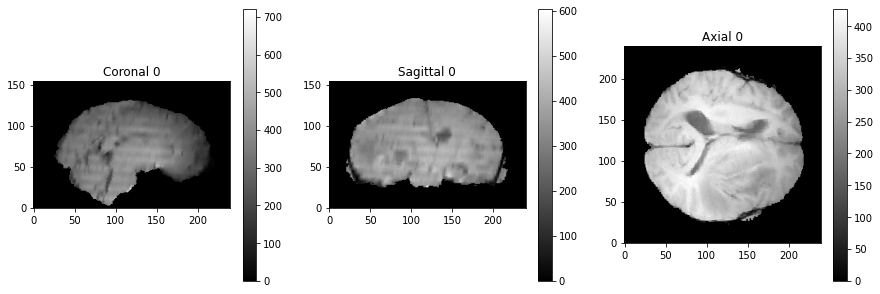

In [6]:
import importlib.util
importlib.reload(mri_utils)
mri_utils.plot_img_arr(transformed)

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

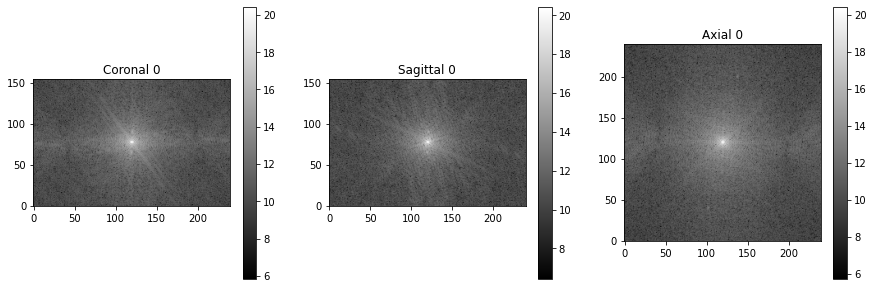

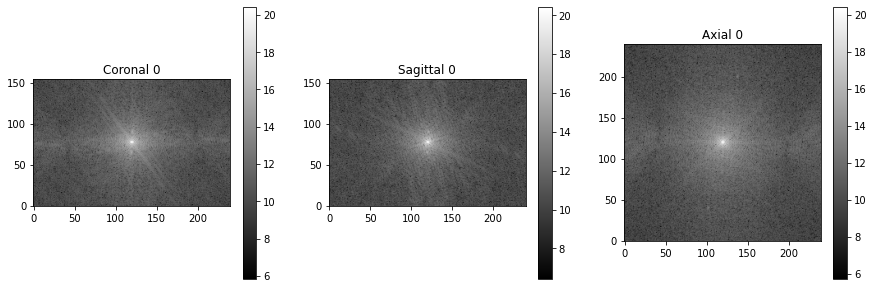

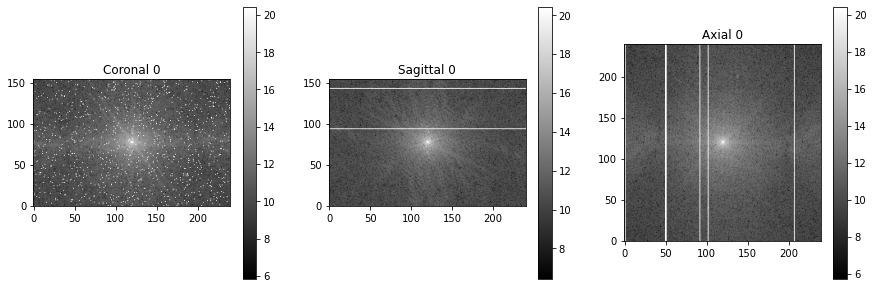

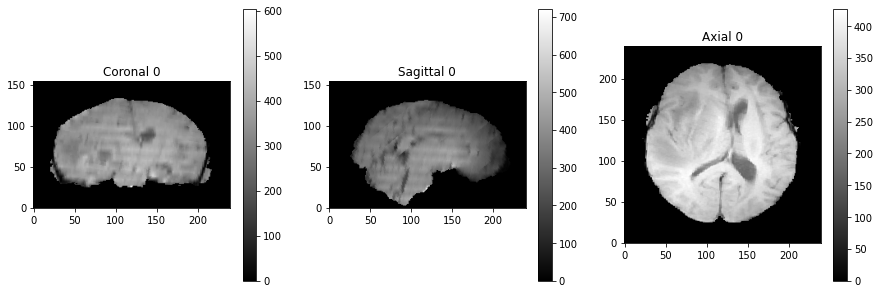

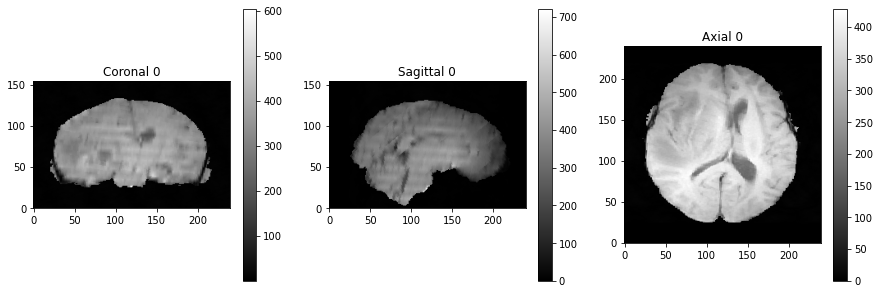

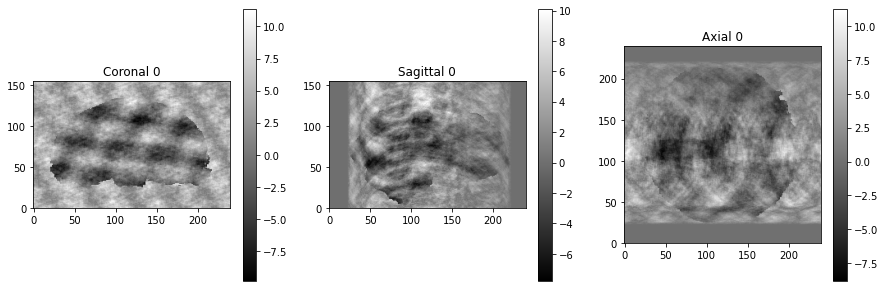

In [7]:
tp = np.transpose(transformed,axes = [1,0,2])

fftT1w = np.fft.fftn(tp)
cfftT1w = np.fft.fftshift(fftT1w)
mri_utils.plot_img_arr(np.log(np.abs(cfftT1w)))

dim = cfftT1w.shape
chPt = [round(dim[1]/3),round(dim[2]/3)]
afftT1w = cfftT1w.copy()
kfftT1w = cfftT1w.copy()

np.random.seed(42)
nKL = 1000
chPt1 = np.random.randint(dim[1],size = (nKL,1))
chPt2 = np.random.randint(dim[2],size = (nKL,1))
chPt = np.hstack((chPt1,chPt2))
# afftT1w[:,:,chPt] = (afftT1w[:,:,chPt] + 0)  * 3
randPhase = (np.random.rand(nKL) - .5)*2 * np.pi/6
afftT1w[:,chPt[:,0],chPt[:,1]] = (afftT1w[:,chPt[:,0],chPt[:,1]] + 0)  * np.exp(-1j*randPhase)
kfftT1w[:,chPt[:,0],chPt[:,1]] = np.amax(np.abs(kfftT1w))

# print(chPt)
mri_utils.plot_img_arr(np.log(np.abs(afftT1w)))
mri_utils.plot_img_arr(np.log(np.abs(kfftT1w)))


uT1w = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftT1w)))
mri_utils.plot_img_arr(uT1w)

aT1w = np.abs(np.fft.ifftn(np.fft.ifftshift(afftT1w)))
mri_utils.plot_img_arr(aT1w)

mri_utils.plot_img_arr(aT1w-uT1w)

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

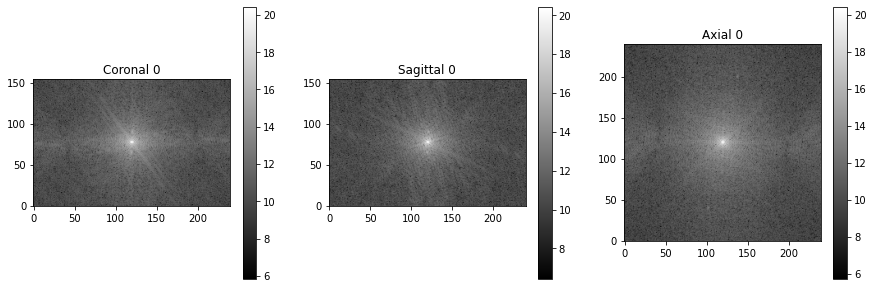

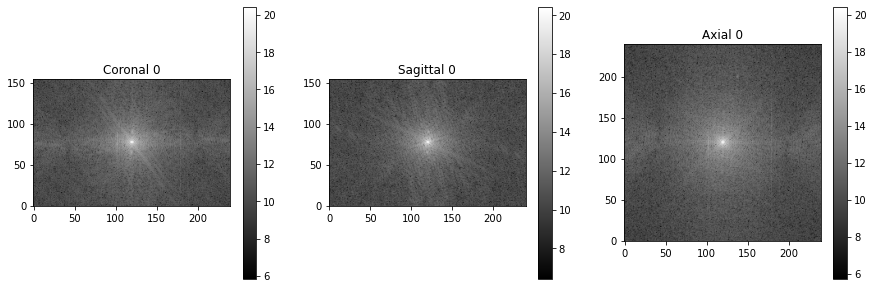

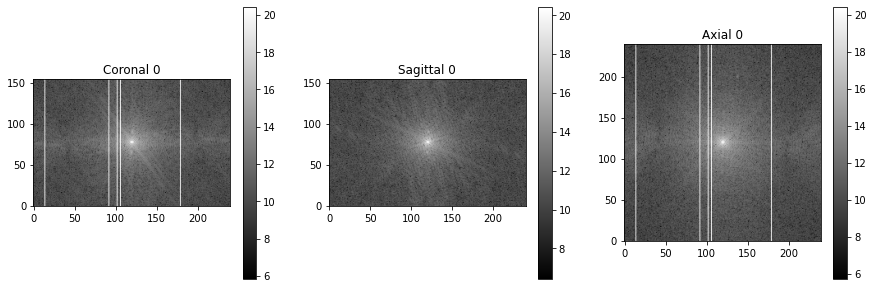

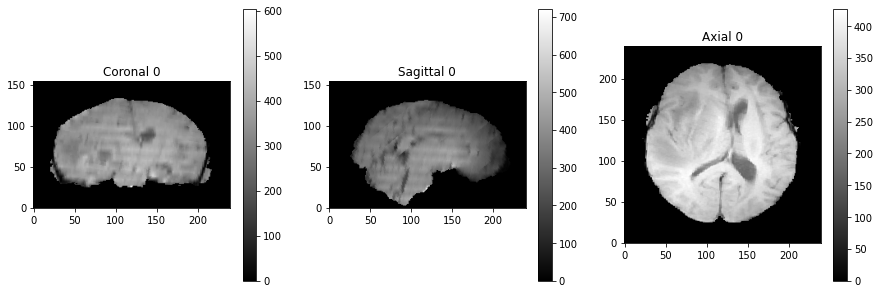

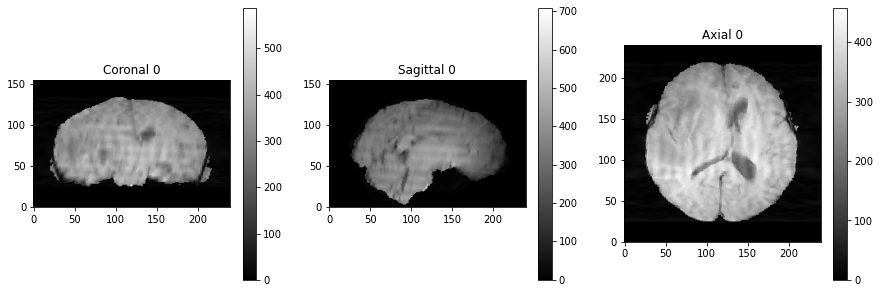

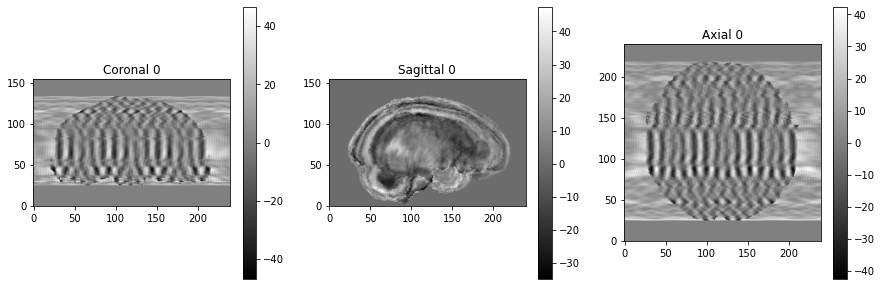

In [8]:
tp = np.transpose(transformed,axes = [1,0,2])
fftT1w = np.fft.fftn(tp)
cfftT1w = np.fft.fftshift(fftT1w)
mri_utils.plot_img_arr(np.log(np.abs(cfftT1w)))

dim = cfftT1w.shape
chPt = [round(dim[1]/3),round(dim[2]/3)]
afftT1w = cfftT1w.copy()
kfftT1w = cfftT1w.copy()

np.random.seed(42)
nKL = 1000
chPt1 = np.random.randint(dim[1],size = (nKL,1))
chPt2 = np.random.randint(dim[2],size = (nKL,1))
chDiff = np.random.randint(-25,25,size = (nKL,1))
chPt = np.hstack((chPt1,chPt2))
# afftT1w[:,:,chPt] = (afftT1w[:,:,chPt] + 0)  * 3
randPhase = (np.random.rand(nKL) - .5)*2 * np.pi/6
afftT1w[:,chPt[0:5,0],:] = afftT1w[:,chPt[0:5,0]+chDiff[0:5,0],:]
kfftT1w[:,chPt[0:5,0],:] = np.amax(np.abs(kfftT1w))

# print(chPt)
mri_utils.plot_img_arr(np.log(np.abs(afftT1w)))
mri_utils.plot_img_arr(np.log(np.abs(kfftT1w)))


uT1w = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftT1w)))
mri_utils.plot_img_arr(uT1w)

aT1w = np.abs(np.fft.ifftn(np.fft.ifftshift(afftT1w)))
mri_utils.plot_img_arr(aT1w)




mri_utils.plot_img_arr(aT1w-uT1w)

# Planes with phase alteration

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

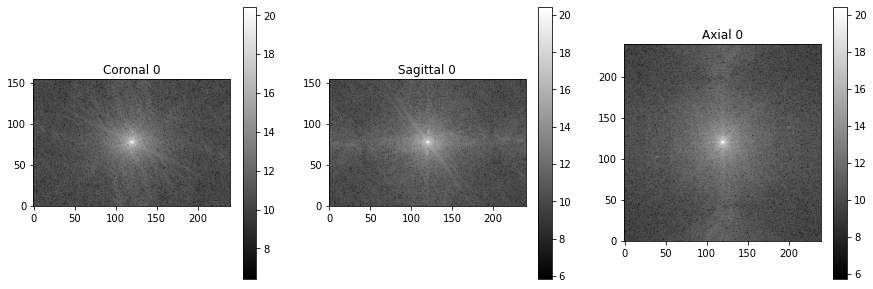

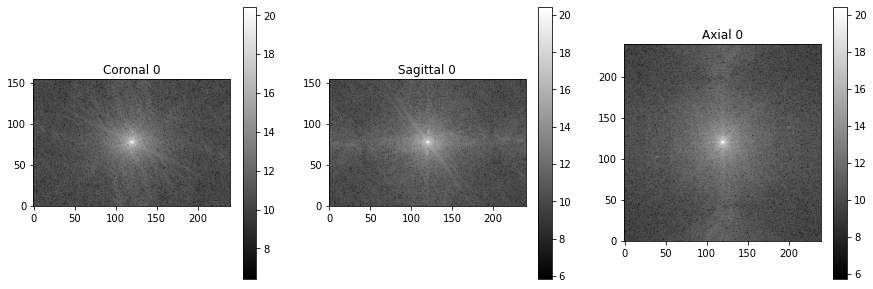

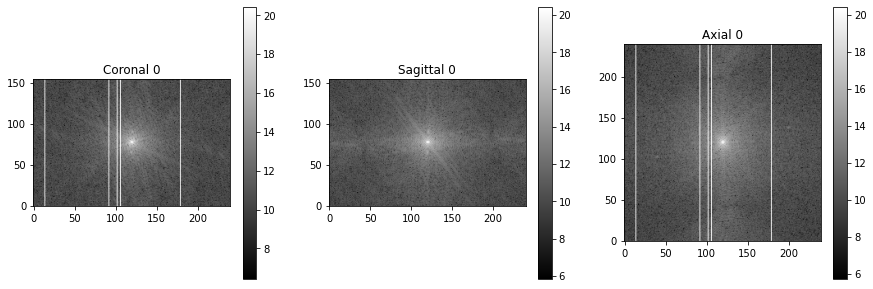

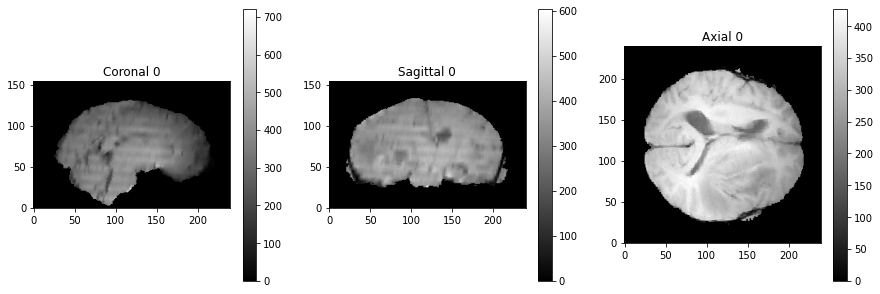

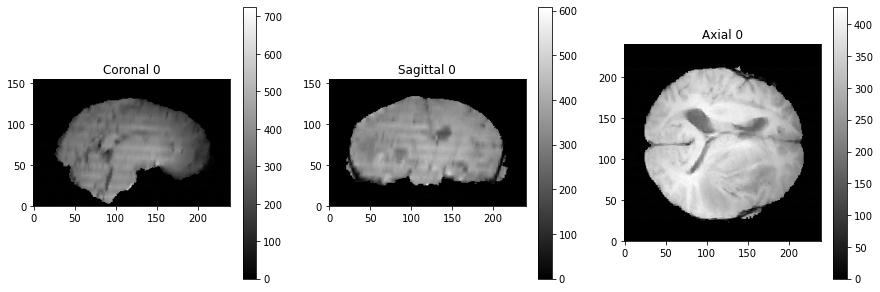

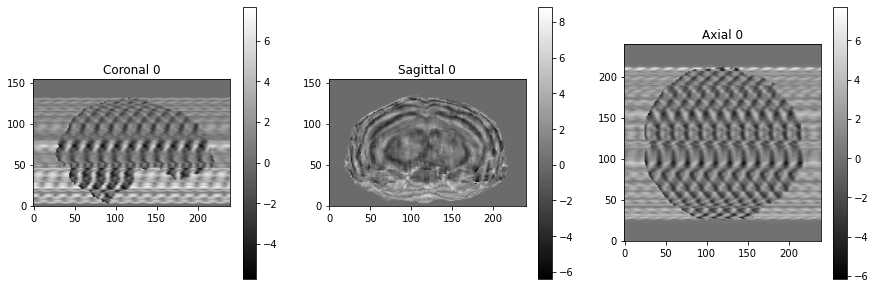

In [9]:
fftT1w = np.fft.fftn(transformed)
cfftT1w = np.fft.fftshift(fftT1w)
mri_utils.plot_img_arr(np.log(np.abs(cfftT1w)))

dim = cfftT1w.shape
chPt = [round(dim[1]/3),round(dim[2]/3)]
afftT1w = cfftT1w.copy()
kfftT1w = cfftT1w.copy()

np.random.seed(42)
nKL = 5
chPt1 = np.random.randint(dim[1],size = (nKL,1))
chPt2 = np.random.randint(dim[2],size = (nKL,1))
chPt = np.hstack((chPt1,chPt2))
# afftT1w[:,:,chPt] = (afftT1w[:,:,chPt] + 0)  * 3
randPhase = (np.random.rand(nKL) - .5)*2 * np.pi/6
afftT1w[:,chPt[:,0],:] = (afftT1w[:,chPt[:,0],:])  * np.tile(np.reshape(np.exp(-1j*randPhase),(1,-1,1)),
                                                             (dim[0],1,dim[2]))
kfftT1w[:,chPt[:,0],:] = np.amax(np.abs(kfftT1w))

# print(chPt)
mri_utils.plot_img_arr(np.log(np.abs(afftT1w)))
mri_utils.plot_img_arr(np.log(np.abs(kfftT1w)))


uT1w = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftT1w)))
mri_utils.plot_img_arr(uT1w)

aT1w = np.abs(np.fft.ifftn(np.fft.ifftshift(afftT1w)))
mri_utils.plot_img_arr(aT1w)

mri_utils.plot_img_arr(aT1w-uT1w)

# Rotional resampling (motion artifact)

In [10]:
from scipy.interpolate import RegularGridInterpolator


def cart2sph(xyz):
    ptsnew = np.zeros(xyz.shape)
    xy = xyz[:,0]**2 + xyz[:,1]**2
    ptsnew[:,0] = np.sqrt(xy + xyz[:,2]**2) # (rho)
    ptsnew[:,1] = np.arctan2(np.sqrt(xy), xyz[:,2]) # for elevation angle defined from Z-axis down (phi)
    ptsnew[:,2] = np.arctan2(xyz[:,1], xyz[:,0]) # (theta)
    return ptsnew

def sph2cart(ijk):
    ptsnew = np.zeros(ijk.shape)
    ptsnew[:,0] = ijk[:,0] * np.sin(ijk[:,1]) * np.cos(ijk[:,2])
    ptsnew[:,1] = ijk[:,0] * np.sin(ijk[:,1]) * np.sin(ijk[:,2])
    ptsnew[:,2] = ijk[:,0] * np.cos(ijk[:,1])
    return ptsnew


In [11]:
np.random.seed(42)
testArr = (np.random.rand(5,3) -.5) * 10
sphArr = cart2sph(testArr)
cartArr = sph2cart(sphArr)
print(np.hstack((testArr,cartArr)))

[[-1.25459881  4.50714306  2.31993942 -1.25459881  4.50714306  2.31993942]
 [ 0.98658484 -3.4398136  -3.4400548   0.98658484 -3.4398136  -3.4400548 ]
 [-4.41916388  3.66176146  1.01115012 -4.41916388  3.66176146  1.01115012]
 [ 2.08072578 -4.79415506  4.69909852  2.08072578 -4.79415506  4.69909852]
 [ 3.32442641 -2.87660889 -3.18175033  3.32442641 -2.87660889 -3.18175033]]


In [12]:
imagedir = nii_dir
def load_align_data(pDir,rerunAffine = False,outImDir=None,outRegDir=None):
    if outImDir is None:
        outImDir = os.path.join(root_dir,'data','images','atlases')
    if outRegDir is None:
        outRegDir = os.path.join(root_dir,'data','registration')

    if not os.path.exists(outImDir):
        os.makedirs(outImDir)
    if not os.path.exists(outRegDir):
        os.makedirs(outRegDir)

    ### https://nilearn.github.io/modules/generated/nilearn.datasets.load_mni152_template.html
    # template_img = datasets.load_mni152_template()
    orig_template = datasets.load_mni152_template()
    template_img = orig_template
    

#         pDir = patients[pNo]
#     cDir = os.path.join(imagedir,pDir)

    (lbl_nib, imNibDict) = nii_utils.load_patient(pDir)

    TCGA_ID = os.path.basename(pDir)
    print('%s' % TCGA_ID)

    moving_img = imNibDict['t1w']
    if template_img.shape != moving_img.shape:
        print('Resizing template from: ', template_img.shape, ' to ', moving_img.shape)
        template_img = resize_template(orig_template,moving_img)

    label_img = lbl_nib
    label_arr = label_img.get_fdata().astype(np.float64)

    # run the multi-step registration (mri_reg.py)
    cRegDir = os.path.join(outRegDir,pDir)
    
    cTrMapFile = os.path.join(cDir,'affine_map_2.pkl')
    if rerunAffine or not os.path.isfile(cTrMapFile):
        (affine,_) = ms_affreg(moving_img,template_img=template_img,reg_type=3)
        f = open(cTrMapFile,"wb")
        pickle.dump(affine,f)
        f.close()
    else:
        f = open(cTrMapFile, 'rb')
        affine = pickle.load(f)
        f.close()


    transformed = affine.transform(moving_img.get_fdata(),interpolation = 'nearest')
    transf_nib = nib.nifti1.Nifti1Image(transformed,template_img.affine,header=moving_img.header)
    tr_label = np.round(affine.transform(label_arr,interpolation = 'nearest'),decimals=0)
    return (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID)

In [13]:
def rotate_translate_img_vol(img,zRot,yRot,trVec=None,dg=False,mode='nearest'):
    rotObj = R.from_euler('zy', [zRot,yRot], degrees=dg)
    if trVec is None:
        trVec = np.zeros((3))
#     print([xRot,zRot])
    trAff =  np.diag(np.ones(4))
    trAff[0:3,3] = [d/2 for d in img.shape]
    rotAff = np.zeros((4,4))
    rotAff[0:3,0:3] = rotObj.as_matrix()
    rotAff[3,3] = 1
    trInvAff =  np.diag(np.ones(4))
    trInvAff[0:3,3] = [-d/2 for d in img.shape]
    trInvAff[0:3,3] = trInvAff[0:3,3] + trVec
    cmbAff = np.matmul(np.matmul(trAff,rotAff),trInvAff)
    rotImg = affine_transform(img,cmbAff,mode=mode)
    return rotImg


In [14]:
def add_rotation_motion_artifact(inArr,nKL = 5, nSz = 35,frEnc = 0, phEnc = 1,
     thRot = np.pi/24, phRot = np.pi/6, xyzTrMax = 5, random_seed=None,dispTF=True):
    fftV = np.fft.fftn(inArr)
    cfftV = np.fft.fftshift(fftV)

    dim = cfftV.shape
    chPt = [round(dim[1]/3),round(dim[2]/3)]
    afftV = cfftV.copy()
    kfftV = cfftV.copy()
    rtfftV = cfftV.copy()


    # create a grid in frequency space
    iv = np.arange(dim[0]) - dim[0]/2
    jv = np.arange(dim[1]) - dim[1]/2
    kv = np.arange(dim[2]) - dim[2]/2

    cFFTInterp = RegularGridInterpolator((iv, jv, kv), cfftV,fill_value=np.mean(cfftV),
                                         bounds_error=False,method='nearest')
    if random_seed is not None:
        np.random.seed(random_seed)
    # randPhase = (np.random.rand(nKL) - .5)*0 
    othDim = list(set([0,1,2])-set([phEnc,frEnc]))[0]

    try: # allow for multiple different translation sizes as a list
        iter(xyzTrMax) # 
    except Exception:
        xyzTrMax = [xyzTrMax,xyzTrMax,xyzTrMax]
#     chVec1 = np.random.randint(dim[frEnc],size = (nKL,1))
#     chVec2 = np.random.randint(dim[othDim],size = (nKL,1))

    chVec1 = np.random.normal(loc = dim[frEnc]/2, scale = dim[frEnc]/8,size = (nKL,1))
    chVec1[chVec1<0] = 0
    chVec1[chVec1>dim[frEnc]] = dim[frEnc]
    chVec1 = chVec1.astype(int)
    chVec2 = np.random.normal(loc = dim[othDim]/2, scale = dim[othDim]/8,size = (nKL,1))
    chVec2[chVec2<0] = 0
    chVec2[chVec2>dim[othDim]] = dim[othDim]
    chVec2 = chVec2.astype(int)
    
    randTheta = (np.random.rand(nKL) - .5)*2 * thRot
    randPhi = (np.random.rand(nKL) - .5)*2 * phRot
    randXYZ = (np.random.rand(nKL,3) - .5)*2
    randXYZ[:,0] = randXYZ[:,0] * xyzTrMax[0]
    randXYZ[:,1] = randXYZ[:,1] * xyzTrMax[1]
    randXYZ[:,2] = randXYZ[:,2] * xyzTrMax[2]
    
    for kIdx in tqdm(range(nKL)):
        minD = max(-nSz,0-chVec1[kIdx].item()) # don't go outside the volume bounds
        maxD = min(nSz,(dim[frEnc]-1)-chVec1[kIdx].item()) # don't go outside the volume bounds
        
#         rVol = rotate_translate_img_vol(inArr.copy(),randTheta[kIdx], randPhi[kIdx]) #randPhi[kIdx])
        rVol = rotate_translate_img_vol(inArr.copy(),randTheta[kIdx], randPhi[kIdx],trVec=randXYZ[kIdx,:])
        rfftV = np.fft.fftshift(np.fft.fftn(rVol))
        for adjPhase in range(minD,maxD):
            nI = dim[phEnc]
            chVec = np.zeros((nI,3))

            # create k-line vector
            chVec[:,frEnc] = np.arange(dim[frEnc])
            chVec[:,phEnc] = chVec1[kIdx] + adjPhase
            chVec[:,othDim] = chVec2[kIdx]

            # turn it into a centered cartesian vector
            chCartVec = chVec.copy()
            chCartVec[:,0] = chCartVec[:,0] - dim[0]/2
            chCartVec[:,1] = chCartVec[:,1] - dim[1]/2
            chCartVec[:,2] = chCartVec[:,2] - dim[2]/2

             # rotation in two directions
            rotObj = R.from_euler('zy', [randTheta[kIdx], randPhi[kIdx]], degrees=False)
            adjCartVec = rotObj.apply(chCartVec)

            chIVec = chVec.astype(int)
#             afftV[chIVec[:,0],chIVec[:,1],chIVec[:,2]] = cFFTInterp(adjCartVec)
            afftV[chIVec[:,0],chIVec[:,1],chIVec[:,2]] = rfftV[chIVec[:,0],chIVec[:,1],chIVec[:,2]]
    
            kfftV[chIVec[:,0],chIVec[:,1],chIVec[:,2]] = np.amax(np.abs(cfftV))
#             rCartVec = adjCartVec.copy()
#             rCartVec[:,0] = np.maximum(np.minimum(rCartVec[:,0] + dim[0]/2,dim[0]-1),0)
#             rCartVec[:,1] = np.maximum(np.minimum(rCartVec[:,1] + dim[1]/2,dim[1]-1),0)
#             rCartVec[:,2] = np.maximum(np.minimum(rCartVec[:,2] + dim[2]/2,dim[2]-1),0)
#             rCartVec = rCartVec.astype(int)
#             rtfftV[rCartVec[:,0],rCartVec[:,1],rCartVec[:,2]] = np.amax(np.abs(cfftV))
    # print(chPt)
    
    uV = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftV)))
    aV = np.abs(np.fft.ifftn(np.fft.ifftshift(afftV)))
    if dispTF:
        mri_utils.plot_img_arr(np.log(np.abs(cfftV)))
        mri_utils.plot_img_arr(np.log(np.abs(afftV)))
        mri_utils.plot_img_arr(np.log(np.abs(kfftV)))
#         mri_utils.plot_img_arr(np.log(np.abs(rtfftV)))

        mri_utils.plot_img_arr(uV)
        mri_utils.plot_img_arr(aV)
        mri_utils.plot_img_arr(aV-uV)
    return aV

In [15]:
def add_stepwise_rotation_motion_artifact(inArr,nKL = 10,frEnc = 0, phEnc = 1,
    thRot = np.pi/48, phRot = np.pi/12,scale = .125, xyzTrMax = 5, random_seed=None,dispTF=True):
    
    fftV = np.fft.fftn(inArr)
    cfftV = np.fft.fftshift(fftV)

    dim = list(inArr.shape)
    afftV = cfftV.copy()
    try: # allow for multiple different translation sizes as a list
        iter(xyzTrMax) # 
    except Exception:
        xyzTrMax = [xyzTrMax,xyzTrMax,xyzTrMax]

    # create a grid in frequency space
    iv = np.arange(dim[0]) - dim[0]/2
    jv = np.arange(dim[1]) - dim[1]/2
    kv = np.arange(dim[2]) - dim[2]/2
    # ig, jg ,kg = np.meshgrid(iv, jv, kv, indexing='ij', sparse=True)

    cFFTInterp = RegularGridInterpolator((iv, jv, kv), cfftV,fill_value=np.mean(cfftV),
                                         bounds_error=False,method='nearest')

    np.random.seed(random_seed)
    othDim = list(set([0,1,2])-set([phEnc,frEnc]))[0] # find out which axis is the third dimension
    
    # randomize the amount of rotation around the phase encoding and other axes respectively (default x & z)
    chVec1 = np.random.normal(loc = dim[phEnc]/2, scale = dim[phEnc]*scale,size = (nKL+1,1))
    chVec1[chVec1<0] = 0
    chVec1[chVec1>dim[phEnc]] = dim[phEnc]
    chVec1 = chVec1.astype(int)
    chVec2 = np.random.normal(loc = dim[othDim]/2, scale = dim[othDim]*scale,size = (nKL+1,1))
    chVec2[chVec2<0] = 0
    chVec2[chVec2>dim[othDim]] = dim[othDim]
    chVec2 = chVec2.astype(int)

    idxVec = np.hstack((chVec1,chVec2))
    sIdxVec = idxVec[np.lexsort(idxVec.T[::-1])] # sort by phase encoding then other dim
    
#     idxVec = np.hstack((chVec2,chVec1))
#     sIdxVec = idxVec[np.lexsort(idxVec.T[::-1])] # sort by first column then second column if matched
#     sIdxVec = sIdxVec[:,[1,0]] # swap so we're actually sorting by other dim, then phase encoding
#     print(chVec1,chVec2,sIdxVec)
    randTheta = (np.random.rand(nKL) - .5)*2 * thRot
    randPhi = (np.random.rand(nKL) - .5)*2 * phRot
    
    randXYZ = (np.random.rand(nKL,3) - .5)*2
    randXYZ[:,0] = randXYZ[:,0] * xyzTrMax[0]
    randXYZ[:,1] = randXYZ[:,1] * xyzTrMax[1]
    randXYZ[:,2] = randXYZ[:,2] * xyzTrMax[2]

    prevCoords = np.array([0,0])
    dimOrder = [frEnc,othDim,phEnc]
#     dimOrder = [othDim,phEnc,frEnc]
    iOrder = [np.where(np.array(dimOrder) == idx)[0][0] for idx in [0,1,2]]
#     print(dimOrder,iOrder)
    rDim = [dim[dN] for dN in dimOrder]
    afftFlat = np.transpose(afftV,dimOrder).flatten(order='F')

    # use a Cartesian MRI acquisition trajectory, 
    # i.e. go in order of frequency encoding, phase encoding, other dimesion
    for kIdx in tqdm(range(nKL)):
        pSub = [dim[frEnc]-1,sIdxVec[kIdx,1],sIdxVec[kIdx,0]]
        cSub = [dim[frEnc]-1,sIdxVec[kIdx+1,1],sIdxVec[kIdx+1,0]]
#         pSub = [dim[phEnc]-1,sIdxVec[kIdx,0],sIdxVec[kIdx,1]]
#         cSub = [dim[phEnc]-1,sIdxVec[kIdx+1,0],sIdxVec[kIdx+1,1]]
    
        prevIdx = np.ravel_multi_index(pSub,rDim,order='F') 
        ravIdx = np.ravel_multi_index(cSub,rDim,order='F')
        
        rVol = rotate_translate_img_vol(inArr.copy(),randTheta[kIdx], randPhi[kIdx],trVec=randXYZ[kIdx,:])
        rfftV = np.fft.fftshift(np.fft.fftn(rVol))
        rfftFlat = np.transpose(rfftV,dimOrder).flatten(order='F')
        #  replace the old k-space in the affected range by the artifact k-space values
        afftFlat[prevIdx:ravIdx] = rfftFlat[prevIdx:ravIdx] 
#         print(pSub,cSub,prevIdx,ravIdx)

    # bring it back into shape, then IFFT back to spatial domain
    afftV = afftFlat.reshape(rDim,order='F').transpose(iOrder)
    aV = np.abs(np.fft.ifftn(np.fft.ifftshift(afftV)))
    uV = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftV)))
    if dispTF: # plot the 
        mri_utils.plot_img_arr(np.log(np.abs(cfftV)))
        mri_utils.plot_img_arr(np.log(np.abs(afftV)))
        # mri_utils.plot_img_arr(np.log(np.abs(kfftV)))
        mri_utils.plot_img_arr(np.log(np.abs(rfftV)))


        mri_utils.plot_img_arr(uV)


        mri_utils.plot_img_arr(aV)

        mri_utils.plot_img_arr(aV-uV)
    return aV

In [29]:
def add_2d_rotation_motion_artifact(inArr,nKL = 10, frEnc = 0, phEnc = 1,
        thRot = np.pi/24, phRot = np.pi/6, xyzTrMax = 5,scale = .125,
        random_seed=None,dispTF=True):
    cfftV = np.zeros(inArr.shape,dtype=np.complex_)
    for othIdx in range(inArr.shape[2]):
        cfftSlice = np.fft.fftshift(np.fft.fftn(inArr[:,:,othIdx]))
        cfftV[:,:,othIdx] = cfftSlice

    try: # allow for multiple different translation sizes as a list
        iter(xyzTrMax) # 
    except Exception:
        xyzTrMax = [xyzTrMax,xyzTrMax,xyzTrMax]
    
    dim = list(inArr.shape)
    afftV = cfftV.copy()

    np.random.seed(random_seed)
    # figure out what the other direction is (usually z)
    othDim = list(set([0,1,2])-set([phEnc,frEnc]))[0]

    chVec1 = np.random.normal(loc = dim[phEnc]/2, scale = dim[phEnc]*scale,size = (nKL+1,1))
    chVec1[chVec1<0] = 0
    chVec1[chVec1>dim[phEnc]] = dim[phEnc]
    chVec1 = chVec1.astype(int)
    chVec2 = np.random.normal(loc = dim[frEnc]/2, scale = dim[frEnc]*scale,size = (nKL+1,1))
    chVec2[chVec2<0] = 0
    chVec2[chVec2>dim[frEnc]] = dim[frEnc]
    chVec2 = chVec2.astype(int)

    idxVec = np.hstack((chVec2,chVec1))

    sIdxVec = idxVec[np.lexsort(idxVec.T[::])] # sort by first column then second column if matched
    sIdxVec = sIdxVec[:,[1,0]] # swap so we're actually sorting by other dim, then frequency encoding
    #     print(sIdxVec)
    randTheta = (np.random.rand(nKL) - .5)*2 * thRot
    randPhi = (np.random.rand(nKL) - .5)*2 * phRot
    
    randXYZ = (np.random.rand(nKL,3) - .5)*2
    randXYZ[:,0] = randXYZ[:,0] * xyzTrMax[0]
    randXYZ[:,1] = randXYZ[:,1] * xyzTrMax[1]
    randXYZ[:,2] = randXYZ[:,2] * xyzTrMax[2]

    prevCoords = np.array([0,0])
    dimOrder = [frEnc,phEnc,othDim]
    #     dimOrder = [othDim,phEnc,frEnc]
    iOrder = [np.where(np.array(dimOrder) == idx)[0][0] for idx in [0,1,2]]
    rDim = [dim[dN] for dN in dimOrder]
    afftFlat = np.transpose(afftV,dimOrder).flatten(order='F')

    # undefined for some regions
    othMaxValue = np.amax(np.abs(cfftV),axis=(frEnc,phEnc))
    othIdxNZ = othMaxValue.nonzero()[0]

    for kIdx in tqdm(range(nKL)):
    # for kIdx in tqdm(range(1)):
        pSub = [sIdxVec[kIdx,1],sIdxVec[kIdx,0]]
        cSub = [sIdxVec[kIdx+1,1],sIdxVec[kIdx+1,0]]

        rVol = rotate_translate_img_vol(inArr.copy(),randTheta[kIdx], randPhi[kIdx],trVec=randXYZ[kIdx,:])
        for othIdx in othIdxNZ:
            rfftSlice = np.fft.fftshift(np.fft.fftn(rVol[:,:,othIdx]))
            pXYSub = [pSub[0],pSub[1]]
            cXYSub = [cSub[0],cSub[1]]

            pRXYIdx = np.ravel_multi_index(pXYSub,rDim[0:2],order='F')
            cRXYIdx = np.ravel_multi_index(cXYSub,rDim[0:2],order='F')

            rfftFlat = rfftSlice.flatten(order='F')
            cAFFTSl = afftV[:,:,othIdx]
            cAFFTFlat = cAFFTSl.flatten(order='F')
            cAFFTFlat[pRXYIdx:cRXYIdx] = rfftFlat[pRXYIdx:cRXYIdx]
            cAFFTSl = cAFFTFlat.reshape(rDim[0:2],order='F')
            afftV[:,:,othIdx] = cAFFTSl
    
    aV = np.zeros(inArr.shape)
    uV = np.zeros(inArr.shape)
    for othIdx in range(inArr.shape[2]):
        aV[:,:,othIdx] = np.abs(np.fft.ifftn(np.fft.ifftshift(afftV[:,:,othIdx])))
    if dispTF:
        mri_utils.plot_img_arr(np.log(np.abs(afftV)))

        mri_utils.plot_img_arr(aV)
        mri_utils.plot_img_arr(aV-inArr)
    return aV

In [17]:
def add_misalignment_artifact(inArr,
    thRot = np.pi/48, phRot = np.pi/12,scale = .125, xyzTrMax = 5, random_seed=None,dispTF=True):

    dim = list(inArr.shape)
    try: # allow for multiple different translation sizes as a list
        iter(xyzTrMax) # 
    except Exception:
        xyzTrMax = [xyzTrMax,xyzTrMax,xyzTrMax]

    np.random.seed(random_seed)

    randTheta = (np.random.rand(1) - .5)*2 * thRot
    randPhi = (np.random.rand(1) - .5)*2 * phRot
    
    randXYZ = (np.random.rand(1,3) - .5)*2
    randXYZ[:,0] = randXYZ[:,0] * xyzTrMax[0]
    randXYZ[:,1] = randXYZ[:,1] * xyzTrMax[1]
    randXYZ[:,2] = randXYZ[:,2] * xyzTrMax[2]


    aV = rotate_translate_img_vol(inArr.copy(),randTheta[0], randPhi[0],trVec=randXYZ[0,:])
    if dispTF:
        mri_utils.plot_img_arr(aV)
        mri_utils.plot_img_arr(aV-inArr)
    return aV

In [18]:
def add_fake_skull(inArr,bg=None,dMin = 3,dMax = 10,pct = 80,intMult = 1.2,dispTF=True):
    if bg is None:
        bg = mri_utils.get_min_background(inArr)
    
    dim = list(bg.shape)
    bg = np.reshape(bg,(dim[0],dim[1],dim[2]))
    fg = np.logical_not(bg)
    distMap = distance_transform_edt(bg)

    dDiff = (dMax-dMin)/2
    dAvg = (dMax + dMin)/2
    skullReg = np.logical_and(distMap <= dMax,distMap >= dMin)

    # make a fake skull between dMin and dMax with a maximum intensity of intMult * pct percentile of the foreground
    # has a quadratic intensity curve
    aV = inArr.copy()
    skullNum = np.maximum(1-np.square((dAvg - distMap)/dDiff),0)*intMult
    aV[skullReg] = np.percentile(aV[fg],pct)
    aV[skullReg] = aV[skullReg] * skullNum[skullReg]
    if dispTF:
        mri_utils.plot_img_arr(inArr)
        mri_utils.plot_img_arr(bg)
        mri_utils.plot_img_arr(aV)
#         mri_utils.plot_img_arr(np.multiply(skullNum,skullReg))
    return aV

def remove_fake_skull(inArr,origArr):
    bg = mri_utils.get_min_background(origArr)
    dim = list(bg.shape)
    bg = np.reshape(bg,(dim[0],dim[1],dim[2]))
    
    outArr = inArr.copy()
    outArr[bg] = origArr[bg]
    return outArr


In [19]:
def combine_bboxes_dict(inDict,verbose=True):
    modalList = list(inDict.keys())
    bboxes  = np.empty((3,2,len(modalList)))
    bboxes[:] = np.NaN
    modDim  = np.empty((3,len(modalList)))
    modDim[:] = np.NaN

    for mIdx in range(len(modalList)):
        modal = modalList[mIdx]
        cVol = inDict[modal]
        if isinstance(cVol,nib.nifti1.Nifti1Image):
            modDim[:,mIdx] = cVol.get_fdata().shape
            bboxes[:,:,mIdx] = nii_utils.get_bbox(cVol.get_fdata())
        elif isinstance(cVol,np.ndarray):
            modDim[:,mIdx] = cVol.shape
            bboxes[:,:,mIdx] = nii_utils.get_bbox(cVol)

    if not np.all(np.equal(np.amax(bboxes,axis = 2),np.amin(bboxes,axis = 2))) and verbose == True:
        print(bboxes)

    # check to make sure the images are the same size
    if not np.all(np.equal(np.amax(modDim,axis = 1),np.amin(modDim,axis = 1))) and verbose == True:
        print(modDim)
    #     bbox = np.mean(bboxes,axis=2).astype(int)
    bbox = np.vstack((np.amin(bboxes[:,0,:],axis=1),np.amin(bboxes[:,1,:],axis=1))).T
    return bbox


In [20]:
def get_distance_from_boundary(inArr=None,bg=None,area_threshold=10):
    # find the distance to the background boundary: + for in the background, - for in the foreground
    if bg is None:
        bg = mri_utils.get_min_background(inArr)
    dim = list(bg.shape)
    bg = np.reshape(bg,(dim[0],dim[1],dim[2]))
    fg = np.logical_not(bg)
    if area_threshold is not None:
        fg = area_closing(fg,area_threshold=area_threshold) # make sure there's no small pixels inside the brain throwing things off

    distMap = distance_transform_edt(bg) - distance_transform_edt(fg)
    return distMap

In [21]:
def add_aliasing_artifact(inArr,phEnc = 1,overlap = 1/3,aliasMult = .75,intMult=1.1,dispTF=True):
    # make it so we put the phase encoding direction first
    dimOrder = np.concatenate((np.asarray([phEnc]),np.setdiff1d([0,1,2],phEnc)))
    iOrder = [np.where(np.array(dimOrder) == idx)[0][0] for idx in [0,1,2]] # invert transpose

    tpV = np.transpose(inArr,dimOrder)
    artV = tpV.copy()

    bg = mri_utils.get_min_background(inArr)
    fg = np.transpose(np.logical_not(bg),dimOrder).astype(np.float)
    ovLapReg = fg.copy()
    dim = list(inArr.shape)
    try: # allow for multiple overlaps as a list
        iter(overlap) # 
    except Exception:
        if overlap < 1 and overlap > 0:
            overlap = [overlap] # put individual numbers in a list
        elif overlap >= 1 and round(overlap) == overlap:
            overlap = np.linspace(0,1,overlap+2)[1:-1]
        elif overlap == 0:
            outV = inArr.copy()
            return outV
    
    for cOverlap in overlap:
        overlapAmt = round(dim[phEnc]*cOverlap)
        artV[:overlapAmt,:,:] = artV[:overlapAmt,:,:]  + (tpV[-overlapAmt:,:,:] * aliasMult)
        artV[-overlapAmt:,:,:] = artV[-overlapAmt:,:,:]  + (tpV[:overlapAmt,:,:] * aliasMult)

        # multiply by overlap to adjust how they add together
        ovLapReg[:overlapAmt,:,:] = ovLapReg[:overlapAmt,:,:]  + (fg[-overlapAmt:,:,:])
        ovLapReg[-overlapAmt:,:,:] = ovLapReg[-overlapAmt:,:,:]  + (fg[:overlapAmt,:,:])

    ovLapReg[ovLapReg > 1] = (intMult/((aliasMult)+1)) ** (ovLapReg[ovLapReg > 1]-1) 
    # intMult > 1 = constructive interference (additive)
    # intMult < 1 destructive interference
    
    outV = np.transpose(artV,iOrder)
    ovLapReg = np.transpose(ovLapReg,iOrder)
    outV = np.multiply(outV,ovLapReg)

    if dispTF:
        mri_utils.plot_img_arr(inArr)
        mri_utils.plot_img_arr(outV)
        mri_utils.plot_img_arr(outV-inArr)
    return outV

In [22]:
def generate_dist_seed_locs(lbl,inArr=None,bg=None,artDMid = 25,artDDiff = 10,nArts = 1,random_seed = None,dispTF=True):
    if isinstance(lbl,nib.nifti1.Nifti1Image):
        lbl = lbl.get_fdata()
    artDMax = artDMid + artDDiff

    if bg is None:
        bg = mri_utils.get_min_background(inArr)
    dim = list(bg.shape)
    bg = np.reshape(bg,(dim[0],dim[1],dim[2]))
    fg = np.logical_not(bg)
    fg = area_closing(fg,area_threshold=10) # make sure there's no small pixels inside the brain throwing things off

    distMap = distance_transform_edt(bg) - distance_transform_edt(fg)

    lblDist = get_distance_from_boundary(bg=lbl)

    lblReg = np.logical_and(lblDist <= -artDMid,lblDist >= -artDMid - (2*(artDDiff)))

    p95Dist = np.percentile(distMap[lblReg],95)
    if p95Dist >= artDDiff*2: # start near surface of brain
        outDMin = 0
    else:  # if we're too far from the surface of the brain, allow for starts inside
        outDMin = p95Dist - (artDDiff*2)

    outDMax = outDMin + (artDDiff*2)
    outReg = np.logical_and((distMap >= outDMin),(distMap <=outDMax))
    # combination of distance from mask and distance from surface of brain defines the potential seed locations
    artReg = np.logical_and(lblReg,outReg)
    if dispTF:
        mri_utils.plot_img_arr(artReg)
    artSubs = np.argwhere(artReg)

    # use the region to build the seed location(s) for the artifacts
    np.random.seed(random_seed)
    randIdxs = np.random.randint(artSubs.shape[0],size=(nArts))
    seedLocs = artSubs[randIdxs,:]
    return seedLocs



In [24]:
def add_skull_strip_failure_artifact(inArr,bg=None,lblArr=None,seedLocs=None,random_seed=None,nArts=5,
    artD2Lbl = 10,percSkull2Add=10,skGenArgs={},dispTF=True):
    if bg is None:
        bg = mri_utils.get_min_background(inArr)
    if seedLocs is None:
        if lblArr is None:
            raise ValueError('Either lbl or seedLocs need to be assigned for signal loss artifact')
        seedLocs = generate_dist_seed_locs(bg,inArr,nArts=nArts,artDMid=artD2Lbl,
                                           random_seed=random_seed,dispTF=dispTF)
#     dim = list(inArr.shape)

    skullDist = get_distance_from_boundary(bg=bg)

    randBW = np.ones(inArr.shape)
    randBW[seedLocs[:,0],seedLocs[:,1],seedLocs[:,2]] = 0
    randDistMap = distance_transform_edt(randBW)

    artV = inArr.copy()
    skV = add_fake_skull(inArr.copy(),**skGenArgs,dispTF=dispTF) # pass in fake skull generation parameters as dictionary
    skMask = inArr != skV # track what changed
    
    distThresh = np.percentile(randDistMap[skMask],percSkull2Add) # take a percentage of the skull to keep
    artV[randDistMap<=distThresh] = skV[randDistMap<=distThresh]

    if dispTF is True:
        mri_utils.plot_img_arr(artV)
#         mri_utils.plot_img_arr(((randDistMap<=distThresh)*2)+(skMask))
    return artV



In [25]:
def add_inhomogeneity_artifact(inArr,bg=None,lblArr=None,seedLocs=None,random_seed=None,artD2Lbl=25,artDDiff=25,
                               nArts=5,skGenArgs={},dispTF=True,maxMult=1.25,minMult =.75,sdVal = 75):
    if bg is None:
        bg = mri_utils.get_min_background(inArr)
    if seedLocs is None:
        if lblArr is None:
            raise ValueError('Either lbl or seedLocs need to be assigned for signal loss artifact')
        seedLocs = generate_dist_seed_locs(lblArr,inArr,nArts=nArts,artDMid=artD2Lbl,artDDiff=artDDiff,
                                           random_seed=random_seed,dispTF=dispTF)
#     dim = list(inArr.shape)

    skullDist = get_distance_from_boundary(bg=bg)

    randBW = np.ones(inArr.shape)
    randBW[seedLocs[:,0],seedLocs[:,1],seedLocs[:,2]] = 0
    randDistMap = distance_transform_edt(randBW)
    gSz = np.ceil(np.amax(randDistMap)).astype(int)
    gaussLookup = gaussian(gSz*2+1, std=sdVal)
    gaussLookup = gaussLookup[gSz:]
    randGaussTF = maxMult * gaussLookup[randDistMap.astype(int)]
#     randGaussTF = maxMult * np.exp(-np.square(randDistMap)/(np.square(sdVal)*2))
    randGaussTF[randGaussTF<=minMult] = minMult
    artV = inArr.copy()
    artV = np.multiply(artV,randGaussTF)

    if dispTF is True:
        mri_utils.plot_img_arr(randDistMap)
        mri_utils.plot_img_arr(randGaussTF)
        
        mri_utils.plot_img_arr(artV)
        mri_utils.plot_img_arr(artV-inArr)
#         mri_utils.plot_img_arr(((randDistMap<=distThresh)*2)+(skMask))
    return artV



In [26]:
def add_signal_loss_artifact(inArr,lblArr=None,seedLocs=None,artDMid = 25,artDDiff = 10,rAltDistAdj = 7.5,
                            nRAlts = 100, rAMultArr = [.5,-.5], random_seed=None,debugDisp = False, dispTF = True):
    if seedLocs is None:
        if lblArr is None:
            raise ValueError('Either lbl or seedLocs need to be assigned for signal loss artifact')
        seedLocs = generate_dist_seed_locs(lblArr,inArr,artDMid = artDMid,artDDiff = artDDiff,
                                           random_seed=random_seed,dispTF=dispTF)
    
    # generate the distance from the artifact seed location
    randBW = np.ones(inArr.shape)
    randBW[seedLocs[:,0],seedLocs[:,1],seedLocs[:,2]] = 0
    randDistMap = distance_transform_edt(randBW)

    minV = np.amin(inArr)
    maxV = np.amax(inArr)
    artDMax = artDMid + artDDiff

    rAltMin = artDMid - rAltDistAdj
    rAltMax = artDMid + rAltDistAdj

    np.random.seed(random_seed)
    rDistMap2 = randDistMap.copy()
    for multFac in rAMultArr: # default = [.5,-.5]: one pass to add irregularity, one pass to subtract regions
        rAltReg = np.logical_and(rDistMap2>=rAltMin,rDistMap2<=rAltMax)
        rAltSubs = np.argwhere(rAltReg)
        randIdxs = np.random.randint(rAltSubs.shape[0],size=(nRAlts))
        rAltLocs = rAltSubs[randIdxs,:]

        randBW = np.ones(rAltReg.shape)
        randBW[rAltLocs[:,0],rAltLocs[:,1],rAltLocs[:,2]] = 0
        rAltDistMap = distance_transform_edt(randBW)
        rAltDistMap[rAltDistMap > rAltDistAdj] = rAltDistAdj * 2
        rDistMap2 = rDistMap2 - (((rAltDistAdj * 2) - rAltDistMap) * multFac)

        if debugDisp:
            temp = rDistMap2.copy()
            temp[rDistMap2> artDMax] = artDMax
            mri_utils.plot_img_arr(temp,cutPt=(rAltLocs[0,:]))
    for idx in range(rDistMap2.shape[2]):
        # smooth the irregularities added
        rDistMap2[:,:,idx] = medfilt2d(rDistMap2[:,:,idx],kernel_size=15)

    artV = inArr.copy()
    artV[rDistMap2<=artDMid] = minV
    maskReg = np.logical_and(rDistMap2>=artDMid,rDistMap2<=artDMax)
    dVal = (artDMax-rDistMap2)/(artDMax-artDMid)
    artV[maskReg] = ((artV[maskReg]* (1-dVal[maskReg])) + (dVal[maskReg]*(minV)))
#     print(minV,maxV)
#     print(np.amin(dVal[maskReg]),np.amax(dVal[maskReg]))
    artV[artV>maxV] = maxV
    artV[artV<minV] = minV

    if dispTF:
        if lblArr is not None:
            mri_utils.plot_img_arr(lblArr)
        mri_utils.plot_img_arr(inArr)
        mri_utils.plot_img_arr(artV)
        mri_utils.plot_img_arr(artV-inArr)
        
        
    return artV

100%|██████████| 20/20 [01:06<00:00,  3.32s/it]


30.532004029436724 18.996042394488505 11.88444131739487 9.489322684318756


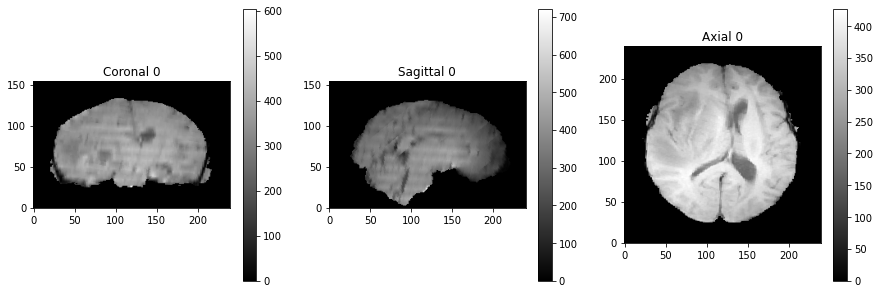

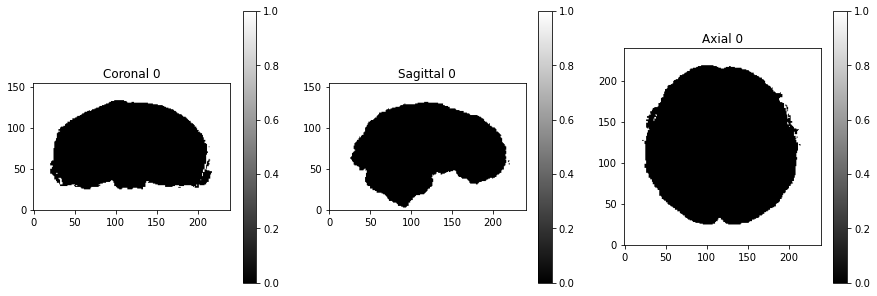

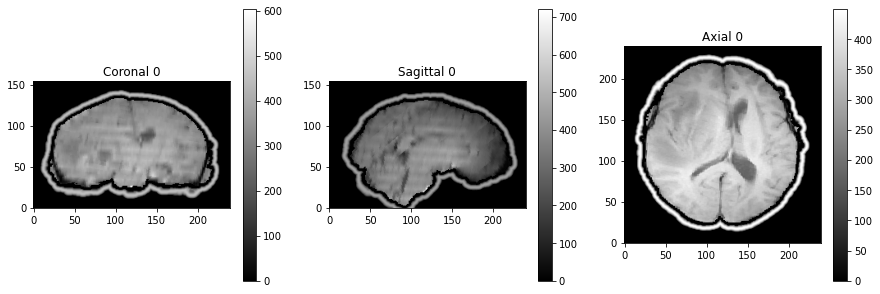

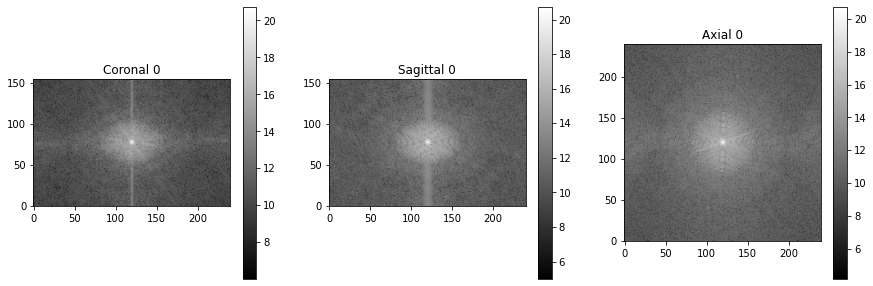

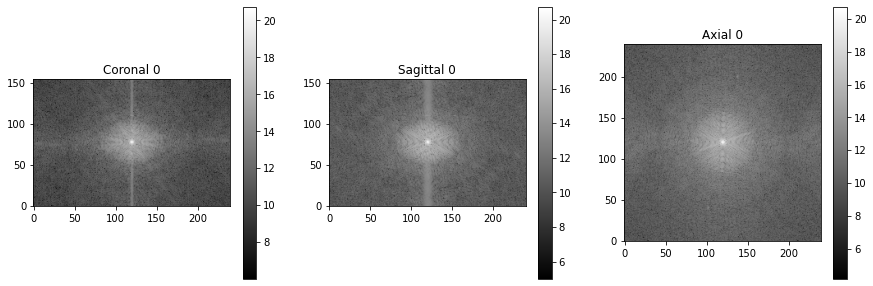

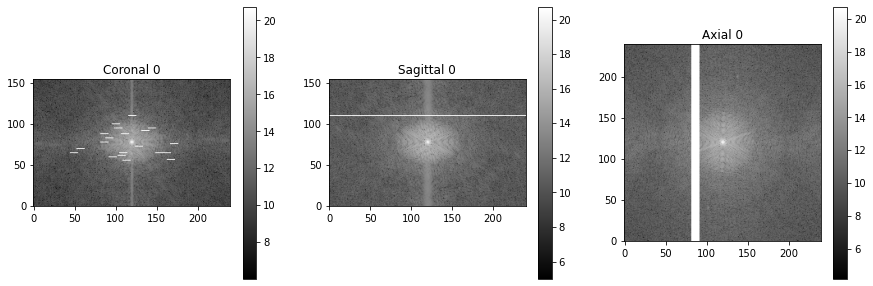

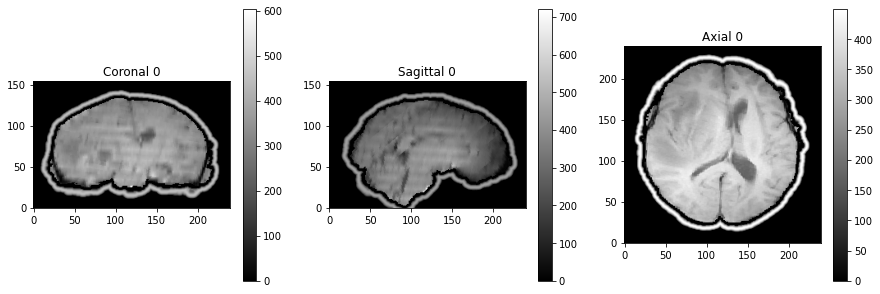

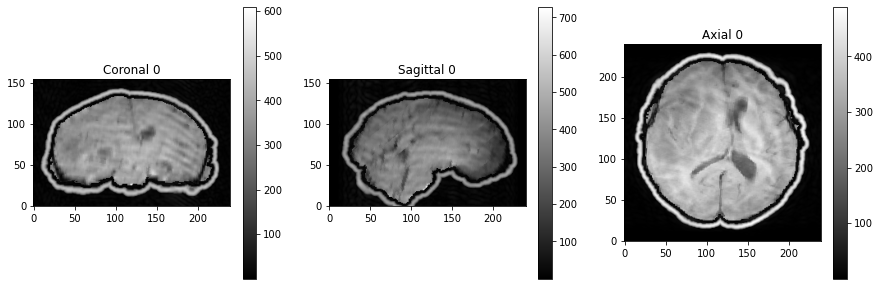

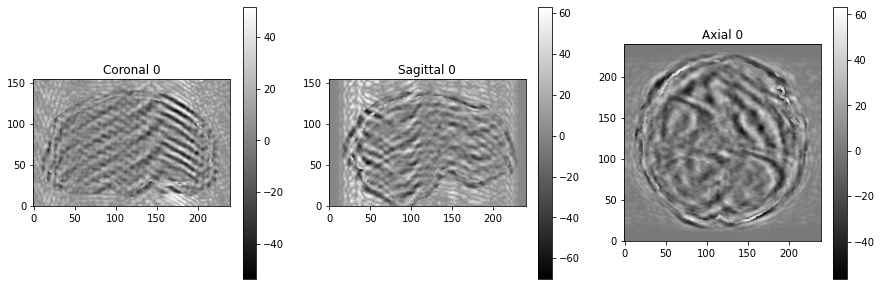

In [27]:
tp = np.transpose(transformed,axes = [1,0,2])
bg = mri_utils.get_min_background(tp)
dim = list(bg.shape)
bg = np.reshape(bg,(dim[0],dim[1],dim[2]))
fg = np.logical_not(bg)

aV = add_fake_skull(tp)
artV = add_rotation_motion_artifact(aV,nKL = 20, nSz = 5,random_seed=1)
diffMat = np.abs(artV[fg]-tp[fg])
print(np.percentile(diffMat,95),np.percentile(diffMat,80),np.mean(diffMat),np.std(diffMat))
# artV = np.transpose(artV, axes = [2,1,0])
# artVOO = affine.transform_inverse(artV,interpolation = 'nearest')


100%|██████████| 10/10 [00:28<00:00,  2.82s/it]


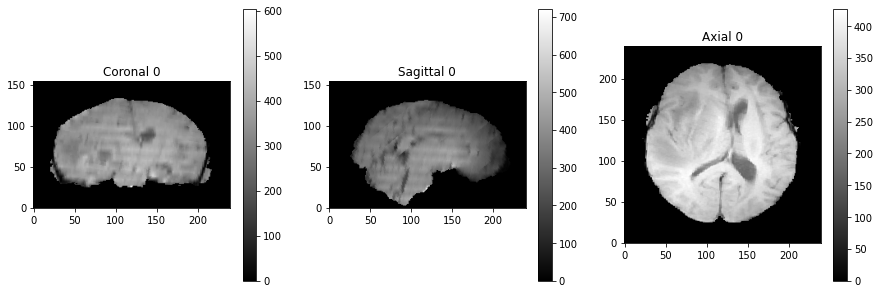

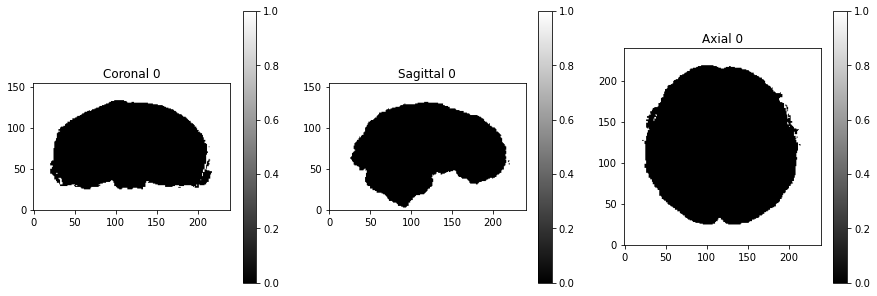

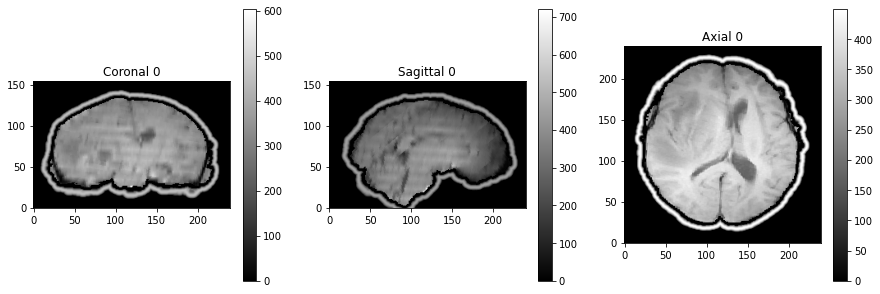

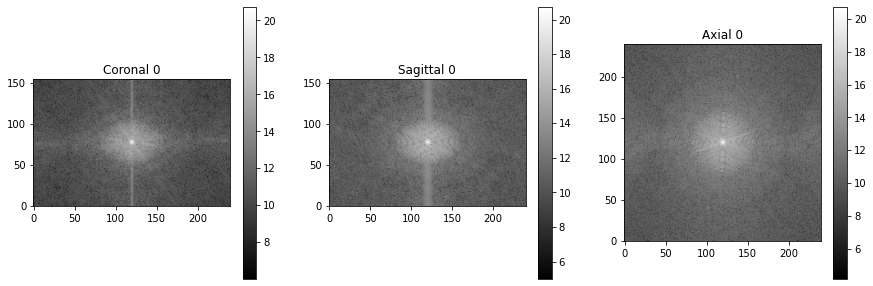

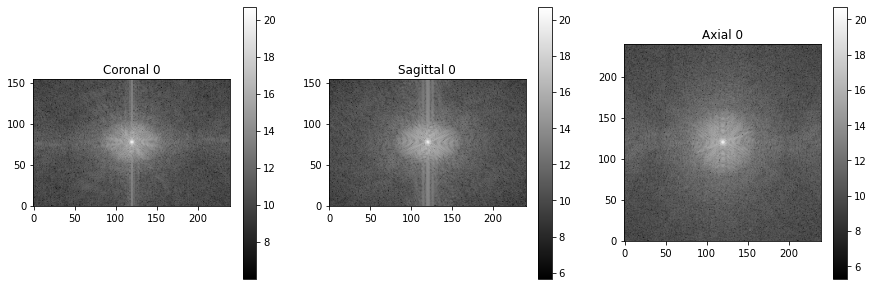

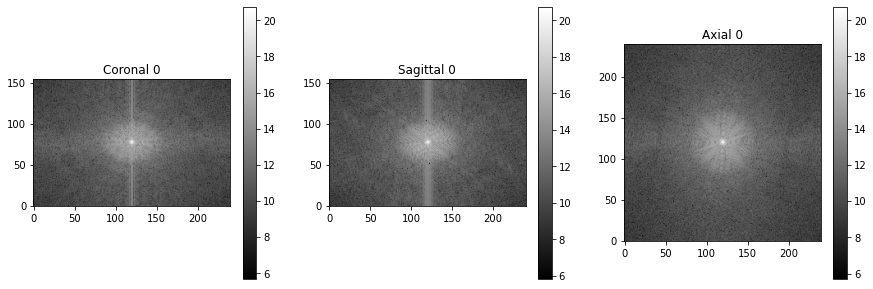

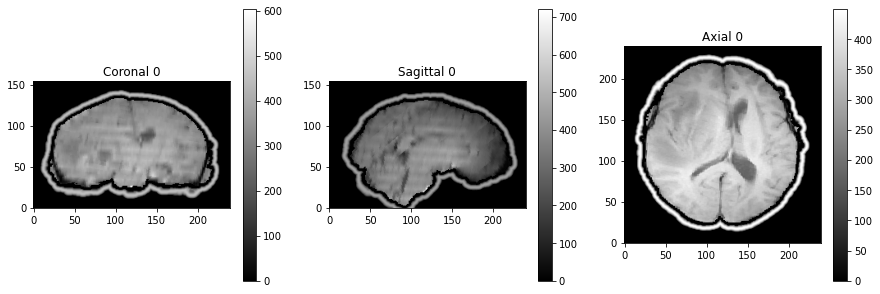

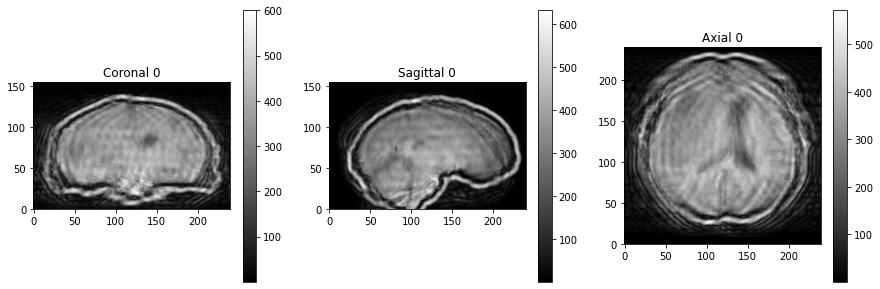

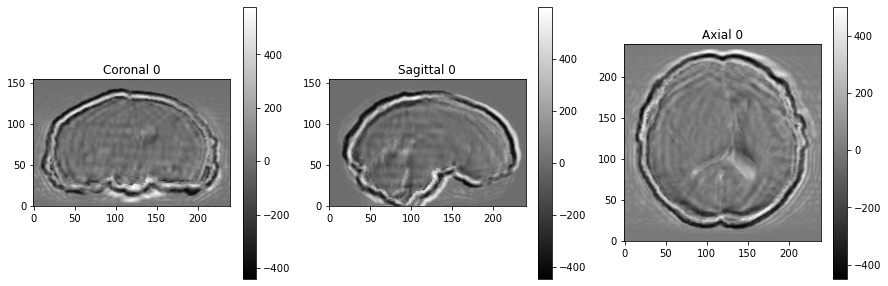

In [333]:
tp = np.transpose(transformed,axes = [1,0,2])
aV = add_fake_skull(tp)
artV = add_stepwise_rotation_motion_artifact(aV,random_seed=1)

# 2D stepwise motion

100%|██████████| 10/10 [00:23<00:00,  2.31s/it]
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/ipykernel_launcher.py:111: RuntimeWarning: divide by zero encountered in log
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/ipykernel_launcher.py:112: RuntimeWarning: divide by zero encountered in log


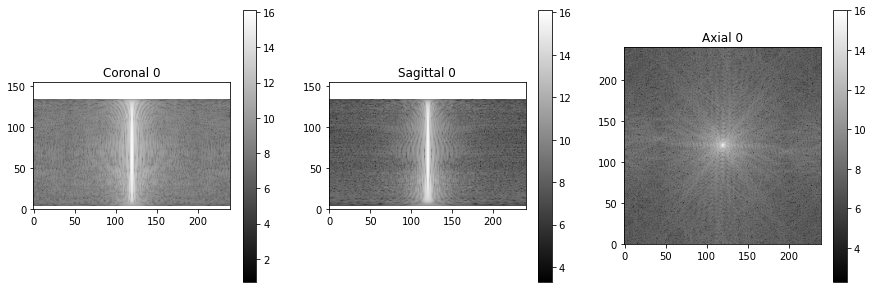

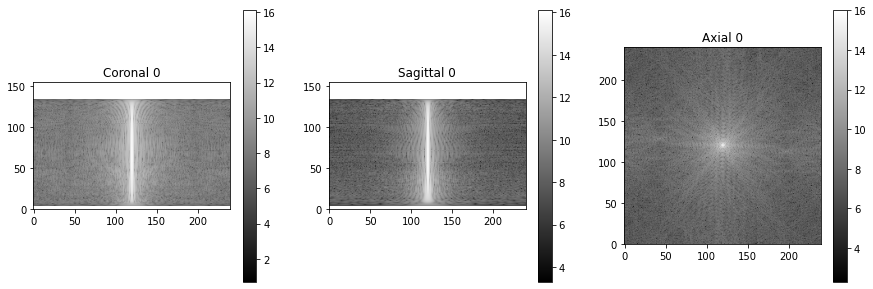

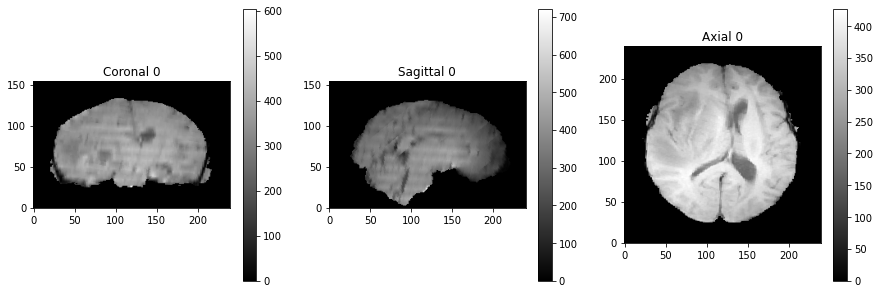

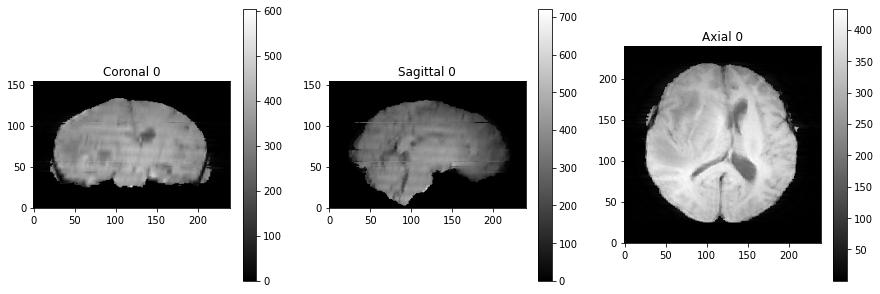

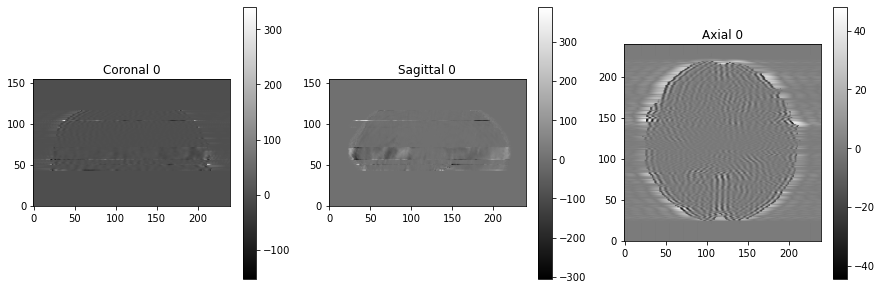

In [26]:
inArr = np.transpose(transformed,axes = [1,0,2])
nKL = 10
phEnc = 0
frEnc = 1
thRot = np.pi/48
phRot = np.pi/12
scale = .125
random_seed=None
dispTF=True
    
# fftV = np.fft.fftn(inArr)
# cfftV = np.fft.fftshift(fftV)
cfftV = np.zeros(inArr.shape,dtype=np.complex_)
for othIdx in range(inArr.shape[2]):
    cfftSlice = np.fft.fftshift(np.fft.fftn(inArr[:,:,othIdx]))
    cfftV[:,:,othIdx] = cfftSlice

dim = list(inArr.shape)
afftV = cfftV.copy()


# create a grid in frequency space
iv = np.arange(dim[0]) - dim[0]/2
jv = np.arange(dim[1]) - dim[1]/2
kv = np.arange(dim[2]) - dim[2]/2
# ig, jg ,kg = np.meshgrid(iv, jv, kv, indexing='ij', sparse=True)

cFFTInterp = RegularGridInterpolator((iv, jv, kv), cfftV,fill_value=np.mean(cfftV),
                                     bounds_error=False,method='nearest')

np.random.seed(random_seed)

# randPhase = (np.random.rand(nKL) - .5)*0 
phEnc = 0
frEnc = 1
othDim = list(set([0,1,2])-set([phEnc,frEnc]))[0]

# chVec1 = np.random.randint(dim[frEnc],size = (nKL+1,1))
# chVec2 = np.random.randint(dim[othDim],size = (nKL+1,1))

chVec1 = np.random.normal(loc = dim[phEnc]/2, scale = dim[phEnc]*scale,size = (nKL+1,1))
chVec1[chVec1<0] = 0
chVec1[chVec1>dim[phEnc]] = dim[phEnc]
chVec1 = chVec1.astype(int)
chVec2 = np.random.normal(loc = dim[othDim]/2, scale = dim[othDim]*scale,size = (nKL+1,1))
chVec2[chVec2<0] = 0
chVec2[chVec2>dim[othDim]] = dim[othDim]
chVec2 = chVec2.astype(int)

idxVec = np.hstack((chVec2,chVec1))

sIdxVec = idxVec[np.lexsort(idxVec.T[::])] # sort by first column then second column if matched
sIdxVec = sIdxVec[:,[1,0]] # swap so we're actually sorting by other dim, then frequency encoding
#     print(sIdxVec)
randTheta = (np.random.rand(nKL) - .5)*2 * thRot
randPhi = (np.random.rand(nKL) - .5)*2 * phRot

prevCoords = np.array([0,0])
dimOrder = [frEnc,phEnc,othDim]
#     dimOrder = [othDim,phEnc,frEnc]
iOrder = [np.where(np.array(dimOrder) == idx)[0][0] for idx in [0,1,2]]
#     print(dimOrder,iOrder)
rDim = [dim[dN] for dN in dimOrder]
afftFlat = np.transpose(afftV,dimOrder).flatten(order='F')

for kIdx in tqdm(range(nKL)):
# for kIdx in tqdm(range(1)):
    pSub = [dim[frEnc]-1,sIdxVec[kIdx,0],sIdxVec[kIdx,1]]
    cSub = [dim[frEnc]-1,sIdxVec[kIdx+1,0],sIdxVec[kIdx+1,1]]

    prevIdx = np.ravel_multi_index(pSub,rDim,order='F')
    ravIdx = np.ravel_multi_index(cSub,rDim,order='F')
    rVol = rotate_translate_img_vol(inArr.copy(),randTheta[kIdx], randPhi[kIdx])
    for othIdx in range(pSub[2],cSub[2]+1):
        rfftSlice = np.fft.fftshift(np.fft.fftn(rVol[:,:,othIdx]))
        if othIdx != pSub[2]:
            pXYSub = [pSub[0],pSub[1],othIdx]
        else: 
            pXYSub = [0,0,othIdx] # start of the plane
        
        if othIdx != cSub[2]:
            cXYSub = [cSub[0],cSub[1],othIdx]
        else:
            cXYSub = [rDim[0]-1,rDim[1]-1,othIdx] # end of the plane
        
        pRRavIdx = np.ravel_multi_index(pXYSub,rDim,order='F')
        cRRavIdx = np.ravel_multi_index(cXYSub,rDim,order='F')
        pRXYIdx = np.ravel_multi_index(pXYSub[0:2],rDim[0:2],order='F')
        cRXYIdx = np.ravel_multi_index(cXYSub[0:2],rDim[0:2],order='F')
        
        rfftFlat = rfftSlice.flatten(order='F')
#         print((pRRavIdx,cRRavIdx),(pRXYIdx,cRXYIdx))
#         afftFlat[pRRavIdx:cRRavIdx] = rfftFlat[pRXYIdx:cRXYIdx]
        cAFFTSl = afftV[:,:,othIdx]
        cAFFTFlat = cAFFTSl.flatten(order='F')
        cAFFTFlat[pRXYIdx:cRXYIdx] = rfftFlat[pRXYIdx:cRXYIdx]
        cAFFTSl = cAFFTFlat.reshape(rDim[0:2],order='F')
        afftV[:,:,othIdx] = cAFFTSl
#         afftV
#     print(dimOrder,rDim,pSub,cSub,prevIdx,ravIdx)

# print(chPt)
# afftV = afftFlat.reshape(rDim,order='F').transpose(iOrder)

aV = np.zeros(inArr.shape)
uV = np.zeros(inArr.shape)
for othIdx in range(inArr.shape[2]):
    aV[:,:,othIdx] = np.abs(np.fft.ifftn(np.fft.ifftshift(afftV[:,:,othIdx])))
    uV[:,:,othIdx] = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftV[:,:,othIdx])))
if dispTF:
    mri_utils.plot_img_arr(np.log(np.abs(cfftV)))
    mri_utils.plot_img_arr(np.log(np.abs(afftV)))
    # mri_utils.plot_img_arr(np.log(np.abs(kfftV)))
#     mri_utils.plot_img_arr(np.log(np.abs(rfftV)))


    mri_utils.plot_img_arr(uV)


    mri_utils.plot_img_arr(aV)

    mri_utils.plot_img_arr(aV-uV)


# 2D rotation (simultaneous)

100%|██████████| 10/10 [00:25<00:00,  2.55s/it]
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: divide by zero encountered in log
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in log


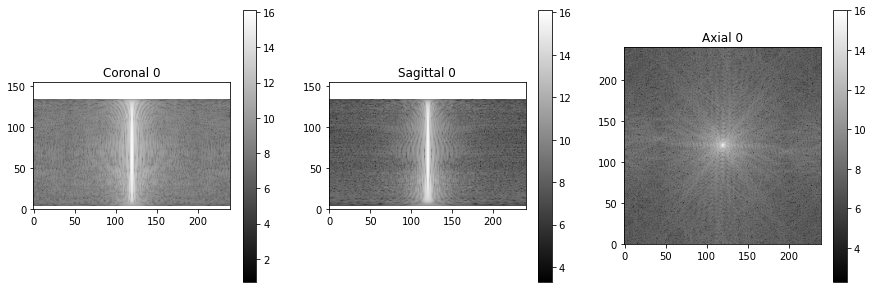

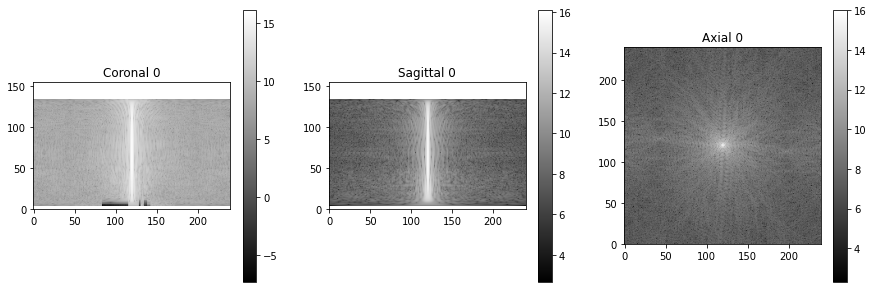

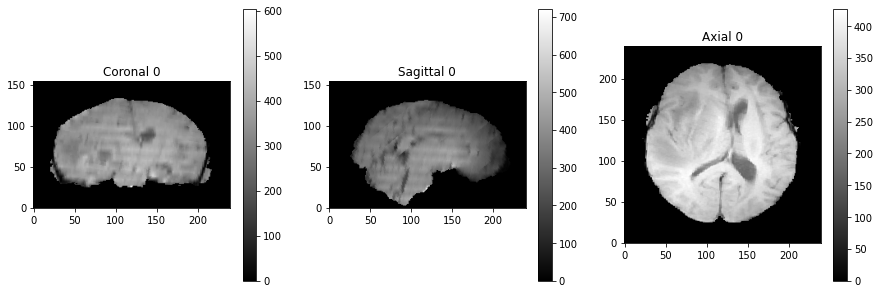

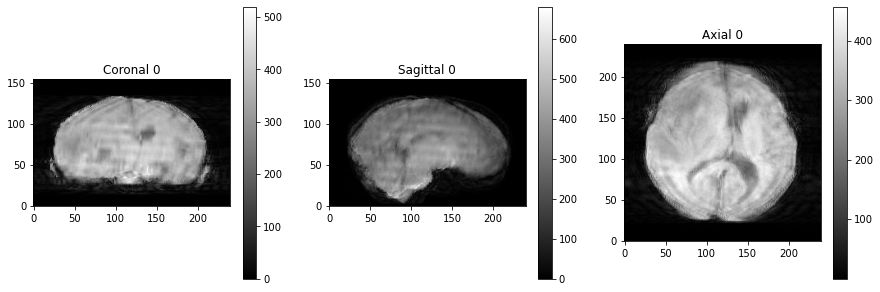

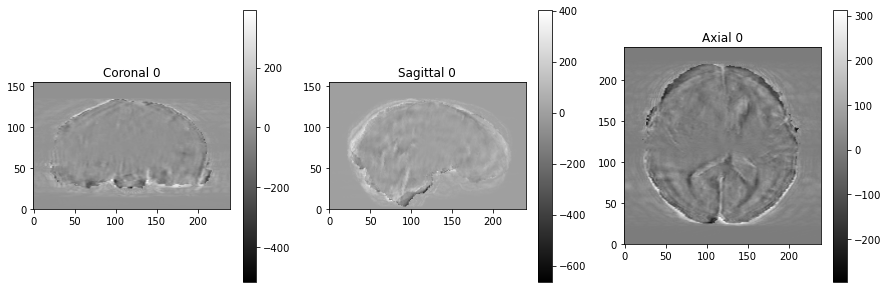

In [28]:
inArr = np.transpose(transformed,axes = [1,0,2])
nKL = 10
phEnc = 0
frEnc = 1
thRot = np.pi/48
phRot = np.pi/12
scale = .125
random_seed=None
dispTF=True
    
# fftV = np.fft.fftn(inArr)
# cfftV = np.fft.fftshift(fftV)
cfftV = np.zeros(inArr.shape,dtype=np.complex_)
for othIdx in range(inArr.shape[2]):
    cfftSlice = np.fft.fftshift(np.fft.fftn(inArr[:,:,othIdx]))
    cfftV[:,:,othIdx] = cfftSlice

dim = list(inArr.shape)
afftV = cfftV.copy()


# create a grid in frequency space
iv = np.arange(dim[0]) - dim[0]/2
jv = np.arange(dim[1]) - dim[1]/2
kv = np.arange(dim[2]) - dim[2]/2
# ig, jg ,kg = np.meshgrid(iv, jv, kv, indexing='ij', sparse=True)

cFFTInterp = RegularGridInterpolator((iv, jv, kv), cfftV,fill_value=np.mean(cfftV),
                                     bounds_error=False,method='nearest')

np.random.seed(random_seed)

# randPhase = (np.random.rand(nKL) - .5)*0 
phEnc = 0
frEnc = 1
othDim = list(set([0,1,2])-set([phEnc,frEnc]))[0]

# chVec1 = np.random.randint(dim[frEnc],size = (nKL+1,1))
# chVec2 = np.random.randint(dim[othDim],size = (nKL+1,1))

chVec1 = np.random.normal(loc = dim[phEnc]/2, scale = dim[phEnc]*scale,size = (nKL+1,1))
chVec1[chVec1<0] = 0
chVec1[chVec1>dim[phEnc]] = dim[phEnc]
chVec1 = chVec1.astype(int)
chVec2 = np.random.normal(loc = dim[frEnc]/2, scale = dim[frEnc]*scale,size = (nKL+1,1))
chVec2[chVec2<0] = 0
chVec2[chVec2>dim[frEnc]] = dim[frEnc]
chVec2 = chVec2.astype(int)

idxVec = np.hstack((chVec2,chVec1))

sIdxVec = idxVec[np.lexsort(idxVec.T[::])] # sort by first column then second column if matched
sIdxVec = sIdxVec[:,[1,0]] # swap so we're actually sorting by other dim, then frequency encoding
#     print(sIdxVec)
randTheta = (np.random.rand(nKL) - .5)*2 * thRot
randPhi = (np.random.rand(nKL) - .5)*2 * phRot

prevCoords = np.array([0,0])
dimOrder = [frEnc,phEnc,othDim]
#     dimOrder = [othDim,phEnc,frEnc]
iOrder = [np.where(np.array(dimOrder) == idx)[0][0] for idx in [0,1,2]]
#     print(dimOrder,iOrder)
rDim = [dim[dN] for dN in dimOrder]
afftFlat = np.transpose(afftV,dimOrder).flatten(order='F')

# undefined for some regions
othMaxValue = np.amax(np.abs(cfftV),axis=(frEnc,phEnc))
othIdxNZ = othMaxValue.nonzero()[0]

for kIdx in tqdm(range(nKL)):
# for kIdx in tqdm(range(1)):
    pSub = [sIdxVec[kIdx,1],sIdxVec[kIdx,0]]
    cSub = [sIdxVec[kIdx+1,1],sIdxVec[kIdx+1,0]]

    rVol = rotate_translate_img_vol(inArr.copy(),randTheta[kIdx], randPhi[kIdx])
    for othIdx in othIdxNZ:
#     for othIdx in range(dim[othDim]):
        rfftSlice = np.fft.fftshift(np.fft.fftn(rVol[:,:,othIdx]))
        pXYSub = [pSub[0],pSub[1]]
        cXYSub = [cSub[0],cSub[1]]
        
        pRXYIdx = np.ravel_multi_index(pXYSub,rDim[0:2],order='F')
        cRXYIdx = np.ravel_multi_index(cXYSub,rDim[0:2],order='F')
        
        rfftFlat = rfftSlice.flatten(order='F')
#         print(othIdx,(pXYSub,cXYSub),(pRXYIdx,cRXYIdx))
#         afftFlat[pRRavIdx:cRRavIdx] = rfftFlat[pRXYIdx:cRXYIdx]
        cAFFTSl = afftV[:,:,othIdx]
        cAFFTFlat = cAFFTSl.flatten(order='F')
        cAFFTFlat[pRXYIdx:cRXYIdx] = rfftFlat[pRXYIdx:cRXYIdx]
        cAFFTSl = cAFFTFlat.reshape(rDim[0:2],order='F')
        afftV[:,:,othIdx] = cAFFTSl
#         afftV
#     print(dimOrder,rDim,pSub,cSub,prevIdx,ravIdx)

# print(chPt)
# afftV = afftFlat.reshape(rDim,order='F').transpose(iOrder)

aV = np.zeros(inArr.shape)
uV = np.zeros(inArr.shape)
for othIdx in range(inArr.shape[2]):
    aV[:,:,othIdx] = np.abs(np.fft.ifftn(np.fft.ifftshift(afftV[:,:,othIdx])))
    uV[:,:,othIdx] = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftV[:,:,othIdx])))
if dispTF:
    mri_utils.plot_img_arr(np.log(np.abs(cfftV)))
    mri_utils.plot_img_arr(np.log(np.abs(afftV)))
    # mri_utils.plot_img_arr(np.log(np.abs(kfftV)))
#     mri_utils.plot_img_arr(np.log(np.abs(rfftV)))


    mri_utils.plot_img_arr(uV)
    mri_utils.plot_img_arr(aV)

    mri_utils.plot_img_arr(aV-uV)


100%|██████████| 10/10 [00:27<00:00,  2.70s/it]
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in log


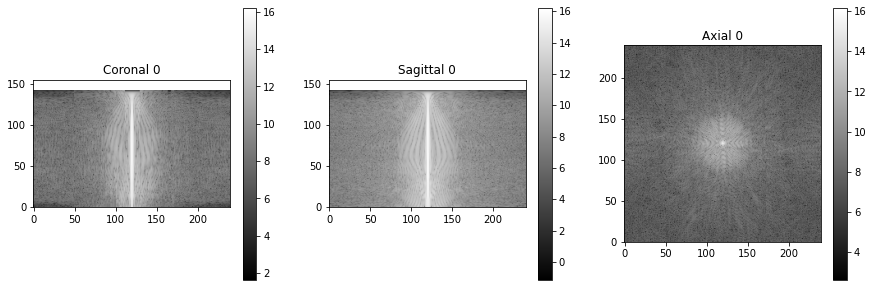

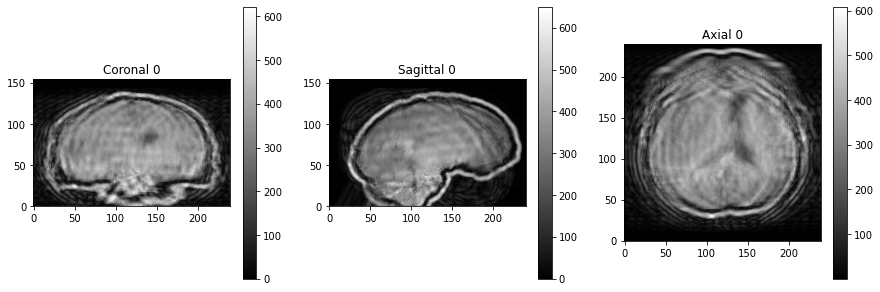

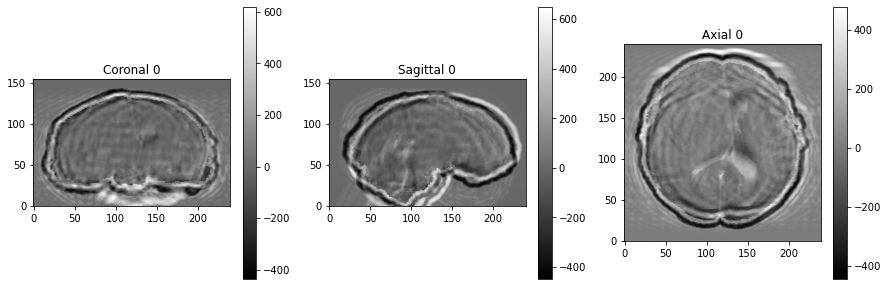

In [523]:

tp = np.transpose(transformed,axes = [1,0,2])
aV = add_fake_skull(tp,dispTF=False)
artV = add_2d_rotation_motion_artifact(aV,random_seed=1)



# 2D episodic rotation (simultaneous)

100%|██████████| 10/10 [01:05<00:00,  6.53s/it]
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/ipykernel_launcher.py:59: RuntimeWarning: divide by zero encountered in log
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/ipykernel_launcher.py:60: RuntimeWarning: divide by zero encountered in log
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: divide by zero encountered in log


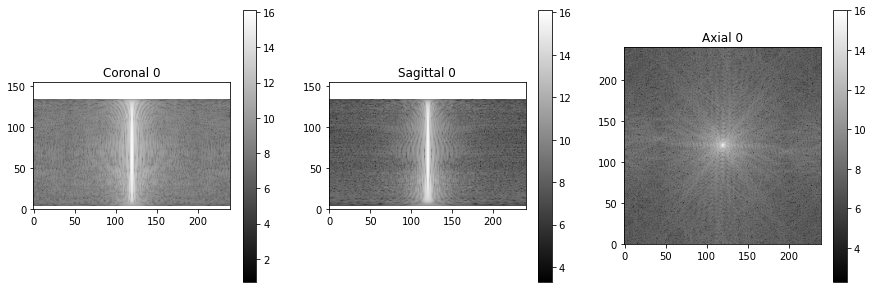

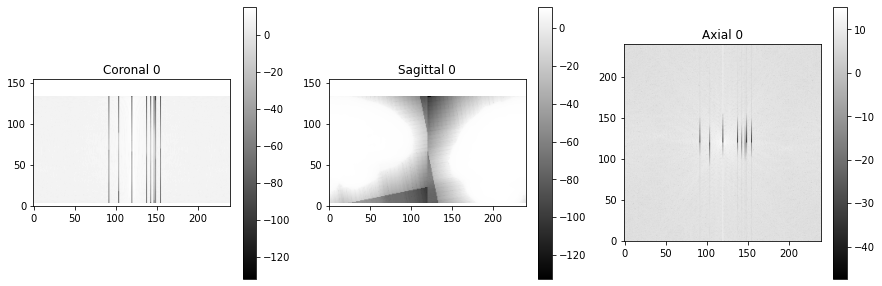

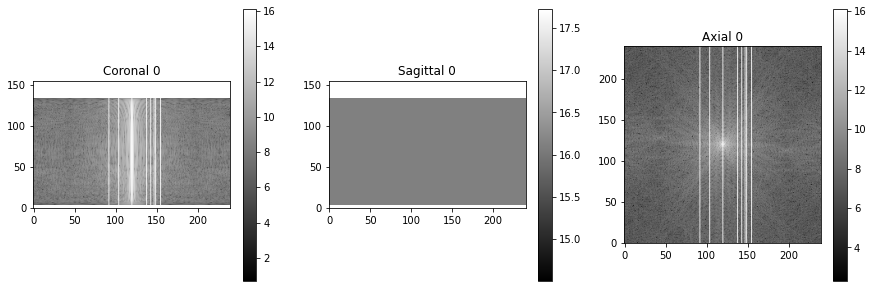

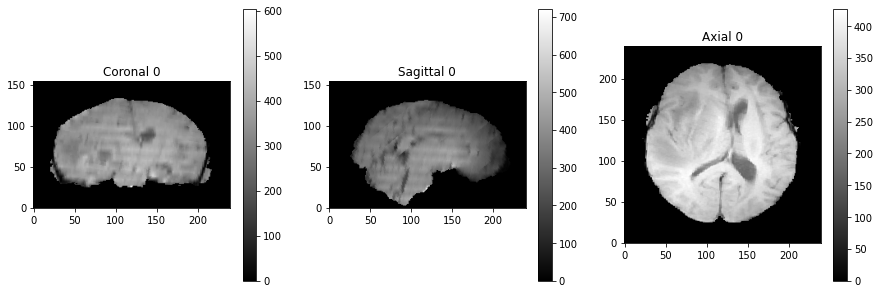

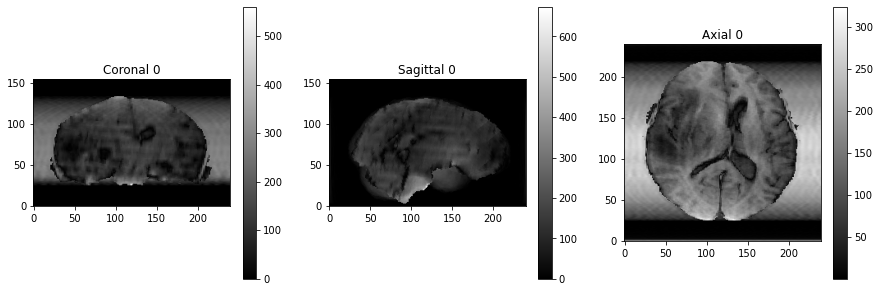

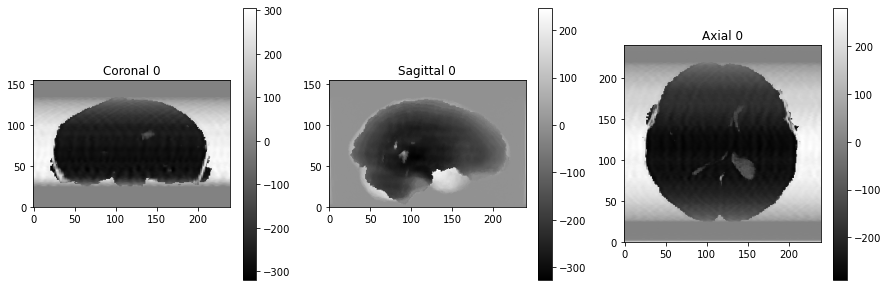

In [29]:
nSz = 1
cfftV = np.zeros(inArr.shape,dtype=np.complex_)
for othIdx in range(inArr.shape[2]):
    cfftSlice = np.fft.fftshift(np.fft.fftn(inArr[:,:,othIdx]))
    cfftV[:,:,othIdx] = cfftSlice

dim = list(inArr.shape)
afftV = cfftV.copy()
kfftV = cfftV.copy()

np.random.seed(random_seed)

# randPhase = (np.random.rand(nKL) - .5)*0 
phEnc = 1
frEnc = 0
othDim = list(set([0,1,2])-set([phEnc,frEnc]))[0]


chVec1 = np.random.normal(loc = dim[phEnc]/2, scale = dim[phEnc]/8,size = (nKL,1))
chVec1[chVec1<0] = 0
chVec1[chVec1>dim[othDim]] = dim[othDim]
chVec1 = chVec1.astype(int)

randTheta = (np.random.rand(nKL) - .5)*2 * thRot
randPhi = (np.random.rand(nKL) - .5)*2 * phRot
randXYZ = (np.random.rand(nKL,3) - .5)*2
randXYZ[:,0] = randXYZ[:,0] * dim[0]/20
randXYZ[:,1] = randXYZ[:,1] * dim[1]/20
randXYZ[:,2] = randXYZ[:,2] * dim[2]/20

# undefined for some regions
othMaxValue = np.amax(np.abs(cfftV),axis=(frEnc,phEnc))
othIdxNZ = othMaxValue.nonzero()[0]

for kIdx in tqdm(range(nKL)):
    rVol = rotate_translate_img_vol(inArr.copy(),randTheta[kIdx], randPhi[kIdx]) #randPhi[kIdx])
    
    for othIdx in othIdxNZ:
        rfftSlice = np.fft.fftshift(np.fft.fft(rVol[:,:,othIdx]))
        nI = dim[phEnc]
        chVec = np.zeros((nI,3))

        # create k-line vector
        chVec[:,frEnc] = np.arange(dim[frEnc])
        chVec[:,phEnc] = chVec1[kIdx]
        chVec[:,othDim] = othIdx
        chIVec = chVec.astype(int)

        afftV[chIVec[:,0],chIVec[:,1],chIVec[:,2]] = rfftSlice[chIVec[:,0],chIVec[:,1]].flatten()
        kfftV[chIVec[:,0],chIVec[:,1],chIVec[:,2]] = np.amax(np.abs(cfftV))
        
        
aV = np.zeros(inArr.shape)
uV = np.zeros(inArr.shape)
for othIdx in range(inArr.shape[2]):
    aV[:,:,othIdx] = np.abs(np.fft.ifftn(np.fft.ifftshift(afftV[:,:,othIdx])))
    uV[:,:,othIdx] = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftV[:,:,othIdx])))
if dispTF:
    mri_utils.plot_img_arr(np.log(np.abs(cfftV)))
    mri_utils.plot_img_arr(np.log(np.abs(afftV)))
    mri_utils.plot_img_arr(np.log(np.abs(kfftV)))
    mri_utils.plot_img_arr(uV)
    
    mri_utils.plot_img_arr(aV)
    mri_utils.plot_img_arr(aV-uV)


(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

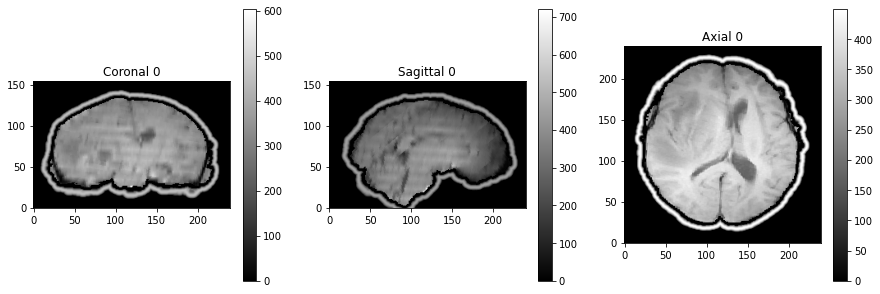

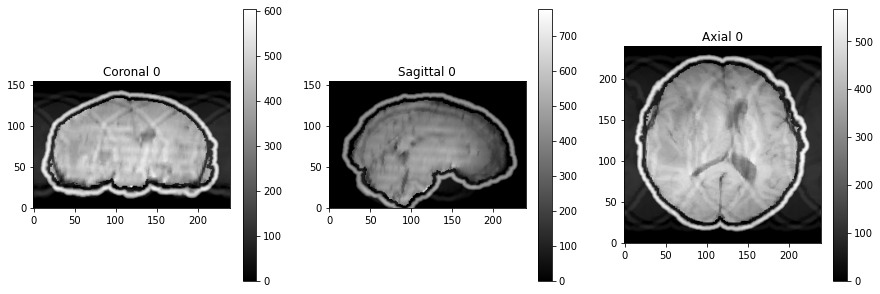

In [30]:
aV = add_fake_skull(inArr,dispTF=False)
artV = add_aliasing_artifact(aV,overlap=3,aliasMult=.1,dispTF=False)
mri_utils.plot_img_arr(aV)
mri_utils.plot_img_arr(artV)

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

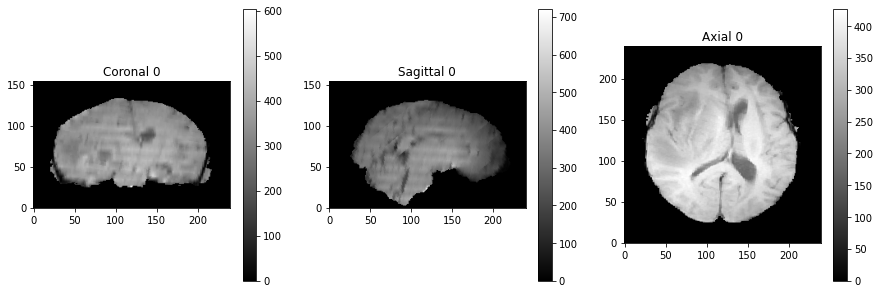

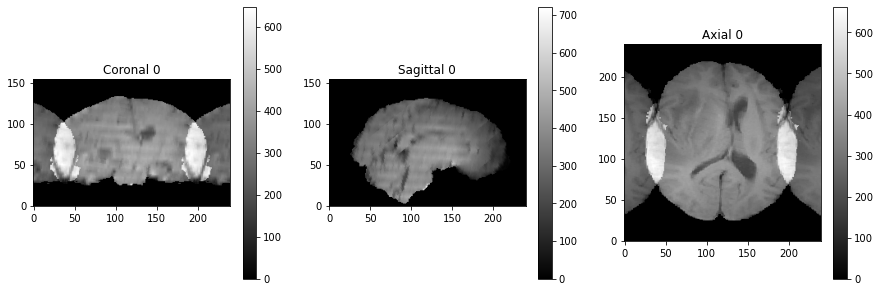

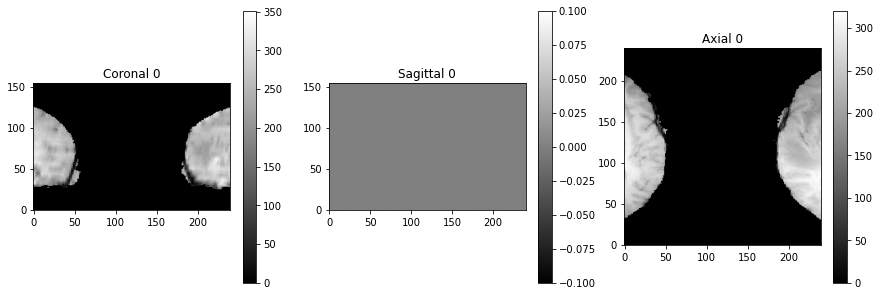

In [31]:
cfftV = np.fft.fftshift(np.fft.fftn(inArr))
afftV = cfftV.copy()
# afftV[:,0:80,:] = afftV[:,0:80,:] + afftV[:,-81:-1,:]
uV = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftV)))
aV = np.abs(np.fft.ifftn(np.fft.ifftshift(afftV)))
aV[:,:80,:] = inArr[:,:80,:] + (inArr[:,-80:,:] * .75)
aV[:,-80:,:] =  inArr[:,-80:,:] + (inArr[:,:80,:] * .75)

mri_utils.plot_img_arr(uV)

mri_utils.plot_img_arr(aV)
mri_utils.plot_img_arr(aV-uV)

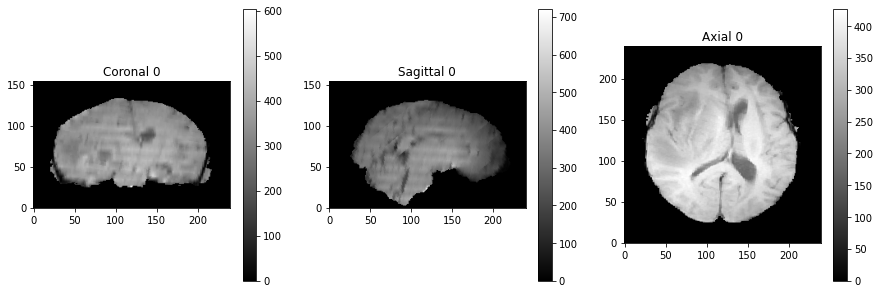

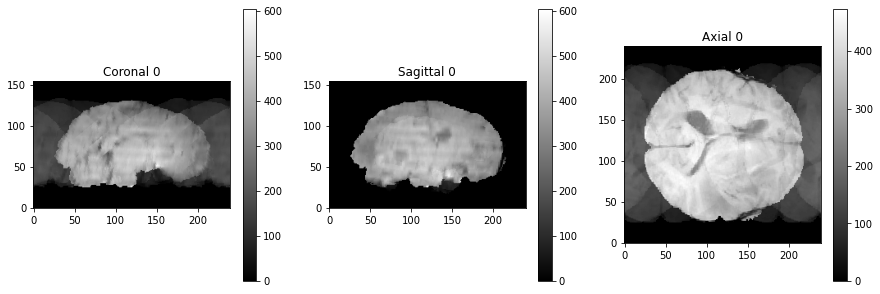

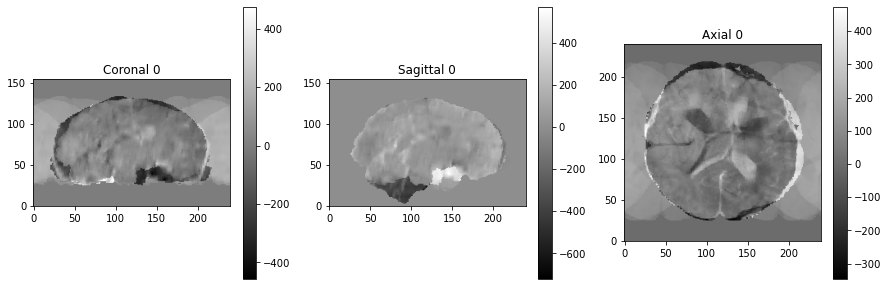

In [32]:
phEnc = 1
overlap = [.3,.5,.7]
aliasMult = .2
intMult = 1.1
dispTF = True

# make it so we put the phase encoding direction first
dimOrder = np.concatenate((np.asarray([phEnc]),np.setdiff1d([0,1,2],phEnc)))
iOrder = [np.where(np.array(dimOrder) == idx)[0][0] for idx in [0,1,2]] # invert transpose

tpV = np.transpose(inArr,dimOrder)
artV = tp.copy()

bg = mri_utils.get_min_background(inArr)
fg = np.transpose(np.logical_not(bg),dimOrder).astype(np.float)
ovLapReg = fg.copy()
dim = list(inArr.shape)
try:
    iter(overlap)
except Exception:
    overlap = [overlap] # put it in a list
for cOverlap in overlap:
    overlapAmt = round(dim[phEnc]*cOverlap)
    artV[:overlapAmt,:,:] = artV[:overlapAmt,:,:]  + (tpV[-overlapAmt:,:,:] * aliasMult)
    artV[-overlapAmt:,:,:] = artV[-overlapAmt:,:,:]  + (tpV[:overlapAmt,:,:] * aliasMult)


    # multiply by overlap to adjust how they add together
    ovLapReg[:overlapAmt,:,:] = ovLapReg[:overlapAmt,:,:]  + (fg[-overlapAmt:,:,:])
    ovLapReg[-overlapAmt:,:,:] = ovLapReg[-overlapAmt:,:,:]  + (fg[:overlapAmt,:,:])
    
ovLapReg[ovLapReg > 1] = (intMult/((aliasMult)+1)) ** (ovLapReg[ovLapReg > 1]-1) 
# intMult > 1 = constructive interference (additive)
# intMult < 1 destructive interference
outV = np.transpose(artV,iOrder)
ovLapReg = np.transpose(ovLapReg,iOrder)

outV = np.multiply(outV,ovLapReg)

if dispTF:
    mri_utils.plot_img_arr(inArr)
    mri_utils.plot_img_arr(outV)
    mri_utils.plot_img_arr(outV-inArr)

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

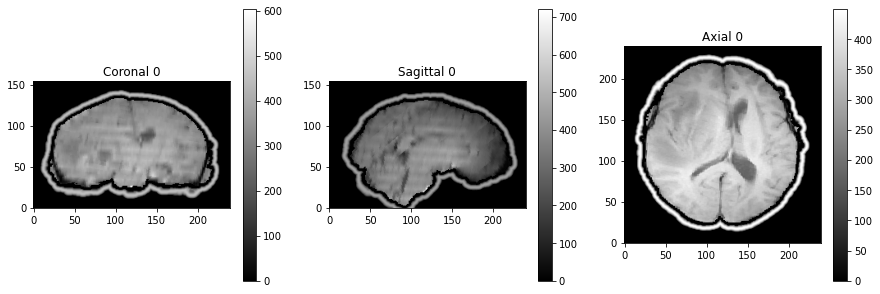

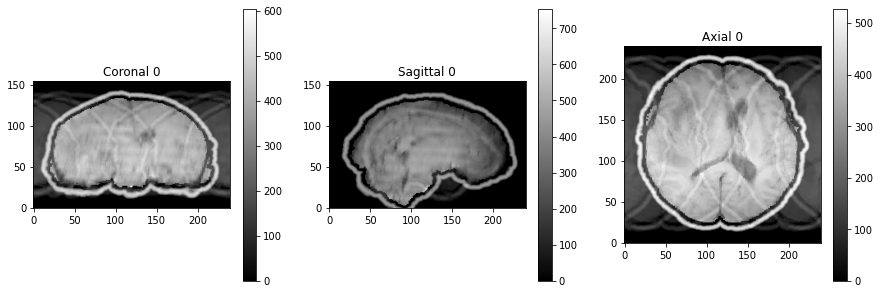

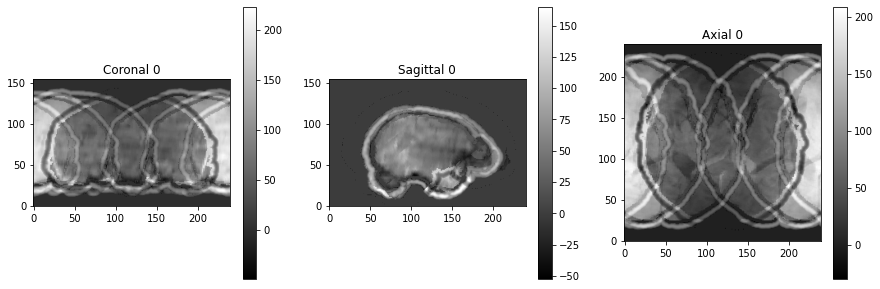

In [33]:
aV = add_fake_skull(inArr,dispTF=False)
artV = add_aliasing_artifact(aV,overlap=[.3,.5,.7],aliasMult=.2,dispTF=False)
mri_utils.plot_img_arr(aV)
mri_utils.plot_img_arr(artV)
mri_utils.plot_img_arr(artV-aV)

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

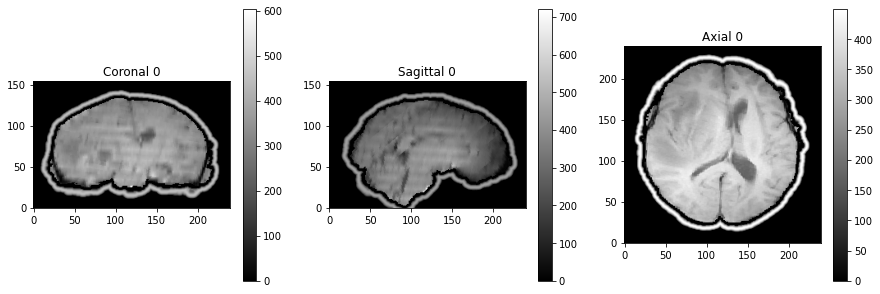

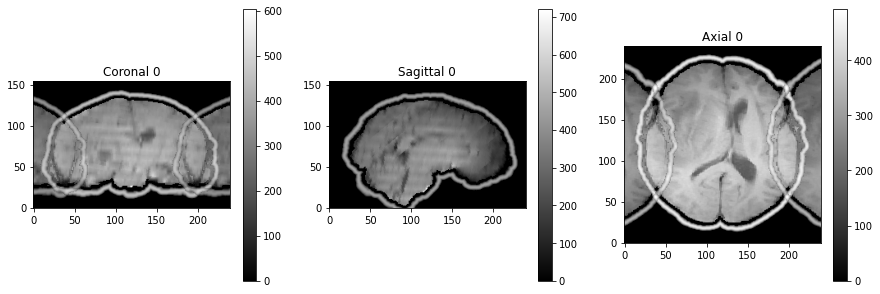

In [34]:
aV = add_fake_skull(inArr,dispTF=False)
artV = add_aliasing_artifact(aV,dispTF=False)
mri_utils.plot_img_arr(aV)
mri_utils.plot_img_arr(artV)

## recalculate foreground

In [36]:
bg = mri_utils.get_min_background(inArr)
if bg is None:
    bg = mri_utils.get_min_background(inArr)
dim = list(bg.shape)
bg = np.reshape(bg,(dim[0],dim[1],dim[2]))
fg = np.logical_not(bg)

# Calibration of Motion Artifact (unconstrained seed)

100%|██████████| 10/10 [00:27<00:00,  2.75s/it]
/data/ncwang/MRI_artifacts/code/mri_utils.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, axs = plt.subplots(nM,3,figsize=(15,(nM)*5),dpi = dpi)
100%|██████████| 10/10 [00:28<00:00,  2.87s/it]


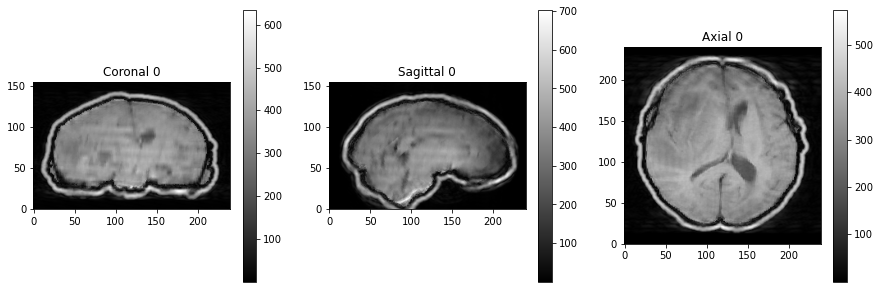

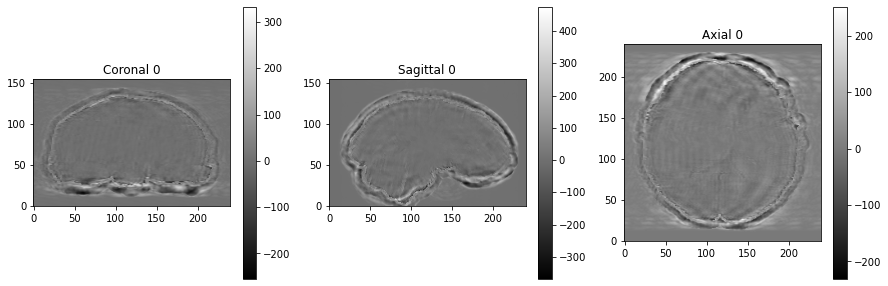

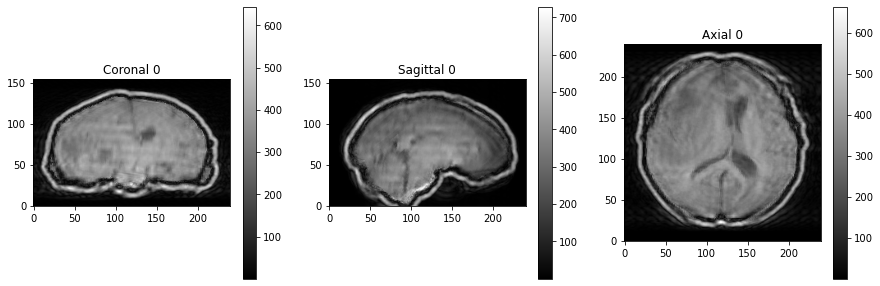

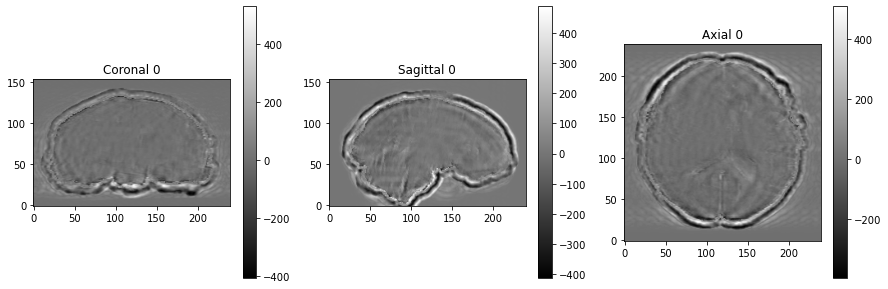

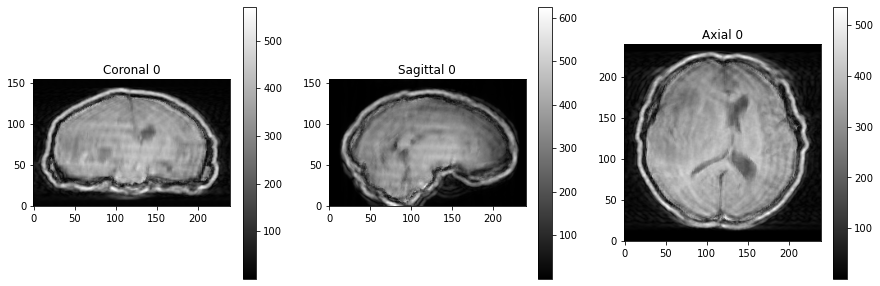

...

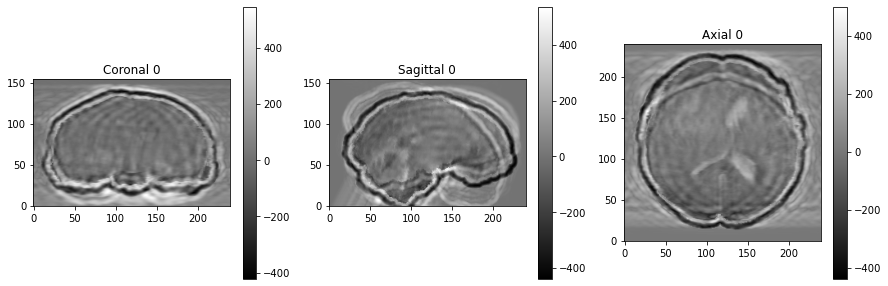

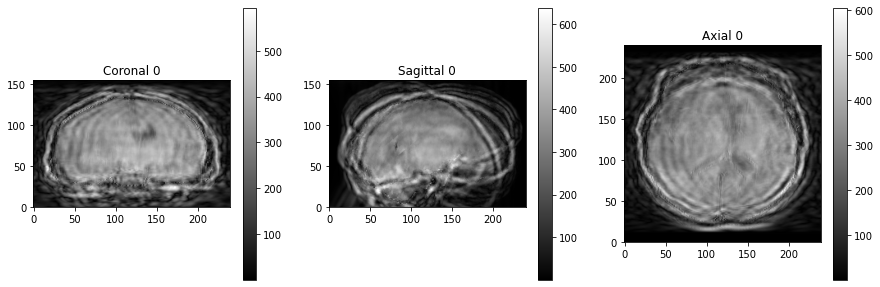

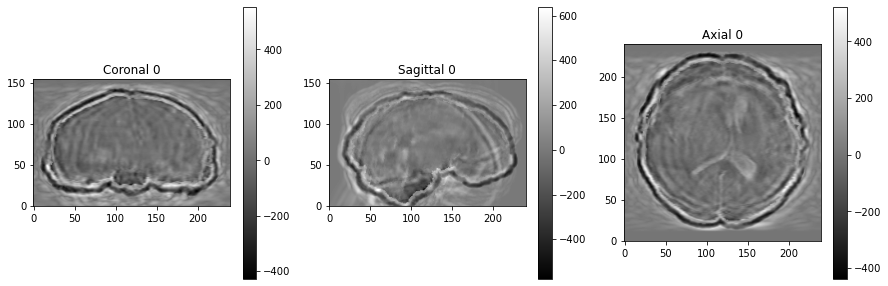

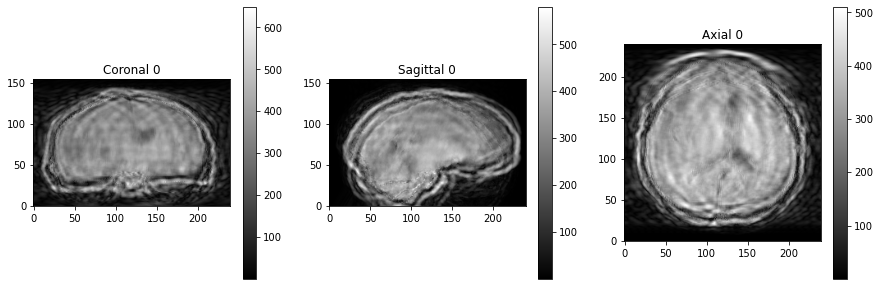

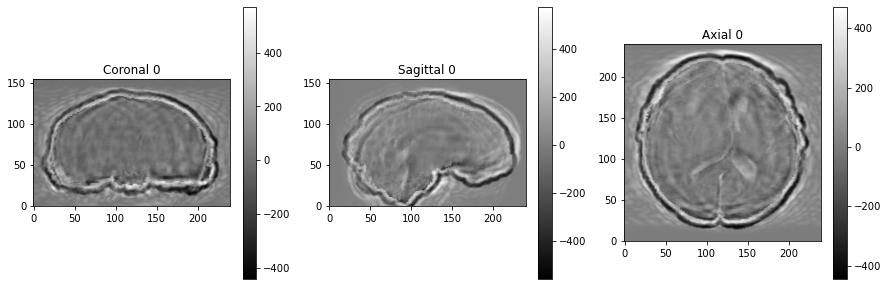

In [334]:
tp = np.transpose(transformed,axes = [1,0,2])
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])
testThetas = testFracs * np.pi/4
testPhis = testThetas * np.pi
sampAngDFDict = {}
nSamps = 1000
 

for thI in range(len(testThetas)):
    cFrac = testFracs[thI]
    cTheta = testThetas[thI]
    cPhi = testPhis[thI]
    aV = add_fake_skull(tp,dispTF=False)
    artV = add_stepwise_rotation_motion_artifact(aV,thRot=cTheta,phRot=cPhi,xyzTrMax=cFrac*24,
                                                 random_seed=thI,dispTF=False)
    diffMat = np.abs(artV[fg]-tp[fg])
    
    sDiffMat = np.sort(diffMat)
    sampIdxs = np.linspace(0,len(sDiffMat)-1,nSamps).astype(int)
    sSamps = sDiffMat[sampIdxs]
    sampDF = pd.DataFrame({'Fraction':np.ones(nSamps)*cFrac,'sNo': np.asarray(range(nSamps)),'val':sSamps})
    sampAngDFDict[thI] = sampDF
    mri_utils.plot_img_arr(artV)
    mri_utils.plot_img_arr(artV-aV)

Text(0, 0.5, 'Absolute Intensity Difference')

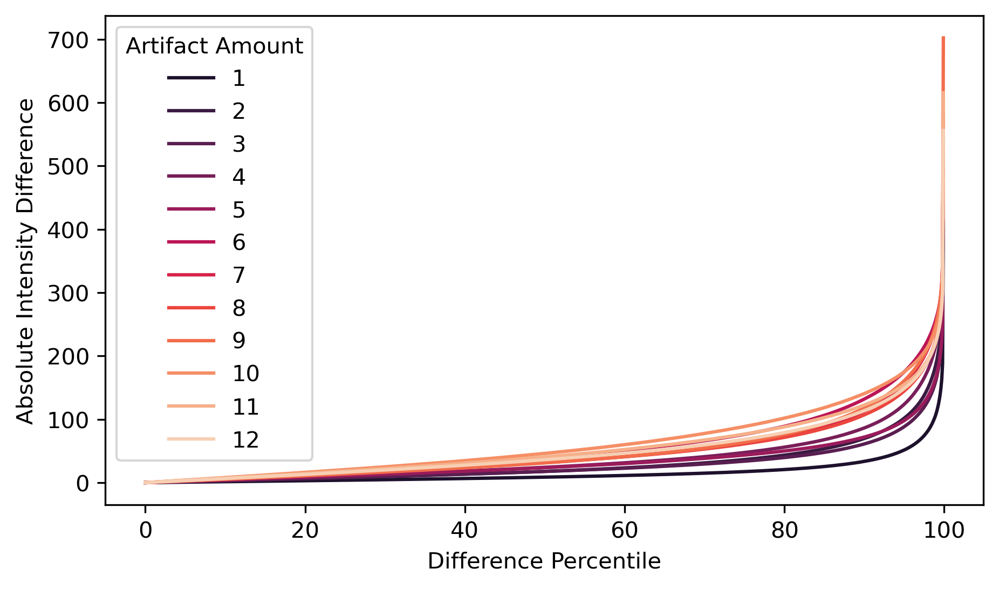

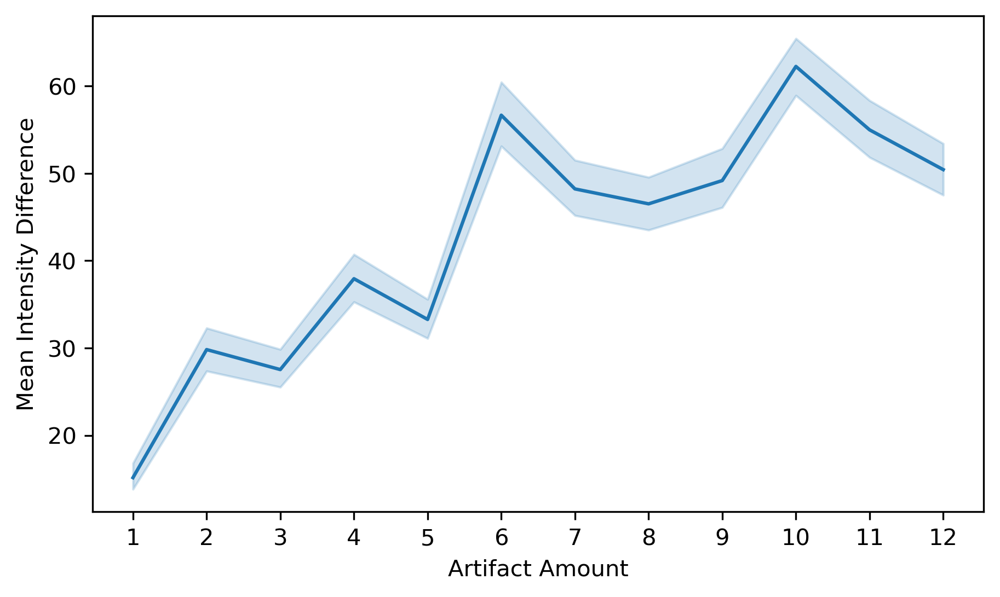

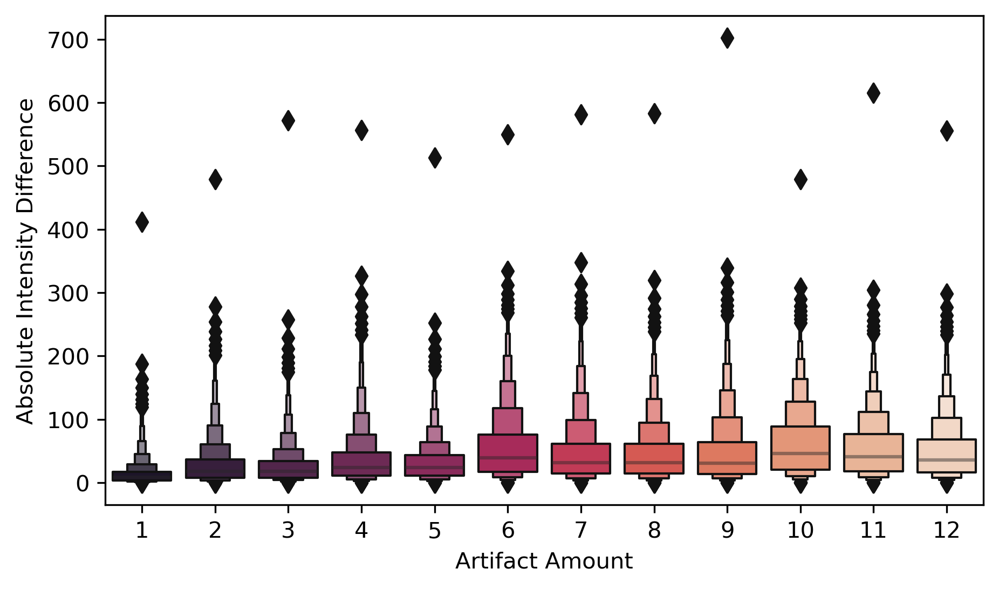

In [335]:
sampFDF = pd.concat(sampAngDFDict.values())
sampFDF['Artifact Amount'] = ['%i' % (frac * 48) for frac in sampFDF['Fraction']]

sampFDF['Difference Percentile'] = sampFDF['sNo']/10
plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Difference Percentile", y="val",hue='Artifact Amount',palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Artifact Amount", y="val")
hLP.set_ylabel('Mean Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.boxenplot(data=sampFDF,x="Artifact Amount", y="val",palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

# Calibration of Motion Artifact (Fixed Seed)

100%|██████████| 10/10 [00:27<00:00,  2.72s/it]
/data/ncwang/MRI_artifacts/code/mri_utils.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, axs = plt.subplots(nM,3,figsize=(15,(nM)*5),dpi = dpi)
100%|██████████| 10/10 [00:27<00:00,  2.74s/it]


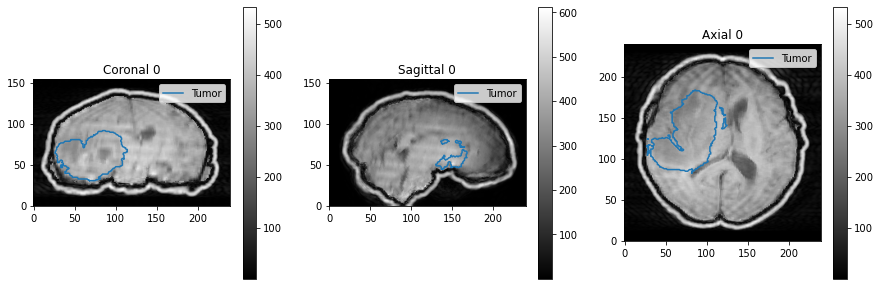

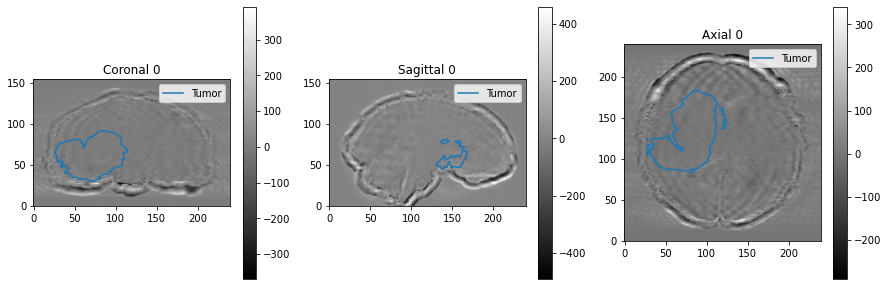

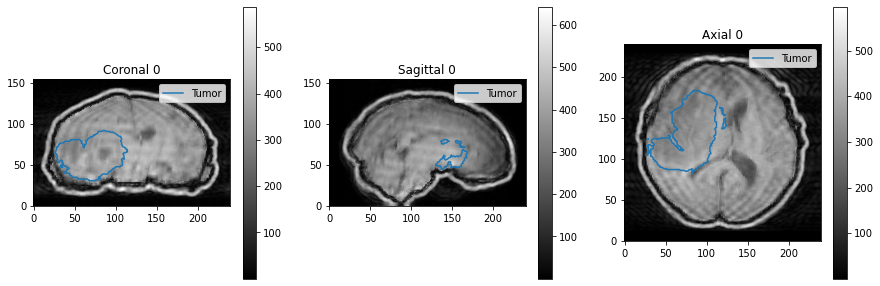

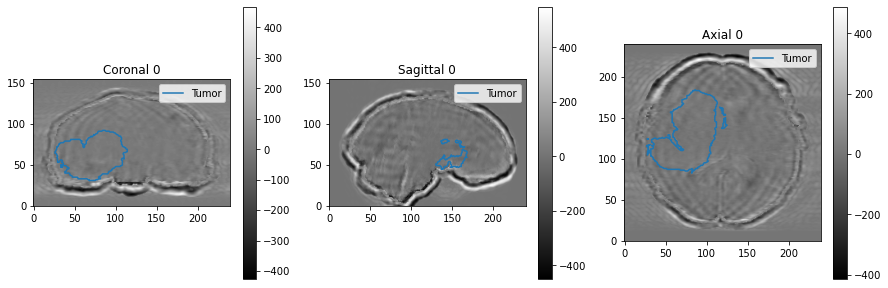

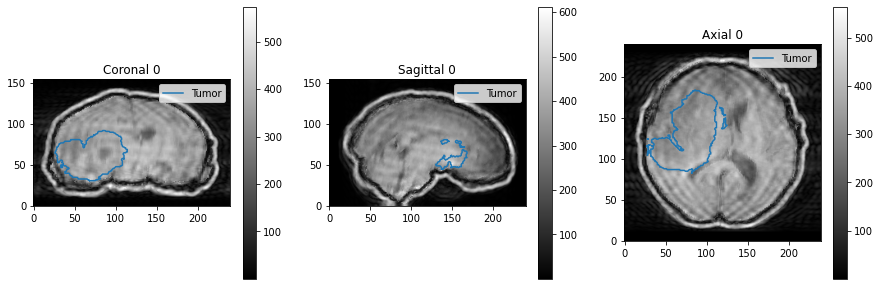

...

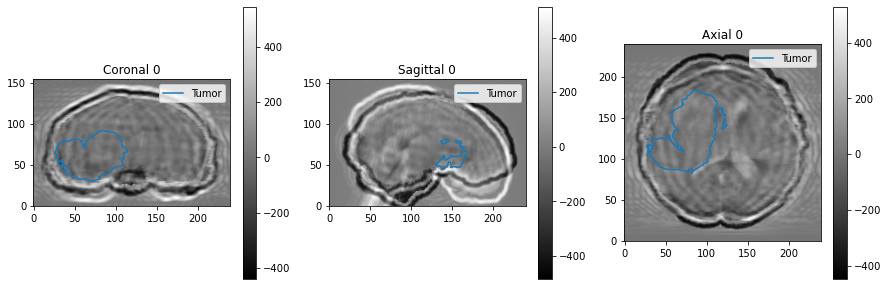

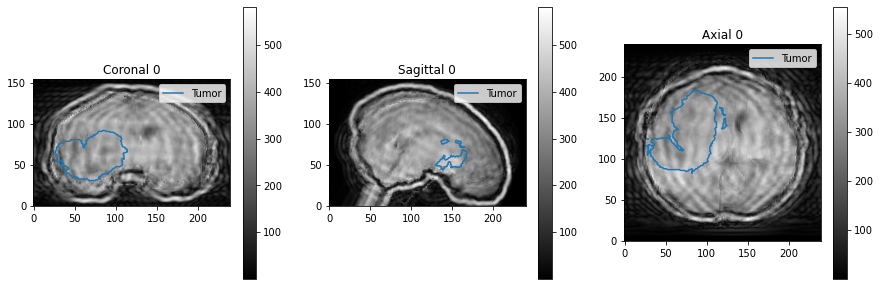

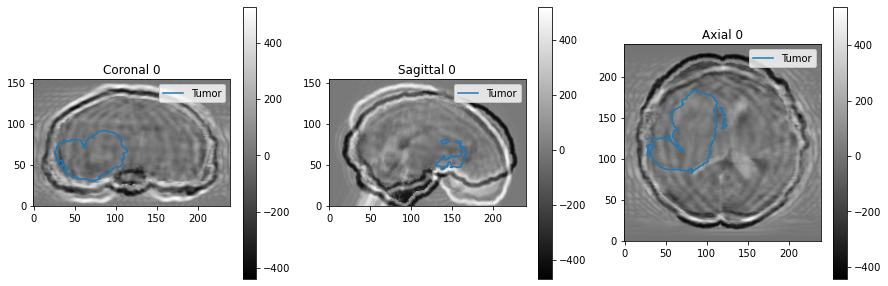

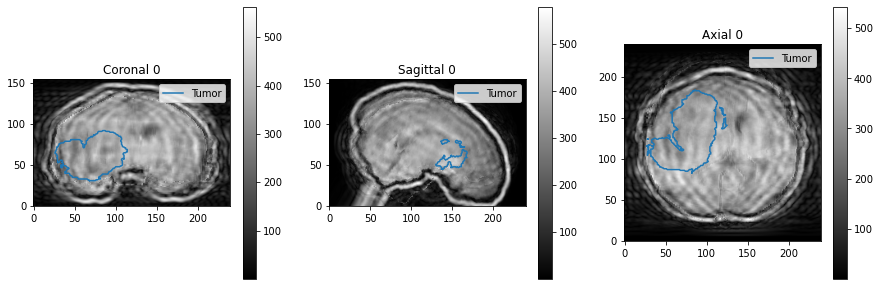

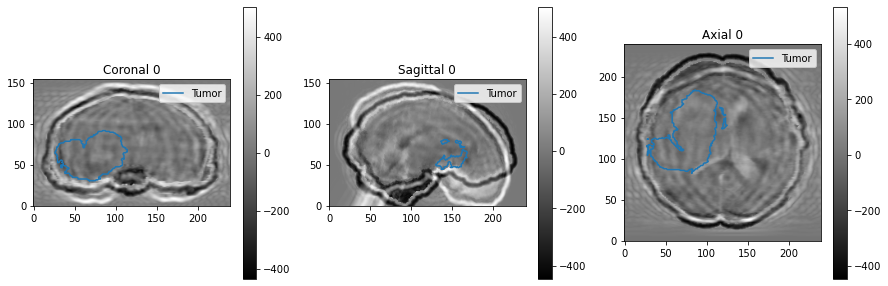

In [417]:
tp = np.transpose(transformed,axes = [1,0,2])
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])
testThetas = testFracs * np.pi/4
testPhis = testThetas * np.pi
sampSetDFDict = {}
nSamps = 1000

for thI in range(len(testThetas)):
    cFrac = testFracs[thI]
    cTheta = testThetas[thI]
    cPhi = testPhis[thI]
    aV = add_fake_skull(tp,dispTF=False)
    artV = add_stepwise_rotation_motion_artifact(aV,thRot=cTheta,phRot=cPhi,xyzTrMax = cFrac * 24,
                                                 random_seed=42,dispTF=False)
    diffMat = np.abs(artV[fg]-tp[fg])
    
    sDiffMat = np.sort(diffMat)
    sampIdxs = np.linspace(0,len(sDiffMat)-1,nSamps).astype(int)
    sSamps = sDiffMat[sampIdxs]
    sampDF = pd.DataFrame({'Fraction':np.ones(nSamps)*cFrac,'sNo': np.asarray(range(nSamps)),'val':sSamps})
    sampSetDFDict[thI] = sampDF
    mri_utils.plot_img_arr(artV,ctrArr=tp_lbl,ctrNames=['Tumor'])
    mri_utils.plot_img_arr(artV-aV,ctrArr=tp_lbl,ctrNames=['Tumor'])

Text(0, 0.5, 'Absolute Intensity Difference')

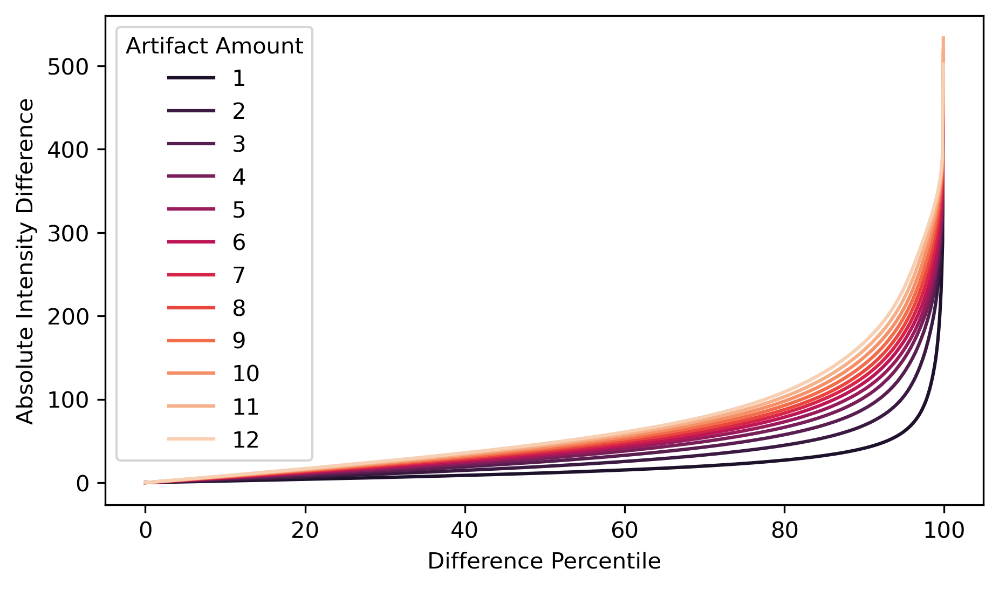

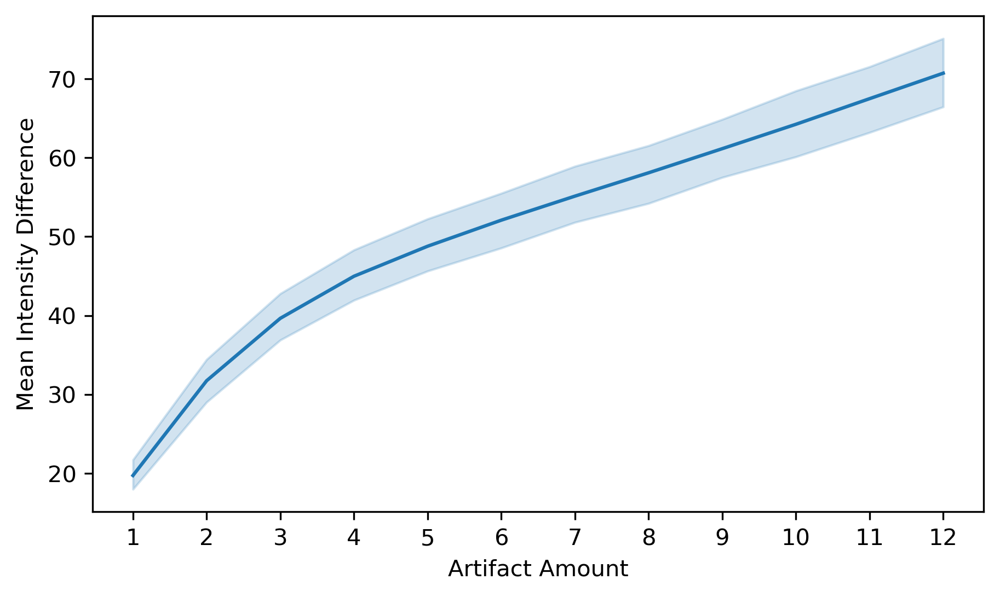

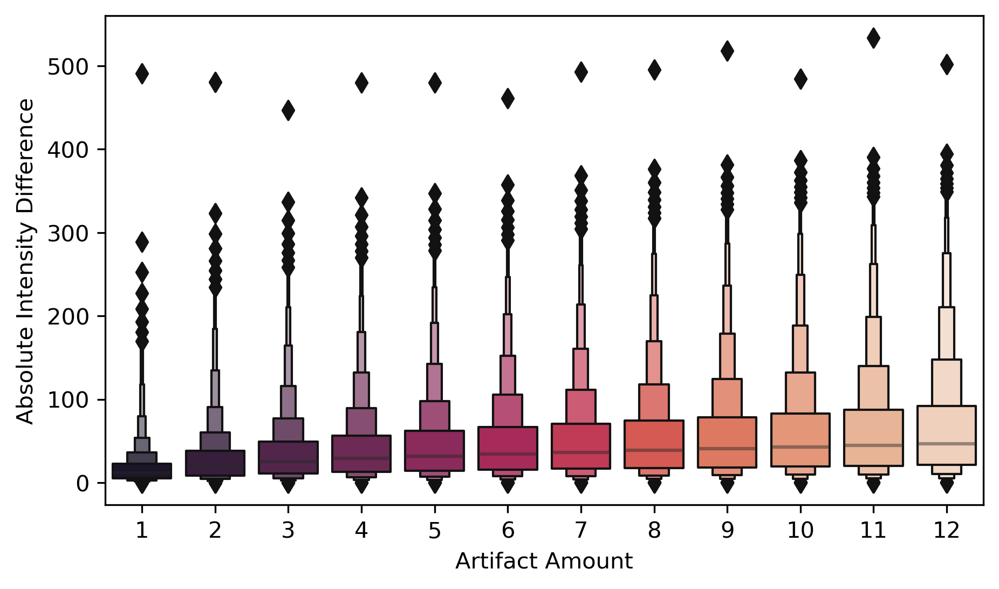

In [337]:
sampFDF = pd.concat(sampSetDFDict.values())
sampFDF['Artifact Amount'] = ['%i' % (frac * 48) for frac in sampFDF['Fraction']]

sampFDF['Difference Percentile'] = sampFDF['sNo']/10
plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Difference Percentile", y="val",hue='Artifact Amount',palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Artifact Amount", y="val")
hLP.set_ylabel('Mean Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.boxenplot(data=sampFDF,x="Artifact Amount", y="val",palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

# Calibration of Motion Artifact (K-space % affected)

100%|██████████| 10/10 [00:26<00:00,  2.62s/it]


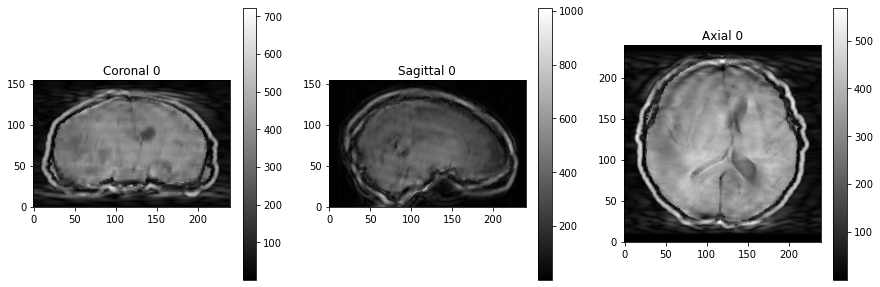

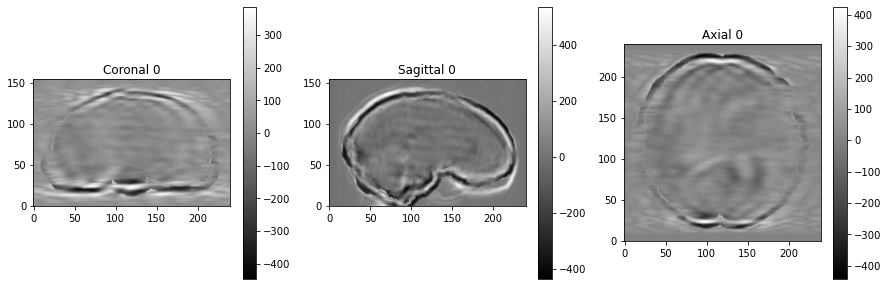

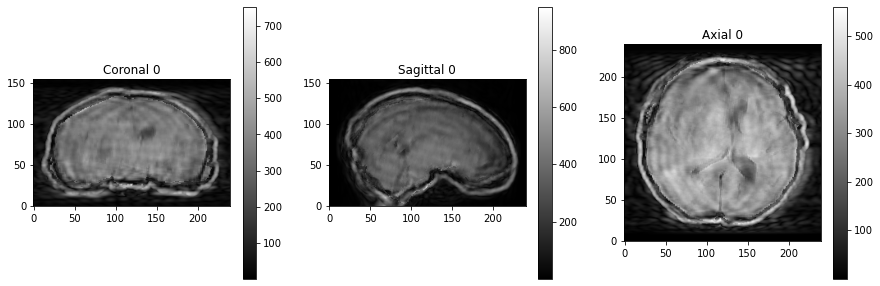

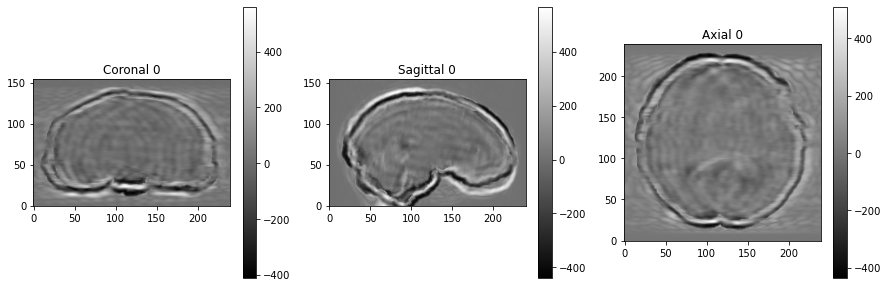

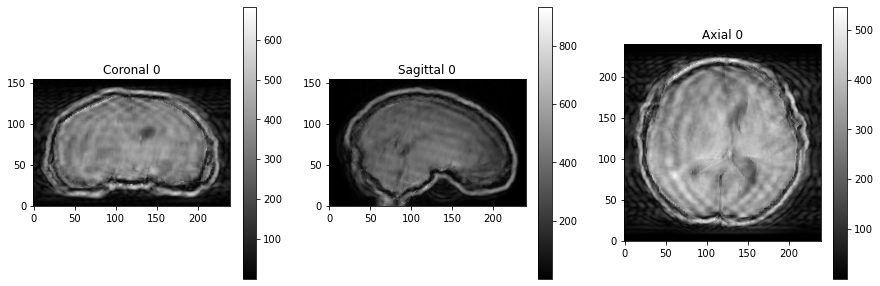

...

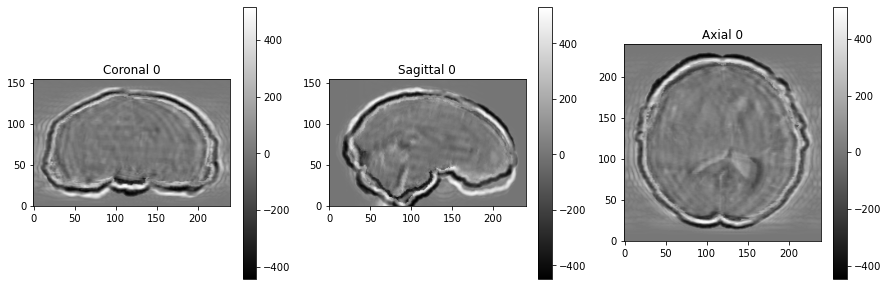

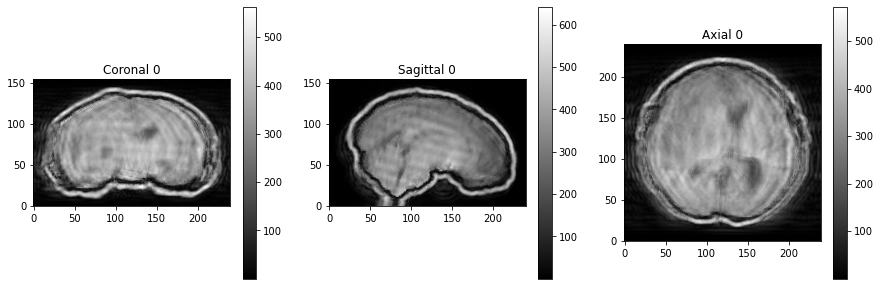

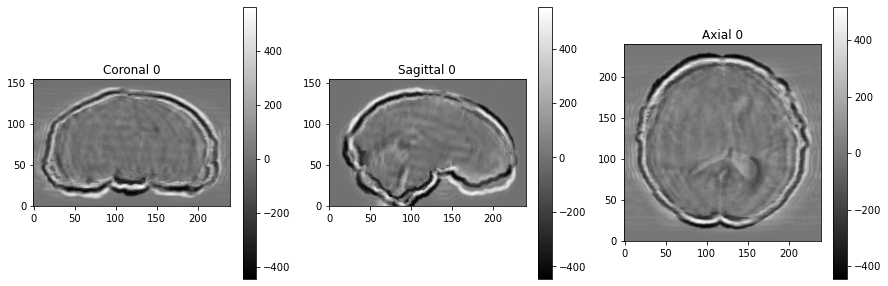

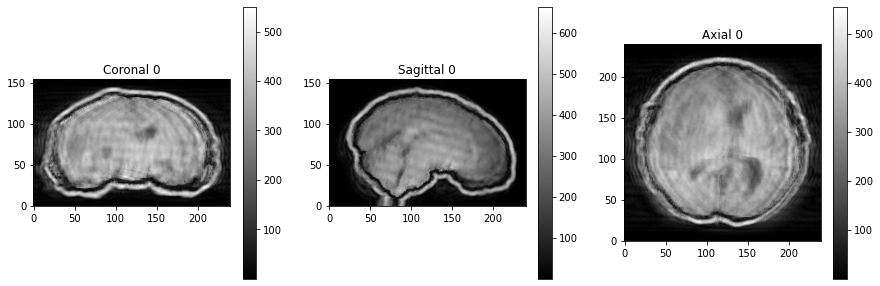

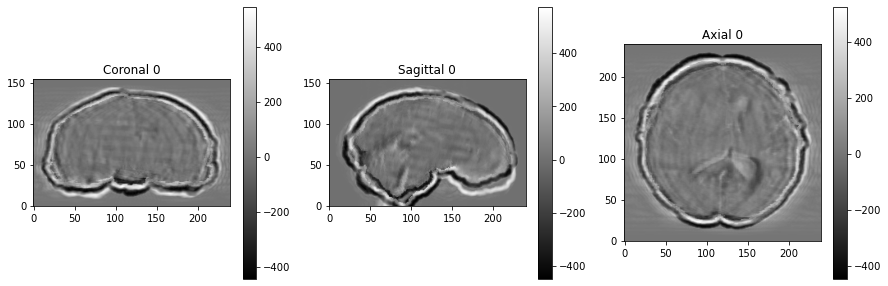

In [338]:
tp = np.transpose(transformed,axes = [1,0,2])
testFracs = np.asarray([1/32,2/32,3/32,4/32,5/32,6/32,7/32,8/32])
# testThetas = testFracs * np.pi
# testPhis = testThetas * np.pi/4
sampDFDict = {}
nSamps = 1000

for thI in range(len(testFracs)):
    cFrac = testFracs[thI]
    aV = add_fake_skull(tp,dispTF=False)
    artV = add_stepwise_rotation_motion_artifact(aV,scale=cFrac,random_seed=42,dispTF=False)
    diffMat = np.abs(artV[fg]-tp[fg])
    
    sDiffMat = np.sort(diffMat)
    sampIdxs = np.linspace(0,len(sDiffMat)-1,nSamps).astype(int)
    sSamps = sDiffMat[sampIdxs]
    sampDF = pd.DataFrame({'Fraction':np.ones(nSamps)*cFrac,'sNo': np.asarray(range(nSamps)),'val':sSamps})
    sampDFDict[thI] = sampDF
    mri_utils.plot_img_arr(artV)
    mri_utils.plot_img_arr(artV-aV)

<AxesSubplot:xlabel='Idx', ylabel='val'>

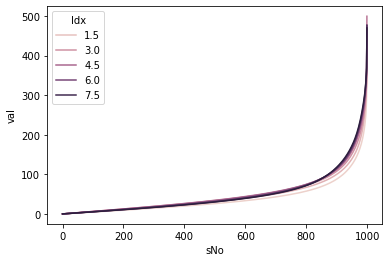

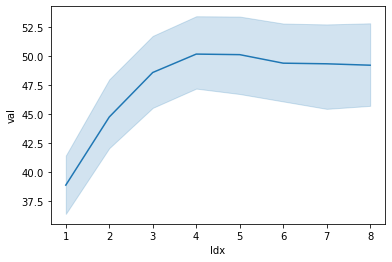

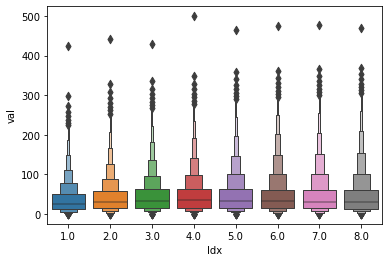

In [339]:
sampFDF = pd.concat(sampDFDict.values())
sampFDF['Idx'] = sampFDF['Fraction'] * 32 
plt.figure()
sns.lineplot(data=sampFDF,x="sNo", y="val",hue='Idx')

plt.figure()
sns.lineplot(data=sampFDF,x="Idx", y="val")

plt.figure()
sns.boxenplot(data=sampFDF,x="Idx", y="val")

# Calibrating 2D Motion

100%|██████████| 10/10 [00:25<00:00,  2.58s/it]
/data/ncwang/MRI_artifacts/code/mri_utils.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, axs = plt.subplots(nM,3,figsize=(15,(nM)*5),dpi = dpi)
100%|██████████| 10/10 [00:26<00:00,  2.61s/it]


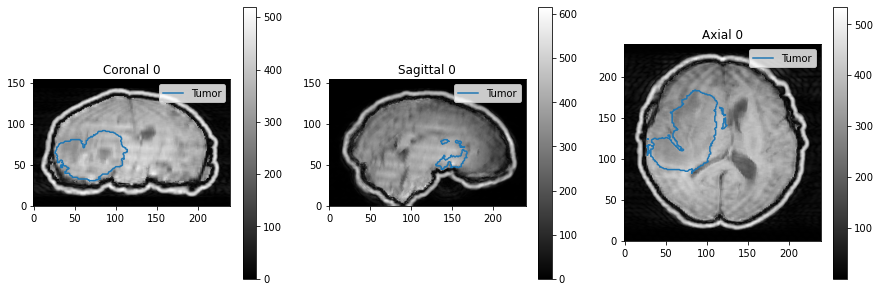

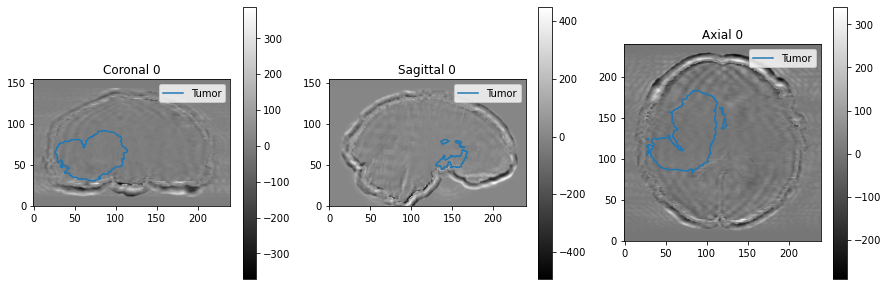

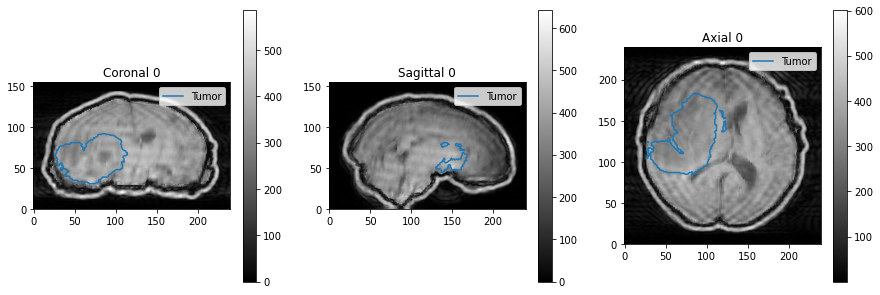

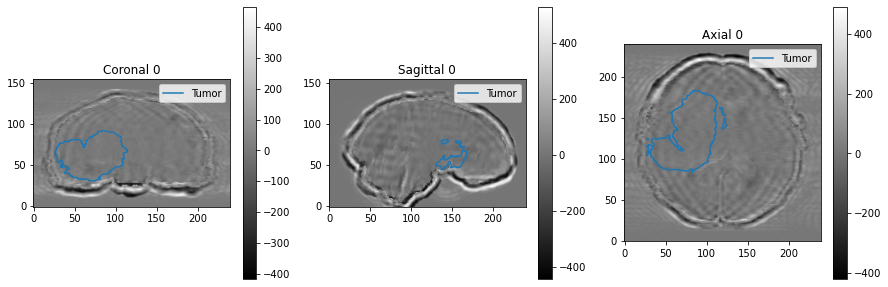

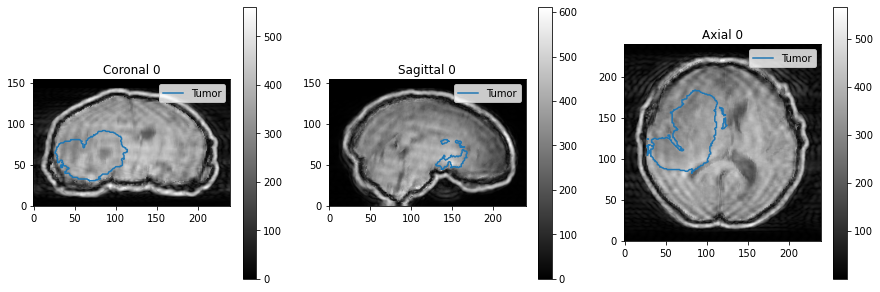

...

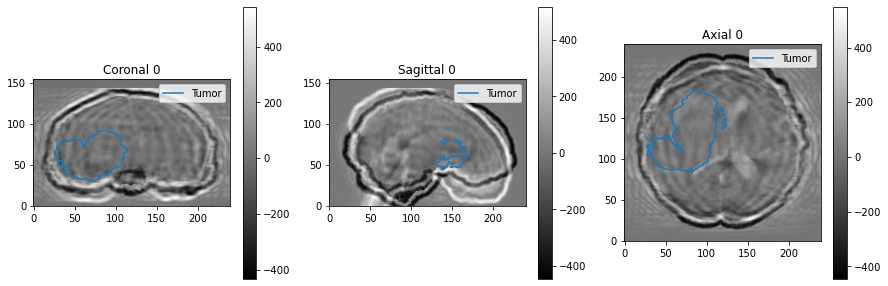

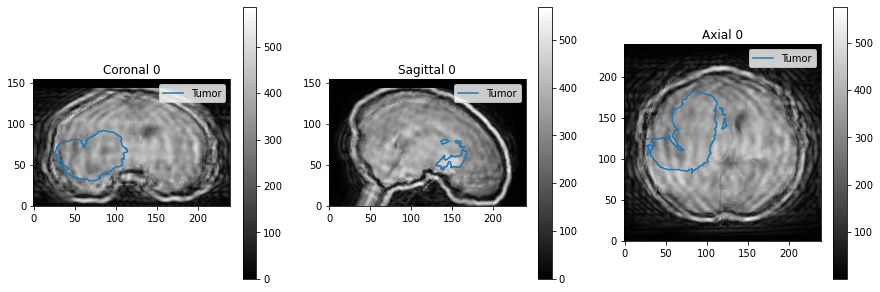

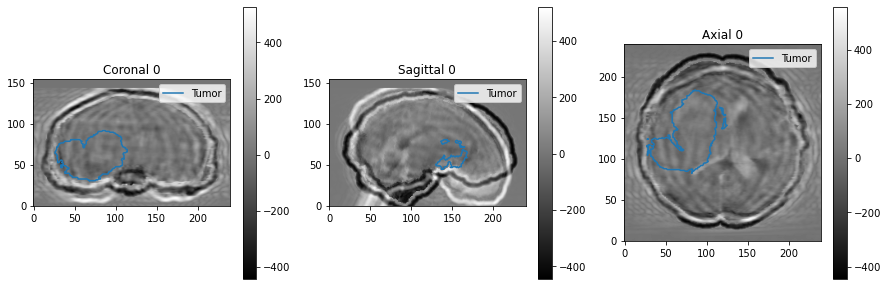

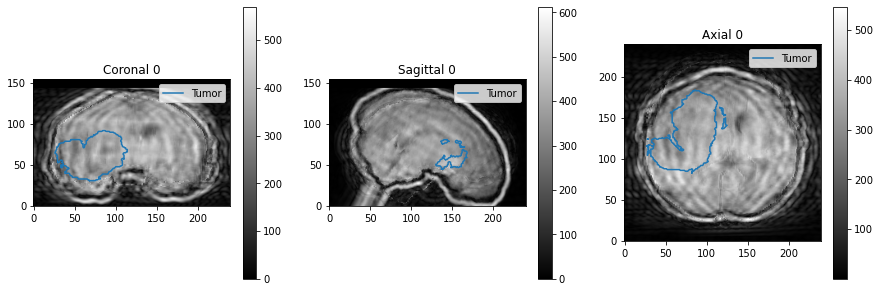

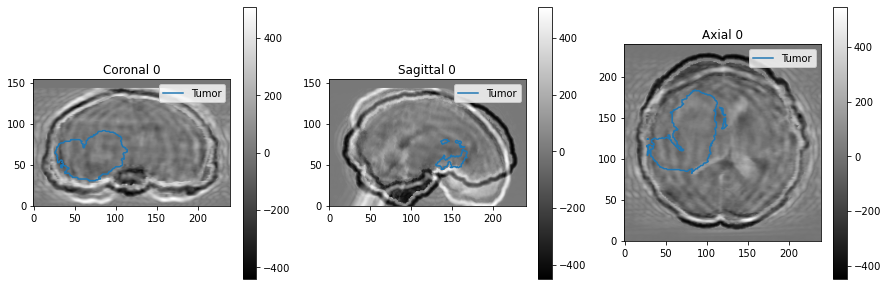

In [422]:
tp = np.transpose(transformed,axes = [1,0,2])
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])
testThetas = testFracs * np.pi/4
testPhis = testThetas * np.pi
sampSet2DDFDict = {}
nSamps = 1000

for thI in range(len(testThetas)):
    cFrac = testFracs[thI]
    cTheta = testThetas[thI]
    cPhi = testPhis[thI]
    aV = add_fake_skull(tp,dispTF=False)
    artV = add_2d_rotation_motion_artifact(aV,thRot=cTheta,phRot=cPhi,xyzTrMax = cFrac * 24,
                                                 random_seed=42,dispTF=False)
    diffMat = np.abs(artV[fg]-tp[fg])
    
    sDiffMat = np.sort(diffMat)
    sampIdxs = np.linspace(0,len(sDiffMat)-1,nSamps).astype(int)
    sSamps = sDiffMat[sampIdxs]
    sampDF = pd.DataFrame({'Fraction':np.ones(nSamps)*cFrac,'sNo': np.asarray(range(nSamps)),'val':sSamps})
    sampSet2DDFDict[thI] = sampDF
    mri_utils.plot_img_arr(artV,ctrArr=tp_lbl,ctrNames=['Tumor'])
    mri_utils.plot_img_arr(artV-aV,ctrArr=tp_lbl,ctrNames=['Tumor'])

Text(0, 0.5, 'Absolute Intensity Difference')

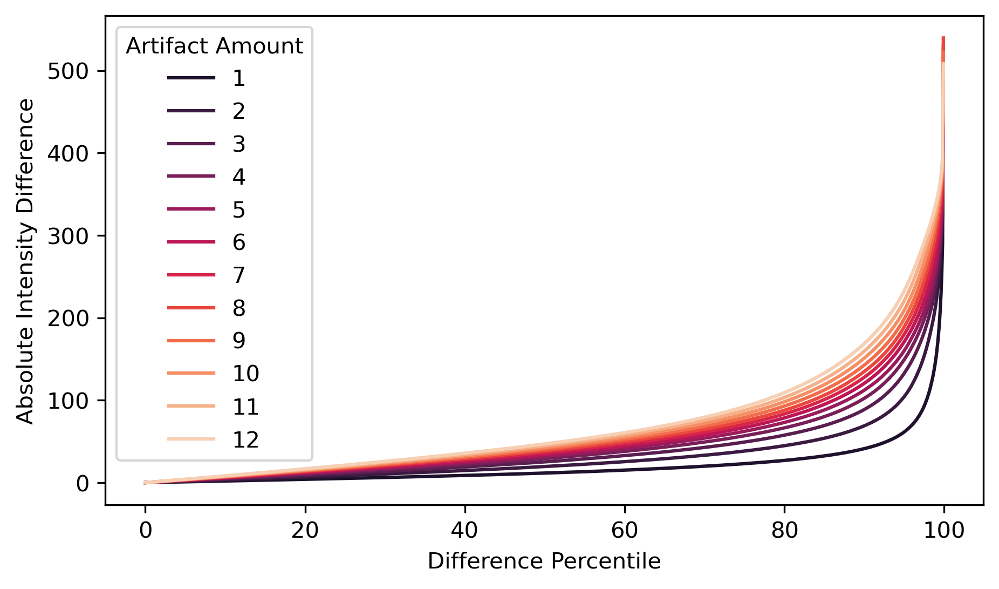

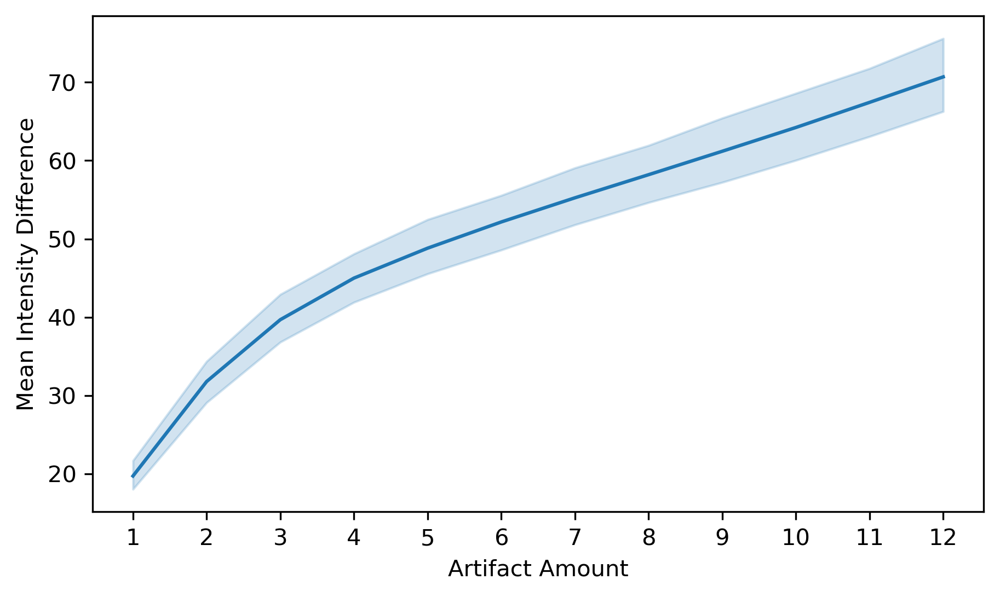

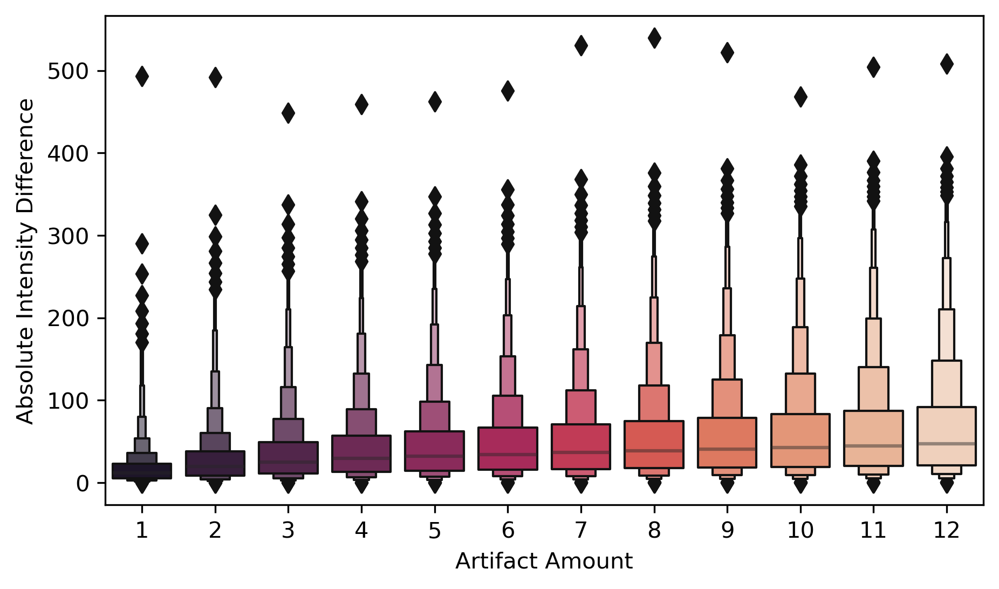

In [423]:
sampFDF = pd.concat(sampSet2DDFDict.values())
sampFDF['Artifact Amount'] = ['%i' % (frac * 48) for frac in sampFDF['Fraction']]

sampFDF['Difference Percentile'] = sampFDF['sNo']/10
plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Difference Percentile", y="val",hue='Artifact Amount',palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Artifact Amount", y="val")
hLP.set_ylabel('Mean Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.boxenplot(data=sampFDF,x="Artifact Amount", y="val",palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

# Calibrating Signal Loss Artifact

0 2021-12-20T12:51
1 2021-12-20T12:52
2 2021-12-20T12:53
3 2021-12-20T12:54
4 2021-12-20T12:54
5 2021-12-20T12:55
6 2021-12-20T12:56
7 2021-12-20T12:56
8 2021-12-20T12:57
9 2021-12-20T12:58
10 2021-12-20T12:59


/data/ncwang/MRI_artifacts/code/mri_utils.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, axs = plt.subplots(nM,3,figsize=(15,(nM)*5),dpi = dpi)


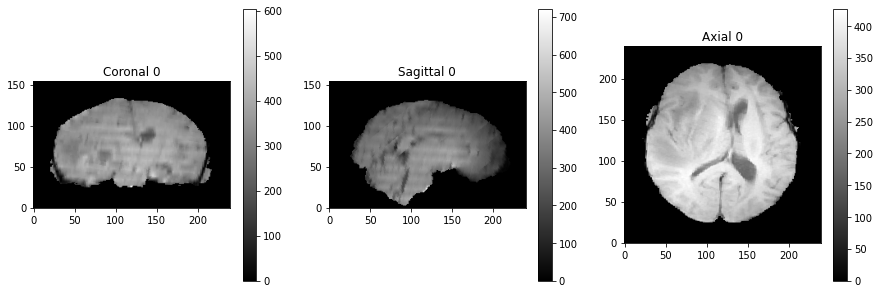

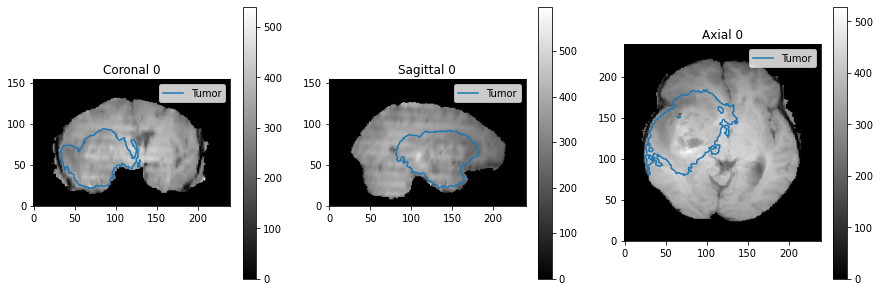

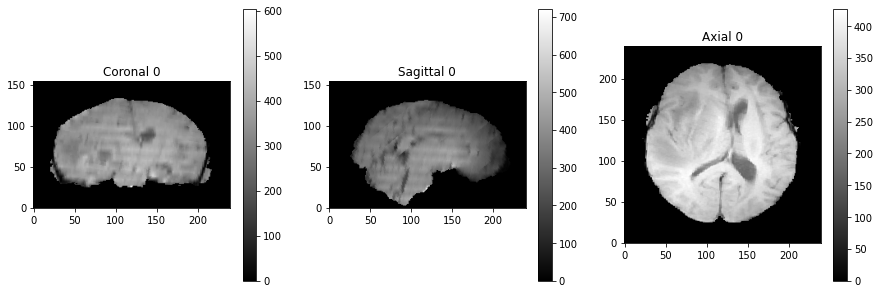

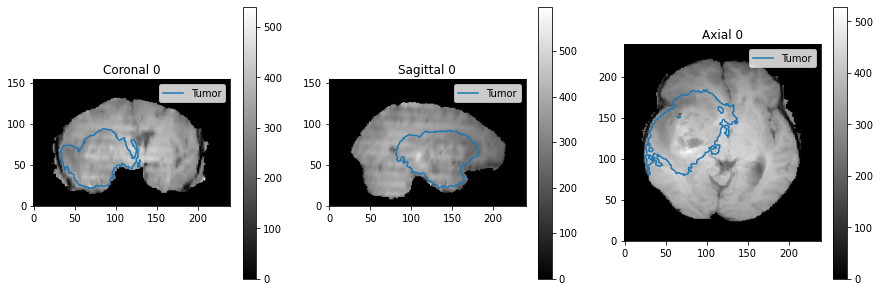

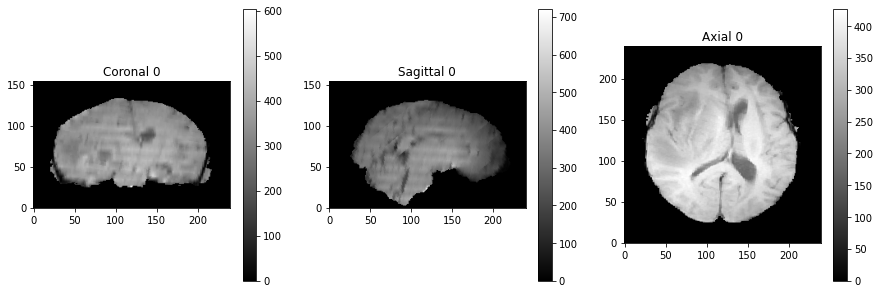

...

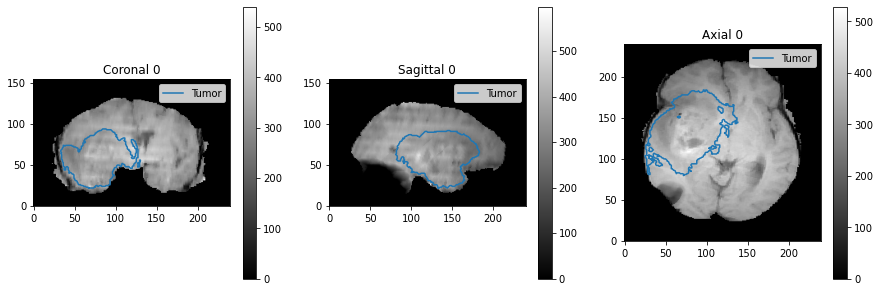

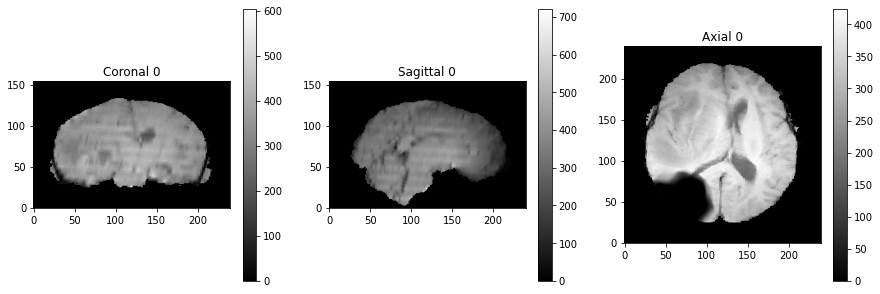

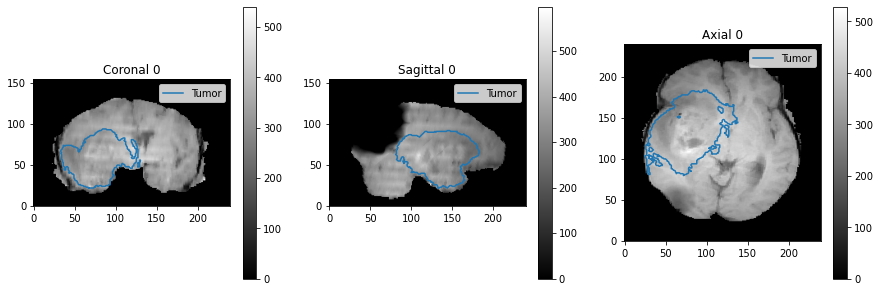

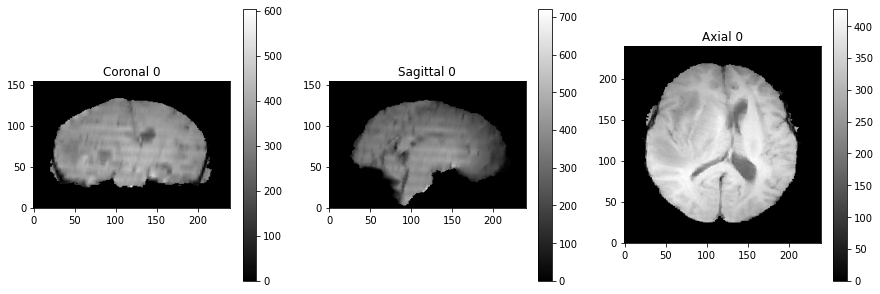

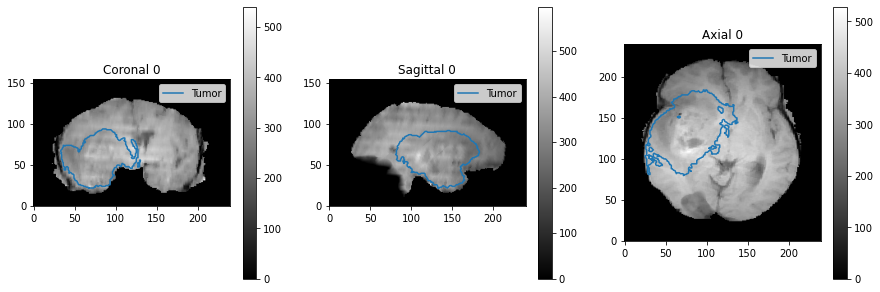

In [285]:
tp = np.transpose(transformed,axes = [1,0,2])
tp_lbl = np.transpose(tr_label,axes = [1,0,2])
testSzs = np.asarray([0,5,10,15,20,25,30,35,40,45,50])

sampDFSLDict = {}
nSamps = 1000

for szI in range(len(testSzs)):
    print(szI,datetime.now().isoformat(timespec='minutes'))
    cVal = testSzs[szI]
#     aV = add_fake_skull(tp,dispTF=False)
    aV = tp.copy() 
    seedLocs = generate_dist_seed_locs(tp_lbl,inArr,artDMid = cVal,
                                           random_seed=42,dispTF=False)
    artV = add_signal_loss_artifact(aV,seedLocs=seedLocs,artDMid=cVal,random_seed=42,dispTF=False)
#     artV = remove_fake_skull(artV,tp)
    diffMat = np.abs(artV[fg]-tp[fg])
    
    sDiffMat = np.sort(diffMat)
    sampIdxs = np.linspace(0,len(sDiffMat)-1,nSamps).astype(int)
    sSamps = sDiffMat[sampIdxs]
    sampDF = pd.DataFrame({'Fraction':np.ones(nSamps)*cVal,'sNo': np.asarray(range(nSamps)),'val':sSamps})
    sampDFSLDict[szI] = sampDF
    
    mri_utils.plot_img_arr(artV)
    cutPt = [np.argmax(np.sum(tp_lbl,axis=tuple(set([0,1,2])-set([axI])))) for axI in (0,1,2)]
    mri_utils.plot_img_arr(artV,cutPt=cutPt,ctrArr=tp_lbl,ctrNames=['Tumor'])
#     mri_utils.plot_img_arr(artV-aV)

Text(0, 0.5, 'Absolute Intensity Difference')

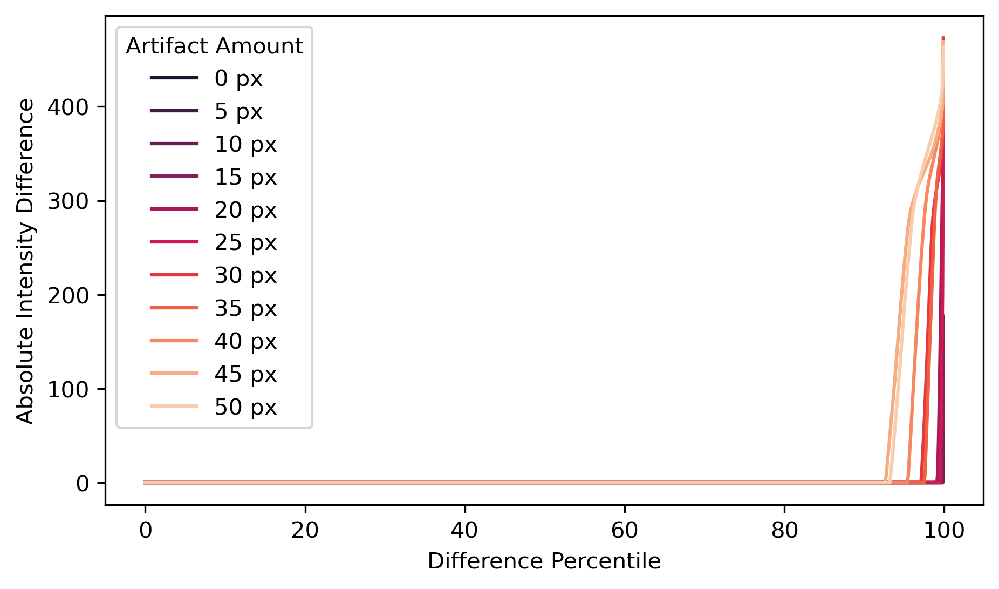

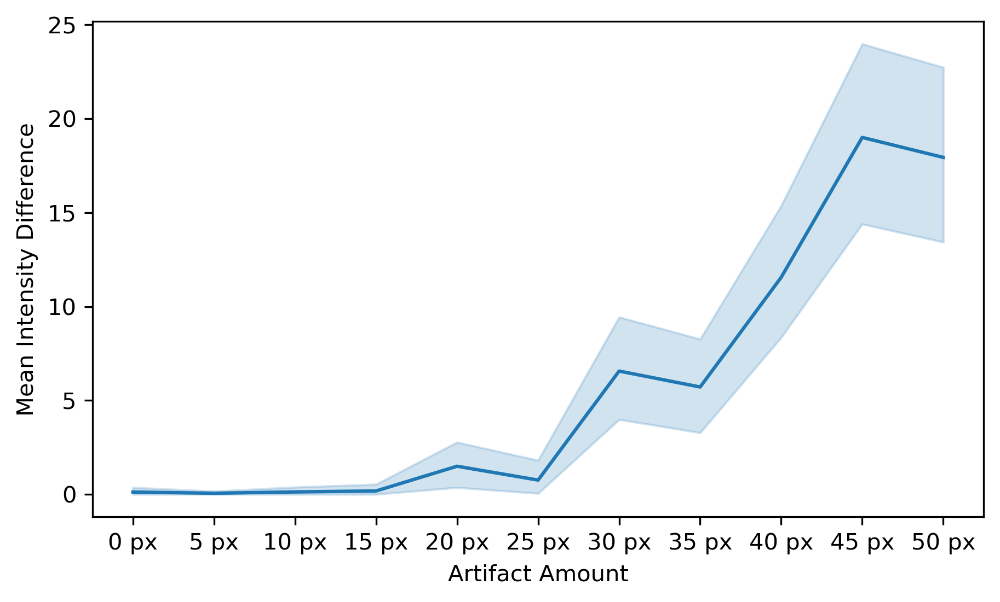

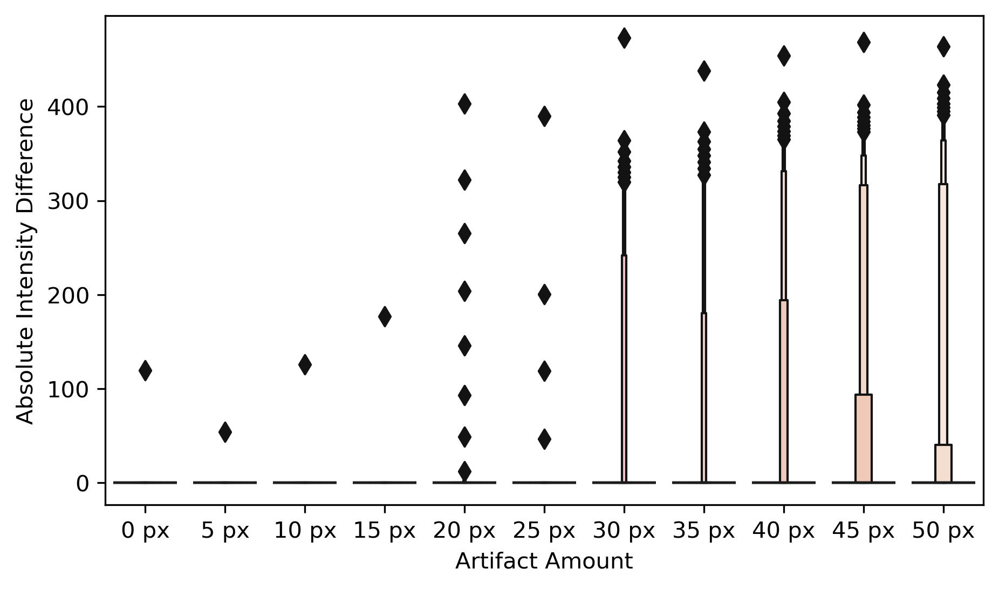

In [286]:
sampFDF = pd.concat(sampDFSLDict.values())
sampFDF['Artifact Amount'] = ['%i px' % (frac ) for frac in sampFDF['Fraction']]

sampFDF['Difference Percentile'] = sampFDF['sNo']/10
plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Difference Percentile", y="val",hue='Artifact Amount',palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Artifact Amount", y="val")
hLP.set_ylabel('Mean Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.boxenplot(data=sampFDF,x="Artifact Amount", y="val",palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

# Calibration of Aliasing Artifact

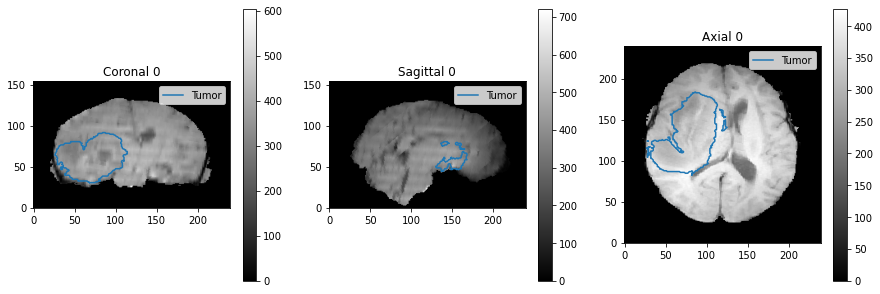

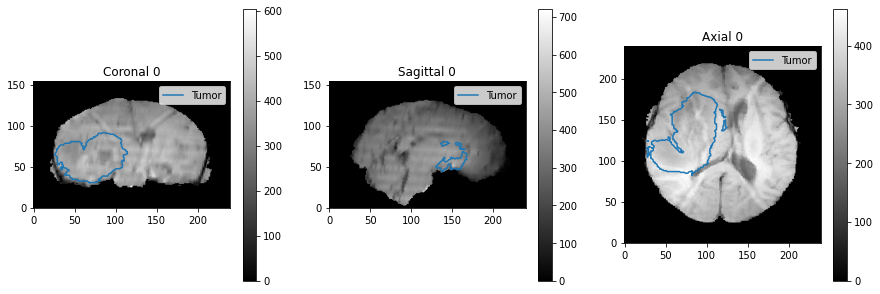

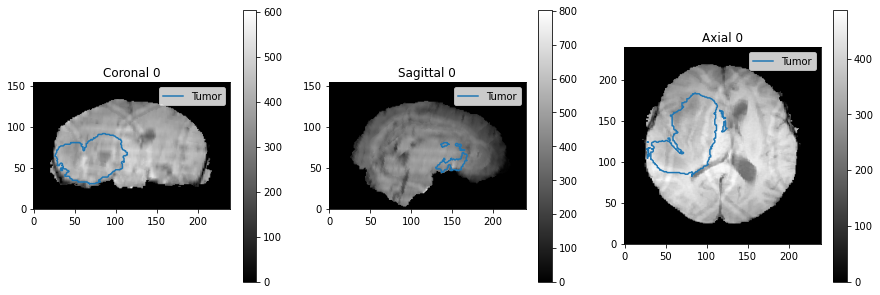

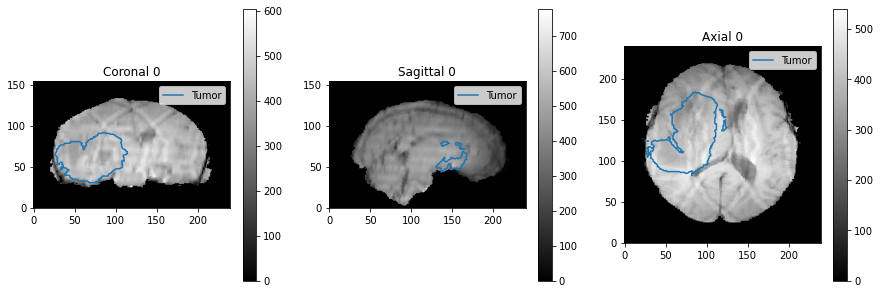

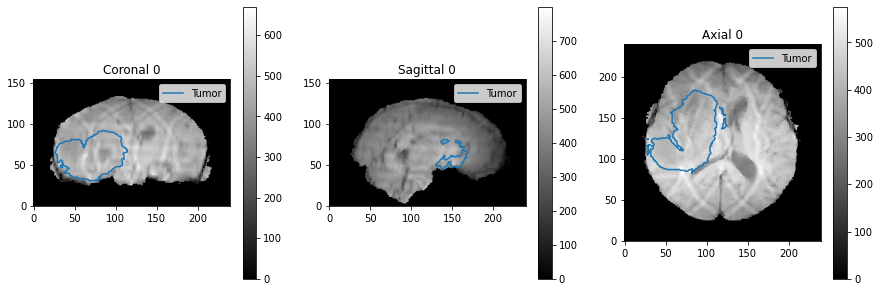

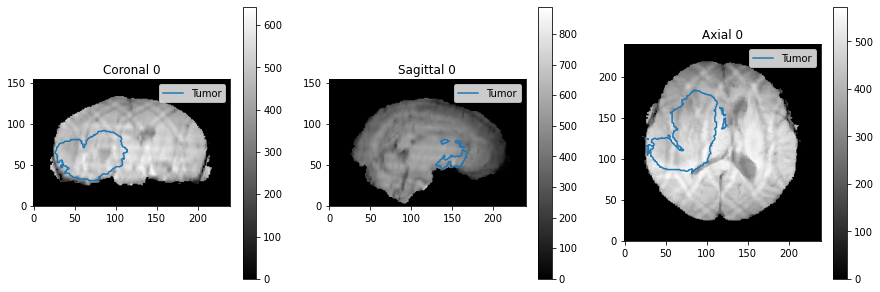

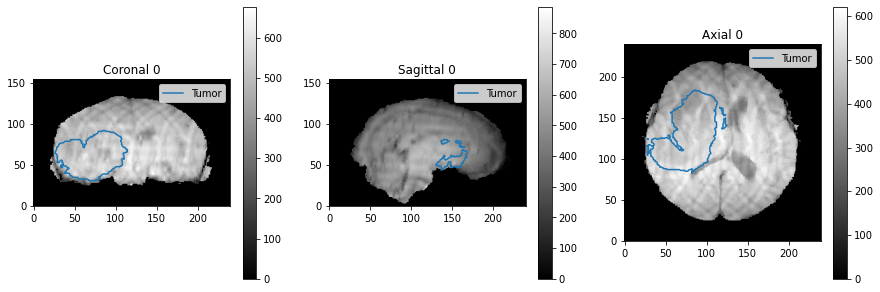

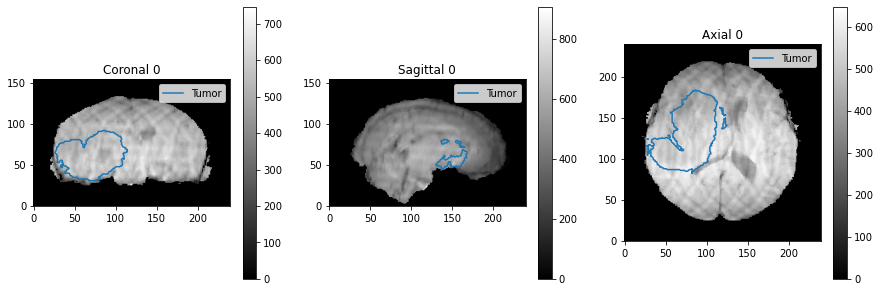

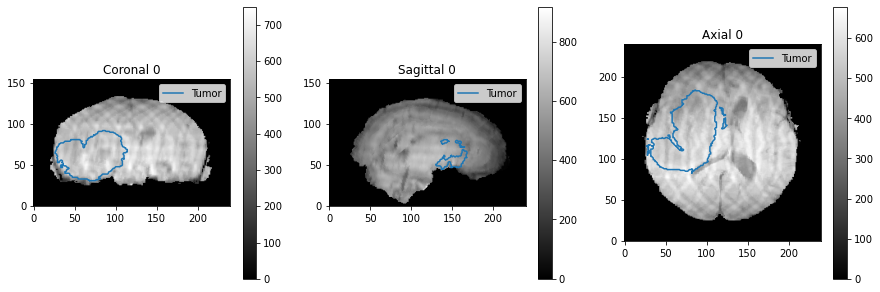

In [288]:
tp = np.transpose(transformed,axes = [1,0,2])
testNOvs = np.asarray([0,1,2,3,4,5,6,7,8])
# testThetas = testFracs * np.pi
# testPhis = testThetas * np.pi/4
sampDFADict = {}
nSamps = 1000

for szI in range(len(testNOvs)):
    cVal = testNOvs[szI]
    aV = add_fake_skull(tp,dispTF=False)
#     aV = tp.copy()
    artV = add_aliasing_artifact(aV,overlap=cVal,aliasMult=.1,dispTF=False)
    artV = remove_fake_skull(artV,tp)
    diffMat = np.abs(artV[fg]-tp[fg])
    
    sDiffMat = np.sort(diffMat)
    sampIdxs = np.linspace(0,len(sDiffMat)-1,nSamps).astype(int)
    sSamps = sDiffMat[sampIdxs]
    sampDF = pd.DataFrame({'Fraction':np.ones(nSamps)*cVal,'sNo': np.asarray(range(nSamps)),'val':sSamps})
    sampDFADict[szI] = sampDF
    mri_utils.plot_img_arr(artV,ctrArr=tp_lbl,ctrNames=['Tumor'])
#     mri_utils.plot_img_arr(artV-aV)

Text(0, 0.5, 'Absolute Intensity Difference')

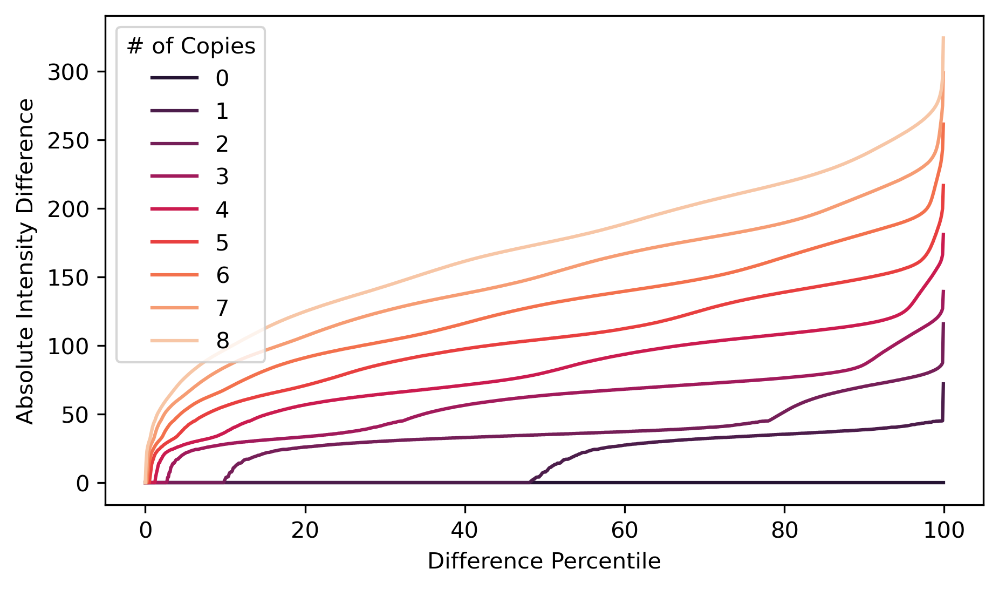

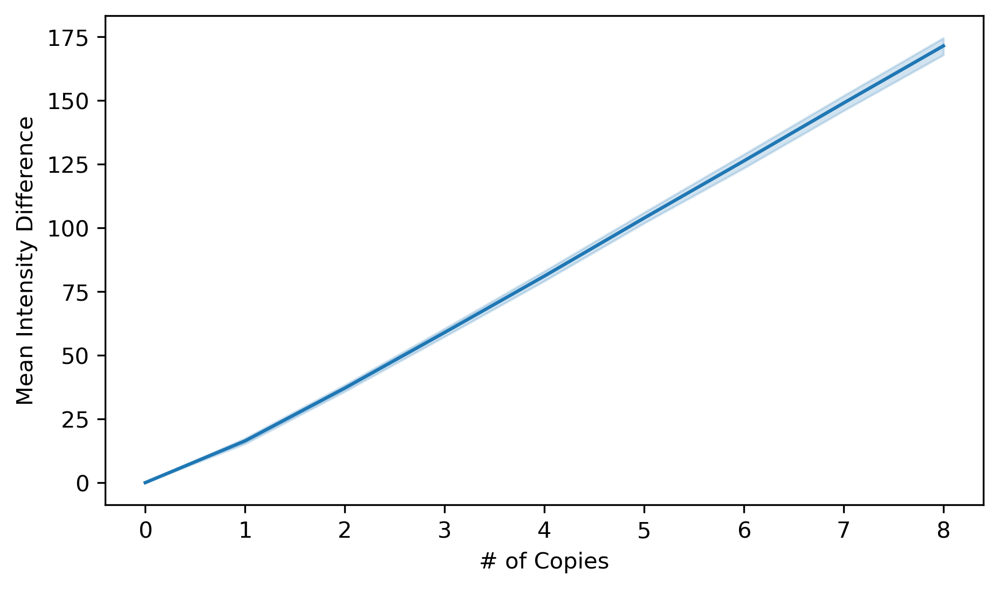

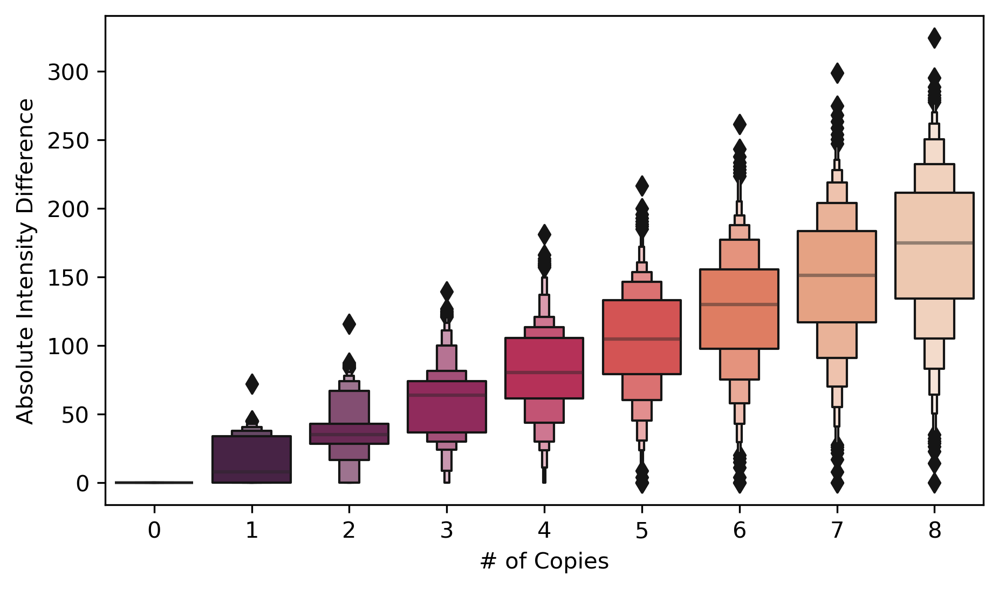

In [291]:
sampFDF = pd.concat(sampDFADict.values())
sampFDF['# of Copies'] = ['%i' % (frac ) for frac in sampFDF['Fraction']]

sampFDF['Difference Percentile'] = sampFDF['sNo']/10
plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Difference Percentile", y="val",hue='# of Copies',palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="# of Copies", y="val")
hLP.set_ylabel('Mean Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.boxenplot(data=sampFDF,x="# of Copies", y="val",palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

# Calibration of Alias Intensity

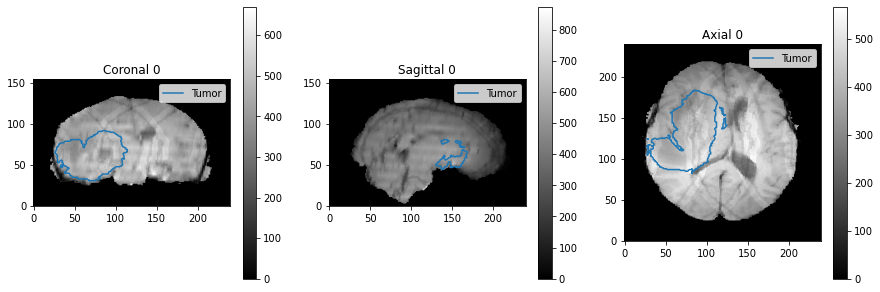

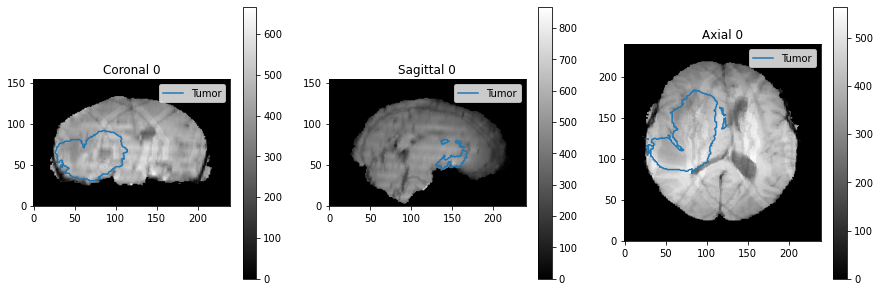

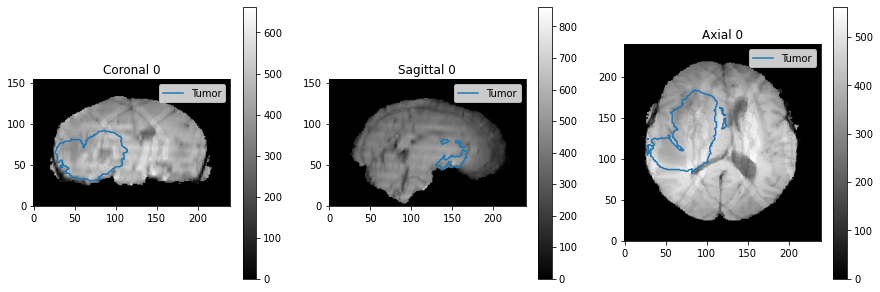

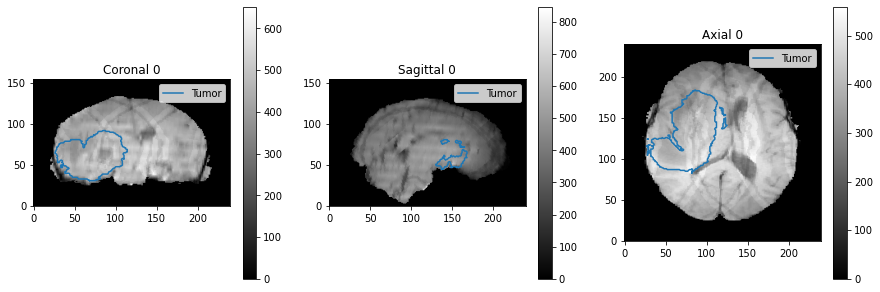

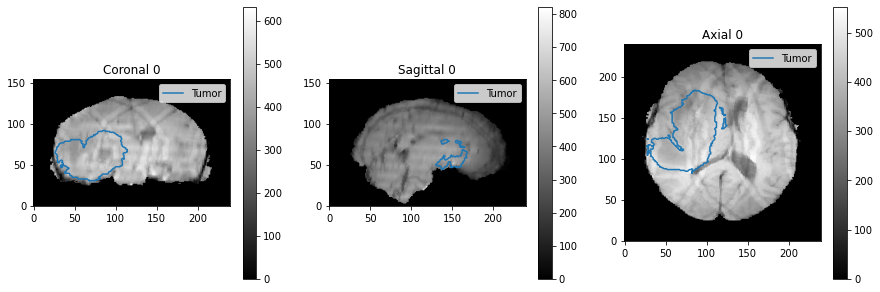

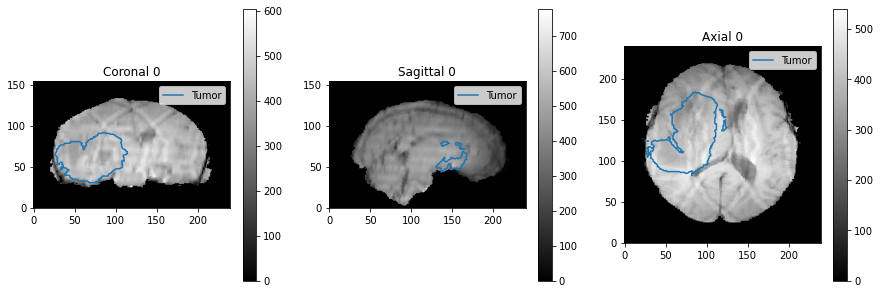

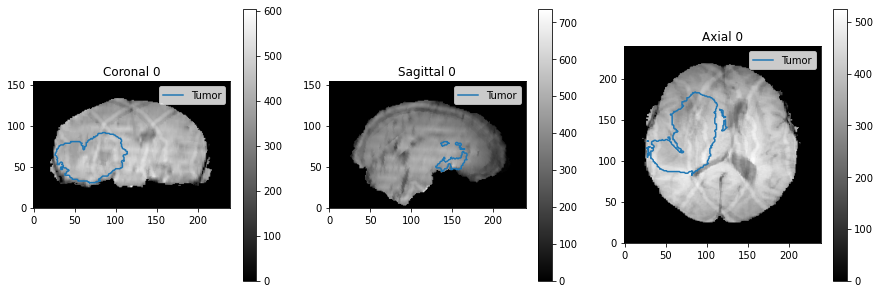

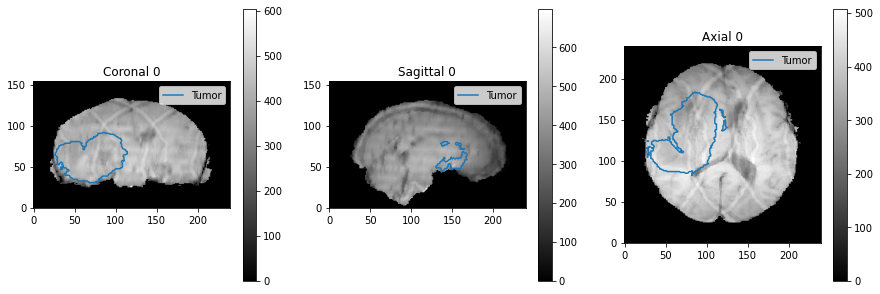

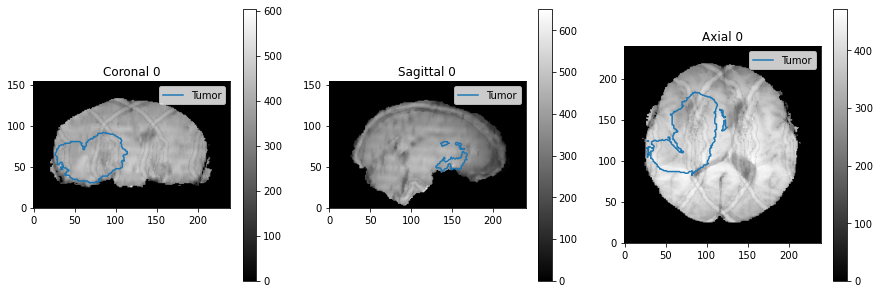

In [524]:
tp = np.transpose(transformed,axes = [1,0,2])
testVals = np.asarray([0,0.005,0.01,0.025,0.05,0.1,0.15,0.2,0.3])

# testThetas = testFracs * np.pi
# testPhis = testThetas * np.pi/4
sampDFAVDict = {}
nSamps = 1000

for szI in range(len(testVals)):
    cVal = testVals[szI]
    aV = add_fake_skull(tp,dispTF=False)
#     aV = tp.copy()
    artV = add_aliasing_artifact(aV,overlap=3,aliasMult=cVal,dispTF=False)
    artV = remove_fake_skull(artV,tp)
    diffMat = np.abs(artV[fg]-tp[fg])
    
    sDiffMat = np.sort(diffMat)
    sampIdxs = np.linspace(0,len(sDiffMat)-1,nSamps).astype(int)
    sSamps = sDiffMat[sampIdxs]
    sampDF = pd.DataFrame({'Fraction':np.ones(nSamps)*cVal,'sNo': np.asarray(range(nSamps)),'val':sSamps})
    sampDFAVDict[szI] = sampDF
    mri_utils.plot_img_arr(artV,ctrArr=tp_lbl,ctrNames=['Tumor'])
#     mri_utils.plot_img_arr(artV-aV)

In [ ]:
sampFDF = pd.concat(sampDFAVDict.values())
sampFDF['# of Copies'] = ['%i' % (frac ) for frac in sampFDF['Fraction']]

sampFDF['Difference Percentile'] = sampFDF['sNo']/10
plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Difference Percentile", y="val",hue='# of Copies',palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="# of Copies", y="val")
hLP.set_ylabel('Mean Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.boxenplot(data=sampFDF,x="# of Copies", y="val",palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

# Calibration of Misalignment Artifact

0 2021-12-22T15:10
1 2021-12-22T15:10
2 2021-12-22T15:10
3 2021-12-22T15:10
4 2021-12-22T15:10
5 2021-12-22T15:10
6 2021-12-22T15:10
7 2021-12-22T15:10
8 2021-12-22T15:10
9 2021-12-22T15:10
10 2021-12-22T15:10


/data/ncwang/MRI_artifacts/code/mri_utils.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, axs = plt.subplots(nM,3,figsize=(15,(nM)*5),dpi = dpi)


11 2021-12-22T15:10


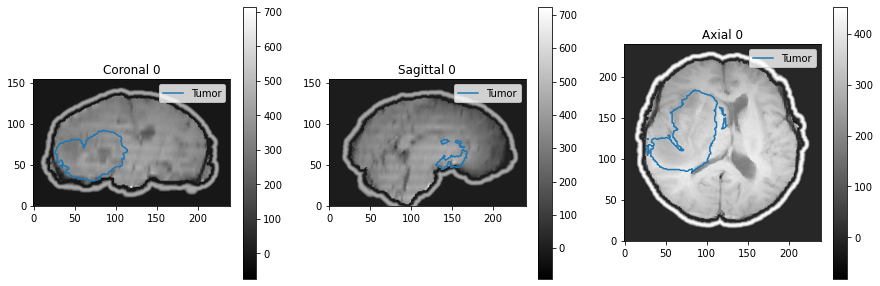

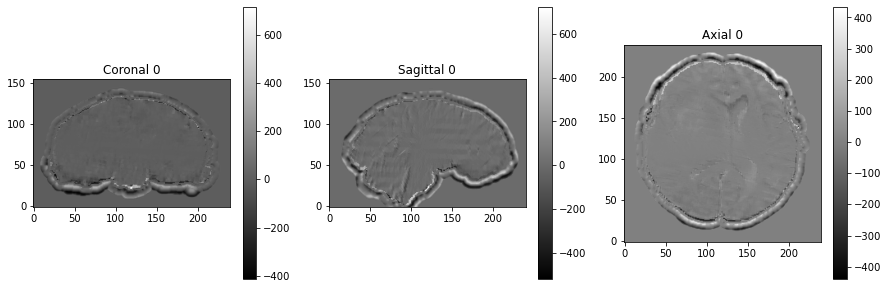

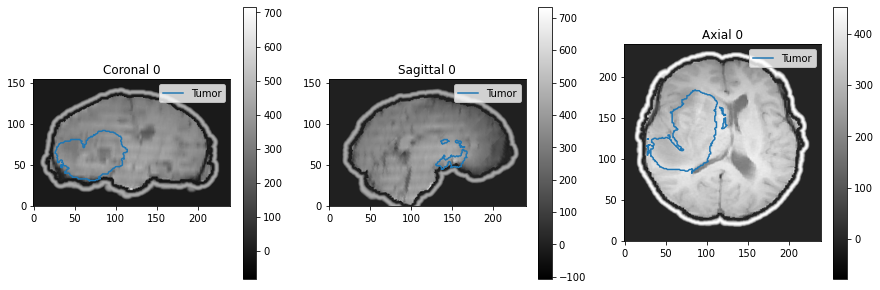

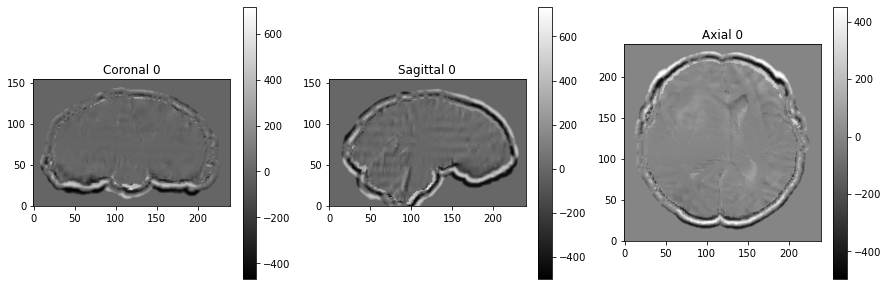

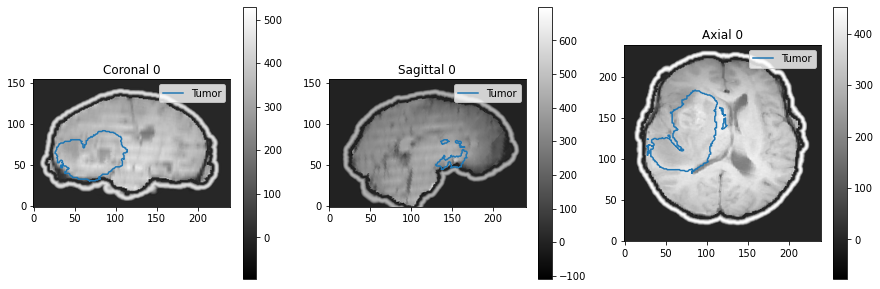

...

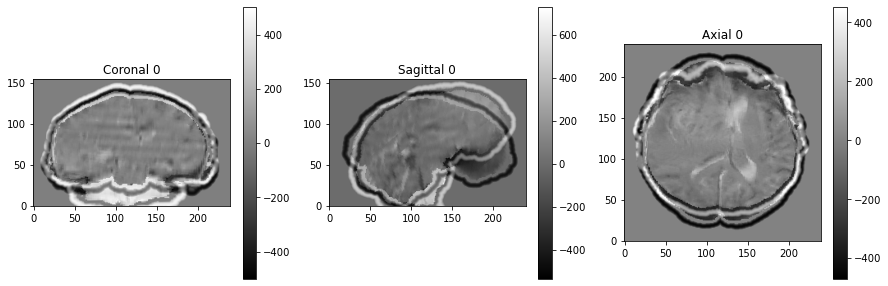

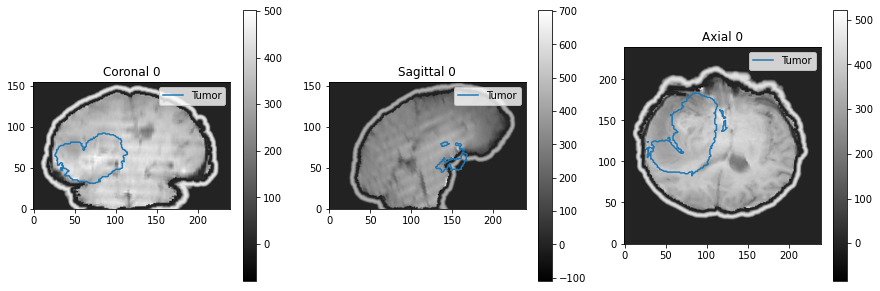

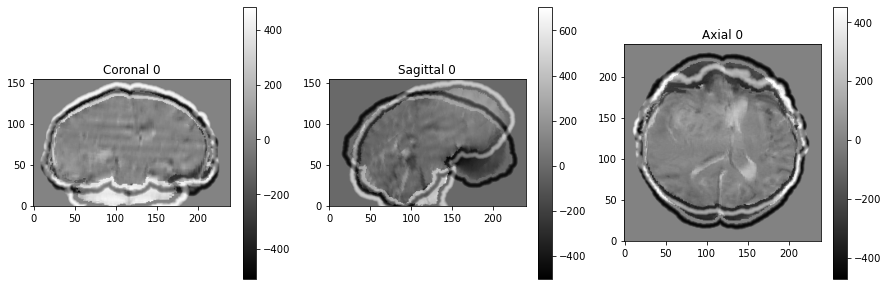

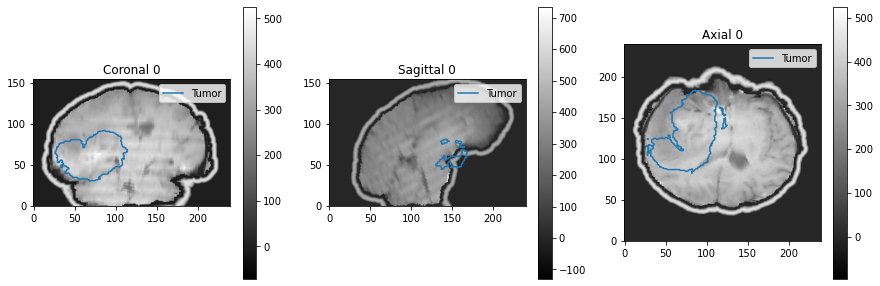

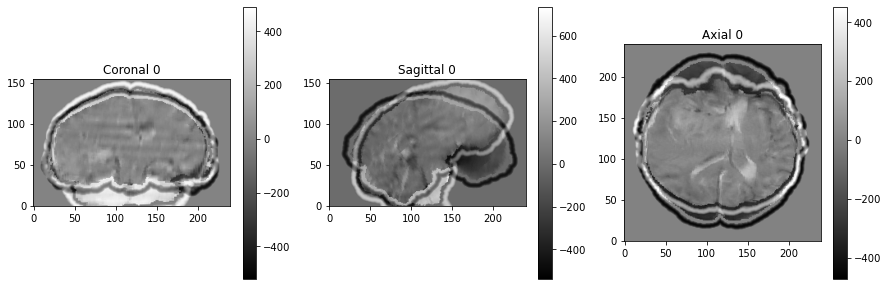

In [341]:
tp = np.transpose(transformed,axes = [1,0,2])
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])
testThetas = testFracs * np.pi/4
testPhis = testThetas * np.pi
sampMisDFDict = {}
nSamps = 1000

for thI in range(len(testThetas)):
    print(thI,datetime.now().isoformat(timespec='minutes'))
    cFrac = testFracs[thI]
    cTheta = testThetas[thI]
    cPhi = testPhis[thI]
    aV = add_fake_skull(tp,dispTF=False)
    artV = add_misalignment_artifact(aV,thRot=cTheta,phRot=cPhi,xyzTrMax = cFrac * 24,
                                                 random_seed=42,dispTF=False)
    
#     artV = remove_fake_skull(artV,tp)
    diffMat = np.abs(artV[fg]-tp[fg])
    
    sDiffMat = np.sort(diffMat)
    sampIdxs = np.linspace(0,len(sDiffMat)-1,nSamps).astype(int)
    sSamps = sDiffMat[sampIdxs]
    sampDF = pd.DataFrame({'Fraction':np.ones(nSamps)*cFrac,'sNo': np.asarray(range(nSamps)),'val':sSamps})
    sampMisDFDict[thI] = sampDF
    mri_utils.plot_img_arr(artV,ctrArr=tp_lbl,ctrNames=['Tumor'])
    mri_utils.plot_img_arr(artV-aV)

Text(0, 0.5, 'Absolute Intensity Difference')

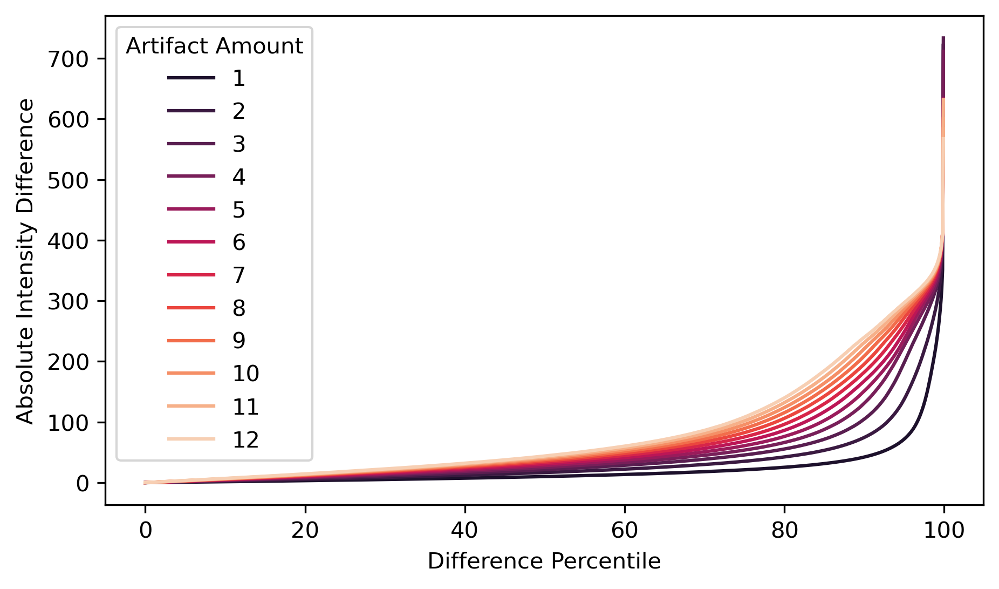

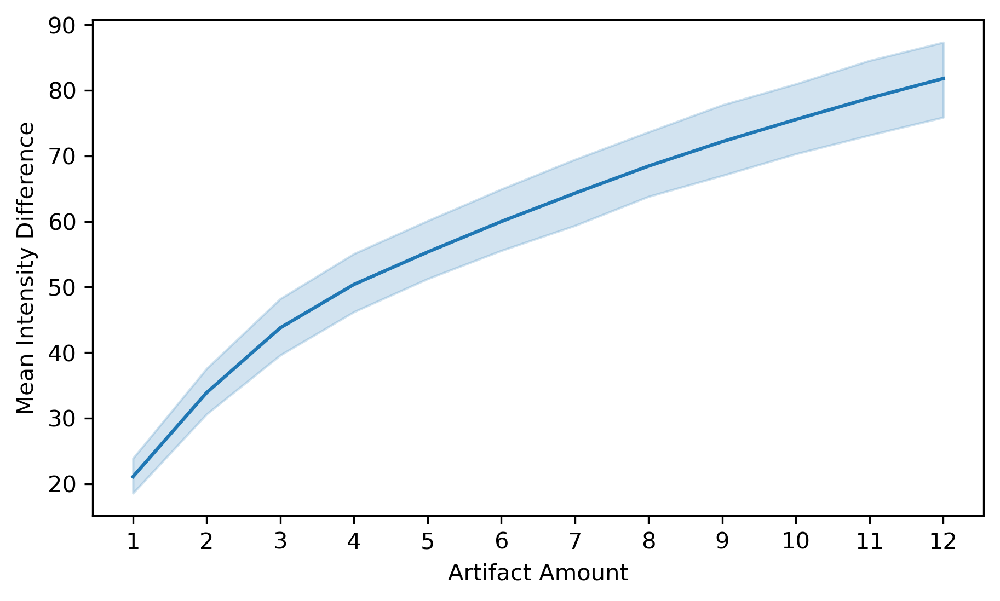

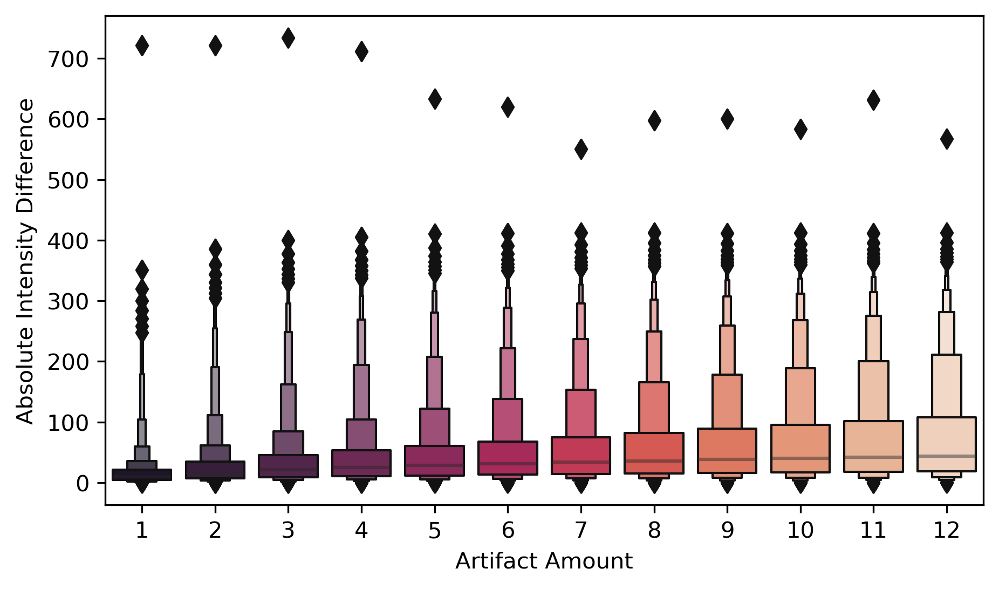

In [342]:
sampFDF = pd.concat(sampMisDFDict.values())
sampFDF['Artifact Amount'] = ['%i' % (frac * 48) for frac in sampFDF['Fraction']]

sampFDF['Difference Percentile'] = sampFDF['sNo']/10
plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Difference Percentile", y="val",hue='Artifact Amount',palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Artifact Amount", y="val")
hLP.set_ylabel('Mean Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.boxenplot(data=sampFDF,x="Artifact Amount", y="val",palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

# Calibration of Inhomogeneity Artifact

[1. 1.]
[1.05 0.95]
[1.1 0.9]
[1.15 0.85]
[1.2 0.8]
[1.25 0.75]
[1.3 0.7]
[1.35 0.65]
[1.4 0.6]


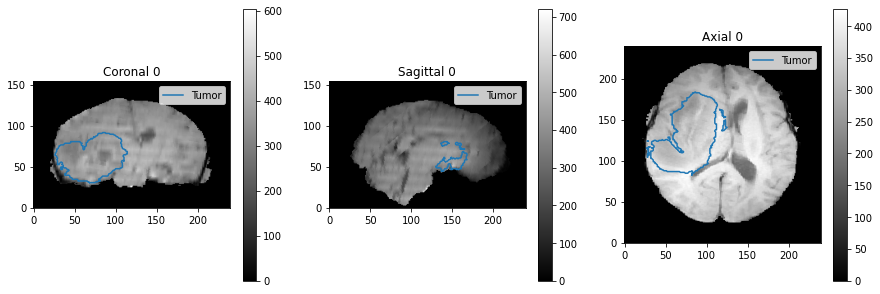

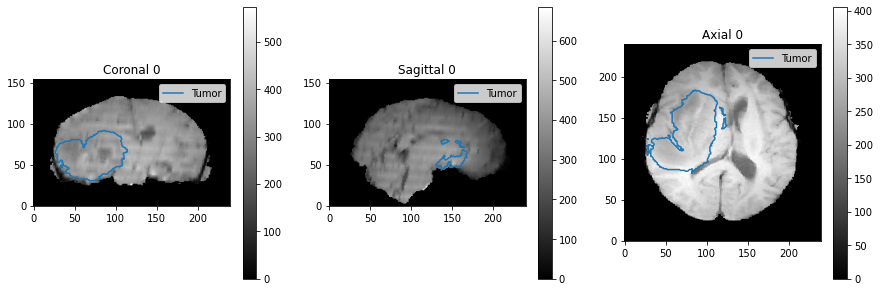

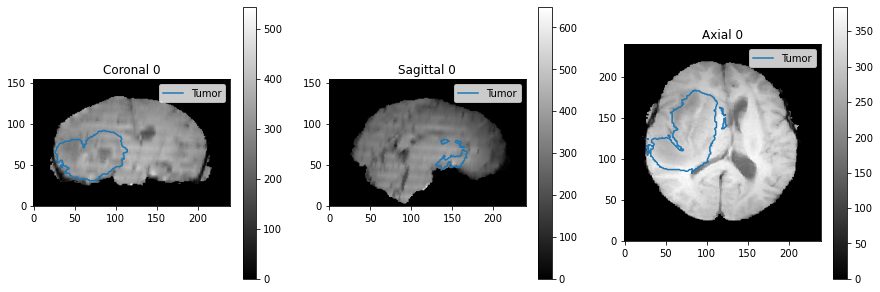

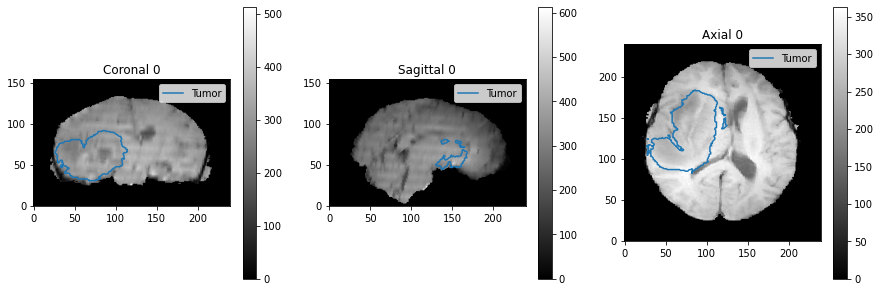

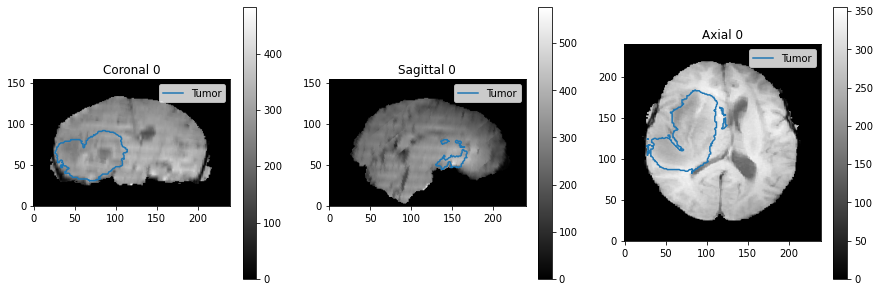

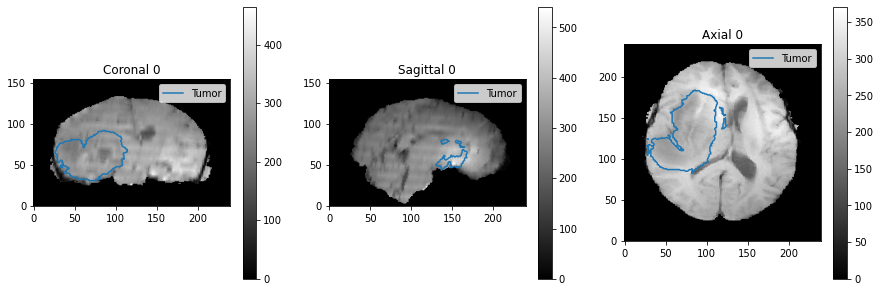

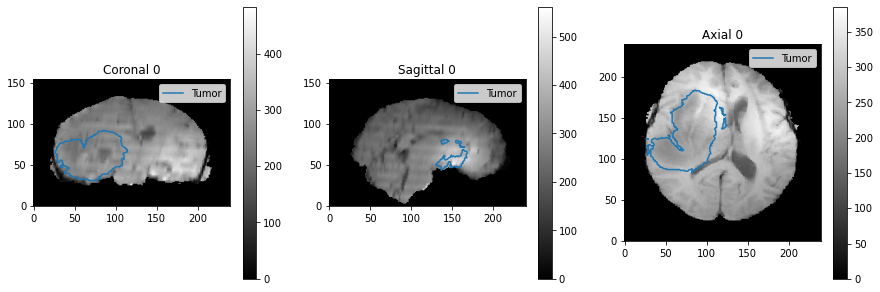

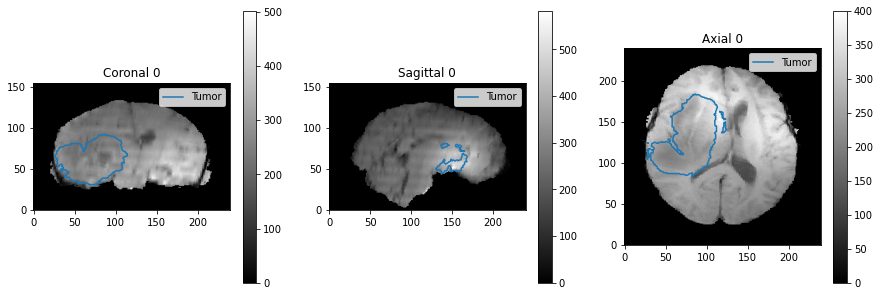

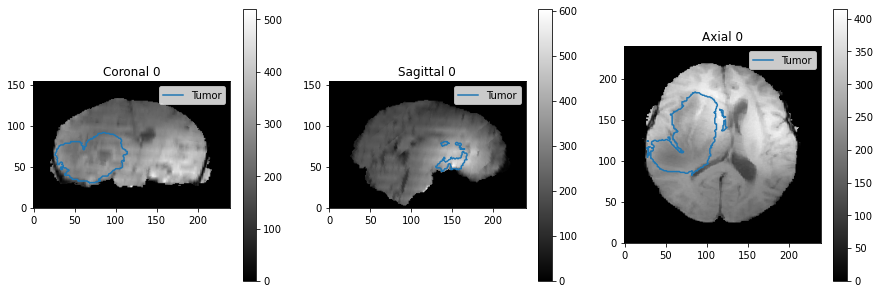

In [361]:
tp = np.transpose(transformed,axes = [1,0,2])
testVals = np.asarray([[1,1.05,1.1,1.15,1.2,1.25,1.3,1.35,1.4],
                       [1,0.95,0.9,0.85,0.8,0.75,0.7,0.65,0.6]])
sampInhDict = {}
nSamps = 1000

for artI in range(testVals.shape[1]):
    cVal = testVals[:,artI]
    print(cVal)
    aV = add_fake_skull(tp,dispTF=False)
#     aV = tp.copy()
    artV = add_inhomogeneity_artifact(aV,lblArr=tp_lbl,random_seed=42,
                                      maxMult=cVal[0],minMult =cVal[1],dispTF=False,)
    artV = remove_fake_skull(artV,tp)
    diffMat = np.abs(artV[fg]-tp[fg])
    
    sDiffMat = np.sort(diffMat)
    sampIdxs = np.linspace(0,len(sDiffMat)-1,nSamps).astype(int)
    sSamps = sDiffMat[sampIdxs]
    sampDF = pd.DataFrame({'Fraction':np.ones(nSamps)*cVal[0],'sNo': np.asarray(range(nSamps)),'val':sSamps})
    sampInhDict[artI] = sampDF
    mri_utils.plot_img_arr(artV,ctrArr=tp_lbl,ctrNames=['Tumor'])
#     mri_utils.plot_img_arr(artV-aV)

Text(0, 0.5, 'Absolute Intensity Difference')

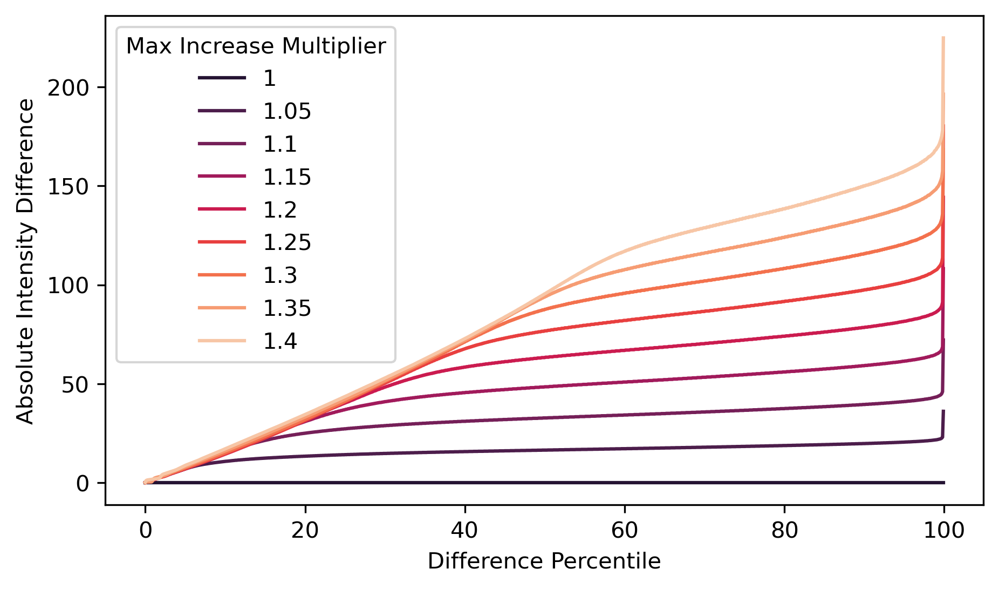

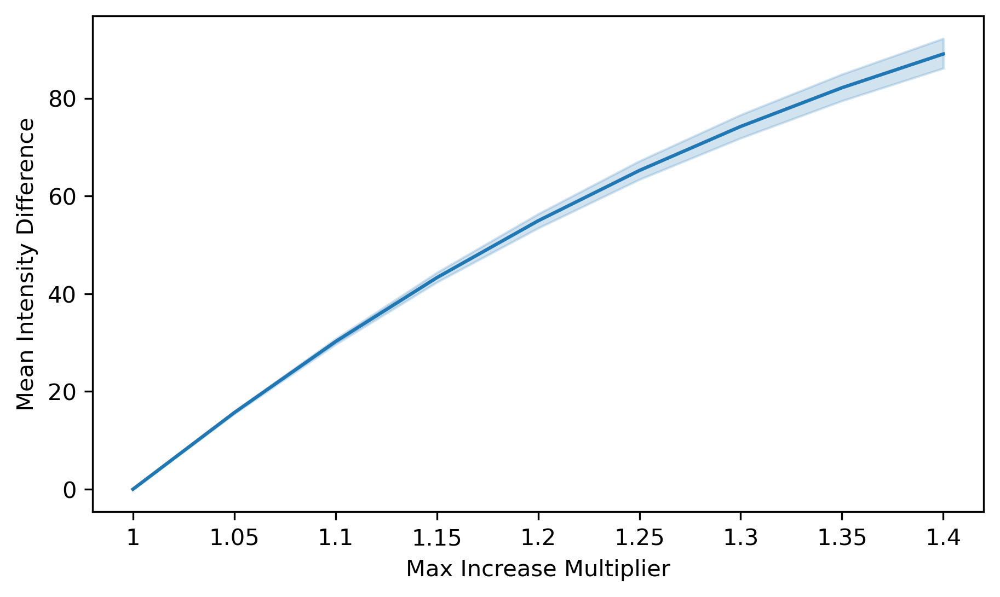

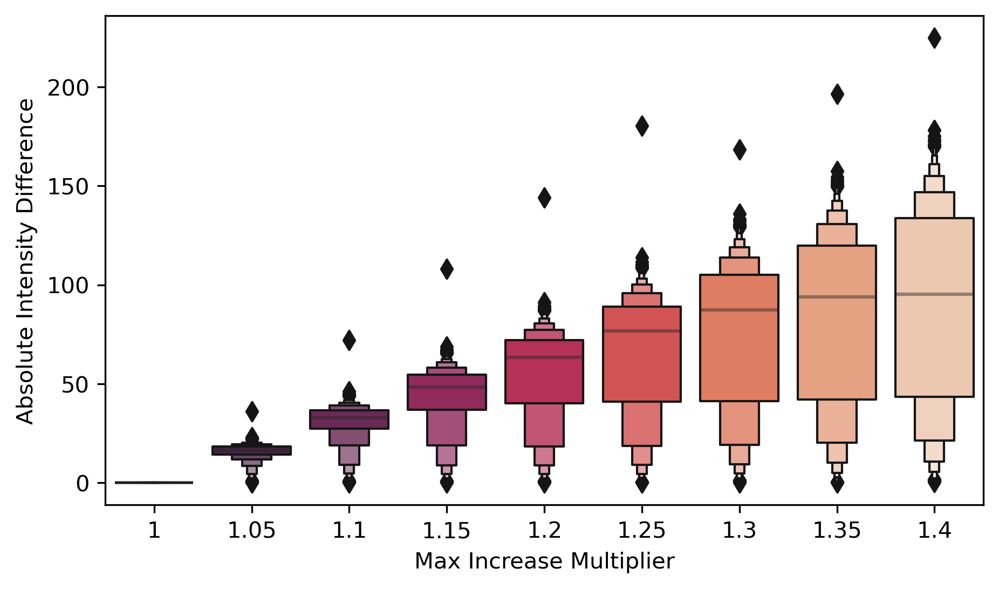

In [362]:
sampFDF = pd.concat(sampInhDict.values())
sampFDF['Max Increase Multiplier'] = ['%g' % (frac) for frac in sampFDF['Fraction']]

sampFDF['Difference Percentile'] = sampFDF['sNo']/10
plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Difference Percentile", y="val",hue='Max Increase Multiplier',palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.lineplot(data=sampFDF,x="Max Increase Multiplier", y="val")
hLP.set_ylabel('Mean Intensity Difference')

plt.figure(figsize=[7,4],dpi=300)
hLP = sns.boxenplot(data=sampFDF,x="Max Increase Multiplier", y="val",palette='rocket')
hLP.set_ylabel('Absolute Intensity Difference')

#  Load Model

In [31]:
import tensorflow as tf
import tensorflow.keras as keras

importlib.reload(tf)
FILTERS = 32
DATA_SIZE = 60000*144*144
PRIOR_MU = 0
PRIOR_SIGMA = 10

BATCH_SIZE = 128
EPOCHS = 200
VERBOSE = 2

tf.compat.v1.enable_eager_execution()
LAYER_NAME = 'all'
cmDir = os.path.join(root_dir,'..','GBM_LGG_tradeoffs','code','models',LAYER_NAME)
spec = importlib.util.spec_from_file_location('model',os.path.join(cmDir,'%s_model.py' % LAYER_NAME))
ModelLoader = importlib.util.module_from_spec(spec)
spec.loader.exec_module(ModelLoader)
model = ModelLoader.make_model()

model.load_weights(os.path.join(cmDir,'%s_model_weights.h5' % LAYER_NAME))




Input size: (None, 144, 144, 4)
Output size: (None, 144, 144, 1)


# Test models with artifacts

In [ ]:
from datetime import datetime
from hashlib import blake2s
RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
CPRMetricDict = {}
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])
cFrac = testFracs[3]
expList = modalList + ['control']
# cDS = 'GBM_test'
artShort = 'stRot'
for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    
    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pRMetricDict = {}

    for pNo in range(len(ptList)):
    # for pNo in range(1):
        print(datetime.now().isoformat(timespec='minutes'))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cFrac in testFracs:
                randMax = (2**32) -1
                # hash for random seed
#                 fID = '%s%s0' % (TCGA_ID,cModal)
    
                fID = '%s%s%i' % (TCGA_ID,cModal,cFrac)
                h = blake2s()
                h.update(fID.encode('utf-8'))
                h_int = int(h.hexdigest(), 16)

                random_hash = h_int + randAdd
                random_seed = random_hash % randMax

                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                elif cModal != 'control':
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                if cModal != 'control':
                    aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_stepwise_rotation_motion_artifact(aV,random_seed=random_seed,phRot=cFrac*np.pi,
                                                                 thRot=cFrac*np.pi/4,xyzTrMax=0,
                                                                 dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
            #     for mIdx in range(len(modalList)):
            #         modal= modalList[mIdx]
            #         mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

#                 output = np.zeros((144,144,144,1))
#                 for idx in range(cropImg.shape[0]):
#                     img = tf.expand_dims(cropImg[idx], axis=0)
#                     output[idx,:,:,:] = model.predict(img)
                output = model.predict(cropImg)
                
                artID = '%s_%02i_%s_%s' % (artShort,cFrac*48,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)

                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cFrac
                id_dict['TCGA_ID'] =  TCGA_ID

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        pRMetricDict[pNo] = metricDict
    cPRMetricDict[cDS] = pRMetricDict

2022-02-01T14:01
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T14:01


100%|██████████| 10/10 [00:30<00:00,  3.07s/it]


t1w 2022-02-01T14:11


100%|██████████| 10/10 [00:30<00:00,  3.06s/it]


t1gd 2022-02-01T14:21


100%|██████████| 10/10 [00:30<00:00,  3.06s/it]


t2w 2022-02-01T14:31


100%|██████████| 10/10 [00:30<00:00,  3.00s/it]


control 2022-02-01T14:41
2022-02-01T14:44
TCGA-27-2526
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T14:44


100%|██████████| 10/10 [00:29<00:00,  2.97s/it]


t1w 2022-02-01T14:57


100%|██████████| 10/10 [00:30<00:00,  3.02s/it]


t1gd 2022-02-01T15:09


100%|██████████| 10/10 [00:29<00:00,  2.90s/it]


t2w 2022-02-01T15:21


100%|██████████| 10/10 [00:29<00:00,  3.00s/it]


control 2022-02-01T15:34
2022-02-01T15:40
TCGA-06-0132
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T15:40


100%|██████████| 10/10 [00:30<00:00,  3.01s/it]


t1w 2022-02-01T15:51


100%|██████████| 10/10 [00:29<00:00,  2.93s/it]


t1gd 2022-02-01T16:02


100%|██████████| 10/10 [00:30<00:00,  3.01s/it]


t2w 2022-02-01T16:13


100%|██████████| 10/10 [00:30<00:00,  3.00s/it]


control 2022-02-01T16:24
2022-02-01T16:29
TCGA-12-1093
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T16:29


100%|██████████| 10/10 [00:30<00:00,  3.02s/it]


t1w 2022-02-01T16:41


100%|██████████| 10/10 [00:29<00:00,  2.93s/it]


t1gd 2022-02-01T16:53


100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


t2w 2022-02-01T17:05


100%|██████████| 10/10 [00:30<00:00,  3.01s/it]


control 2022-02-01T17:17
2022-02-01T17:23
TCGA-06-0648
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T17:23


100%|██████████| 10/10 [00:30<00:00,  3.01s/it]


t1w 2022-02-01T17:35


100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


t1gd 2022-02-01T17:46


100%|██████████| 10/10 [00:29<00:00,  2.93s/it]


t2w 2022-02-01T17:58


100%|██████████| 10/10 [00:30<00:00,  3.03s/it]


control 2022-02-01T18:10
2022-02-01T18:15
TCGA-06-0166
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T18:15


100%|██████████| 10/10 [00:29<00:00,  3.00s/it]


t1w 2022-02-01T18:26


100%|██████████| 10/10 [00:29<00:00,  2.96s/it]


t1gd 2022-02-01T18:38


100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


t2w 2022-02-01T18:49


100%|██████████| 10/10 [00:32<00:00,  3.23s/it]


control 2022-02-01T19:01
2022-02-01T19:06
TCGA-06-0133
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T19:06


100%|██████████| 10/10 [00:30<00:00,  3.02s/it]


t1w 2022-02-01T19:18


100%|██████████| 10/10 [00:31<00:00,  3.15s/it]


t1gd 2022-02-01T19:30


100%|██████████| 10/10 [00:29<00:00,  3.00s/it]


t2w 2022-02-01T19:42


100%|██████████| 10/10 [00:30<00:00,  3.03s/it]


control 2022-02-01T19:54
2022-02-01T19:59
TCGA-14-1829
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T19:59


100%|██████████| 10/10 [00:30<00:00,  3.04s/it]


t1w 2022-02-01T20:11


100%|██████████| 10/10 [00:29<00:00,  2.96s/it]


t1gd 2022-02-01T20:23


100%|██████████| 10/10 [00:31<00:00,  3.15s/it]


t2w 2022-02-01T20:35


100%|██████████| 10/10 [00:30<00:00,  3.04s/it]


control 2022-02-01T20:46
2022-02-01T20:52
TCGA-08-0352
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T20:52


100%|██████████| 10/10 [00:29<00:00,  2.96s/it]


t1w 2022-02-01T21:04


100%|██████████| 10/10 [00:30<00:00,  3.05s/it]


t1gd 2022-02-01T21:16


100%|██████████| 10/10 [00:30<00:00,  3.04s/it]


t2w 2022-02-01T21:28


100%|██████████| 10/10 [00:29<00:00,  3.00s/it]


control 2022-02-01T21:40
2022-02-01T21:45
TCGA-08-0521
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T21:45


100%|██████████| 10/10 [00:29<00:00,  2.90s/it]


t1w 2022-02-01T21:57


100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


t1gd 2022-02-01T22:08


100%|██████████| 10/10 [00:30<00:00,  3.01s/it]


t2w 2022-02-01T22:19


100%|██████████| 10/10 [00:29<00:00,  2.96s/it]


control 2022-02-01T22:31
2022-02-01T22:36
TCGA-08-0353
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T22:36


100%|██████████| 10/10 [00:31<00:00,  3.11s/it]


t1w 2022-02-01T22:48


100%|██████████| 10/10 [00:31<00:00,  3.11s/it]


t1gd 2022-02-01T23:00


100%|██████████| 10/10 [00:30<00:00,  3.01s/it]


t2w 2022-02-01T23:12


100%|██████████| 10/10 [00:29<00:00,  2.99s/it]


control 2022-02-01T23:24
2022-02-01T23:29
TCGA-19-1390
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-01T23:29


100%|██████████| 10/10 [00:29<00:00,  3.00s/it]


t1w 2022-02-01T23:41


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


t1gd 2022-02-01T23:53


100%|██████████| 10/10 [00:30<00:00,  3.01s/it]


In [63]:
# load metrics from file
artShort = 'stRot'
cMDict = {}
for cDS in ['GBM_test','LGG_test']:
    artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
    metFNList = []
    mDict = {}
    for root, dirs, files in os.walk(artOutDir):
        for dn in files:
            metFNList.append(dn)
    # print(metFNList)
    print('%s: %i',cDS,len(metFNList))
    for pNo in range(len(metFNList)):
        metFN = metFNList[pNo]
        metDF = pd.read_csv(os.path.join(artOutDir,metFN))
        mDict[pNo] = metDF.to_dict(orient='index')
    cMDict[cDS] = mDict
cPRMetricDict = cMDict

%s: %i GBM_test 33
%s: %i LGG_test 43


In [451]:
cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cMDict[cDS].values()]
cmbMet = pd.concat(cmbMet,axis=0)
cmbMet

,Unnamed: 0,artifact,sequence,fraction,TCGA_ID,Sensitivity,Specificity,Precision,Negative predictive value,False negative rate,...,Balanced Accuracy,F1 / Dice Score,Matthews Correlation Coefficient,Informedness / Bookmarker Informedness,Markedness,Jaccard Coefficient,Area under ROC Curve,Cohen Kappa,Rand Index,Mutual Information
0,stRot_01_flair_TCGA-HT-A5RC,stRot,flair,0.020833,TCGA-HT-A5RC,0.886047,0.994616,0.703243,0.998353,0.113953,...,0.940332,0.784132,0.786047,0.880663,0.701596,0.644915,0.983100,0.780660,0.986246,0.051633
1,stRot_02_flair_TCGA-HT-A5RC,stRot,flair,0.041667,TCGA-HT-A5RC,0.875784,0.994398,0.692427,0.998205,0.124216,...,0.935091,0.773386,0.775226,0.870183,0.690631,0.630505,0.985350,0.769736,0.985535,0.050502
2,stRot_03_flair_TCGA-HT-A5RC,stRot,flair,0.062500,TCGA-HT-A5RC,0.843297,0.994399,0.684331,0.997736,0.156703,...,0.918848,0.755543,0.755887,0.837696,0.682067,0.607127,0.986774,0.751651,0.984628,0.047814
3,stRot_04_flair_TCGA-HT-A5RC,stRot,flair,0.083333,TCGA-HT-A5RC,0.789152,0.994701,0.681965,0.996957,0.210848,...,0.891926,0.731653,0.729503,0.783853,0.678922,0.576856,0.983195,0.727504,0.983701,0.043886
4,stRot_05_flair_TCGA-HT-A5RC,stRot,flair,0.104167,TCGA-HT-A5RC,0.735148,0.994927,0.676025,0.996181,0.264852,...,0.865038,0.704348,0.700543,0.730075,0.672206,0.543624,0.980739,0.699910,0.982632,0.040084
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55,stRot_08_control_TCGA-HT-8105,stRot,control,0.166667,TCGA-HT-8105,0.729604,0.999344,0.989835,0.976846,0.270396,...,0.864474,0.840027,0.839440,0.728947,0.966681,0.724178,0.971884,0.828289,0.956236,0.173194
56,stRot_09_control_TCGA-HT-8105,stRot,control,0.187500,TCGA-HT-8105,0.729604,0.999344,0.989835,0.976846,0.270396,...,0.864474,0.840027,0.839440,0.728947,0.966681,0.724178,0.971884,0.828289,0.956236,0.173194
57,stRot_10_control_TCGA-HT-8105,stRot,control,0.208333,TCGA-HT-8105,0.729604,0.999344,0.989835,0.976846,0.270396,...,0.864474,0.840027,0.839440,0.728947,0.966681,0.724178,0.971884,0.828289,0.956236,0.173194
58,stRot_11_control_TCGA-HT-8105,stRot,control,0.229167,TCGA-HT-8105,0.729604,0.999344,0.989835,0.976846,0.270396,...,0.864474,0.840027,0.839440,0.728947,0.966681,0.724178,0.971884,0.828289,0.956236,0.173194


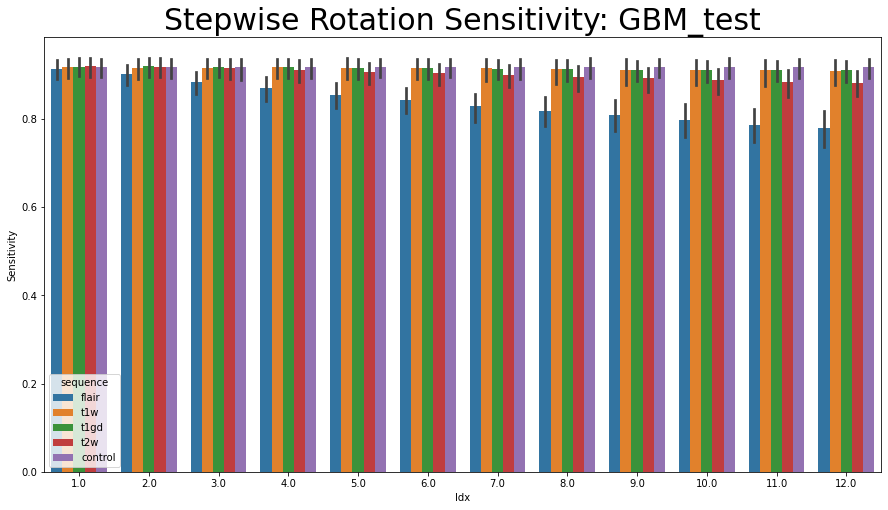

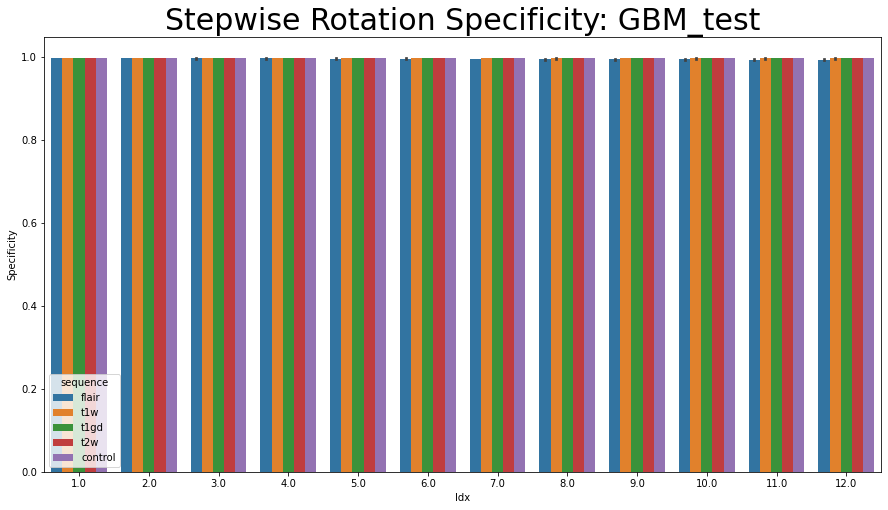

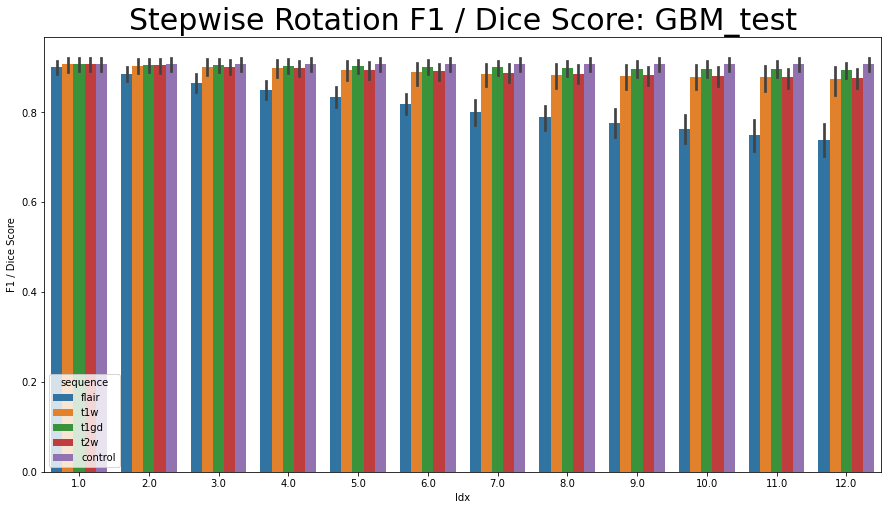

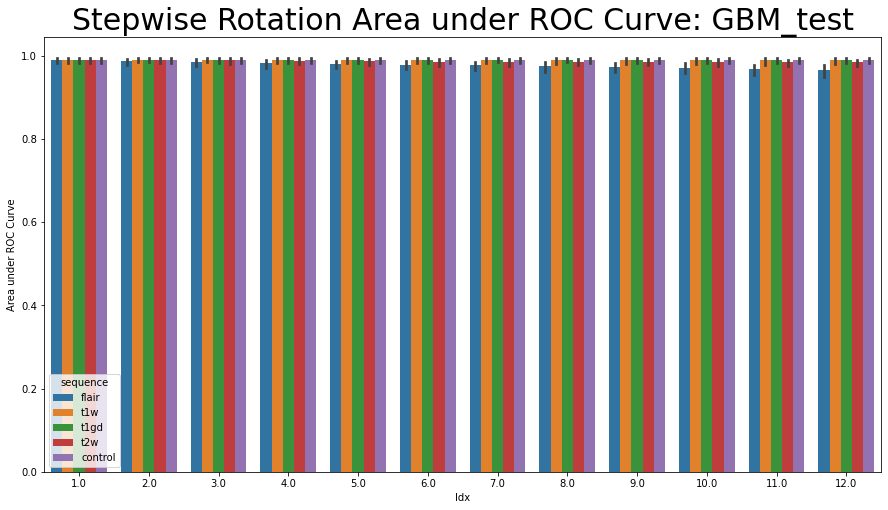

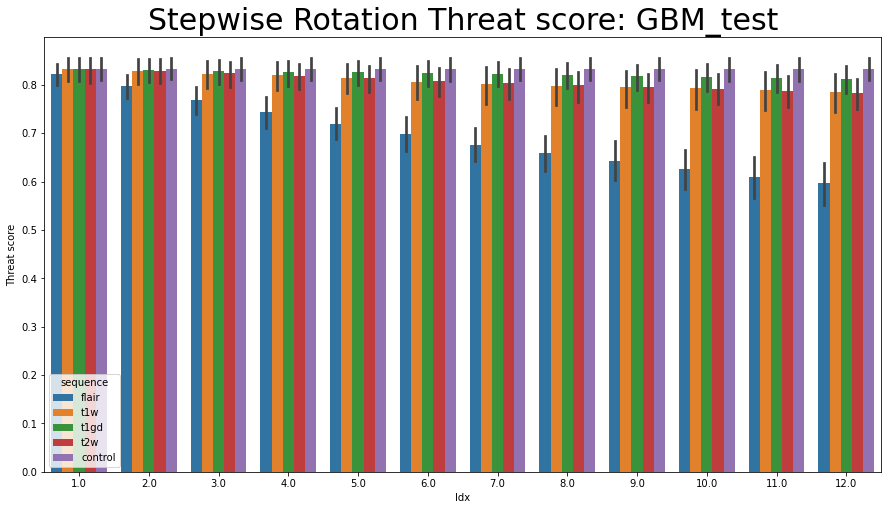

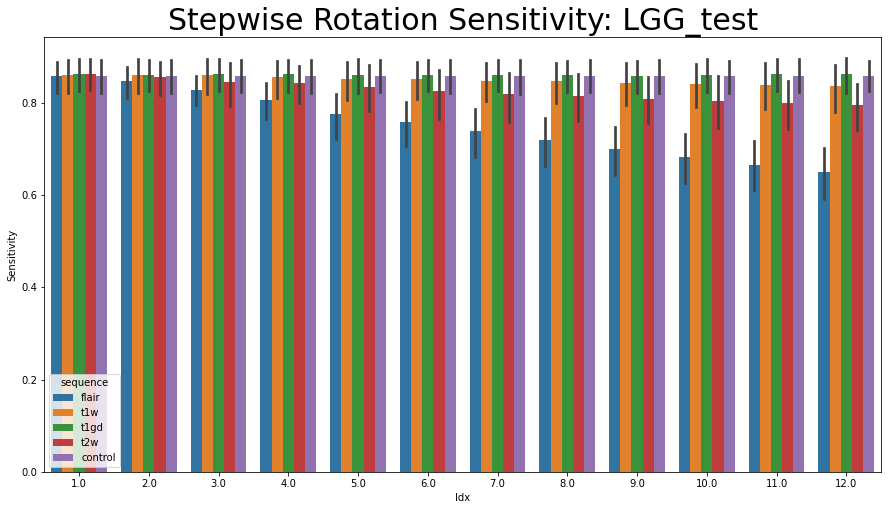

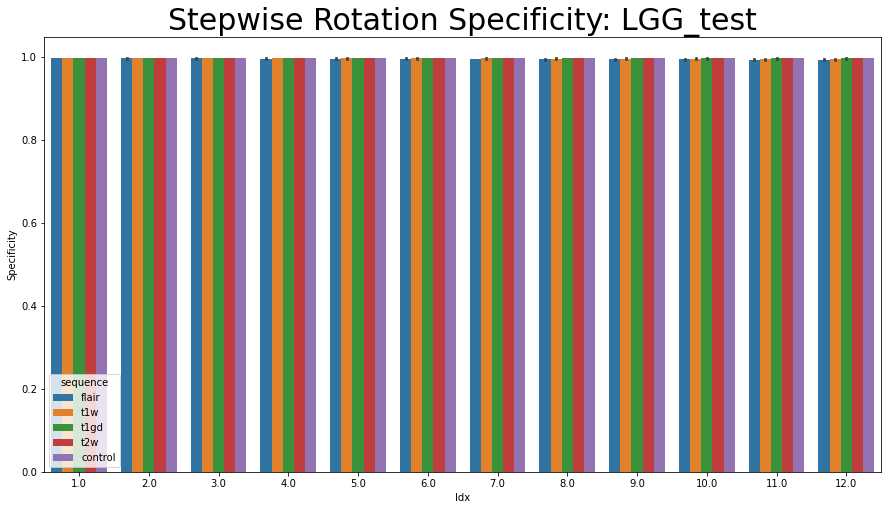

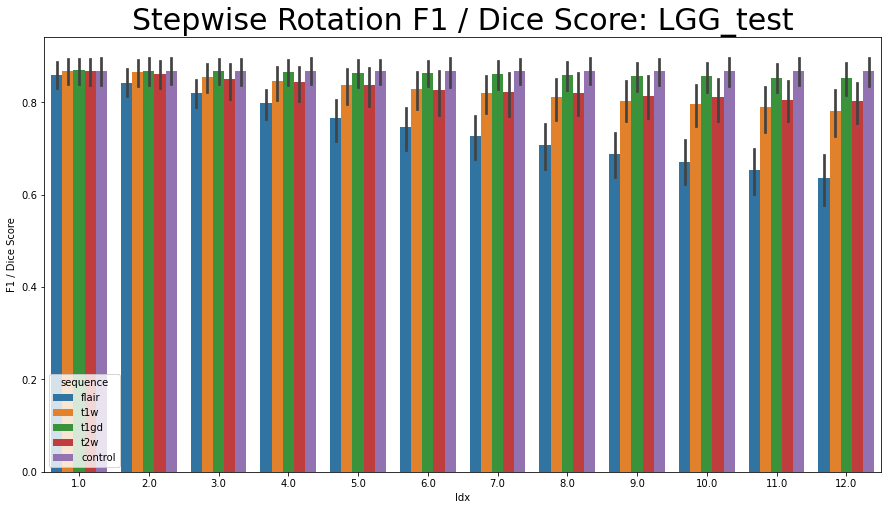

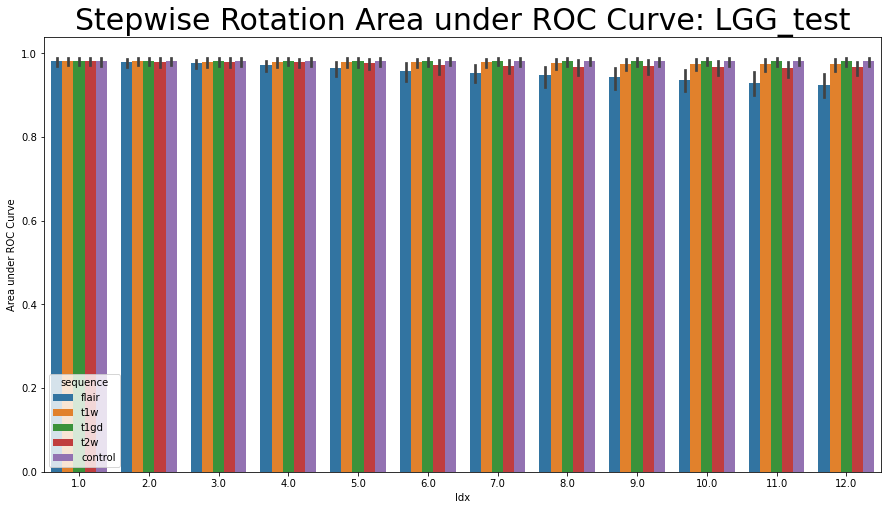

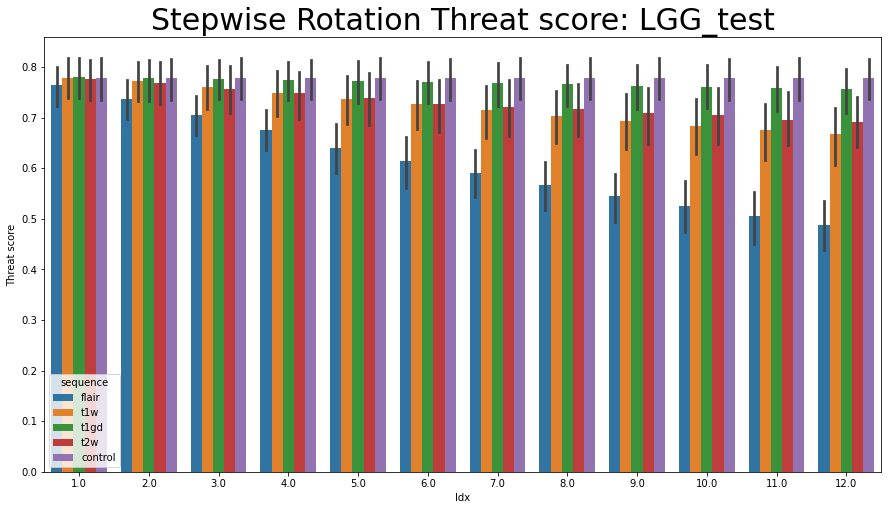

In [135]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPRMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = np.round(cmbMet['fraction'] * 48)
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve','Threat score']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('Stepwise Rotation %s: %s' % (cMetric,cDS),fontsize=30)
        sns.barplot(data=cmbMet,x="Idx", y=cMetric,hue="sequence")
        plt.show()

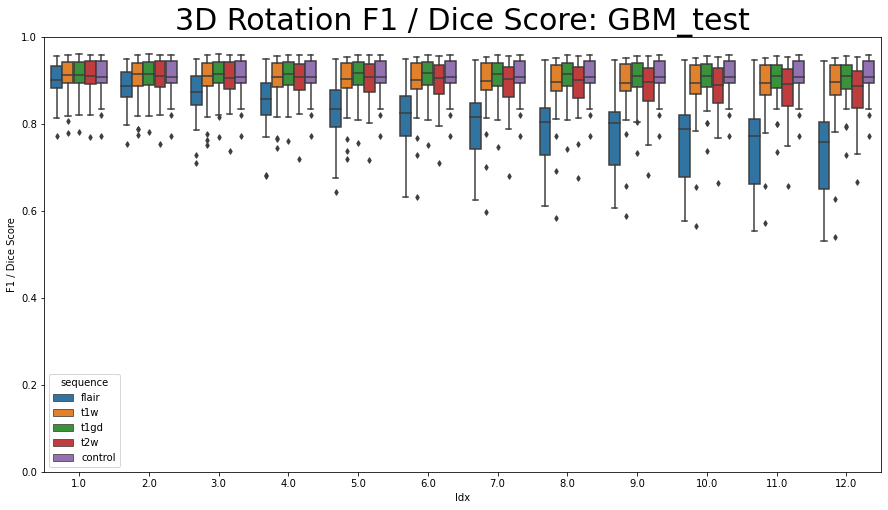

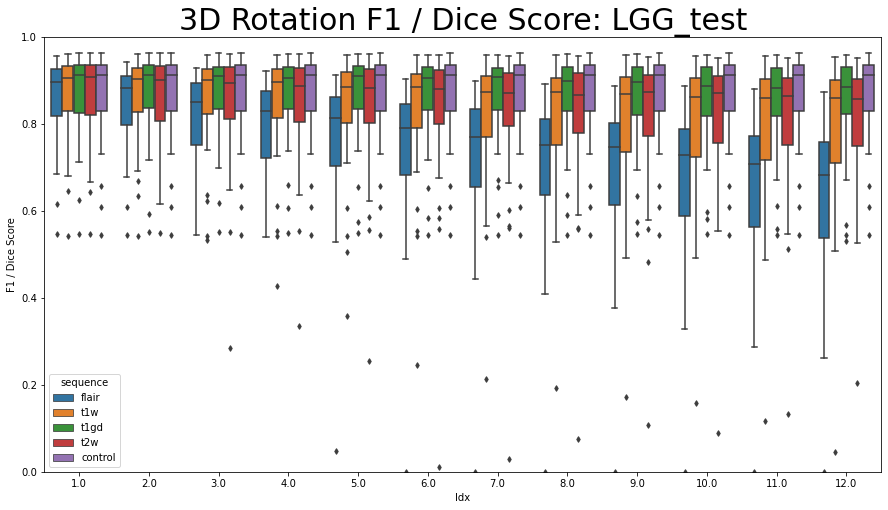

In [136]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPRMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = np.round(cmbMet['fraction'] * 48)
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
#     for cMetric in metList:
#         plt.figure(figsize=(15,8))
#         plt.title('Stepwise Rotation %s: %s' % (cMetric,cDS),fontsize=30)
#         sns.boxenplot(data=cmbMet,x="Idx", y=cMetric,hue="sequence")
    metList =['F1 / Dice Score']
    for cMetric in metList:

        
        plt.figure(figsize=(15,8))
        plt.title('3D Rotation %s: %s' % (cMetric,cDS),fontsize=30)
#         h_box = sns.boxenplot(data=cmbMet, showfliers=True, k_depth = 3,x="Idx", y=cMetric,hue="sequence")
        h_box = sns.boxplot(data=cmbMet, showfliers=True,x="Idx", y=cMetric,hue="sequence",fliersize=4)
        h_box.set_ylim([0,1])
        plt.show()

In [137]:
print('3D Rotation')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPRMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for seq in modalList:
        aovrm2way = AnovaRM(cmbMet[cmbMet['sequence'] ==seq], 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
        res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
        print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']))

3D Rotation
GBM, flair: pVal = 7.56866e-97
GBM, t1w: pVal = 1.40098e-14
GBM, t1gd: pVal = 2.13214e-29
GBM, t2w: pVal = 2.34403e-45
LGG, flair: pVal = 2.49397e-98
LGG, t1w: pVal = 4.65323e-34
LGG, t1gd: pVal = 8.50356e-12
LGG, t2w: pVal = 3.20686e-20


# Test Stepwise Motion

In [ ]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
cPMMetricDict = {}
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])
expList = modalList + ['control']
# cDS = 'GBM_test'
artShort = 'stMot'
for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    
    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pMMetricDict = {}

    for pNo in range(len(ptList)):
    # for pNo in range(1):
        print('%i/%i : %s' %(pNo,len(ptList), datetime.now().isoformat(timespec='minutes')))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cFrac in testFracs:
                randMax = (2**32) -1
                # hash for random seed
                fID = '%s%s%i' % (TCGA_ID,cModal,cFrac)
                h = blake2s()
                h.update(fID.encode('utf-8'))
                h_int = int(h.hexdigest(), 16)

                random_hash = h_int + randAdd
                random_seed = random_hash % randMax

                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                elif cModal != 'control':
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                if cModal != 'control':
                    aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_stepwise_rotation_motion_artifact(aV,random_seed=random_seed,phRot=cFrac*np.pi,
                                                                 thRot=cFrac*np.pi/4,xyzTrMax=cFrac*24,
                                                                 dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
            #     for mIdx in range(len(modalList)):
            #         modal= modalList[mIdx]
            #         mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

#                 output = np.zeros((144,144,144,1))
#                 for idx in range(cropImg.shape[0]):
#                     img = tf.expand_dims(cropImg[idx], axis=0)
#                     output[idx,:,:,:] = model.predict(img)
                output = model.predict(cropImg)
                
                artID = '%s_%02i_%s_%s' % (artShort,cFrac*48,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)

                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cFrac
                id_dict['TCGA_ID'] =  TCGA_ID

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        pMMetricDict[pNo] = metricDict
    cPMMetricDict[cDS] = pMMetricDict

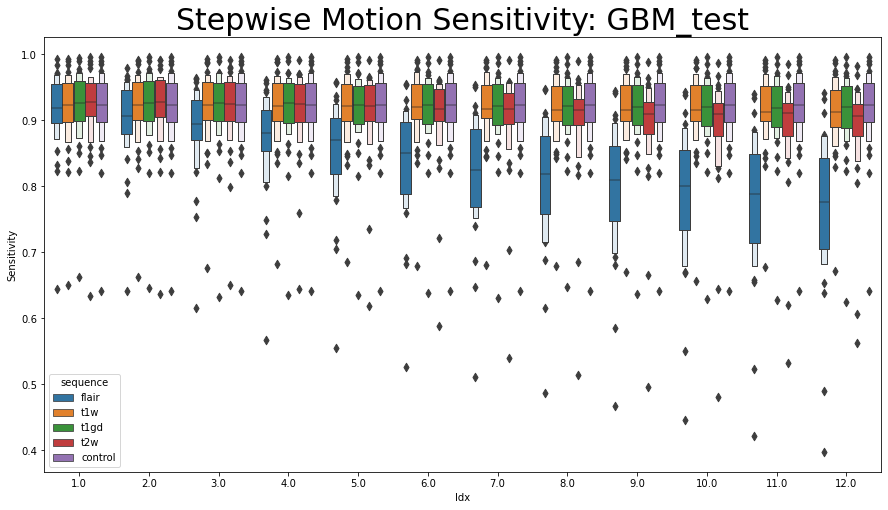

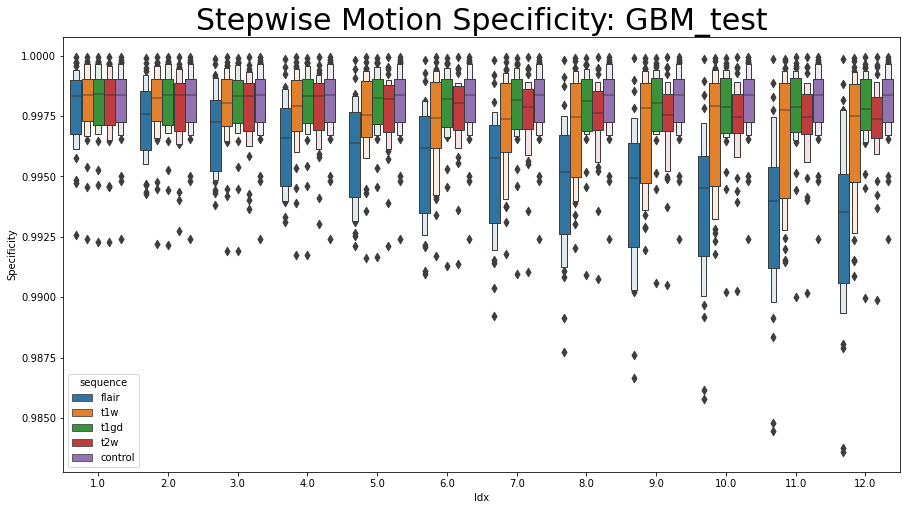

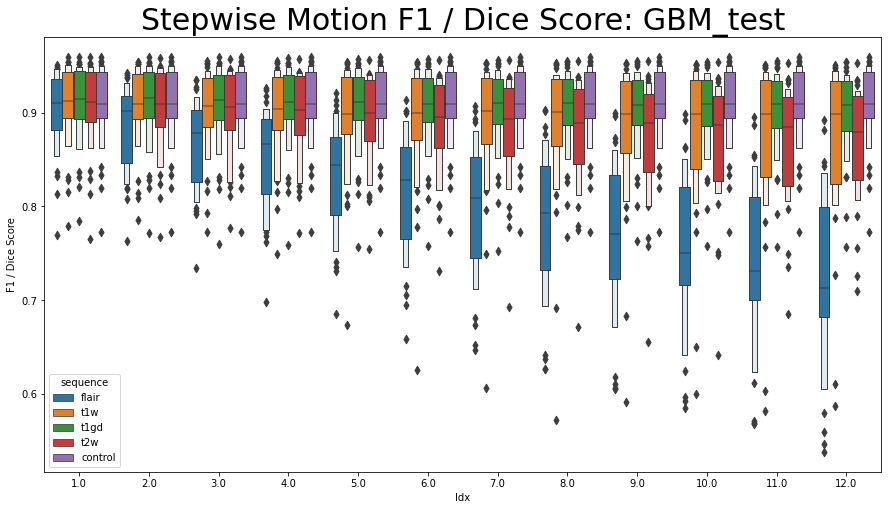

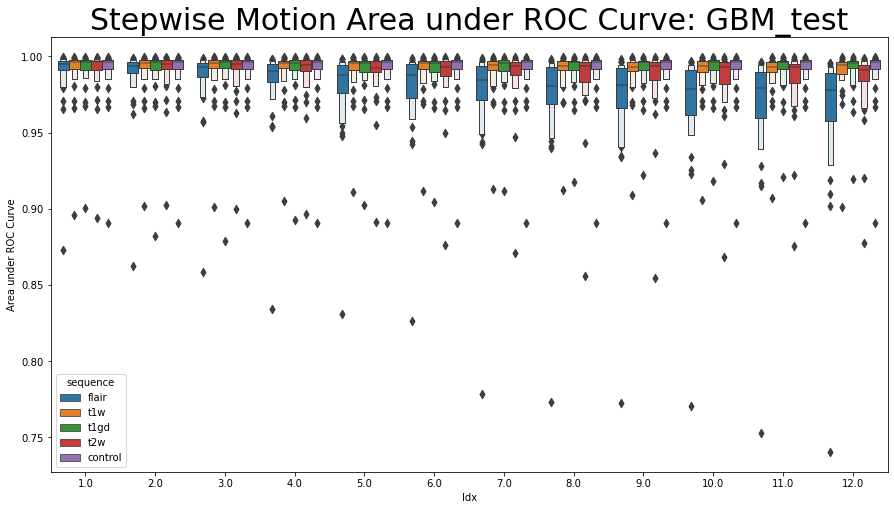

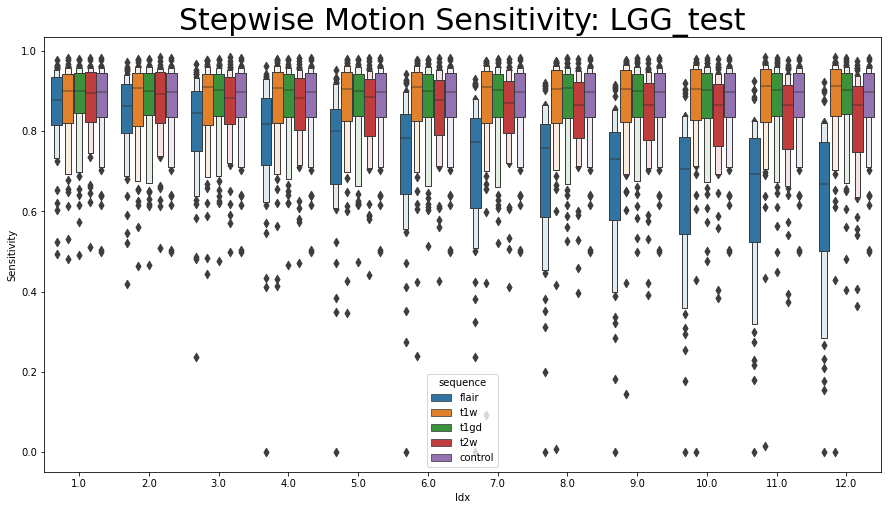

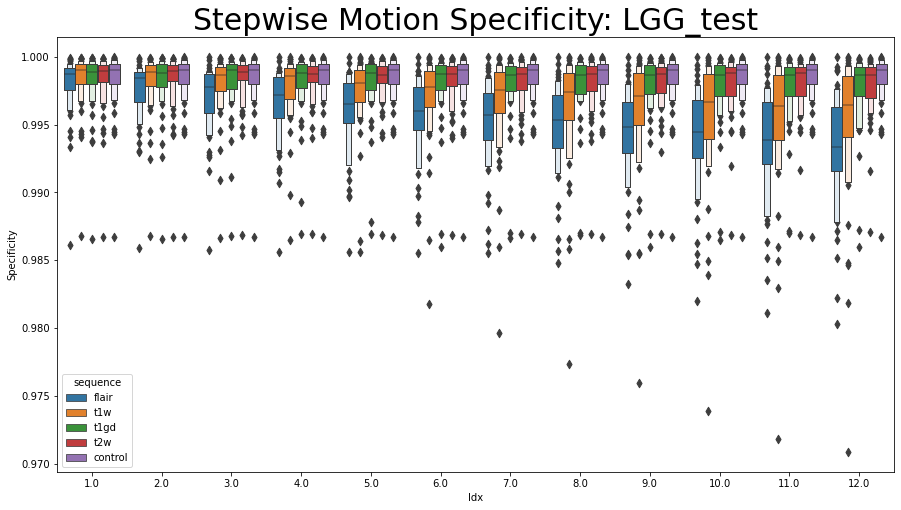

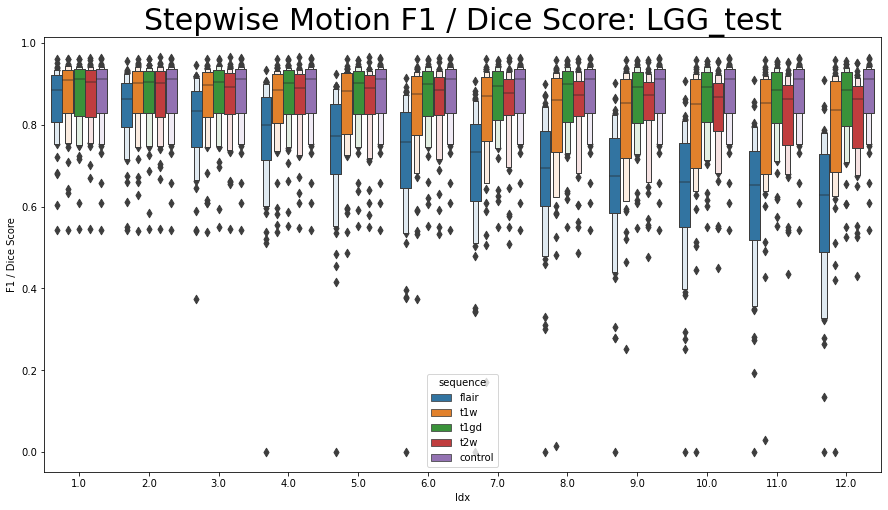

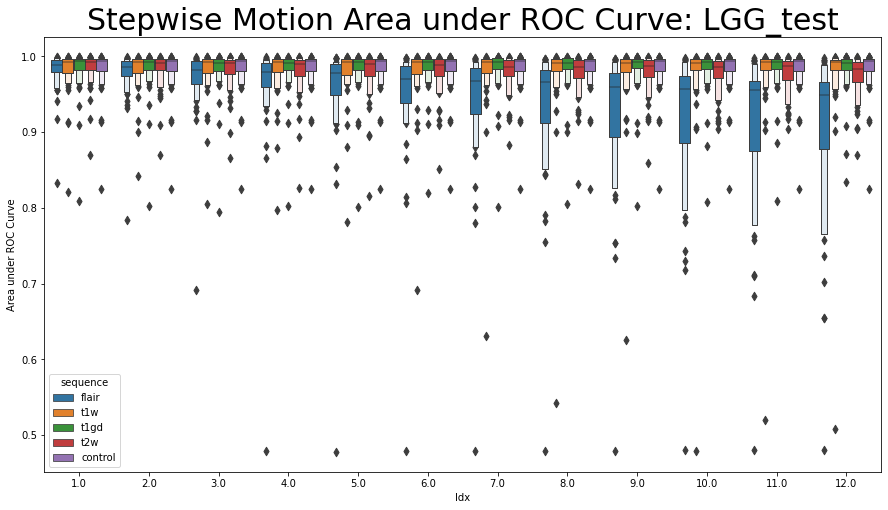

In [220]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPMMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPMMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = cmbMet['fraction'] * 48
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('Stepwise Motion %s: %s' % (cMetric,cDS),fontsize=30)
        sns.boxenplot(data=cmbMet,x="Idx", y=cMetric,hue="sequence")
        plt.show()

In [65]:
# load metrics from file
artShort = 'stMot'
cMDict = {}
for cDS in ['GBM_test','LGG_test']:
    artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
    metFNList = []
    mDict = {}
    for root, dirs, files in os.walk(artOutDir):
        for dn in files:
            metFNList.append(dn)
    # print(metFNList)
    print('%s: %i',cDS,len(metFNList))
    for pNo in range(len(metFNList)):
        metFN = metFNList[pNo]
        metDF = pd.read_csv(os.path.join(artOutDir,metFN))
        mDict[pNo] = metDF.to_dict(orient='index')
    cMDict[cDS] = mDict
cPMMetricDict = cMDict

%s: %i GBM_test 33
%s: %i LGG_test 43


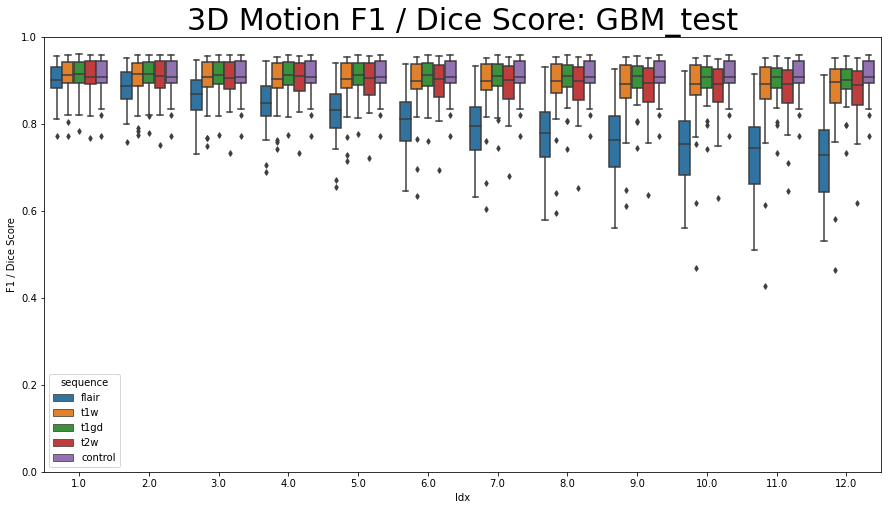

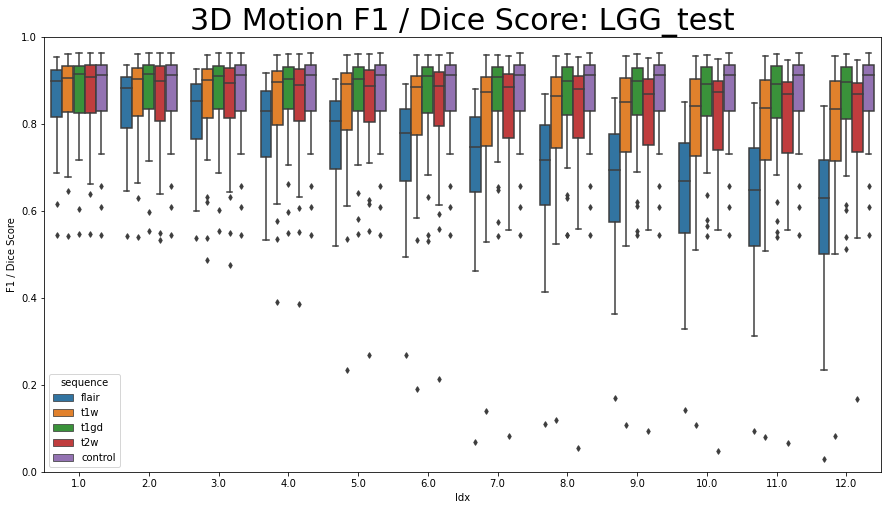

In [66]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPMMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = np.round(cmbMet['fraction'] * 48)
    metList =['F1 / Dice Score']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('3D Motion %s: %s' % (cMetric,cDS),fontsize=30)
#         h_box = sns.boxenplot(data=cmbMet, showfliers=True, k_depth = 3,x="Idx", y=cMetric,hue="sequence")
        h_box = sns.boxplot(data=cmbMet, showfliers=True,x="Idx", y=cMetric,hue="sequence",fliersize=4)
        h_box.set_ylim([0,1])
        plt.show()

In [409]:
print('Stepwise Motion')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPMMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for seq in modalList:
        aovrm2way = AnovaRM(cmbMet[cmbMet['sequence'] ==seq], 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
        res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
        print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']))

Stepwise Motion
GBM, flair: pVal = 4.97294e-119
GBM, t1w: pVal = 6.94596e-15
GBM, t1gd: pVal = 7.51701e-32
GBM, t2w: pVal = 1.06726e-43
LGG, flair: pVal = 5.60427e-135
LGG, t1w: pVal = 1.37145e-30
LGG, t1gd: pVal = 1.75132e-13
LGG, t2w: pVal = 1.47441e-22


# Test Stepwise Translation

In [ ]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
cPTMetricDict = {}
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])
cFrac = testFracs[3]
expList = modalList + ['control']
# cDS = 'GBM_test'
artShort = 'stTr'
for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    
    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pTMetricDict = {}

    for pNo in range(len(ptList)):
    # for pNo in range(1):
        print('%i/%i : %s' %(pNo,len(ptList), datetime.now().isoformat(timespec='minutes')))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cFrac in testFracs:
                randMax = (2**32) -1
                # hash for random seed
                fID = '%s%s%i' % (TCGA_ID,cModal,cFrac)
                h = blake2s()
                h.update(fID.encode('utf-8'))
                h_int = int(h.hexdigest(), 16)

                random_hash = h_int + randAdd
                random_seed = random_hash % randMax

                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                elif cModal != 'control':
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                if cModal != 'control':
                    aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_stepwise_rotation_motion_artifact(aV,random_seed=random_seed,phRot=0,
                                                                 thRot=0,xyzTrMax=cFrac*24,
                                                                 dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
            #     for mIdx in range(len(modalList)):
            #         modal= modalList[mIdx]
            #         mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

#                 output = np.zeros((144,144,144,1))
#                 for idx in range(cropImg.shape[0]):
#                     img = tf.expand_dims(cropImg[idx], axis=0)
#                     output[idx,:,:,:] = model.predict(img)
                output = model.predict(cropImg)
                
                artID = '%s_%02i_%s_%s' % (artShort,cFrac*48,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)

                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cFrac
                id_dict['TCGA_ID'] =  TCGA_ID

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        pTMetricDict[pNo] = metricDict
    cPTMetricDict[cDS] = pTMetricDict

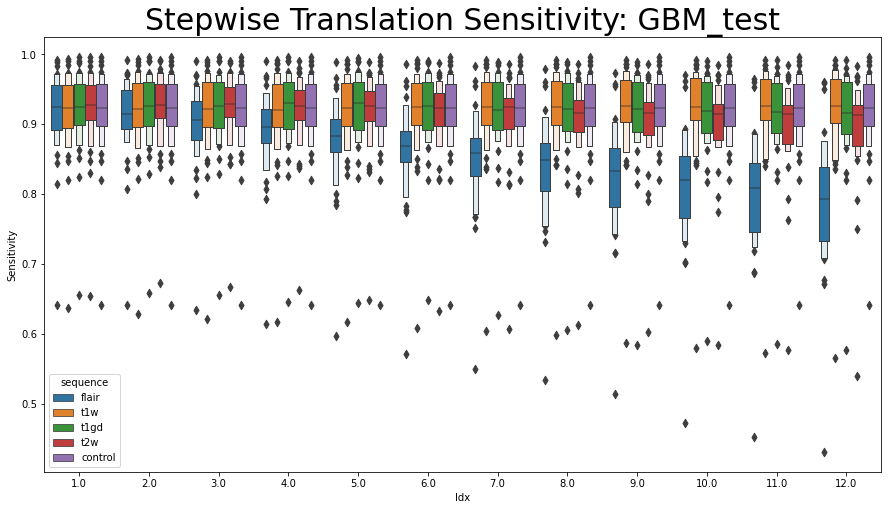

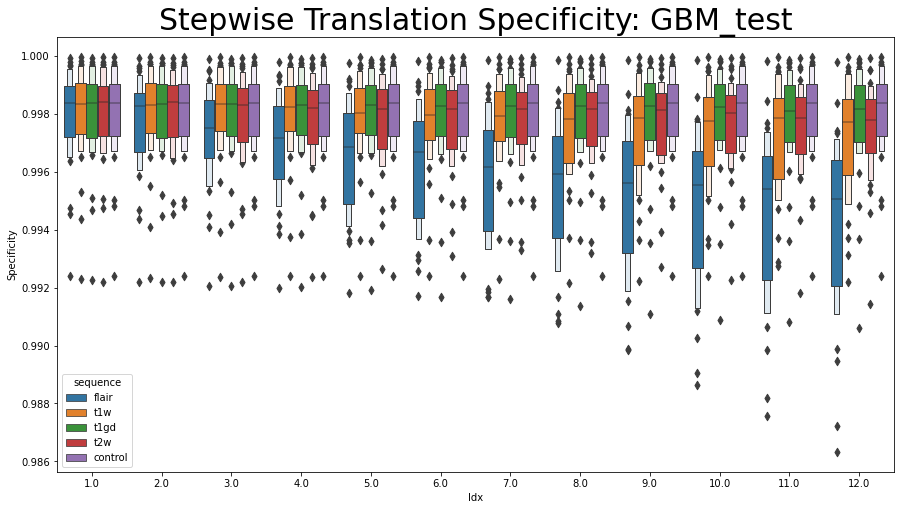

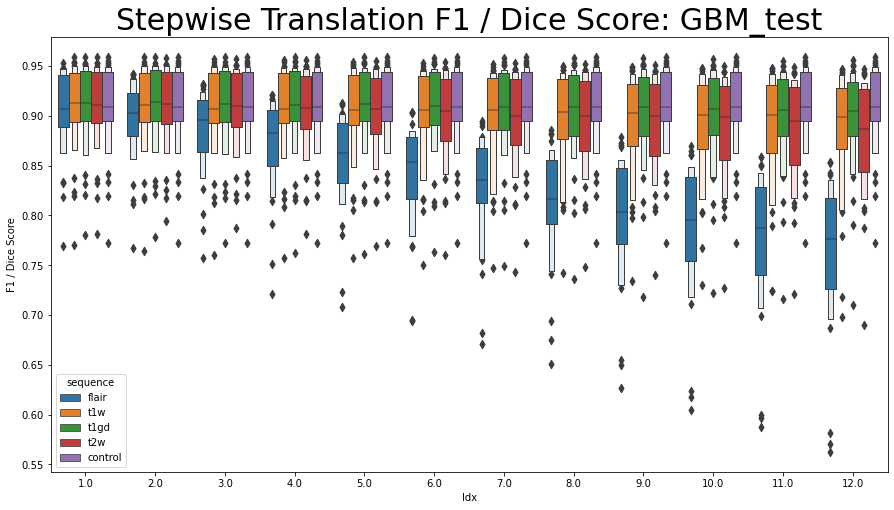

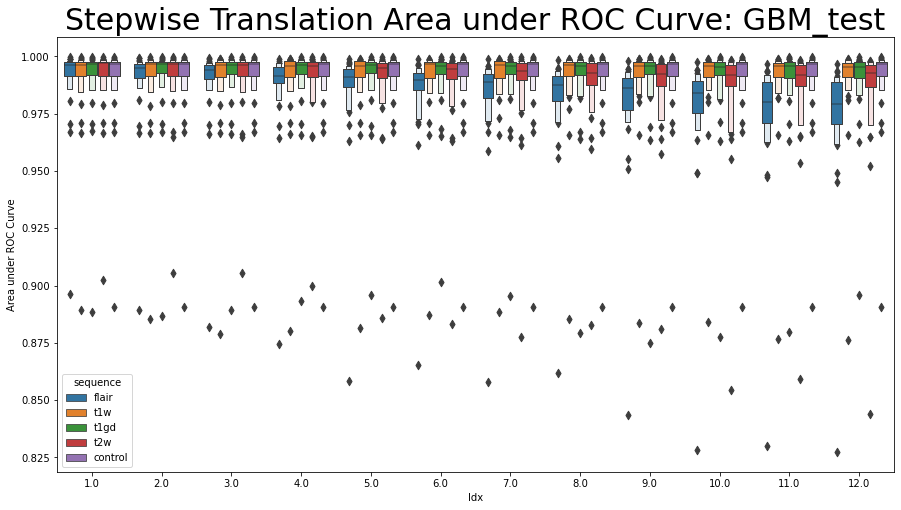

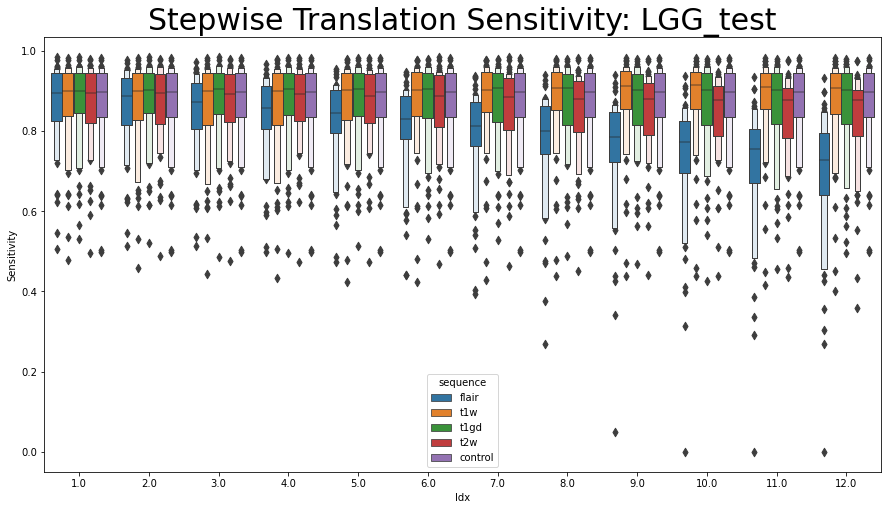

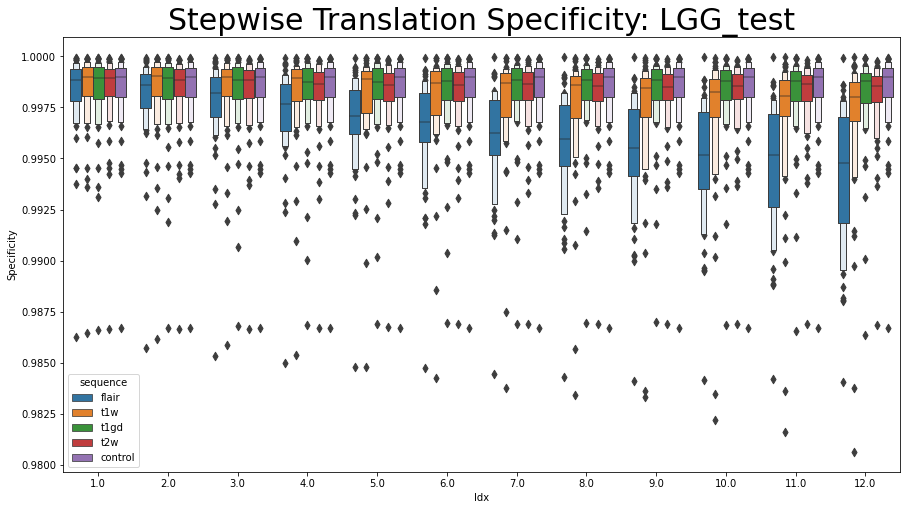

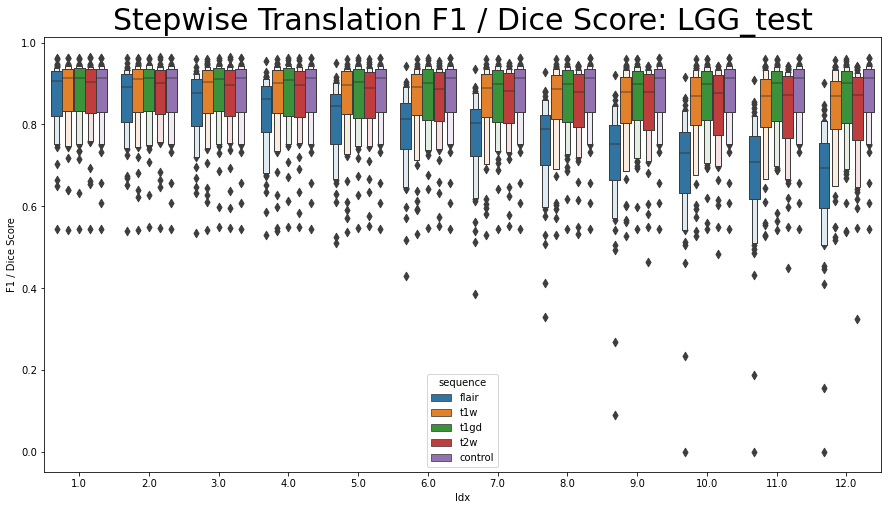

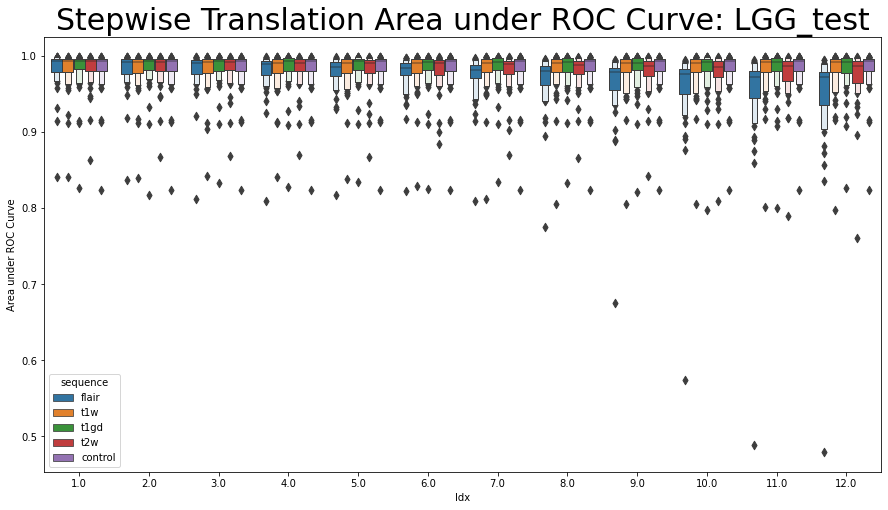

In [223]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPTMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = cmbMet['fraction'] * 48
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('3d Translation %s: %s' % (cMetric,cDS),fontsize=30)
        h_box = sns.boxplot(data=cmbMet,x="Idx", y=cMetric,hue="sequence",fliersize=4)
        plt.show()

In [408]:
print('3D Translation')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPTMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for seq in modalList:
        aovrm2way = AnovaRM(cmbMet[cmbMet['sequence'] ==seq], 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
        res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
        print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']))

Stepwise Translation
GBM, flair: pVal = 2.16055e-126
GBM, t1w: pVal = 3.84348e-24
GBM, t1gd: pVal = 2.4998e-24
GBM, t2w: pVal = 1.63929e-59
LGG, flair: pVal = 7.96971e-106
LGG, t1w: pVal = 2.22111e-39
LGG, t1gd: pVal = 3.08289e-14
LGG, t2w: pVal = 1.0363e-36


# Test 2D rotation on models

In [ ]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
cP2dMetricDict = {}
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])

expList = modalList + ['control']
# cDS = 'GBM_test'
artShort = '2dRot'
for cDS in ['GBM_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    
    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    p2dMetricDict = {}
    for pNo in range(len(ptList)): 
    # for pNo in range(1):
        print(datetime.now().isoformat(timespec='minutes'))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cFrac in testFracs:
                randMax = (2**32) -1
                # hash for random seed
                fID = '%s%s%i' % (TCGA_ID,cModal,cFrac)
                h = blake2s()
                h.update(fID.encode('utf-8'))
                h_int = int(h.hexdigest(), 16)

                random_hash = h_int + randAdd
                random_seed = random_hash % randMax

                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                elif cModal != 'control':
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                if cModal != 'control':
                    aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_2d_rotation_motion_artifact(aV,random_seed=random_seed,phRot=cFrac*np.pi,
                                                                 thRot=cFrac*np.pi/4,xyzTrMax=0,dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
            #     for mIdx in range(len(modalList)):
            #         modal= modalList[mIdx]
            #         mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

                output = np.zeros((144,144,144,1))
                for idx in range(cropImg.shape[0]):
                    img = tf.expand_dims(cropImg[idx], axis=0)
                    output[idx,:,:,:] = model.predict(img)

                artID = '%s_%02i_%s_%s' % (artShort,cFrac*48,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)

                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cFrac
                id_dict['TCGA_ID'] =  TCGA_ID

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        p2dMetricDict[pNo] = metricDict
    cP2dMetricDict[cDS] = p2dMetricDict

2022-02-09T15:19
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T15:19


100%|██████████| 10/10 [00:28<00:00,  2.87s/it]


t1w 2022-02-09T15:29


100%|██████████| 10/10 [00:28<00:00,  2.88s/it]


t1gd 2022-02-09T15:39


100%|██████████| 10/10 [00:28<00:00,  2.87s/it]


t2w 2022-02-09T15:49


100%|██████████| 10/10 [00:28<00:00,  2.88s/it]


control 2022-02-09T15:59
2022-02-09T16:03
TCGA-27-2526
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T16:03


100%|██████████| 10/10 [00:28<00:00,  2.89s/it]


t1w 2022-02-09T16:16


100%|██████████| 10/10 [00:29<00:00,  2.92s/it]


t1gd 2022-02-09T16:29


100%|██████████| 10/10 [00:28<00:00,  2.81s/it]


t2w 2022-02-09T16:42


100%|██████████| 10/10 [00:28<00:00,  2.89s/it]


control 2022-02-09T16:54
2022-02-09T17:01
TCGA-06-0132
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T17:01


100%|██████████| 10/10 [00:29<00:00,  2.96s/it]


t1w 2022-02-09T17:13


100%|██████████| 10/10 [00:28<00:00,  2.86s/it]


t1gd 2022-02-09T17:24


100%|██████████| 10/10 [00:29<00:00,  2.90s/it]


t2w 2022-02-09T17:35


100%|██████████| 10/10 [00:28<00:00,  2.82s/it]


control 2022-02-09T17:47
2022-02-09T17:52
TCGA-12-1093
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T17:52


100%|██████████| 10/10 [00:29<00:00,  2.92s/it]


t1w 2022-02-09T18:05


100%|██████████| 10/10 [00:29<00:00,  2.99s/it]


t1gd 2022-02-09T18:17


100%|██████████| 10/10 [00:28<00:00,  2.85s/it]


t2w 2022-02-09T18:30


100%|██████████| 10/10 [00:29<00:00,  2.92s/it]


control 2022-02-09T18:42
2022-02-09T18:49
TCGA-06-0648
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T18:49


100%|██████████| 10/10 [00:28<00:00,  2.87s/it]


t1w 2022-02-09T19:01


100%|██████████| 10/10 [00:29<00:00,  2.92s/it]


t1gd 2022-02-09T19:13


100%|██████████| 10/10 [00:28<00:00,  2.83s/it]


t2w 2022-02-09T19:25


100%|██████████| 10/10 [00:30<00:00,  3.08s/it]


control 2022-02-09T19:37
2022-02-09T19:43
TCGA-06-0166
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T19:43


100%|██████████| 10/10 [00:29<00:00,  2.90s/it]


t1w 2022-02-09T19:55


100%|██████████| 10/10 [00:28<00:00,  2.88s/it]


t1gd 2022-02-09T20:07


100%|██████████| 10/10 [00:28<00:00,  2.86s/it]


t2w 2022-02-09T20:18


100%|██████████| 10/10 [00:30<00:00,  3.07s/it]


control 2022-02-09T20:30
2022-02-09T20:36
TCGA-06-0133
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T20:36


100%|██████████| 10/10 [00:29<00:00,  2.93s/it]


t1w 2022-02-09T20:49


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


t1gd 2022-02-09T21:01


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


t2w 2022-02-09T21:13


100%|██████████| 10/10 [00:29<00:00,  2.99s/it]


control 2022-02-09T21:26
2022-02-09T21:32
TCGA-14-1829
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T21:32


100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


t1w 2022-02-09T21:44


100%|██████████| 10/10 [00:29<00:00,  2.93s/it]


t1gd 2022-02-09T21:56


100%|██████████| 10/10 [00:29<00:00,  2.92s/it]


t2w 2022-02-09T22:08


100%|██████████| 10/10 [00:28<00:00,  2.85s/it]


control 2022-02-09T22:20
2022-02-09T22:26
TCGA-08-0352
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T22:26


100%|██████████| 10/10 [00:29<00:00,  2.96s/it]


t1w 2022-02-09T22:38


100%|██████████| 10/10 [00:29<00:00,  2.91s/it]


t1gd 2022-02-09T22:51


100%|██████████| 10/10 [00:29<00:00,  2.91s/it]


t2w 2022-02-09T23:03


100%|██████████| 10/10 [00:28<00:00,  2.81s/it]


control 2022-02-09T23:15
2022-02-09T23:22
TCGA-08-0521
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-02-09T23:22


100%|██████████| 10/10 [00:28<00:00,  2.81s/it]


t1w 2022-02-09T23:33


100%|██████████| 10/10 [00:28<00:00,  2.85s/it]


t1gd 2022-02-09T23:45


100%|██████████| 10/10 [00:28<00:00,  2.83s/it]


t2w 2022-02-09T23:56


100%|██████████| 10/10 [00:28<00:00,  2.85s/it]


In [146]:
# load metrics from file
artShort = '2dRot'
cMDict = {}
for cDS in ['GBM_test','LGG_test']:
    artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
    metFNList = []
    mDict = {}
    for root, dirs, files in os.walk(artOutDir):
        for dn in files:
            metFNList.append(dn)
    print('%s: %i',cDS,len(metFNList))
    for pNo in range(len(metFNList)):
        metFN = metFNList[pNo]
        metDF = pd.read_csv(os.path.join(artOutDir,metFN))
        mDict[pNo] = metDF.to_dict(orient='index')
    cMDict[cDS] = mDict
cP2dMetricDict = cMDict

%s: %i GBM_test 33
%s: %i LGG_test 43


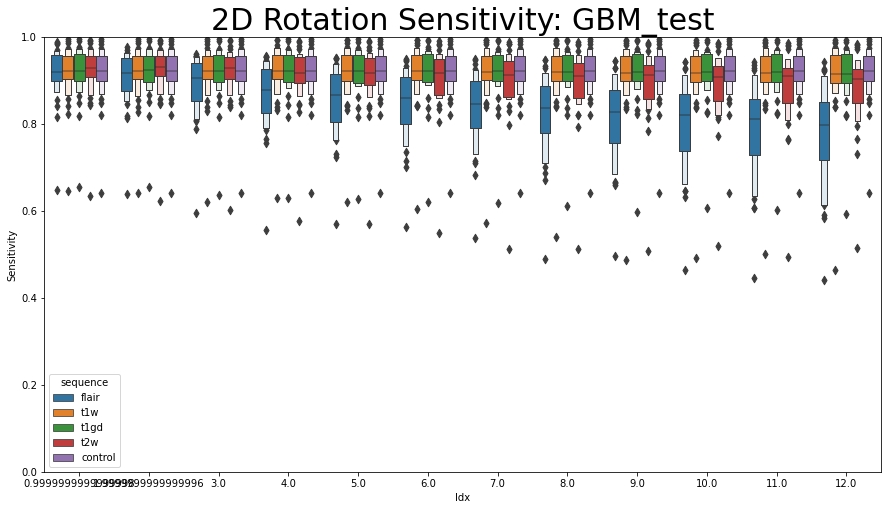

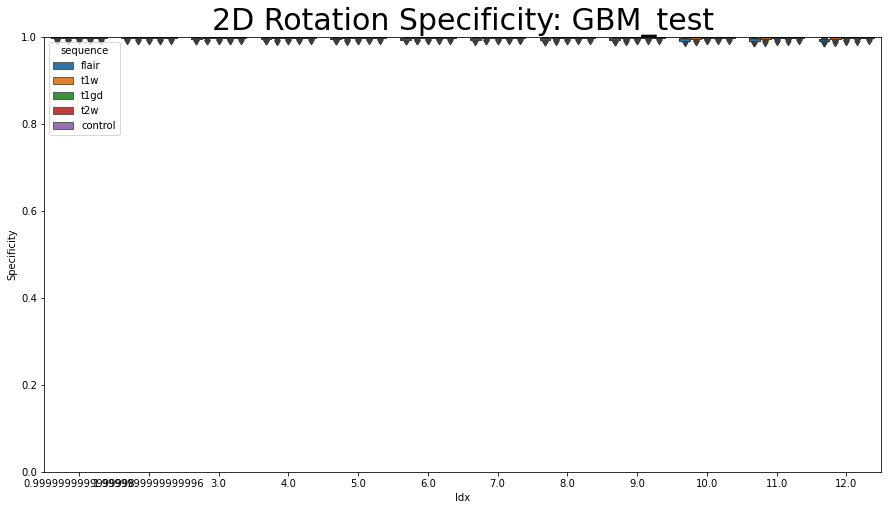

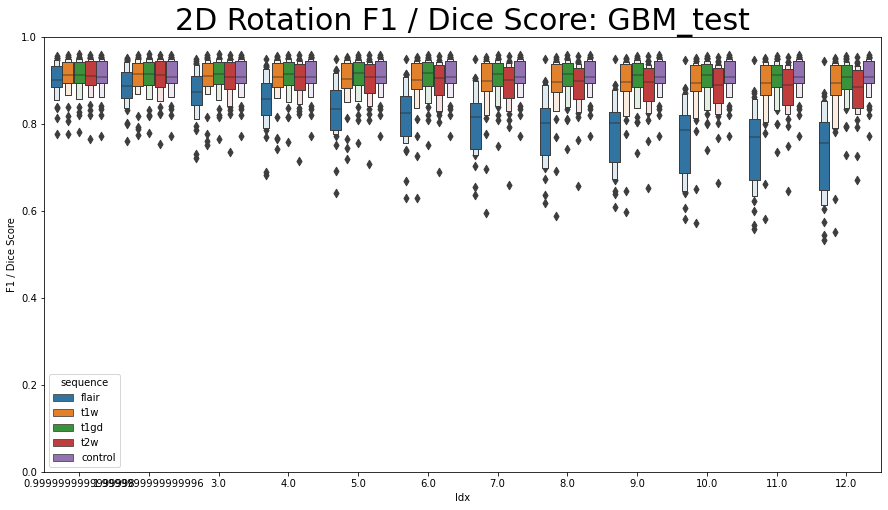

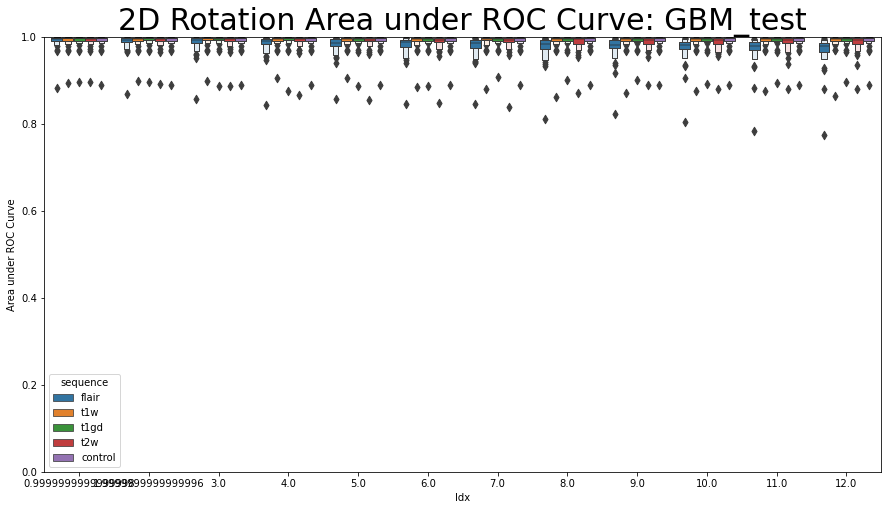

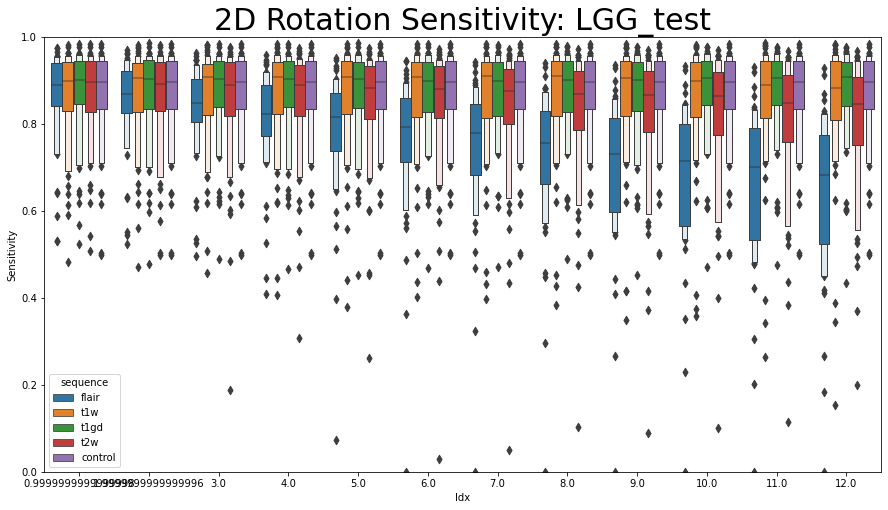

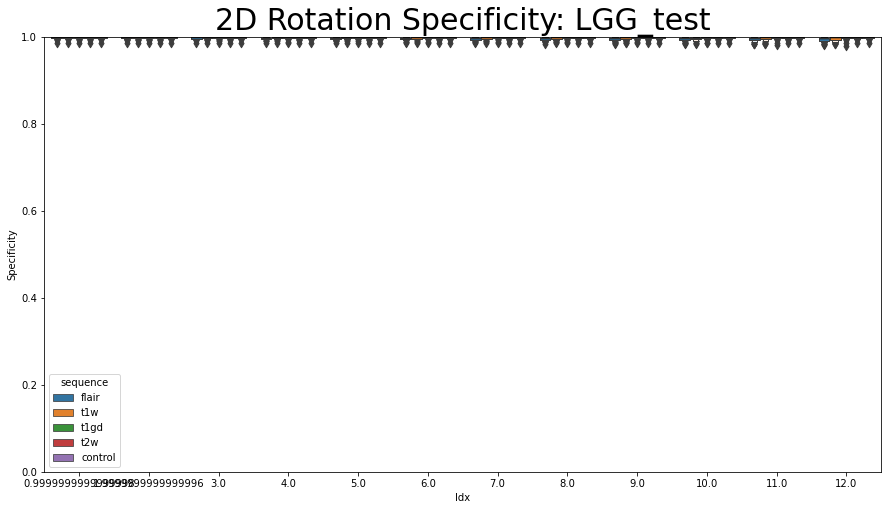

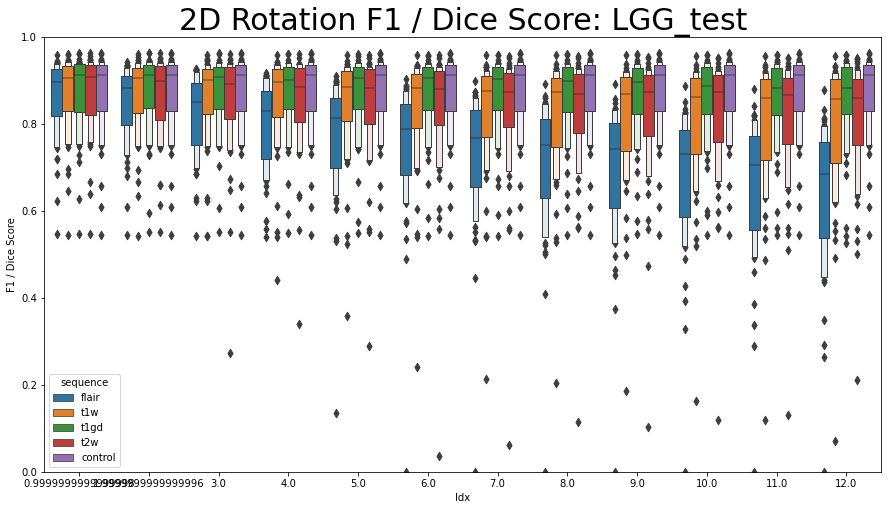

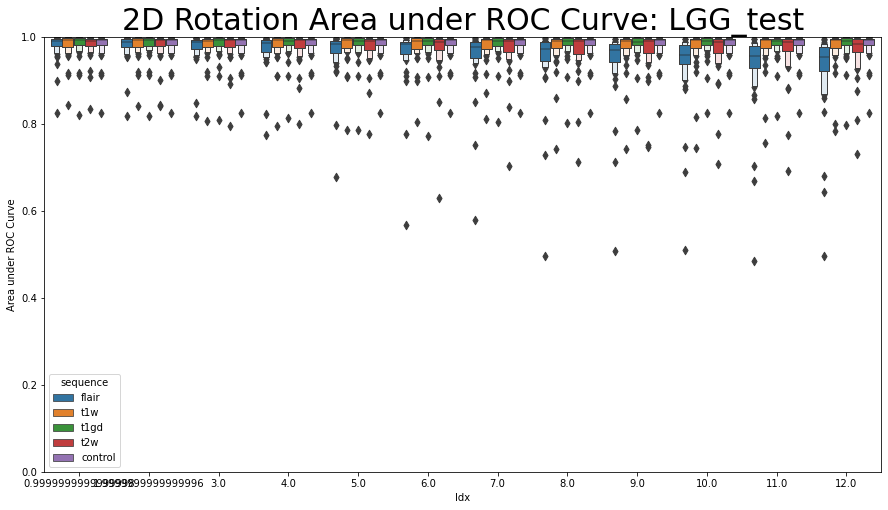

In [147]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cP2dMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = np.round(cmbMet['fraction'] * 48)
    metList =['F1 / Dice Score']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('3D Motion %s: %s' % (cMetric,cDS),fontsize=30)
#         h_box = sns.boxenplot(data=cmbMet, showfliers=True, k_depth = 3,x="Idx", y=cMetric,hue="sequence")
        h_box = sns.boxplot(data=cmbMet, showfliers=True,x="Idx", y=cMetric,hue="sequence",fliersize=4)
        h_box.set_ylim([0,1])
        plt.show()

In [478]:
print('2D Rotation')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cP2dMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for seq in modalList:
        aovrm2way = AnovaRM(cmbMet[cmbMet['sequence'] ==seq], 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
        res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
        print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']))

,artifact,sequence,fraction,TCGA_ID,Sensitivity,Specificity,Precision,Negative predictive value,False negative rate,Fall Out,...,Balanced Accuracy,F1 / Dice Score,Matthews Correlation Coefficient,Informedness / Bookmarker Informedness,Markedness,Jaccard Coefficient,Area under ROC Curve,Cohen Kappa,Rand Index,Mutual Information
2dRot_01_flair_TCGA-06-0128,2dRot,flair,0.020833,TCGA-06-0128,0.624831,0.997227,0.827029,0.992080,0.375169,0.002773,...,0.811029,0.711850,0.713816,0.622058,0.819110,0.552614,0.905248,0.706603,0.979199,0.048341
2dRot_02_flair_TCGA-06-0128,2dRot,flair,0.041667,TCGA-06-0128,0.624621,0.997227,0.826981,0.992076,0.375379,0.002773,...,0.810924,0.711696,0.713673,0.621848,0.819057,0.552429,0.905261,0.706447,0.979191,0.048321
2dRot_03_flair_TCGA-06-0128,2dRot,flair,0.062500,TCGA-06-0128,0.625234,0.997225,0.827016,0.992089,0.374766,0.002775,...,0.811229,0.712106,0.714044,0.622459,0.819104,0.552923,0.905408,0.706862,0.979212,0.048377
2dRot_04_flair_TCGA-06-0128,2dRot,flair,0.083333,TCGA-06-0128,0.624750,0.997229,0.827117,0.992079,0.375250,0.002771,...,0.810990,0.711830,0.713808,0.621979,0.819195,0.552590,0.905116,0.706583,0.979200,0.048337
2dRot_05_flair_TCGA-06-0128,2dRot,flair,0.104167,TCGA-06-0128,0.625137,0.997229,0.827223,0.992087,0.374863,0.002771,...,0.811183,0.712121,0.714080,0.622366,0.819310,0.552940,0.905350,0.706877,0.979216,0.048375
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2dRot_08_control_TCGA-08-0354,2dRot,control,0.166667,TCGA-08-0354,0.901721,0.999062,0.905502,0.999021,0.098279,0.000938,...,0.950392,0.903608,0.902651,0.900784,0.904523,0.824165,0.992085,0.902649,0.996211,0.044621
2dRot_09_control_TCGA-08-0354,2dRot,control,0.187500,TCGA-08-0354,0.901721,0.999062,0.905502,0.999021,0.098279,0.000938,...,0.950392,0.903608,0.902651,0.900784,0.904523,0.824165,0.992085,0.902649,0.996211,0.044621
2dRot_10_control_TCGA-08-0354,2dRot,control,0.208333,TCGA-08-0354,0.901721,0.999062,0.905502,0.999021,0.098279,0.000938,...,0.950392,0.903608,0.902651,0.900784,0.904523,0.824165,0.992085,0.902649,0.996211,0.044621
2dRot_11_control_TCGA-08-0354,2dRot,control,0.229167,TCGA-08-0354,0.901721,0.999062,0.905502,0.999021,0.098279,0.000938,...,0.950392,0.903608,0.902651,0.900784,0.904523,0.824165,0.992085,0.902649,0.996211,0.044621


# Test 2D Motion

In [ ]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
cP2dMMetricDict = {}
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])

expList = modalList + ['control']
# cDS = 'GBM_test'
artShort = '2dMot'
for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    
    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    p2dMMetricDict = {}
    for pNo in range(len(ptList)): 
    # for pNo in range(1):
        print(datetime.now().isoformat(timespec='minutes'))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cFrac in testFracs:
                randMax = (2**32) -1
                # hash for random seed
                fID = '%s%s%i' % (TCGA_ID,cModal,cFrac)
                h = blake2s()
                h.update(fID.encode('utf-8'))
                h_int = int(h.hexdigest(), 16)

                random_hash = h_int + randAdd
                random_seed = random_hash % randMax

                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                elif cModal != 'control':
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                if cModal != 'control':
                    aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_2d_rotation_motion_artifact(aV,random_seed=random_seed,phRot=cFrac*np.pi,
                                                           thRot=cFrac*np.pi/4,xyzTrMax=cFrac*24,
                                                           dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
            #     for mIdx in range(len(modalList)):
            #         modal= modalList[mIdx]
            #         mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

                output = np.zeros((144,144,144,1))
                for idx in range(cropImg.shape[0]):
                    img = tf.expand_dims(cropImg[idx], axis=0)
                    output[idx,:,:,:] = model.predict(img)

                artID = '%s_%02i_%s_%s' % (artShort,cFrac*48,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)

                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cFrac
                id_dict['TCGA_ID'] =  TCGA_ID

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        p2dMMetricDict[pNo] = metricDict
    cP2dMMetricDict[cDS] = p2dMMetricDict

2022-01-23T13:48
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T13:48


100%|██████████| 10/10 [00:31<00:00,  3.16s/it]


t1w 2022-01-23T13:58


100%|██████████| 10/10 [00:28<00:00,  2.88s/it]


t1gd 2022-01-23T14:08


100%|██████████| 10/10 [00:28<00:00,  2.88s/it]


t2w 2022-01-23T14:18


100%|██████████| 10/10 [00:29<00:00,  2.92s/it]


control 2022-01-23T14:29
2022-01-23T14:33
TCGA-27-2526
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T14:33


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


t1w 2022-01-23T14:46


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


t1gd 2022-01-23T14:58


100%|██████████| 10/10 [00:28<00:00,  2.81s/it]


t2w 2022-01-23T15:11


100%|██████████| 10/10 [00:28<00:00,  2.89s/it]


control 2022-01-23T15:24
2022-01-23T15:31
TCGA-06-0132
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T15:31


100%|██████████| 10/10 [00:28<00:00,  2.90s/it]


t1w 2022-01-23T15:42


100%|██████████| 10/10 [00:28<00:00,  2.84s/it]


t1gd 2022-01-23T15:53


100%|██████████| 10/10 [00:29<00:00,  2.90s/it]


t2w 2022-01-23T16:05


100%|██████████| 10/10 [00:28<00:00,  2.82s/it]


control 2022-01-23T16:16
2022-01-23T16:21
TCGA-12-1093
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T16:22


100%|██████████| 10/10 [00:29<00:00,  2.99s/it]


t1w 2022-01-23T16:34


100%|██████████| 10/10 [00:29<00:00,  2.96s/it]


t1gd 2022-01-23T16:46


100%|██████████| 10/10 [00:28<00:00,  2.86s/it]


t2w 2022-01-23T16:59


100%|██████████| 10/10 [00:29<00:00,  2.98s/it]


control 2022-01-23T17:11
2022-01-23T17:18
TCGA-06-0648
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T17:18


100%|██████████| 10/10 [00:28<00:00,  2.88s/it]


t1w 2022-01-23T17:30


100%|██████████| 10/10 [00:28<00:00,  2.87s/it]


t1gd 2022-01-23T17:42


100%|██████████| 10/10 [00:29<00:00,  2.98s/it]


t2w 2022-01-23T17:54


100%|██████████| 10/10 [00:29<00:00,  2.93s/it]


control 2022-01-23T18:06
2022-01-23T18:12
TCGA-06-0166
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T18:12


100%|██████████| 10/10 [00:28<00:00,  2.89s/it]


t1w 2022-01-23T18:24


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


t1gd 2022-01-23T18:35


100%|██████████| 10/10 [00:28<00:00,  2.85s/it]


t2w 2022-01-23T18:47


100%|██████████| 10/10 [00:29<00:00,  2.92s/it]


control 2022-01-23T18:59
2022-01-23T19:05
TCGA-06-0133
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T19:05


100%|██████████| 10/10 [00:30<00:00,  3.03s/it]


t1w 2022-01-23T19:17


100%|██████████| 10/10 [00:28<00:00,  2.88s/it]


t1gd 2022-01-23T19:29


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


t2w 2022-01-23T19:41


100%|██████████| 10/10 [00:29<00:00,  2.93s/it]


control 2022-01-23T19:54
2022-01-23T20:00
TCGA-14-1829
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T20:00


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


t1w 2022-01-23T20:12


100%|██████████| 10/10 [00:28<00:00,  2.86s/it]


t1gd 2022-01-23T20:24


100%|██████████| 10/10 [00:29<00:00,  2.93s/it]


t2w 2022-01-23T20:36


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


control 2022-01-23T20:48
2022-01-23T20:54
TCGA-08-0352
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T20:54


100%|██████████| 10/10 [00:28<00:00,  2.84s/it]


t1w 2022-01-23T21:06


100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


t1gd 2022-01-23T21:19


100%|██████████| 10/10 [00:29<00:00,  2.92s/it]


t2w 2022-01-23T21:31


100%|██████████| 10/10 [00:28<00:00,  2.84s/it]


control 2022-01-23T21:43
2022-01-23T21:50
TCGA-08-0521
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T21:50


100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


t1w 2022-01-23T22:01


100%|██████████| 10/10 [00:28<00:00,  2.88s/it]


t1gd 2022-01-23T22:13


100%|██████████| 10/10 [00:28<00:00,  2.83s/it]


t2w 2022-01-23T22:24


100%|██████████| 10/10 [00:30<00:00,  3.04s/it]


control 2022-01-23T22:36
2022-01-23T22:42
TCGA-08-0353
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T22:42


100%|██████████| 10/10 [00:29<00:00,  2.99s/it]


t1w 2022-01-23T22:54


100%|██████████| 10/10 [00:29<00:00,  2.91s/it]


t1gd 2022-01-23T23:06


100%|██████████| 10/10 [00:29<00:00,  2.95s/it]


t2w 2022-01-23T23:19


100%|██████████| 10/10 [00:28<00:00,  2.89s/it]


control 2022-01-23T23:31
2022-01-23T23:37
TCGA-19-1390
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-23T23:37


100%|██████████| 10/10 [00:28<00:00,  2.90s/it]


t1w 2022-01-23T23:49


100%|██████████| 10/10 [00:28<00:00,  2.87s/it]


t1gd 2022-01-24T00:01


100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


t2w 2022-01-24T00:14


100%|██████████| 10/10 [00:28<00:00,  2.86s/it]


control 2022-01-24T00:26
2022-01-24T00:32
TCGA-06-5412
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-24T00:32


100%|██████████| 10/10 [00:29<00:00,  2.90s/it]


t1w 2022-01-24T00:44


100%|██████████| 10/10 [00:29<00:00,  2.99s/it]


t1gd 2022-01-24T00:56


100%|██████████| 10/10 [00:28<00:00,  2.89s/it]


t2w 2022-01-24T01:09


100%|██████████| 10/10 [00:28<00:00,  2.88s/it]


control 2022-01-24T01:21
2022-01-24T01:27
TCGA-06-0168
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-24T01:27


100%|██████████| 10/10 [00:28<00:00,  2.87s/it]


t1w 2022-01-24T01:40


100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


t1gd 2022-01-24T01:52


100%|██████████| 10/10 [00:28<00:00,  2.86s/it]


t2w 2022-01-24T02:04


100%|██████████| 10/10 [00:28<00:00,  2.85s/it]


control 2022-01-24T02:16
2022-01-24T02:22
TCGA-06-0213
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-24T02:22


100%|██████████| 10/10 [00:30<00:00,  3.07s/it]


t1w 2022-01-24T02:34


 30%|███       | 3/10 [00:08<00:20,  2.88s/it]

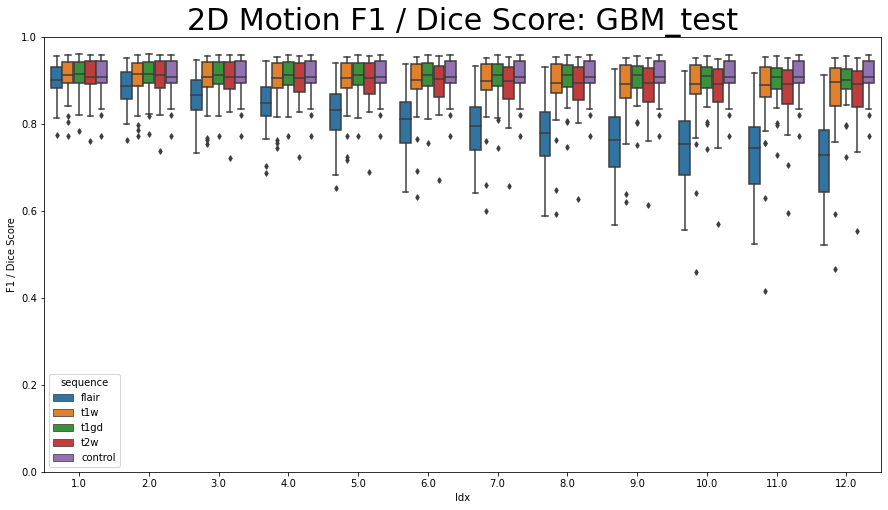

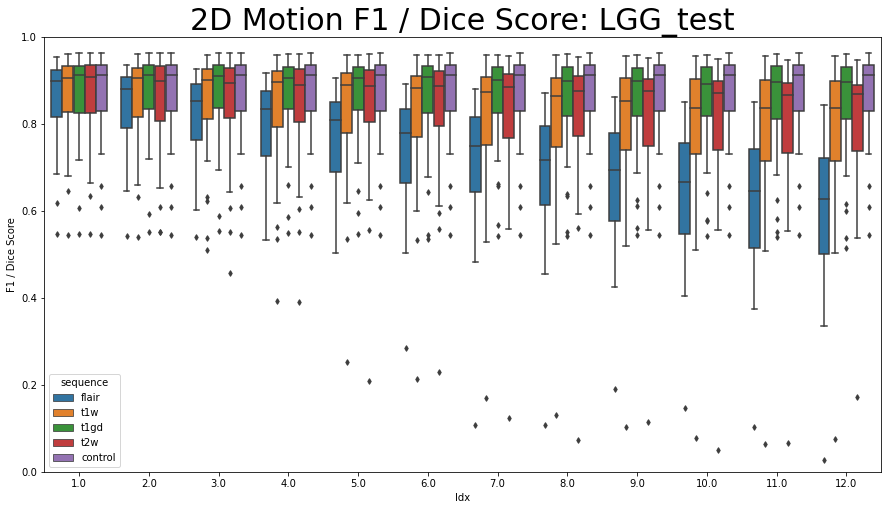

In [55]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cP2dMMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPMMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = cmbMet['fraction'] * 48
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
    metList =['F1 / Dice Score']
    for cMetric in metList:

        
        plt.figure(figsize=(15,8))
        plt.title('2D Motion %s: %s' % (cMetric,cDS),fontsize=30)
#         h_box = sns.boxenplot(data=cmbMet, showfliers=True, k_depth = 3,x="Idx", y=cMetric,hue="sequence")
        h_box = sns.boxplot(data=cmbMet, showfliers=True,x="Idx", y=cMetric,hue="sequence",fliersize=4)
        h_box.set_ylim([0,1])
        plt.show()

In [56]:
print('2D Motion')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cP2dMMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for seq in modalList:
        aovrm2way = AnovaRM(cmbMet[cmbMet['sequence'] ==seq], 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
        res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
        print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']))

2D Motion
GBM, flair: pVal = 5.31412e-119
GBM, t1w: pVal = 1.57683e-14
GBM, t1gd: pVal = 1.45981e-31
GBM, t2w: pVal = 3.83151e-37
LGG, flair: pVal = 6.54192e-139
LGG, t1w: pVal = 9.68486e-31
LGG, t1gd: pVal = 1.28085e-13
LGG, t2w: pVal = 4.12428e-22


## Test 2D Translation

In [ ]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
cP2dTMetricDict = {}
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])

expList = modalList + ['control']
# cDS = 'GBM_test'
artShort = '2dTr'
for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    
    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    p2dTMetricDict = {}
    for pNo in range(len(ptList)): 
        print('(%i/%i): %s' % (pNo,len(ptList),datetime.now().isoformat(timespec='minutes')))
    # for pNo in range(1):
        print(datetime.now().isoformat(timespec='minutes'))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cFrac in testFracs:
                randMax = (2**32) -1
                # hash for random seed
                fID = '%s%s%i' % (TCGA_ID,cModal,cFrac)
                h = blake2s()
                h.update(fID.encode('utf-8'))
                h_int = int(h.hexdigest(), 16)

                random_hash = h_int + randAdd
                random_seed = random_hash % randMax

                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                elif cModal != 'control':
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                if cModal != 'control':
                    aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_2d_rotation_motion_artifact(aV,random_seed=random_seed,phRot=0,
                                                           thRot=0,xyzTrMax=cFrac*24,
                                                           dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
            #     for mIdx in range(len(modalList)):
            #         modal= modalList[mIdx]
            #         mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

                output = np.zeros((144,144,144,1))
                for idx in range(cropImg.shape[0]):
                    img = tf.expand_dims(cropImg[idx], axis=0)
                    output[idx,:,:,:] = model.predict(img)

                artID = '%s_%02i_%s_%s' % (artShort,cFrac*48,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)

                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cFrac
                id_dict['TCGA_ID'] =  TCGA_ID

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        p2dTMetricDict[pNo] = metricDict
    cP2dTMetricDict[cDS] = p2dTMetricDict

(0/33): 2022-01-26T12:03
2022-01-26T12:03
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-26T12:03


100%|██████████| 10/10 [00:26<00:00,  2.63s/it]


t1w 2022-01-26T12:13


100%|██████████| 10/10 [00:26<00:00,  2.63s/it]


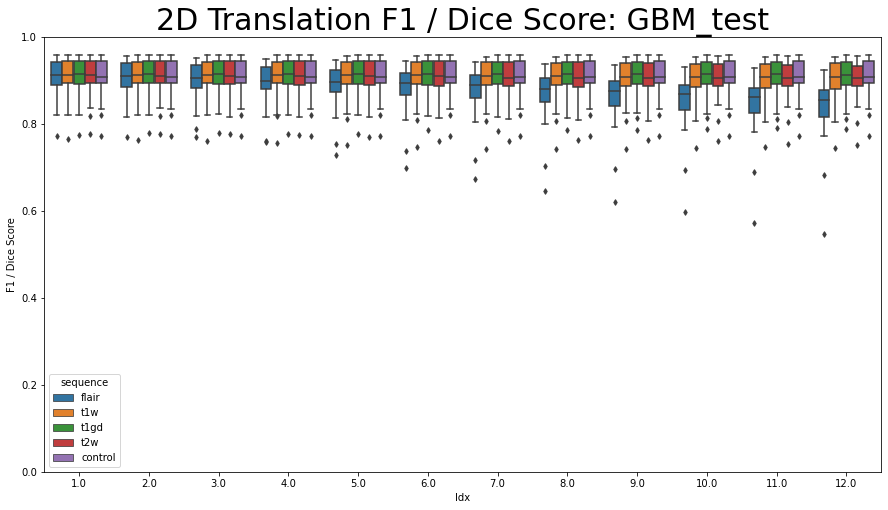

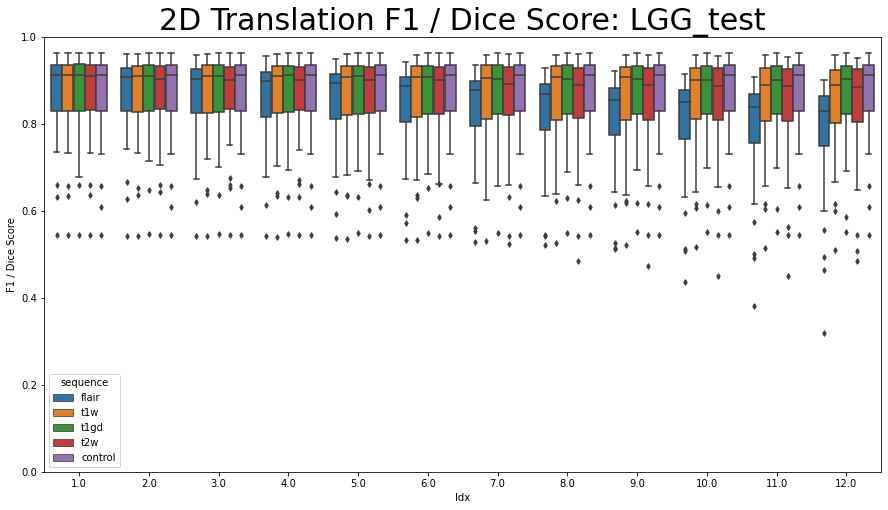

In [59]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cP2dTMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPMMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = cmbMet['fraction'] * 48
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
    metList =['F1 / Dice Score']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('2D Translation %s: %s' % (cMetric,cDS),fontsize=30)
#         h_box = sns.boxenplot(data=cmbMet, showfliers=True, k_depth = 3,x="Idx", y=cMetric,hue="sequence")
        h_box = sns.boxplot(data=cmbMet, showfliers=True,x="Idx", y=cMetric,hue="sequence",fliersize=4)
        h_box.set_ylim([0,1])
        plt.show()

In [60]:
print('2D Translation')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cP2dTMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for seq in modalList:
        aovrm2way = AnovaRM(cmbMet[cmbMet['sequence'] ==seq], 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
        res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
        print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']))

2D Translation
GBM, flair: pVal = 3.93899e-84
GBM, t1w: pVal = 3.60841e-12
GBM, t1gd: pVal = 1.94734e-16
GBM, t2w: pVal = 1.77562e-33
LGG, flair: pVal = 1.1898e-101
LGG, t1w: pVal = 8.89915e-21
LGG, t1gd: pVal = 0.0168381
LGG, t2w: pVal = 1.18524e-19


# Signal Loss Testing

In [ ]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']

testVals = np.asarray([0,5,10,15,20,25,30,35,40,45,50])
expList = modalList + ['control']

artShort = 'SigLoss'
cPSLMetricDict = {}

for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pSLMetricDict = {}
    for pNo in range(len(ptList)):
    # for pNo in range(1):
        print(datetime.now().isoformat(timespec='minutes'))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        lbl = lbl_nib.get_fdata()

        for cVal in testVals:
            print(cVal,datetime.now().isoformat(timespec='minutes'))
            randMax = (2**32) -1
            # hash for random seed
            fID = '%s%s%i' % (TCGA_ID,cModal,cVal)
            h = blake2s()
            h.update(fID.encode('utf-8'))
            h_int = int(h.hexdigest(), 16)

            random_hash = h_int + randAdd
            random_seed = random_hash % randMax

            artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
            if cVal != 0: # not a control experiment
                for cMIdx in range(len(modalList)):
                    cModal = modalList[cMIdx]
                    if cModal == 't1w':
                        cTP = np.transpose(transformed,axes = [1,0,2])
                    else :
                        cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                        cTP = np.transpose(cAligned,axes = [1,0,2])

                    if cModal in ['t1w','t1gd']:
                        artDMid = cVal * .8
                    elif cModal in ['flair','t2w']:
                        artDMid = cVal 
                    if cMIdx == 0:
                        seedLocs = generate_dist_seed_locs(tr_label,cTP,artDMid = artDMid,
                                                           random_seed=random_seed,dispTF=False)

                    aV = add_fake_skull(cTP,dispTF=False)

                    artV = add_signal_loss_artifact(aV,seedLocs=seedLocs,artDMid=artDMid,
                                                     random_seed=random_seed,dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
    #         for mIdx in range(len(modalList)):
    #             modal= modalList[mIdx]
    #             mri_utils.plot_img_arr(artDict[modal])

            bbox = combine_bboxes_dict(artDict,verbose=False)
            cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
            cropImDict = {modal : [] for modal in modalList}
            for mIdx in range(len(modalList)):
                modal= modalList[mIdx]
                cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                cropImDict[modal] = cropMod
            cropImg = np.concatenate(list(cropImDict.values()),axis=3)

            output = np.zeros((144,144,144,1))
            for idx in range(cropImg.shape[0]):
                img = tf.expand_dims(cropImg[idx], axis=0)
                output[idx,:,:,:] = model.predict(img)

            artID = '%s_%02i_%s' % (artShort,cVal,TCGA_ID)
            np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

            y_true = cropLbl.reshape(-1).astype(int)
            y_scores = output.reshape(-1,1)
            y_pred = np.where(y_scores > 0.5, 1, 0)

            id_dict = {}
            id_dict['artifact'] = artShort
    #         id_dict['sequence'] =  cModal
            id_dict['fraction'] =  cVal
            id_dict['TCGA_ID'] =  TCGA_ID
            id_dict['cDS'] = cDS

            (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                   y_pred.ravel(),
                                                                   y_scores.ravel())
            sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

            TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
            (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

            cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

            id_dict.update(cm_dict)
            id_dict.update(sm_dict)

            metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join( artOutDir,artFName))

        pSLMetricDict[pNo] = metricDict
    cPSLMetricDict[cDS] = pSLMetricDict

2021-12-20T13:14
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-20T13:14
5 2021-12-20T13:14
10 2021-12-20T13:16
15 2021-12-20T13:18
20 2021-12-20T13:19
25 2021-12-20T13:21
30 2021-12-20T13:22
35 2021-12-20T13:24
40 2021-12-20T13:26
45 2021-12-20T13:27
50 2021-12-20T13:29
2021-12-20T13:30
TCGA-27-2526
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-20T13:30
5 2021-12-20T13:31
10 2021-12-20T13:33
15 2021-12-20T13:35
20 2021-12-20T13:36
25 2021-12-20T13:38
30 2021-12-20T13:40
35 2021-12-20T13:42
40 2021-12-20T13:43
45 2021-12-20T13:45
50 2021-12-20T13:47
2021-12-20T13:49
TCGA-06-0132
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-20T13:49
5 2021-12-20T13:49
10 2021-12-20T13:51
15 2021-12-20T13:53
20 2021-12-20T13:54
25 2021-12-20T13:56
30 2021-12-20T13:58
35 2021-12-20T13:59
40 2021-12-20T14:01
45 2021-12-20T14:03
50 2021-12-20T14:04
2021-12-20T14:06
TCGA-12-1093
Resizing template from:  (91, 109, 91)  to  (2

25 2021-12-20T21:09
30 2021-12-20T21:11
35 2021-12-20T21:13
40 2021-12-20T21:14
45 2021-12-20T21:16
50 2021-12-20T21:18
2021-12-20T21:19
TCGA-02-0003
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-20T21:20
5 2021-12-20T21:20
10 2021-12-20T21:22
15 2021-12-20T21:24
20 2021-12-20T21:25
25 2021-12-20T21:27
30 2021-12-20T21:29
35 2021-12-20T21:31
40 2021-12-20T21:32
45 2021-12-20T21:34
50 2021-12-20T21:36
2021-12-20T21:38
TCGA-02-0060
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-20T21:38
5 2021-12-20T21:38
10 2021-12-20T21:40
15 2021-12-20T21:42
20 2021-12-20T21:44
25 2021-12-20T21:45
30 2021-12-20T21:47
35 2021-12-20T21:49
40 2021-12-20T21:51
45 2021-12-20T21:53
50 2021-12-20T21:54


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


2021-12-20T21:56
TCGA-06-0175
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-20T21:56
5 2021-12-20T21:57
10 2021-12-20T21:59
15 2021-12-20T22:00
20 2021-12-20T22:02
25 2021-12-20T22:04
30 2021-12-20T22:06
35 2021-12-20T22:08
40 2021-12-20T22:09
45 2021-12-20T22:11
50 2021-12-20T22:13
2021-12-20T22:15
TCGA-27-1838
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-20T22:15
5 2021-12-20T22:15
10 2021-12-20T22:17
15 2021-12-20T22:19
20 2021-12-20T22:21
25 2021-12-20T22:22
30 2021-12-20T22:24
35 2021-12-20T22:26
40 2021-12-20T22:28
45 2021-12-20T22:30
50 2021-12-20T22:31
2021-12-20T22:33
TCGA-08-0529
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-20T22:33
5 2021-12-20T22:34
10 2021-12-20T22:36
15 2021-12-20T22:37
20 2021-12-20T22:39
25 2021-12-20T22:41
30 2021-12-20T22:43
35 2021-12-20T22:45
40 2021-12-20T22:46
45 2021-12-20T22:48
50 2021-12-20T22:50
2021-12-20T22:52
TCGA-08-0354
Resizing template from:  (91, 109, 91)  to  (2

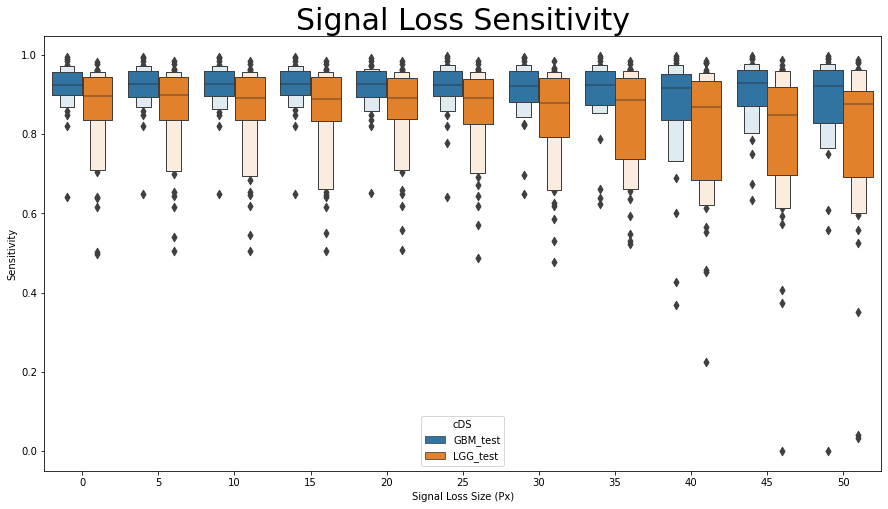

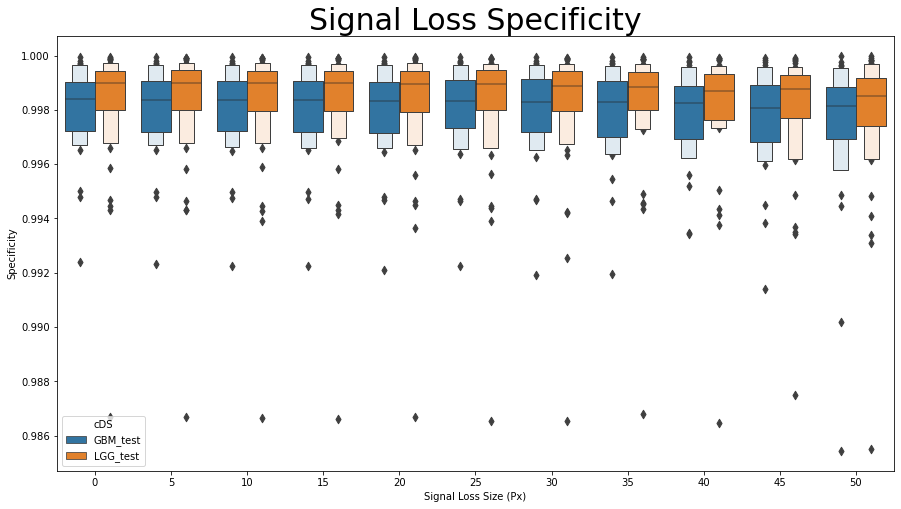

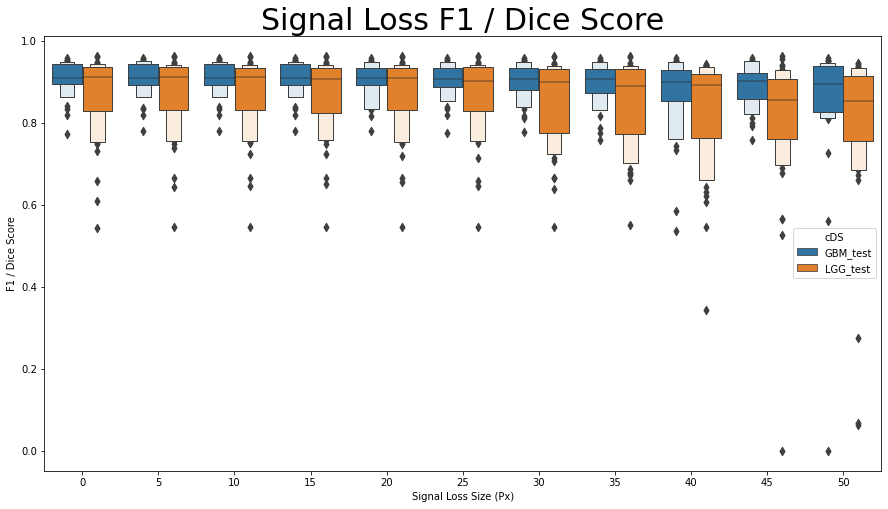

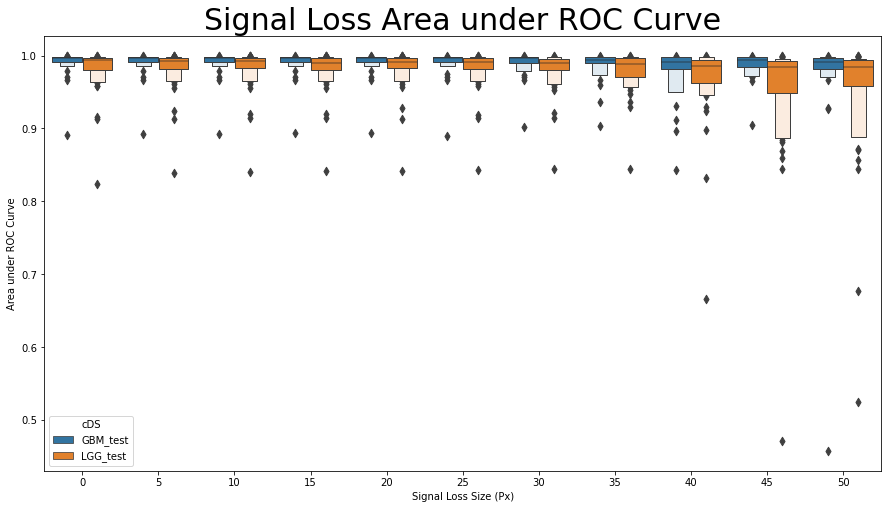

In [300]:
dfList = []
for cDS in ['GBM_test','LGG_test']:
    cmbDF = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPSLMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbDF = pd.concat(cmbDF,axis=0)
    dfList.append(cmbDF)
cmbMet = pd.concat(dfList,axis=0)
cmbMet['Signal Loss Size (Px)'] = cmbMet['fraction']
metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
for cMetric in metList:
    plt.figure(figsize=(15,8))
    plt.title('Signal Loss %s' % (cMetric),fontsize=30)
    sns.boxenplot(data=cmbMet,x="Signal Loss Size (Px)", y=cMetric, hue="cDS")
    plt.show()

In [419]:
print('Signal Loss')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPSLMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    aovrm2way = AnovaRM(cmbMet, 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
    res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
    print('%s: pVal = %g' % (cDS[0:3],res2way.anova_table['Pr > F']))

Signal Loss
GBM: pVal = 2.61838e-05
LGG: pVal = 5.37962e-08


# Testing Aliasing (Number)

In [72]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
cPANMetricDict = {}
testVals = np.asarray([0,1,2,3,4,5,6,7,8])
# testVals = np.asarray([0])
# expList = modalList + ['control']
expList = modalList

artShort = 'AliasNum'
for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pANMetricDict = {}

    for pNo in range(len(ptList)): 
#     for pNo in range(1):
        print(datetime.now().isoformat(timespec='minutes'))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cVal in testVals:
                randMax = (2**32) -1
                # hash for random seed
                fID = '%s%s%i' % (TCGA_ID,cModal,cVal)
                h = blake2s()
                h.update(fID.encode('utf-8'))
                h_int = int(h.hexdigest(), 16)

                random_hash = h_int + randAdd
                random_seed = random_hash % randMax

                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                elif cModal != 'control':
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                if cModal != 'control':
                    aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_aliasing_artifact(aV,overlap=cVal,aliasMult=.1,dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
#                 for mIdx in range(len(modalList)):
#                     modal= modalList[mIdx]
#                     mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

#                 output = np.zeros((144,144,144,1))
#                 for idx in range(cropImg.shape[0]):
#                     img = tf.expand_dims(cropImg[idx], axis=0)
#                     output[idx,:,:,:] = model.predict(img)
                output = model.predict(cropImg)

                artID = '%s_%i_%s_%s' % (artShort,cVal,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)

                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cVal
                id_dict['TCGA_ID'] =  TCGA_ID
                id_dict['cDS'] = cDS

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        pANMetricDict[pNo] = metricDict
    cPANMetricDict[cDS] = pANMetricDict

2021-11-03T15:29
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-03T15:29
t1w 2021-11-03T15:32
t1gd 2021-11-03T15:34
t2w 2021-11-03T15:37
2021-11-03T15:40
TCGA-27-2526
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-03T15:40
t1w 2021-11-03T15:44
t1gd 2021-11-03T15:49
t2w 2021-11-03T15:54
2021-11-03T15:59
TCGA-06-0132
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-03T15:59
t1w 2021-11-03T16:02
t1gd 2021-11-03T16:06
t2w 2021-11-03T16:10
2021-11-03T16:14
TCGA-12-1093
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-03T16:14
t1w 2021-11-03T16:18
t1gd 2021-11-03T16:23
t2w 2021-11-03T16:27
2021-11-03T16:31
TCGA-06-0648
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-03T16:31
t1w 2021-11-03T16:36
t1gd 2021-11-03T16:40
t2w 2021-11-03T16:44
2021-11-03T16:48
TCGA-06-0166
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-03T16:48
t1

flair 2021-11-04T04:09
t1w 2021-11-04T04:13
t1gd 2021-11-04T04:17
t2w 2021-11-04T04:21
2021-11-04T04:25
TCGA-HT-8106
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-04T04:25
t1w 2021-11-04T04:29
t1gd 2021-11-04T04:33
t2w 2021-11-04T04:37
2021-11-04T04:41
TCGA-FG-A6IZ
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-04T04:41
t1w 2021-11-04T04:45
t1gd 2021-11-04T04:49
t2w 2021-11-04T04:53
2021-11-04T04:57
TCGA-DU-6399
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-04T04:57
t1w 2021-11-04T05:00
t1gd 2021-11-04T05:04
t2w 2021-11-04T05:08
2021-11-04T05:12
TCGA-HT-7874
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-04T05:12
t1w 2021-11-04T05:16
t1gd 2021-11-04T05:20
t2w 2021-11-04T05:24
2021-11-04T05:29
TCGA-DU-5852
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-04T05:29
t1w 2021-11-04T05:33
t1gd 2021-11-04T05:37
t2w 2021-11-04T05:41
2021-11-04T05:45
TCGA-CS-629

# Testing Alias Value

In [ ]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
cPAVMetricDict = {}
testVals = np.asarray([0,0.005,0.01,0.025,0.05,0.1,0.15,0.2,0.3])
# expList = modalList + ['control']
expList = modalList

artShort = 'AliasVal'
for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pAVMetricDict = {}

    for pNo in range(len(ptList)): 
    # for pNo in range(1):
        print(datetime.now().isoformat(timespec='minutes'))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cVal in testVals:
                randMax = (2**32) -1
                # hash for random seed
                fID = '%s%s%i' % (TCGA_ID,cModal,cVal)
                h = blake2s()
                h.update(fID.encode('utf-8'))
                h_int = int(h.hexdigest(), 16)

                random_hash = h_int + randAdd
                random_seed = random_hash % randMax

                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                elif cModal != 'control':
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                if cModal != 'control':
                    aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_aliasing_artifact(aV,overlap=3,aliasMult=cVal,dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
            #     for mIdx in range(len(modalList)):
            #         modal= modalList[mIdx]
            #         mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

#                 output = np.zeros((144,144,144,1))
#                 for idx in range(cropImg.shape[0]):
#                     img = tf.expand_dims(cropImg[idx], axis=0)
#                     output[idx,:,:,:] = model.predict(img)
                output = model.predict(cropImg)

                artID = '%s_%g_%s_%s' % (artShort,cVal*100,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)

                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cVal
                id_dict['TCGA_ID'] =  TCGA_ID
                id_dict['cDS'] = cDS

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        pAVMetricDict[pNo] = metricDict
    cPAVMetricDict[cDS] = pANMetricDict

2022-01-17T13:23
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-17T13:23
t1w 2022-01-17T13:26
t1gd 2022-01-17T13:29
t2w 2022-01-17T13:32
2022-01-17T13:36
TCGA-27-2526
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-17T13:36
t1w 2022-01-17T13:41
t1gd 2022-01-17T13:47
t2w 2022-01-17T13:52
2022-01-17T13:58
TCGA-06-0132
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-17T13:58
t1w 2022-01-17T14:02
t1gd 2022-01-17T14:06
t2w 2022-01-17T14:10
2022-01-17T14:13
TCGA-12-1093
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-17T14:13
t1w 2022-01-17T14:18
t1gd 2022-01-17T14:23
t2w 2022-01-17T14:27
2022-01-17T14:32
TCGA-06-0648
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-17T14:32
t1w 2022-01-17T14:37
t1gd 2022-01-17T14:41
t2w 2022-01-17T14:45
2022-01-17T14:49
TCGA-06-0166
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-17T14:50
t1

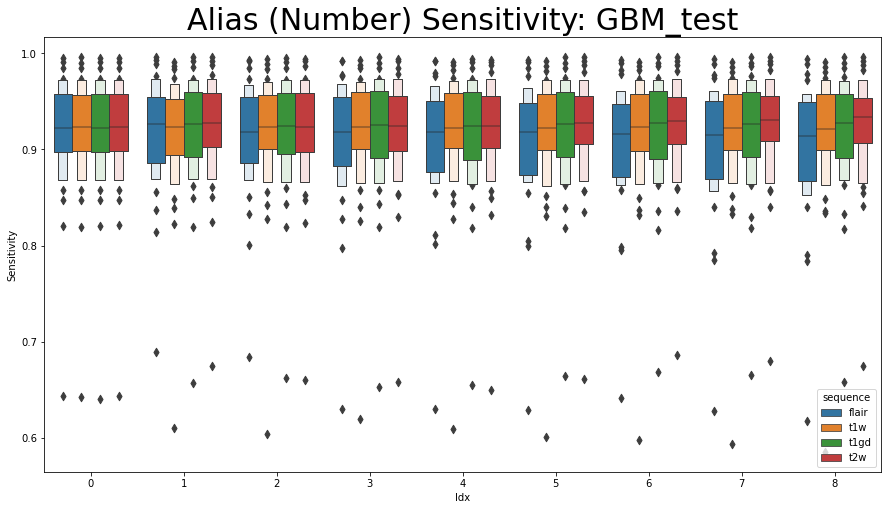

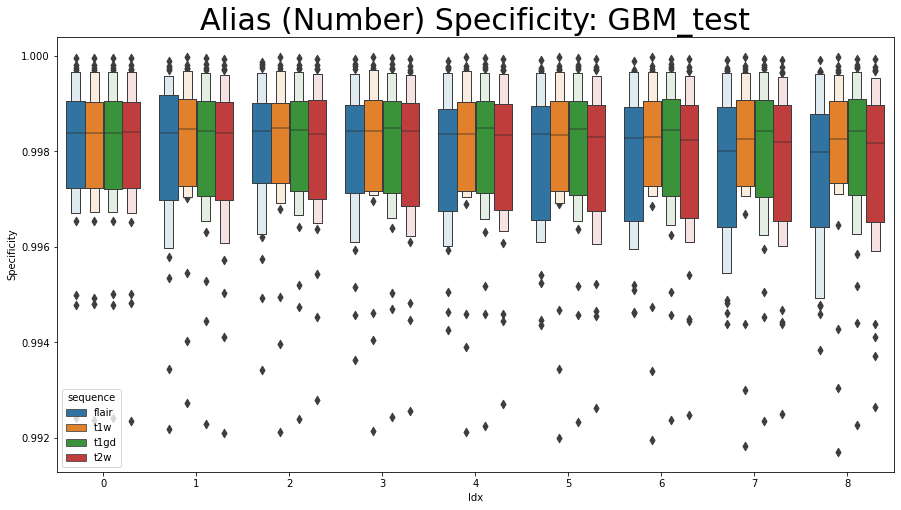

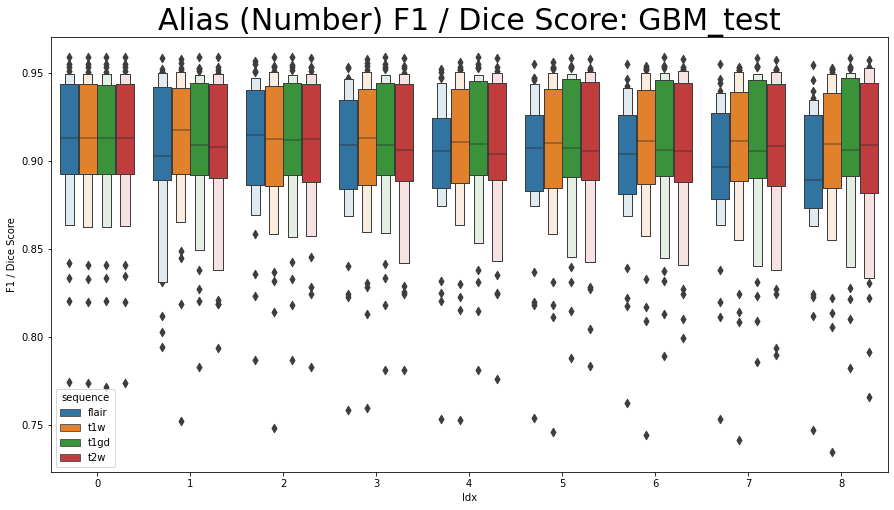

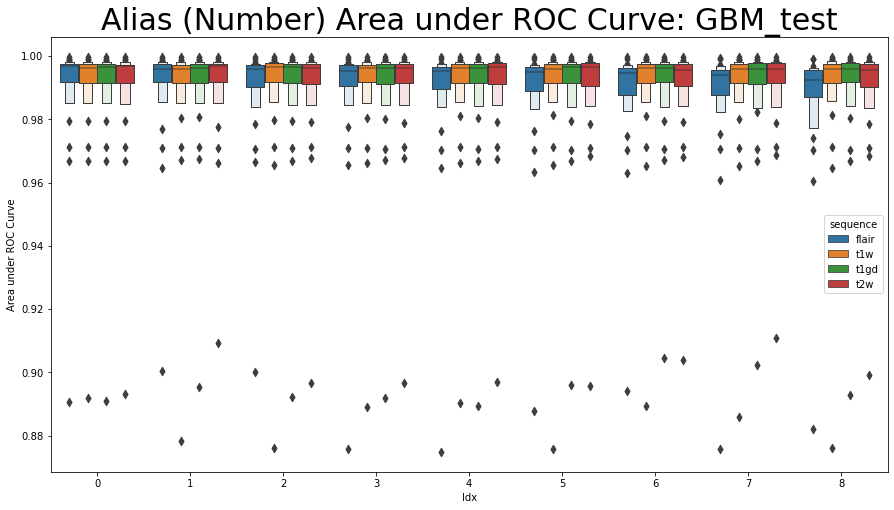

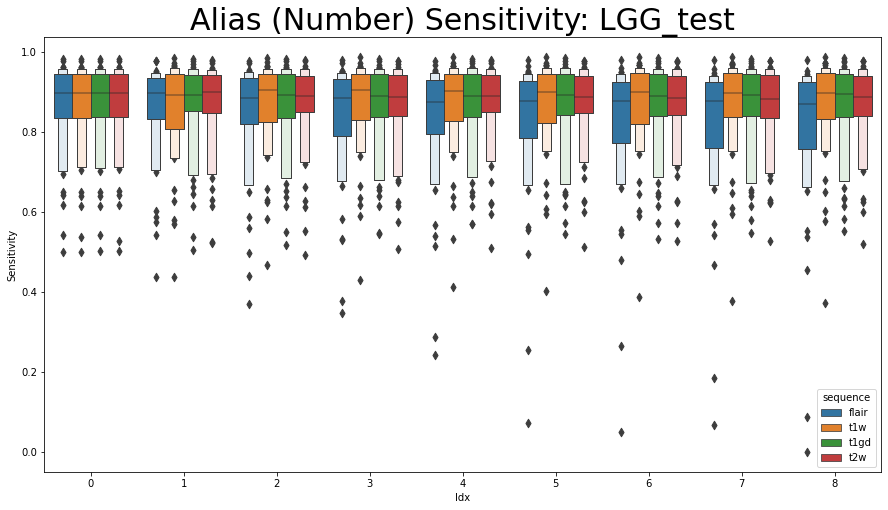

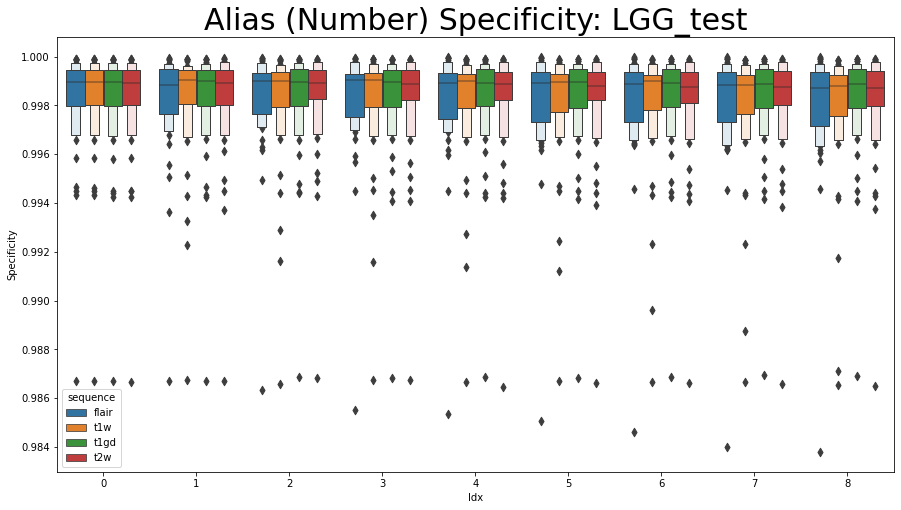

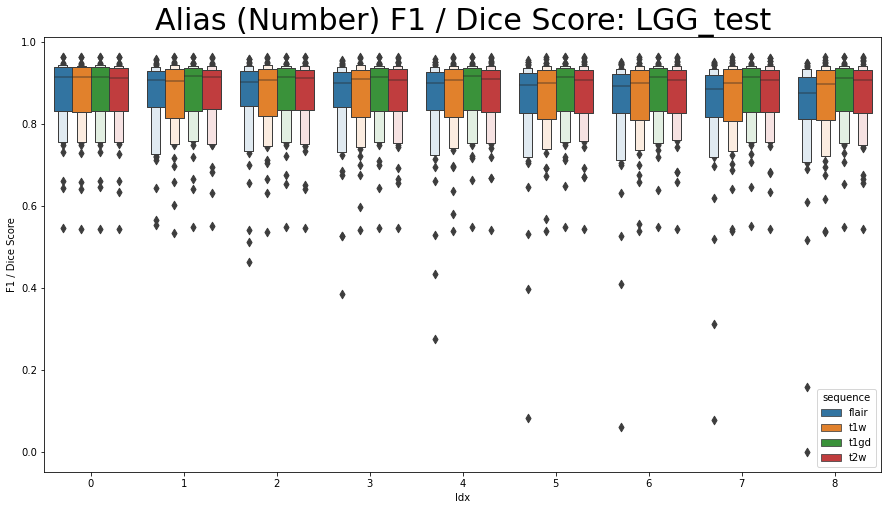

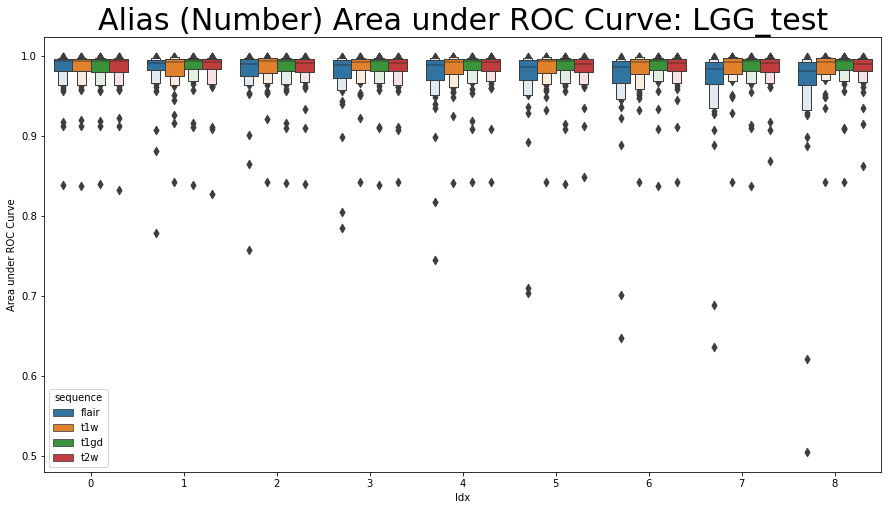

In [73]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPANMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = cmbMet['fraction']
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('Alias (Number) %s: %s' % (cMetric,cDS),fontsize=30)
        sns.boxenplot(data=cmbMet,x="Idx", y=cMetric, hue="sequence")
        plt.show()

In [427]:
print('Alias Number')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPANMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for seq in modalList:
        aovrm2way = AnovaRM(cmbMet[cmbMet['sequence'] ==seq], 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
        res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
        print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']))

Alias Number
GBM, flair: pVal = 2.4521e-21
GBM, t1w: pVal = 5.41737e-09
GBM, t1gd: pVal = 0.00133923
GBM, t2w: pVal = 0.00238607
LGG, flair: pVal = 8.80744e-08
LGG, t1w: pVal = 1.03627e-06
LGG, t1gd: pVal = 0.416231
LGG, t2w: pVal = 0.156642


In [520]:
# load metrics from file
artShort = 'AliasVal'
cMDict = {}
for cDS in ['GBM_test','LGG_test']:
    artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
    metFNList = []
    mDict = {}
    for root, dirs, files in os.walk(artOutDir):
        for dn in files:
            metFNList.append(dn)
    # print(metFNList)
    for pNo in range(len(metFNList)):
        metFN = metFNList[pNo]
        metDF = pd.read_csv(os.path.join(artOutDir,metFN))
        mDict[pNo] = metDF.to_dict(orient='index')
    cMDict[cDS] = mDict
cPAVMetricDict = cMDict

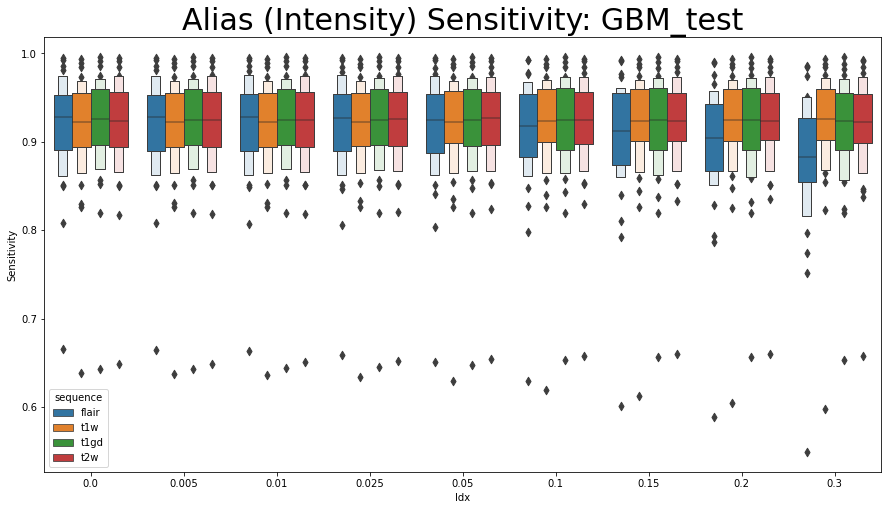

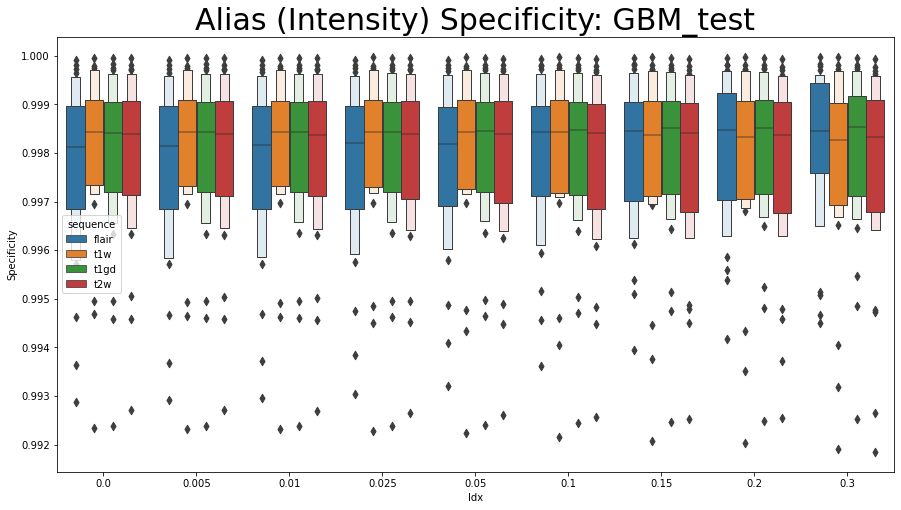

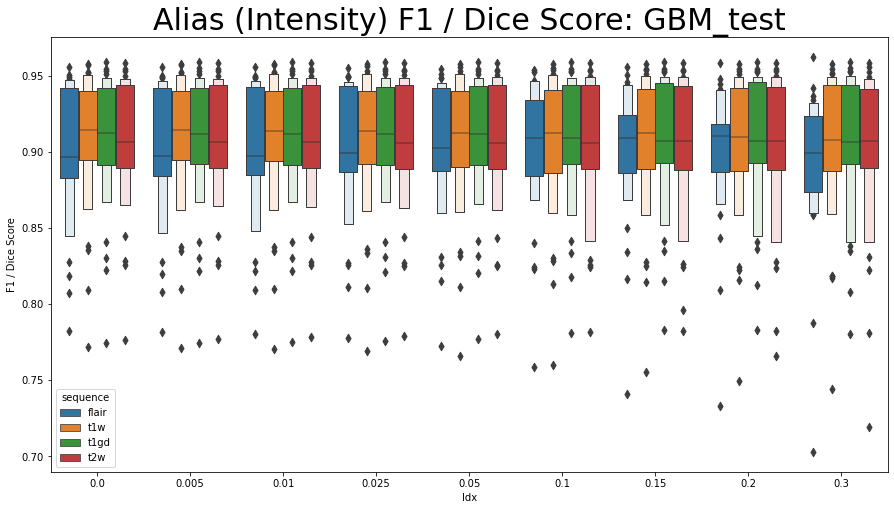

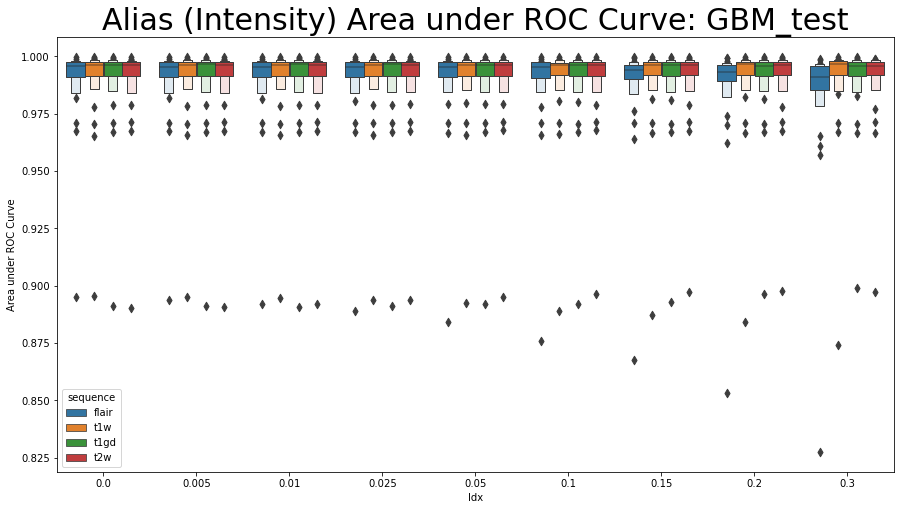

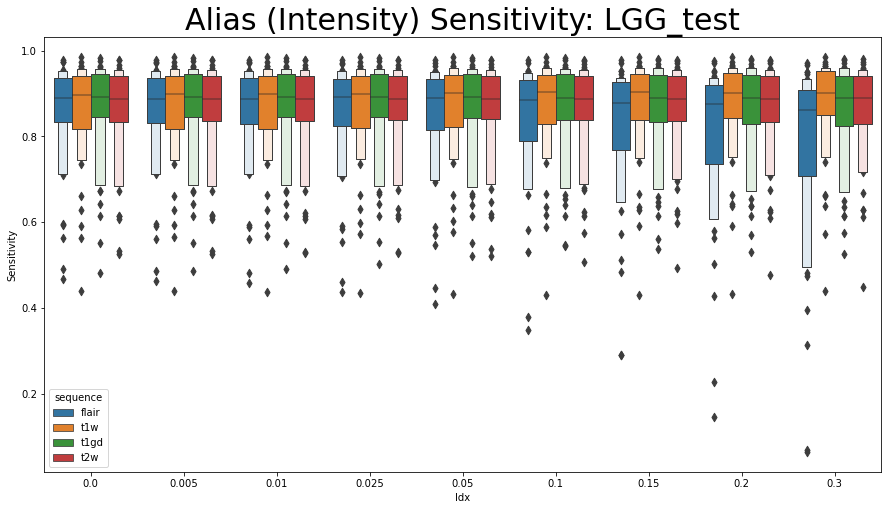

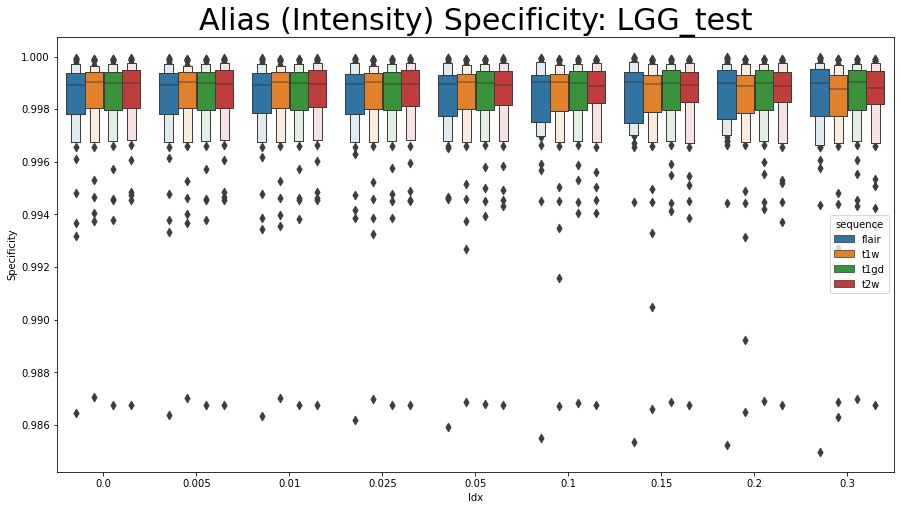

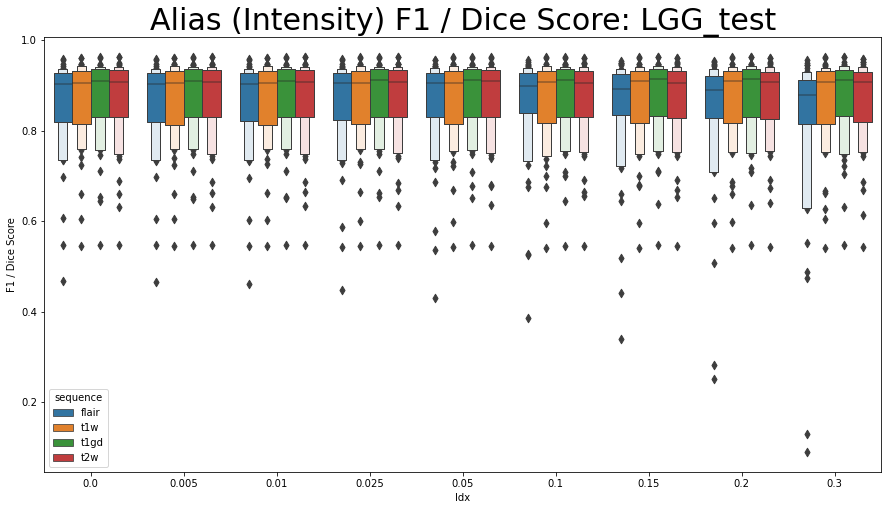

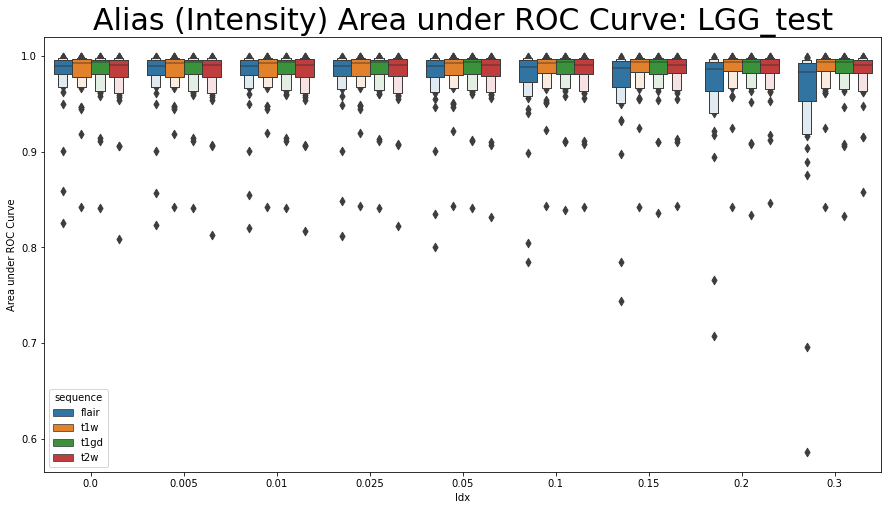

In [521]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPAVMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = cmbMet['fraction']
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('Alias (Intensity) %s: %s' % (cMetric,cDS),fontsize=30)
        sns.boxenplot(data=cmbMet,x="Idx", y=cMetric, hue="sequence")
        plt.show()

In [519]:
print('Alias Value')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPAVMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for seq in modalList:
        aovrm2way = AnovaRM(cmbMet[cmbMet['sequence'] ==seq], 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
        res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
        print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']))

Alias Value
GBM, flair: pVal = 8.80744e-08
GBM, t1w: pVal = 1.03627e-06
GBM, t1gd: pVal = 0.416231
GBM, t2w: pVal = 0.156642
LGG, flair: pVal = 8.80744e-08
LGG, t1w: pVal = 1.03627e-06
LGG, t1gd: pVal = 0.416231
LGG, t2w: pVal = 0.156642


# Test Models: Skull Stripping

In [296]:



RSTF = True
modalList = ['flair','t1w','t1gd','t2w']

testVals = np.asarray([0,1,2,5,10,25,50,100])


artShort = 'SkullStrip'
cPSSMetricDict = {}

for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pSSMetricDict = {}
    for pNo in range(len(ptList)):
    # for pNo in range(1):
        print(datetime.now().isoformat(timespec='minutes'))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        lbl = lbl_nib.get_fdata()

        for cVal in testVals:
            print(cVal,datetime.now().isoformat(timespec='minutes'))
            randMax = (2**32) -1
            # hash for random seed
            fID = '%s%s%i' % (TCGA_ID,cModal,cFrac)
            h = blake2s()
            h.update(fID.encode('utf-8'))
            h_int = int(h.hexdigest(), 16)

            random_hash = h_int + randAdd
            random_seed = random_hash % randMax

            artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
            if cVal != 0: # not a control experiment
                for cMIdx in range(len(modalList)):
                    cModal = modalList[cMIdx]
                    if cModal == 't1w':
                        cTP = np.transpose(transformed,axes = [1,0,2])
                    else:
                        cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                        cTP = np.transpose(cAligned,axes = [1,0,2])

                    
                    if cMIdx == 0:
                        seedLocs = generate_dist_seed_locs(tr_label,cTP,artDMid = 10,nArts=5,
                                                           random_seed=random_seed,dispTF=False)
                    aV = cTP.copy()
#                     aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_skull_strip_failure_artifact(aV,seedLocs=seedLocs,percSkull2Add=cVal,
                                                     random_seed=random_seed,dispTF=False)
#                     artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
    #         for mIdx in range(len(modalList)):
    #             modal= modalList[mIdx]
    #             mri_utils.plot_img_arr(artDict[modal])

            bbox = combine_bboxes_dict(artDict,verbose=False)
            cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
            cropImDict = {modal : [] for modal in modalList}
            for mIdx in range(len(modalList)):
                modal= modalList[mIdx]
                cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                cropImDict[modal] = cropMod
            cropImg = np.concatenate(list(cropImDict.values()),axis=3)

#             output = np.zeros((144,144,144,1))
#             for idx in range(cropImg.shape[0]):
#                 img = tf.expand_dims(cropImg[idx], axis=0)
#                 output[idx,:,:,:] = model.predict(img)
            output = model.predict(cropImg)
            artID = '%s_%03i_%s' % (artShort,cVal*100,TCGA_ID)
            np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

            y_true = cropLbl.reshape(-1).astype(int)
            y_scores = output.reshape(-1,1)
            y_pred = np.where(y_scores > 0.5, 1, 0)

            id_dict = {}
            id_dict['artifact'] = artShort
    #         id_dict['sequence'] =  cModal
            id_dict['fraction'] =  cVal
            id_dict['TCGA_ID'] =  TCGA_ID
            id_dict['cDS'] = cDS

            (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                   y_pred.ravel(),
                                                                   y_scores.ravel())
            sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

            TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
            (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

            cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

            id_dict.update(cm_dict)
            id_dict.update(sm_dict)

            metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join( artOutDir,artFName))

        pSSMetricDict[pNo] = metricDict
    cPSSMetricDict[cDS] = pSSMetricDict

2021-12-21T14:48
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-21T14:48
1 2021-12-21T14:48
2 2021-12-21T14:50
5 2021-12-21T14:52
10 2021-12-21T14:54
25 2021-12-21T14:56
50 2021-12-21T14:58
100 2021-12-21T15:00
2021-12-21T15:02
TCGA-27-2526
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-21T15:03
1 2021-12-21T15:03
2 2021-12-21T15:05
5 2021-12-21T15:08
10 2021-12-21T15:10
25 2021-12-21T15:12
50 2021-12-21T15:14
100 2021-12-21T15:17
2021-12-21T15:19
TCGA-06-0132
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-21T15:19
1 2021-12-21T15:20
2 2021-12-21T15:22
5 2021-12-21T15:24
10 2021-12-21T15:26
25 2021-12-21T15:28
50 2021-12-21T15:31
100 2021-12-21T15:33
2021-12-21T15:35
TCGA-12-1093
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-21T15:35
1 2021-12-21T15:35
2 2021-12-21T15:38
5 2021-12-21T15:40
10 2021-12-21T15:42
25 2021-12-21T15:45
50 2021-12-21T15:47
100 2021-12-21T15:50
2021-12-21T1

0 2021-12-21T23:41
1 2021-12-21T23:41
2 2021-12-21T23:44
5 2021-12-21T23:46
10 2021-12-21T23:48
25 2021-12-21T23:50
50 2021-12-21T23:53
100 2021-12-21T23:55
2021-12-21T23:57
TCGA-HT-7860
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-21T23:57
1 2021-12-21T23:57
2 2021-12-22T00:00
5 2021-12-22T00:02
10 2021-12-22T00:04
25 2021-12-22T00:06
50 2021-12-22T00:08
100 2021-12-22T00:10
2021-12-22T00:13
TCGA-HT-7855
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-22T00:13
1 2021-12-22T00:13
2 2021-12-22T00:15
5 2021-12-22T00:18
10 2021-12-22T00:20
25 2021-12-22T00:22
50 2021-12-22T00:24
100 2021-12-22T00:27
2021-12-22T00:29
TCGA-HT-7692
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-22T00:29
1 2021-12-22T00:29
2 2021-12-22T00:32
5 2021-12-22T00:34
10 2021-12-22T00:36
25 2021-12-22T00:38
50 2021-12-22T00:41
100 2021-12-22T00:43
2021-12-22T00:45
TCGA-HT-7882
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-22

5 2021-12-22T08:36
10 2021-12-22T08:38
25 2021-12-22T08:40
50 2021-12-22T08:43
100 2021-12-22T08:45
2021-12-22T08:47
TCGA-HT-A614
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-22T08:47
1 2021-12-22T08:47
2 2021-12-22T08:50
5 2021-12-22T08:52
10 2021-12-22T08:54
25 2021-12-22T08:56
50 2021-12-22T08:59
100 2021-12-22T09:01
2021-12-22T09:03
TCGA-DU-6408
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-22T09:03
1 2021-12-22T09:04
2 2021-12-22T09:06
5 2021-12-22T09:08
10 2021-12-22T09:10
25 2021-12-22T09:13
50 2021-12-22T09:15
100 2021-12-22T09:17
2021-12-22T09:19
TCGA-EZ-7265A
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-22T09:19
1 2021-12-22T09:20
2 2021-12-22T09:22
5 2021-12-22T09:25
10 2021-12-22T09:27
25 2021-12-22T09:29
50 2021-12-22T09:31
100 2021-12-22T09:34
2021-12-22T09:36
TCGA-FG-A713
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
0 2021-12-22T09:36
1 2021-12-22T09:37
2 2021-12-22T09:39
5 2021-12-2

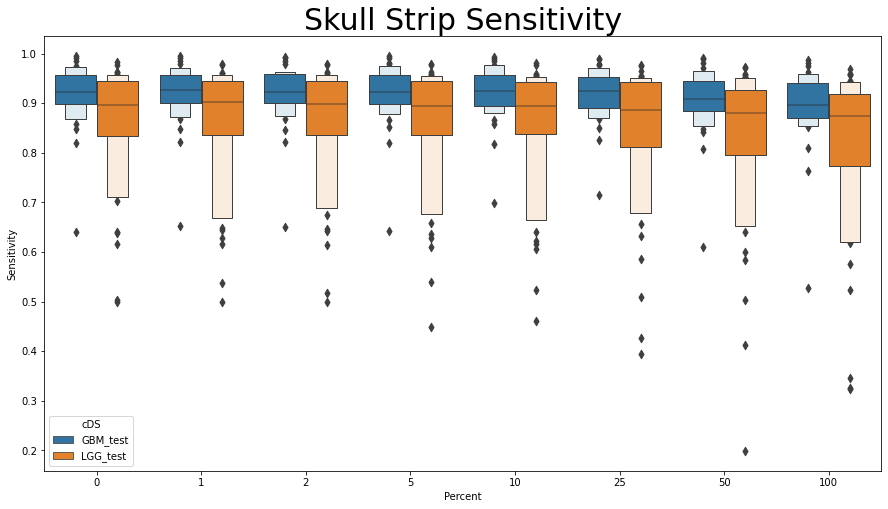

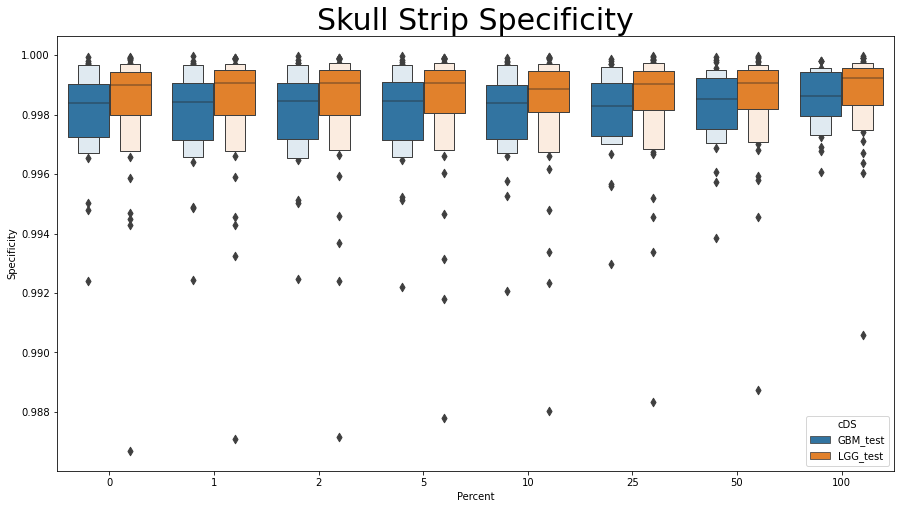

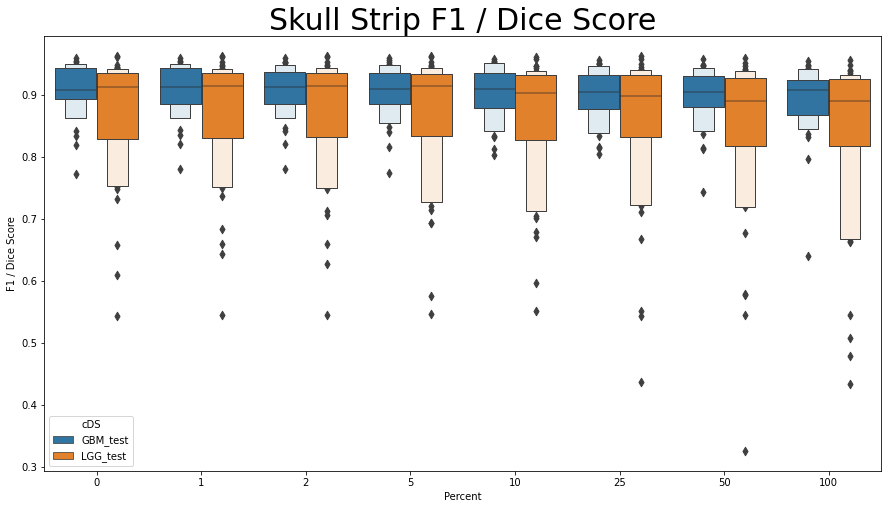

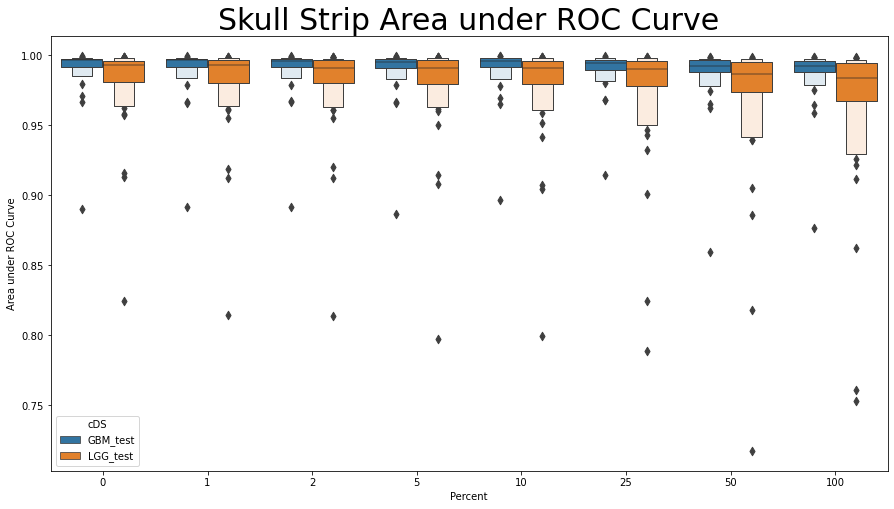

In [122]:
dfList = []
for cDS in ['GBM_test','LGG_test']:
    cmbDF = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPSSMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbDF = pd.concat(cmbDF,axis=0)
    dfList.append(cmbDF)
cmbMet = pd.concat(dfList,axis=0)
cmbMet['Percent'] = cmbMet['fraction']
metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
for cMetric in metList:
    plt.figure(figsize=(15,8))
    plt.title('Skull Strip %s' % (cMetric),fontsize=30)
    sns.boxenplot(data=cmbMet,x="Percent", y=cMetric, hue="cDS")
    plt.show()

In [429]:
print('Skull Stripping')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPSSMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    aovrm2way = AnovaRM(cmbMet, 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
    res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
    print('%s: pVal = %g' % (cDS[0:3],res2way.anova_table['Pr > F']))

Skull Stripping
GBM: pVal = 3.50784e-09
LGG: pVal = 2.62919e-10


# Testing Sequence Mislabeling

In [121]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
cPAVMetricDict = {}
testVals = ['flair','t1w','t1gd','t2w']
# expList = modalList + ['control']
expList = modalList

artShort = 'Mislabel'
cPSMMetricDict = {}
for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pSMMetricDict = {}

    for pNo in range(len(ptList)): 
    # for pNo in range(1):
        print(datetime.now().isoformat(timespec='minutes'))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cVal in testVals:
#                 randMax = (2**32) -1
#                 # hash for random seed
#                 fID = '%s%s%i' % (TCGA_ID,cModal,cVal)
#                 h = blake2s()
#                 h.update(fID.encode('utf-8'))
#                 h_int = int(h.hexdigest(), 16)

#                 random_hash = h_int + randAdd
#                 random_seed = random_hash % randMax

# #                     cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
#                 cAligned = affine.transform(imNibDict[cVal].get_fdata(),interpolation = 'nearest')
#                 cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                artDict[cModal] = imNibDict[cVal].get_fdata().copy()
#                 if cModal != 'control':
#                     artV = cTP.copy()
#                     artV = np.transpose(artV, axes = [1,0,2])
#                     artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
#                     artDict[cModal] = artVOO
#             #     for mIdx in range(len(modalList)):
#             #         modal= modalList[mIdx]
#             #         mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

#                 output = np.zeros((144,144,144,1))
#                 for idx in range(cropImg.shape[0]):
#                     img = tf.expand_dims(cropImg[idx], axis=0)
#                     output[idx,:,:,:] = model.predict(img)
                output = model.predict(cropImg)

                artID = '%s_%s_%s_%s' % (artShort,cVal,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)
                
                if cVal == cModal:
                    cVal = 'control'
                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cVal
                id_dict['TCGA_ID'] =  TCGA_ID
                id_dict['cDS'] = cDS

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        pSMMetricDict[pNo] = metricDict
    cPSMMetricDict[cDS] = pSMMetricDict

2021-11-11T09:43
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T09:43
t1w 2021-11-11T09:44
t1gd 2021-11-11T09:45
t2w 2021-11-11T09:46
2021-11-11T09:47
TCGA-27-2526
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T09:47
t1w 2021-11-11T09:49
t1gd 2021-11-11T09:51
t2w 2021-11-11T09:53
2021-11-11T09:55
TCGA-06-0132
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T09:55
t1w 2021-11-11T09:56
t1gd 2021-11-11T09:58
t2w 2021-11-11T09:59
2021-11-11T10:01
TCGA-12-1093
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T10:01
t1w 2021-11-11T10:03
t1gd 2021-11-11T10:05
t2w 2021-11-11T10:07
2021-11-11T10:08
TCGA-06-0648
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T10:08
t1w 2021-11-11T10:10
t1gd 2021-11-11T10:12
t2w 2021-11-11T10:14
2021-11-11T10:15
TCGA-06-0166
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T10:15
t1

/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T10:58
t1gd 2021-11-11T11:00
t2w 2021-11-11T11:02
2021-11-11T11:03
TCGA-06-5412
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T11:04
t1w 2021-11-11T11:05
t1gd 2021-11-11T11:07
t2w 2021-11-11T11:09
2021-11-11T11:11
TCGA-06-0168
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T11:11
t1w 2021-11-11T11:13
t1gd 2021-11-11T11:14
t2w 2021-11-11T11:16
2021-11-11T11:18
TCGA-06-0213
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T11:18
t1w 2021-11-11T11:19
t1gd 2021-11-11T11:21
t2w 2021-11-11T11:23
2021-11-11T11:25
TCGA-08-0524
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T11:25
t1w 2021-11-11T11:26
t1gd 2021-11-11T11:28
t2w 2021-11-11T11:29
2021-11-11T11:31
TCGA-08-0510
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T11:31
t1w 2021-11-11T11:32
t1gd 2021-11-11T11:34
t2w 2021-11-11T11:36
2021-11-11T11:37
TCGA-14-0789
Resizing template fro

/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T12:53
t1gd 2021-11-11T12:55
t2w 2021-11-11T12:57
2021-11-11T12:59
TCGA-06-0175
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T12:59
t1w 2021-11-11T13:01
t1gd 2021-11-11T13:03
t2w 2021-11-11T13:05
2021-11-11T13:06
TCGA-27-1838
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T13:06
t1w 2021-11-11T13:08
t1gd 2021-11-11T13:10
t2w 2021-11-11T13:12
2021-11-11T13:14
TCGA-08-0529
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T13:14
t1w 2021-11-11T13:16
t1gd 2021-11-11T13:18
t2w 2021-11-11T13:20
2021-11-11T13:21
TCGA-08-0354
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T13:21
t1w 2021-11-11T13:23
t1gd 2021-11-11T13:24
t2w 2021-11-11T13:26
2021-11-11T13:27
TCGA-DU-5853
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T13:27


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T13:29
t1gd 2021-11-11T13:31
t2w 2021-11-11T13:32
2021-11-11T13:34
TCGA-HT-7860
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T13:34
t1w 2021-11-11T13:36
t1gd 2021-11-11T13:37
t2w 2021-11-11T13:39
2021-11-11T13:40
TCGA-HT-7855
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T13:40
t1w 2021-11-11T13:42
t1gd 2021-11-11T13:44
t2w 2021-11-11T13:45
2021-11-11T13:47
TCGA-HT-7692
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T13:47


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T13:49
t1gd 2021-11-11T13:51
t2w 2021-11-11T13:52
2021-11-11T13:54
TCGA-HT-7882
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T13:54
t1w 2021-11-11T13:56
t1gd 2021-11-11T13:57
t2w 2021-11-11T13:59
2021-11-11T14:01
TCGA-HT-A5RC
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T14:01
t1w 2021-11-11T14:03
t1gd 2021-11-11T14:04
t2w 2021-11-11T14:06
2021-11-11T14:07
TCGA-DU-6400
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T14:07
t1w 2021-11-11T14:09
t1gd 2021-11-11T14:11
t2w 2021-11-11T14:12
2021-11-11T14:14
TCGA-HT-8105
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T14:14


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T14:16
t1gd 2021-11-11T14:17
t2w 2021-11-11T14:19
2021-11-11T14:21
TCGA-DU-A6S3
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T14:21


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T14:23
t1gd 2021-11-11T14:24
t2w 2021-11-11T14:26
2021-11-11T14:28
TCGA-HT-8107
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T14:28
t1w 2021-11-11T14:29
t1gd 2021-11-11T14:31
t2w 2021-11-11T14:32
2021-11-11T14:33
TCGA-CS-4941
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T14:34
t1w 2021-11-11T14:35
t1gd 2021-11-11T14:37
t2w 2021-11-11T14:39
2021-11-11T14:41
TCGA-HT-8113
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T14:41
t1w 2021-11-11T14:42
t1gd 2021-11-11T14:44
t2w 2021-11-11T14:46
2021-11-11T14:47
TCGA-CS-4943
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T14:47
t1w 2021-11-11T14:49
t1gd 2021-11-11T14:51
t2w 2021-11-11T14:52
2021-11-11T14:54
TCGA-DU-6410
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T14:54
t1w 2021-11-11T14:55
t1gd 2021-11-11T14:57
t2w 2021-11-11T14:59
2021-11-11T15:00
TCGA-HT-8106
Resizing template fro

/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T15:09
t1gd 2021-11-11T15:10
t2w 2021-11-11T15:12
2021-11-11T15:14
TCGA-DU-6399
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T15:14


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T15:15
t1gd 2021-11-11T15:17
t2w 2021-11-11T15:18
2021-11-11T15:20
TCGA-HT-7874
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T15:20
t1w 2021-11-11T15:21
t1gd 2021-11-11T15:23
t2w 2021-11-11T15:25
2021-11-11T15:27
TCGA-DU-5852
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T15:27
t1w 2021-11-11T15:28
t1gd 2021-11-11T15:30
t2w 2021-11-11T15:32
2021-11-11T15:34
TCGA-CS-6290
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T15:34


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T15:35
t1gd 2021-11-11T15:37
t2w 2021-11-11T15:38
2021-11-11T15:40
TCGA-DU-A6S2
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T15:40


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T15:41
t1gd 2021-11-11T15:43
t2w 2021-11-11T15:45
2021-11-11T15:46
TCGA-DU-6407
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T15:46
t1w 2021-11-11T15:48
t1gd 2021-11-11T15:50
t2w 2021-11-11T15:52
2021-11-11T15:54
TCGA-FG-7643
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T15:54
t1w 2021-11-11T15:56
t1gd 2021-11-11T15:57
t2w 2021-11-11T15:59
2021-11-11T16:00
TCGA-HT-7856
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T16:00
t1w 2021-11-11T16:02
t1gd 2021-11-11T16:04
t2w 2021-11-11T16:05
2021-11-11T16:07
TCGA-DU-6397
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T16:07
t1w 2021-11-11T16:09
t1gd 2021-11-11T16:10
t2w 2021-11-11T16:12
2021-11-11T16:13
TCGA-HT-7684
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T16:13
t1w 2021-11-11T16:15
t1gd 2021-11-11T16:16
t2w 2021-11-11T16:18
2021-11-11T16:19
TCGA-DU-6405
Resizing template fro

/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T16:21
t1gd 2021-11-11T16:22
t2w 2021-11-11T16:24
2021-11-11T16:26
TCGA-DU-6401
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T16:26


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T16:27
t1gd 2021-11-11T16:29
t2w 2021-11-11T16:31
2021-11-11T16:32
TCGA-HT-7693
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T16:32


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T16:34
t1gd 2021-11-11T16:36
t2w 2021-11-11T16:38
2021-11-11T16:39
TCGA-FG-6688
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T16:39


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T16:41
t1gd 2021-11-11T16:43
t2w 2021-11-11T16:44
2021-11-11T16:46
TCGA-DU-A5TP
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T16:46
t1w 2021-11-11T16:48
t1gd 2021-11-11T16:49
t2w 2021-11-11T16:51
2021-11-11T16:52
TCGA-HT-7475
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T16:52


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T16:54
t1gd 2021-11-11T16:56
t2w 2021-11-11T16:58
2021-11-11T17:00
TCGA-CS-5395
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:00
t1w 2021-11-11T17:02
t1gd 2021-11-11T17:03
t2w 2021-11-11T17:05
2021-11-11T17:06
TCGA-HT-7616
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:06
t1w 2021-11-11T17:08
t1gd 2021-11-11T17:09
t2w 2021-11-11T17:11
2021-11-11T17:12
TCGA-HT-A614
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:13


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T17:14
t1gd 2021-11-11T17:16
t2w 2021-11-11T17:18
2021-11-11T17:19
TCGA-DU-6408
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:19
t1w 2021-11-11T17:21
t1gd 2021-11-11T17:22
t2w 2021-11-11T17:24
2021-11-11T17:26
TCGA-EZ-7265A
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:26


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T17:27
t1gd 2021-11-11T17:29
t2w 2021-11-11T17:31
2021-11-11T17:33
TCGA-FG-A713
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:33


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T17:35


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1gd 2021-11-11T17:36
t2w 2021-11-11T17:38
2021-11-11T17:40
TCGA-DU-5849
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:40


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T17:41
t1gd 2021-11-11T17:43
t2w 2021-11-11T17:44
2021-11-11T17:46
TCGA-DU-5871
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:46
t1w 2021-11-11T17:47
t1gd 2021-11-11T17:49
t2w 2021-11-11T17:50
2021-11-11T17:52
TCGA-DU-8165
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:52


/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2021-11-11T17:54
t1gd 2021-11-11T17:55
t2w 2021-11-11T17:57
2021-11-11T17:58
TCGA-DU-A6S6
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T17:58
t1w 2021-11-11T18:00
t1gd 2021-11-11T18:01
t2w 2021-11-11T18:03
2021-11-11T18:04
TCGA-CS-6667
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2021-11-11T18:04
t1w 2021-11-11T18:06
t1gd 2021-11-11T18:08
t2w 2021-11-11T18:10


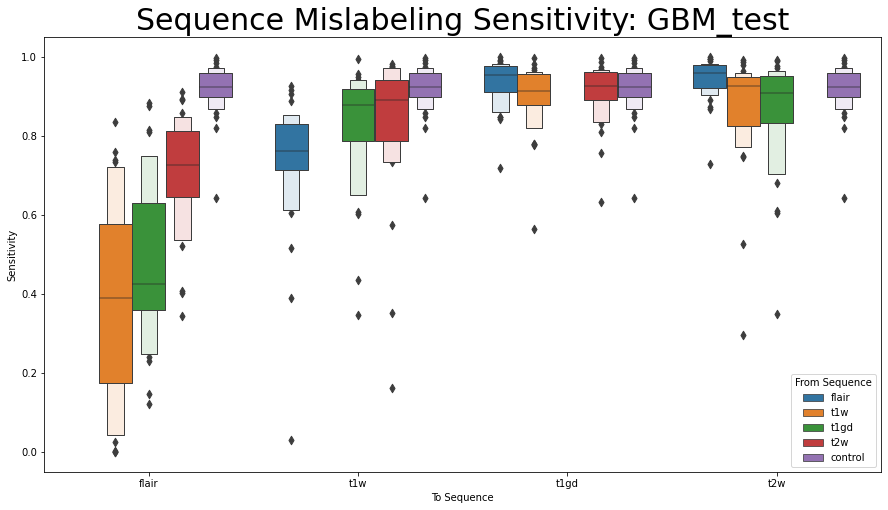

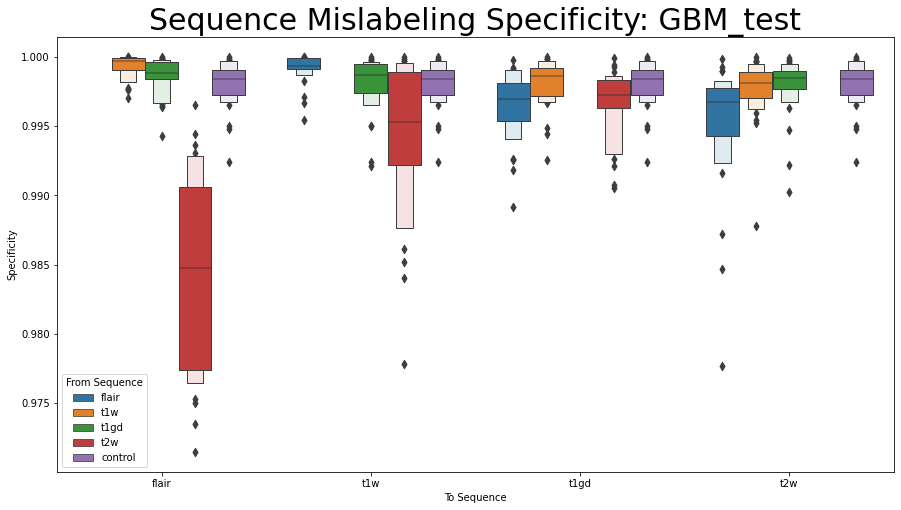

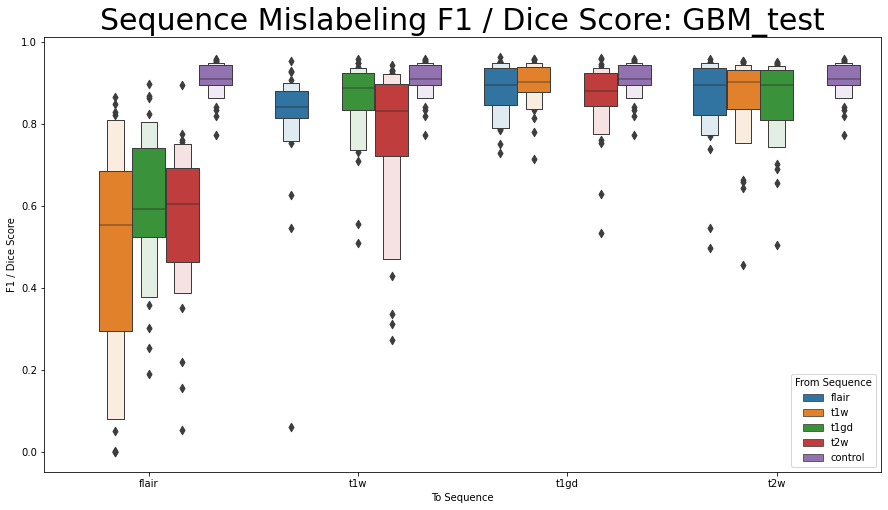

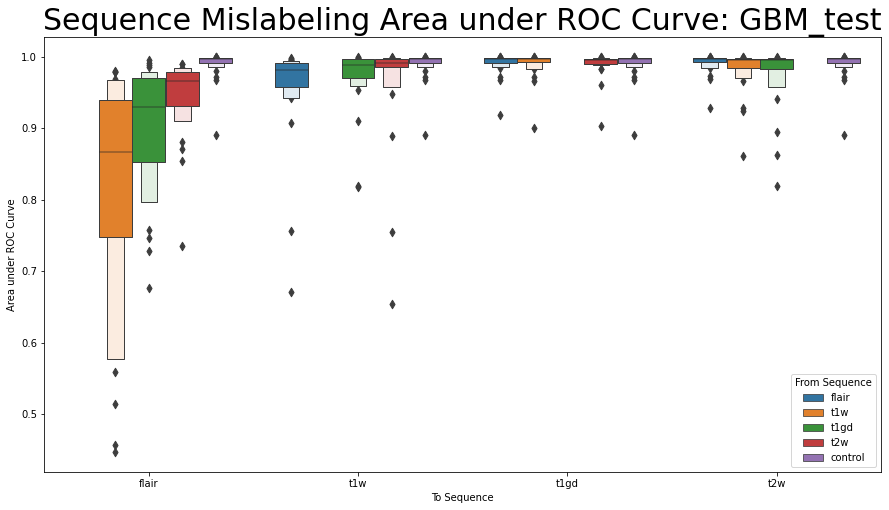

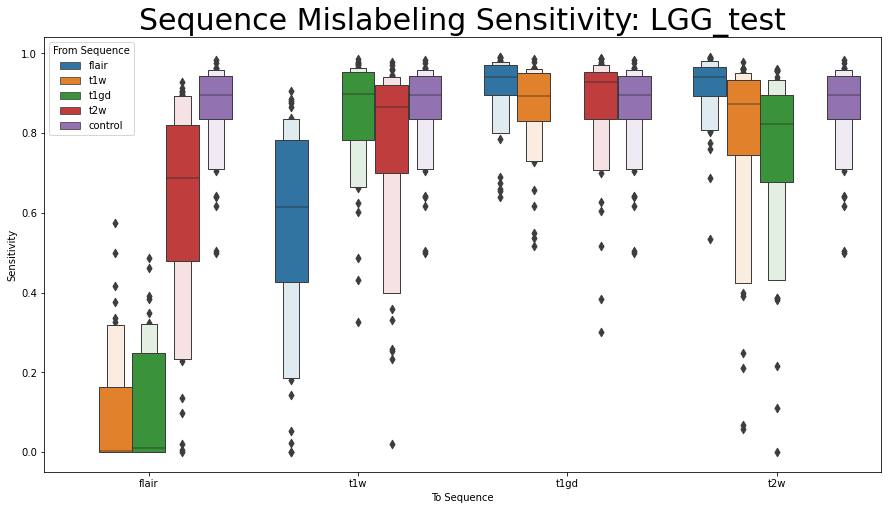

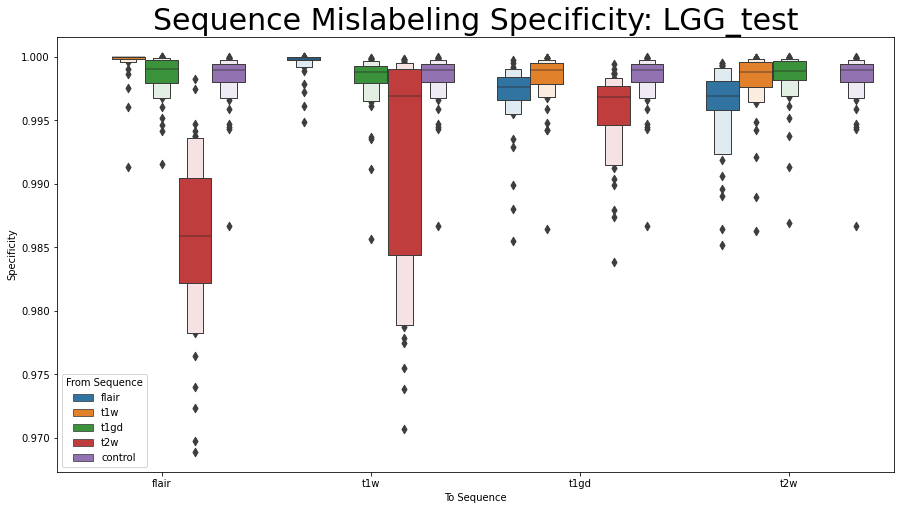

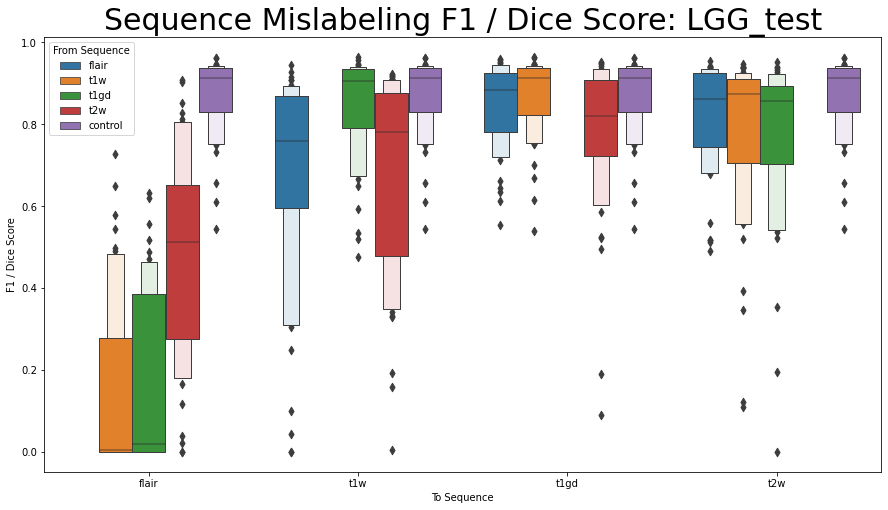

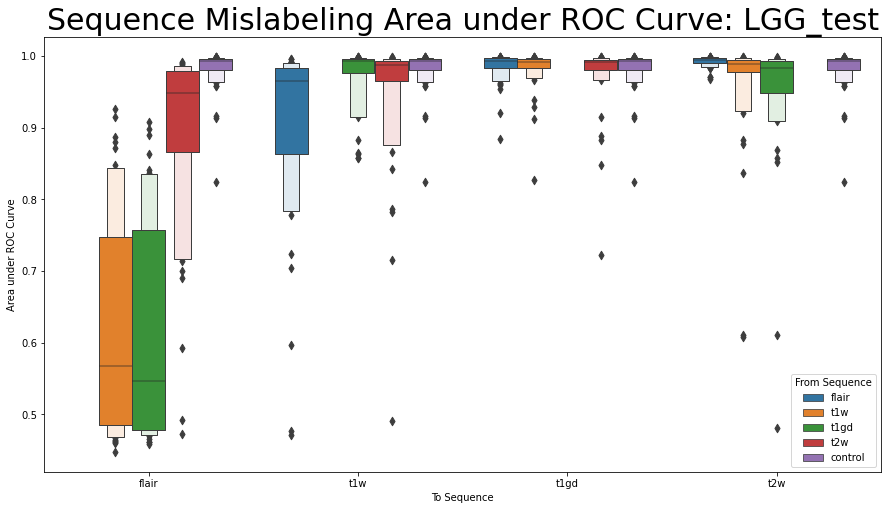

In [372]:
for cDS in ['GBM_test','LGG_test']:
# for cDS in ['GBM_test']:
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pSMMetricDict.values()]
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPSMMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['From Sequence'] = cmbMet['fraction']
    cmbMet['To Sequence'] = cmbMet['sequence']
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('Sequence Mislabeling %s: %s' % (cMetric,cDS),fontsize=30)
        sns.boxenplot(data=cmbMet,x="To Sequence", y=cMetric, hue="From Sequence",
                     hue_order= modalList + ['control'])
        plt.show()

In [438]:
from scipy.stats import ttest_rel
print('Sequence Mislabeling')
cMet = 'F1 / Dice Score'
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPSMMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for cM in modalList:
        for fM in modalList:
            if fM == cM:
                continue
            p1 = cmbMet[np.logical_and(cmbMet['sequence'] == cM,cmbMet['fraction'] == fM)][cMet]
            pc = cmbMet[np.logical_and(cmbMet['sequence'] == cM,cmbMet['fraction'] == 'control')][cMet]
            (coeff,pv)= ttest_rel(pc, p1)
            print('%s, %5s->%5s: pVal = %g' %(cDS[0:3],fM,cM,pv))
    

Sequence Mislabeling
GBM,   t1w->flair: pVal = 1.36013e-10
GBM,  t1gd->flair: pVal = 2.29019e-11
GBM,   t2w->flair: pVal = 5.94409e-14
GBM, flair->  t1w: pVal = 0.000326716
GBM,  t1gd->  t1w: pVal = 0.000257341
GBM,   t2w->  t1w: pVal = 2.81922e-05
GBM, flair-> t1gd: pVal = 0.000231722
GBM,   t1w-> t1gd: pVal = 0.00852123
GBM,   t2w-> t1gd: pVal = 0.000627164
GBM, flair->  t2w: pVal = 0.00288644
GBM,   t1w->  t2w: pVal = 0.00109384
GBM,  t1gd->  t2w: pVal = 0.000637787
LGG,   t1w->flair: pVal = 1.04849e-23
LGG,  t1gd->flair: pVal = 2.71983e-22
LGG,   t2w->flair: pVal = 7.7833e-15
LGG, flair->  t1w: pVal = 3.56243e-07
LGG,  t1gd->  t1w: pVal = 0.0221772
LGG,   t2w->  t1w: pVal = 1.48639e-07
LGG, flair-> t1gd: pVal = 0.00410509
LGG,   t1w-> t1gd: pVal = 0.871948
LGG,   t2w-> t1gd: pVal = 4.49531e-05
LGG, flair->  t2w: pVal = 0.000136993
LGG,   t1w->  t2w: pVal = 0.00194836
LGG,  t1gd->  t2w: pVal = 0.000186305


# Testing Sequence Misalignment

In [525]:

RSTF = True
modalList = ['flair','t1w','t1gd','t2w']
cPSMAMetricDict = {}
testFracs = np.asarray([1/48,2/48,3/48,4/48,5/48,6/48,7/48,8/48,9/48,10/48,11/48,12/48])

expList = modalList + ['control']
# cDS = 'GBM_test'
artShort = 'SeqAlign'
for cDS in ['GBM_test','LGG_test']:
# for cDS in ['LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    
    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pSMAMetricDict = {}
    for pNo in range(len(ptList)): 
    # for pNo in range(1):
        print('(%i/%i): %s' % (pNo,len(ptList),datetime.now().isoformat(timespec='minutes')))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        for cModal in expList:
            print(cModal,datetime.now().isoformat(timespec='minutes'))
            for cFrac in testFracs:
                randMax = (2**32) -1
                # hash for random seed
                fID = '%s%s' % (TCGA_ID,cModal)
                h = blake2s()
                h.update(fID.encode('utf-8'))
                h_int = int(h.hexdigest(), 16)

                random_hash = h_int + randAdd
                random_seed = random_hash % randMax

                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                elif cModal != 'control':
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
                if cModal != 'control':
                    aV = add_fake_skull(cTP,dispTF=False)
                    artV = add_misalignment_artifact(aV,random_seed=random_seed,phRot=cFrac*np.pi,
                                                           thRot=cFrac*np.pi/4,xyzTrMax=cFrac*24,
                                                           dispTF=False)
                    artV = remove_fake_skull(artV,cTP)
                    artV = np.transpose(artV, axes = [1,0,2])
                    artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                    artDict[cModal] = artVOO
            #     for mIdx in range(len(modalList)):
            #         modal= modalList[mIdx]
            #         mri_utils.plot_img_arr(artDict[modal])

                bbox = combine_bboxes_dict(artDict,verbose=False)
                lbl = lbl_nib.get_fdata()
                cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
                cropImDict = {modal : [] for modal in modalList}
                for mIdx in range(len(modalList)):
                    modal= modalList[mIdx]
                    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                    cropImDict[modal] = cropMod
                cropImg = np.concatenate(list(cropImDict.values()),axis=3)

                output = np.zeros((144,144,144,1))
                for idx in range(cropImg.shape[0]):
                    img = tf.expand_dims(cropImg[idx], axis=0)
                    output[idx,:,:,:] = model.predict(img)

                artID = '%s_%02g_%s_%s' % (artShort,cFrac*48,cModal,TCGA_ID)
                np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

                y_true = cropLbl.reshape(-1).astype(int)
                y_scores = output.reshape(-1,1)
                y_pred = np.where(y_scores > 0.5, 1, 0)

                id_dict = {}
                id_dict['artifact'] = artShort
                id_dict['sequence'] =  cModal
                id_dict['fraction'] =  cFrac
                id_dict['TCGA_ID'] =  TCGA_ID

                (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                       y_pred.ravel(),
                                                                       y_scores.ravel())
                sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}

                TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
                (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

                cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

                id_dict.update(cm_dict)
                id_dict.update(sm_dict)

                metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join(artOutDir,artFName))

        pSMAMetricDict[pNo] = metricDict
    cPSMAMetricDict[cDS] = pSMAMetricDict

(0/33): 2022-01-18T16:52
TCGA-06-0128
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-18T16:52
t1w 2022-01-18T16:57
t1gd 2022-01-18T17:01
t2w 2022-01-18T17:06
control 2022-01-18T17:11
(1/33): 2022-01-18T17:15
TCGA-27-2526
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-18T17:15
t1w 2022-01-18T17:23
t1gd 2022-01-18T17:31
t2w 2022-01-18T17:39
control 2022-01-18T17:47
(2/33): 2022-01-18T17:53
TCGA-06-0132
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-18T17:54
t1w 2022-01-18T18:00
t1gd 2022-01-18T18:06
t2w 2022-01-18T18:12
control 2022-01-18T18:19
(3/33): 2022-01-18T18:24
TCGA-12-1093
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-18T18:24
t1w 2022-01-18T18:32
t1gd 2022-01-18T18:39
t2w 2022-01-18T18:47
control 2022-01-18T18:55
(4/33): 2022-01-18T19:01
TCGA-06-0648
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-18T19:01
t1w 2022-01-18T19:08
t1gd 2022-01-18T19

(6/43): 2022-01-19T14:19
TCGA-DU-6400
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-19T14:19
t1w 2022-01-19T14:26
t1gd 2022-01-19T14:33
t2w 2022-01-19T14:39
control 2022-01-19T14:46
(7/43): 2022-01-19T14:52
TCGA-HT-8105
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-19T14:52
t1w 2022-01-19T14:59
t1gd 2022-01-19T15:07
t2w 2022-01-19T15:14
control 2022-01-19T15:21
(8/43): 2022-01-19T15:27
TCGA-DU-A6S3
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-19T15:27
t1w 2022-01-19T15:34
t1gd 2022-01-19T15:41
t2w 2022-01-19T15:48
control 2022-01-19T15:55
(9/43): 2022-01-19T16:01
TCGA-HT-8107
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-19T16:01
t1w 2022-01-19T16:07
t1gd 2022-01-19T16:13
t2w 2022-01-19T16:19
control 2022-01-19T16:26
(10/43): 2022-01-19T16:32
TCGA-CS-4941
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-19T16:32
t1w 2022-01-19T16:40
t1gd 2022-01-19T1

/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/data/ncwang/MRI_artifacts/code/data_metrics.py:66: RuntimeWarning: invalid value encountered in long_scalars
  PPV = TP/(TP+FP)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:873: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


t1w 2022-01-20T06:54
t1gd 2022-01-20T07:00
t2w 2022-01-20T07:07
control 2022-01-20T07:13
(38/43): 2022-01-20T07:19
TCGA-DU-5849
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-20T07:19
t1w 2022-01-20T07:25
t1gd 2022-01-20T07:31
t2w 2022-01-20T07:37
control 2022-01-20T07:43
(39/43): 2022-01-20T07:49
TCGA-DU-5871
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-20T07:49
t1w 2022-01-20T07:55
t1gd 2022-01-20T08:01
t2w 2022-01-20T08:07
control 2022-01-20T08:13
(40/43): 2022-01-20T08:19
TCGA-DU-8165
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-20T08:19
t1w 2022-01-20T08:25
t1gd 2022-01-20T08:31
t2w 2022-01-20T08:37
control 2022-01-20T08:43
(41/43): 2022-01-20T08:48
TCGA-DU-A6S6
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
flair 2022-01-20T08:48
t1w 2022-01-20T08:54
t1gd 2022-01-20T09:00
t2w 2022-01-20T09:06
control 2022-01-20T09:12
(42/43): 2022-01-20T09:17
TCGA-CS-6667
Resizing template from:  (91

In [488]:
# load metrics from file
artShort = 'SeqAlign'
cMDict = {}
for cDS in ['GBM_test','LGG_test']:
    artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
    metFNList = []
    mDict = {}
    for root, dirs, files in os.walk(artOutDir):
        for dn in files:
            metFNList.append(dn)
    # print(metFNList)
    for pNo in range(len(metFNList)):
        metFN = metFNList[pNo]
        metDF = pd.read_csv(os.path.join(artOutDir,metFN))
        mDict[pNo] = metDF.to_dict(orient='index')
    cMDict[cDS] = mDict
cPSMAMetricDict = cMDict

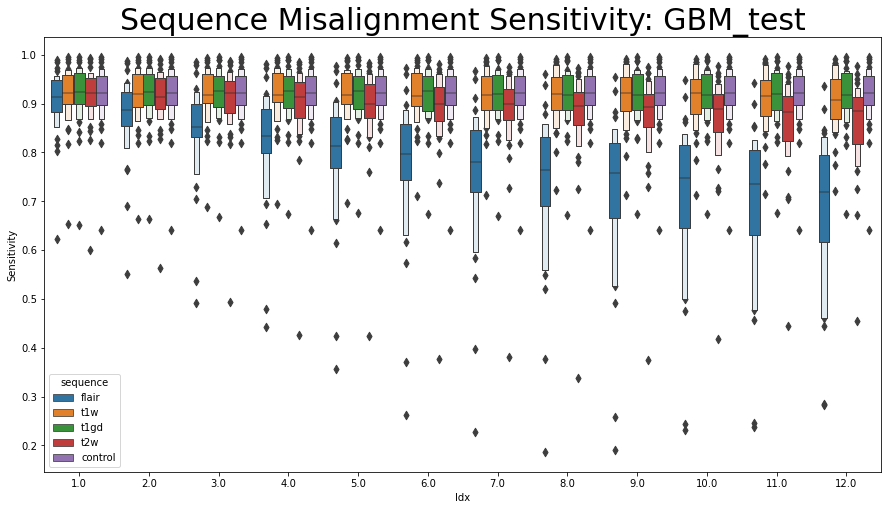

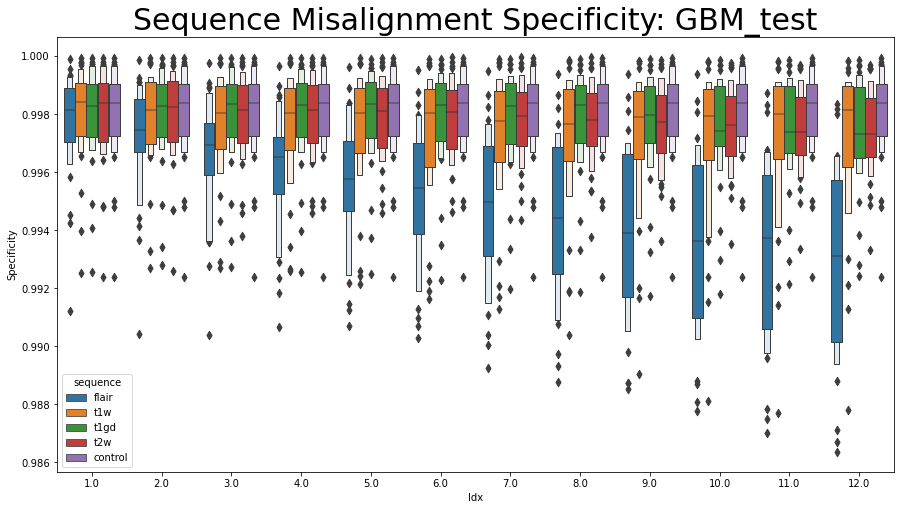

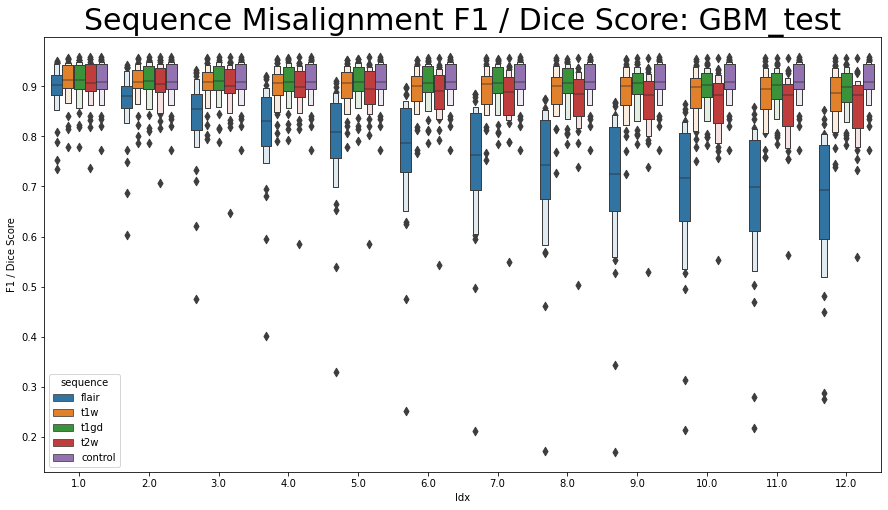

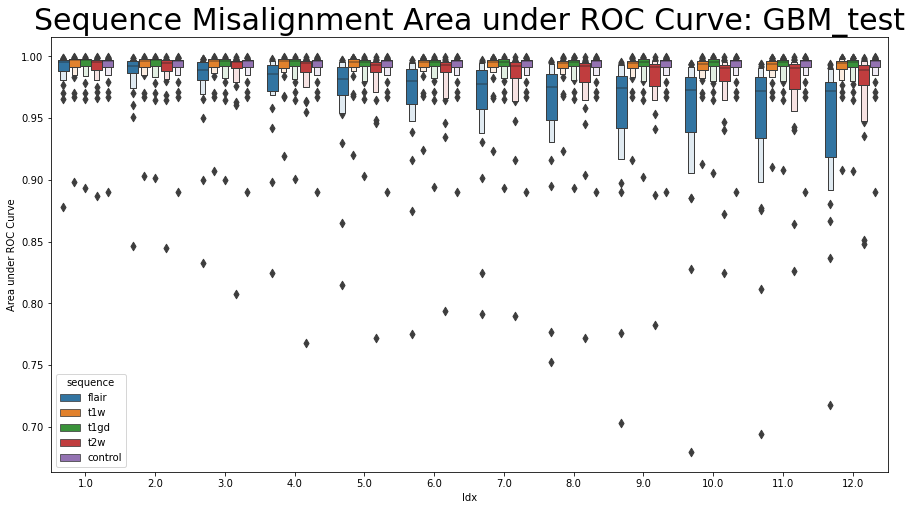

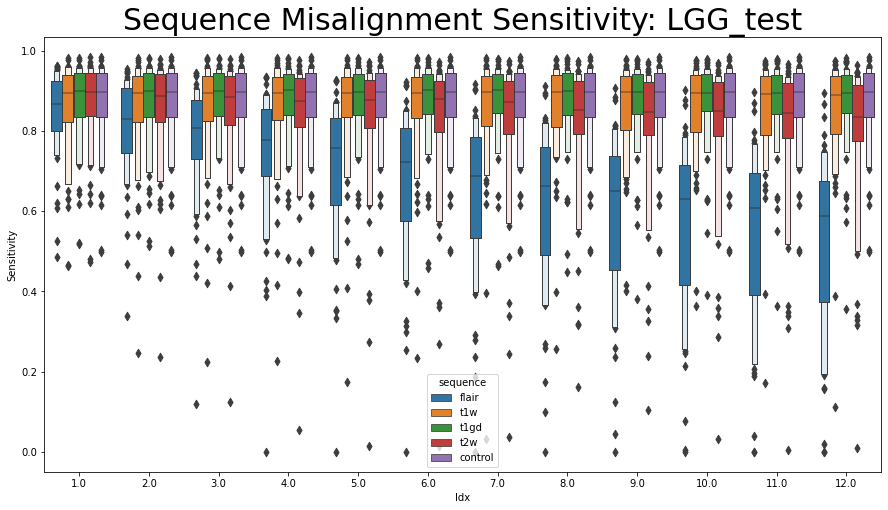

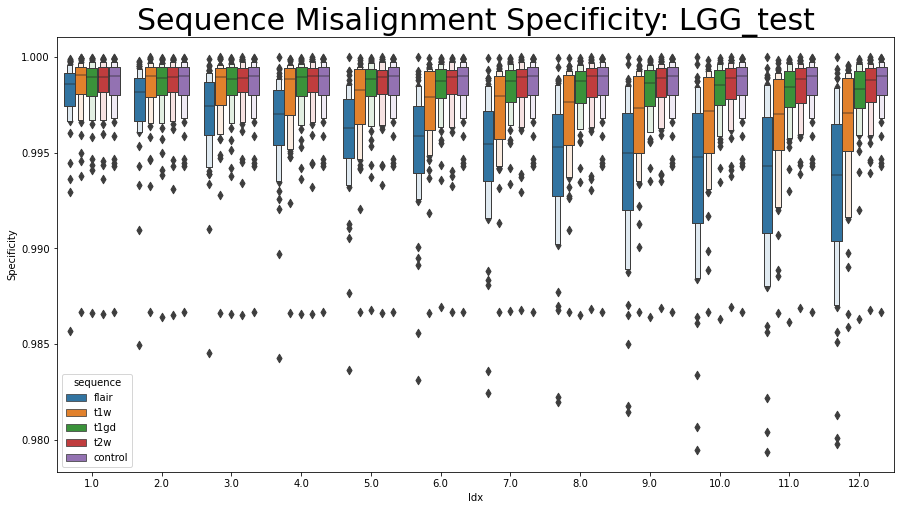

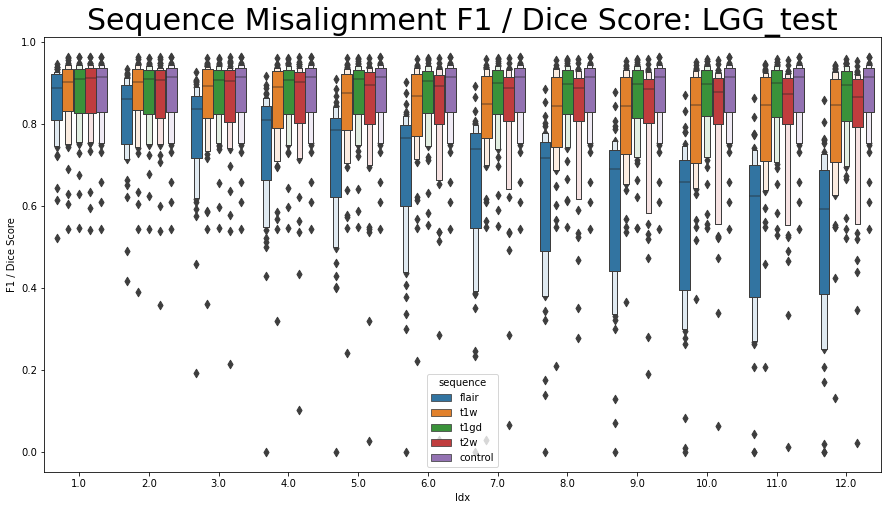

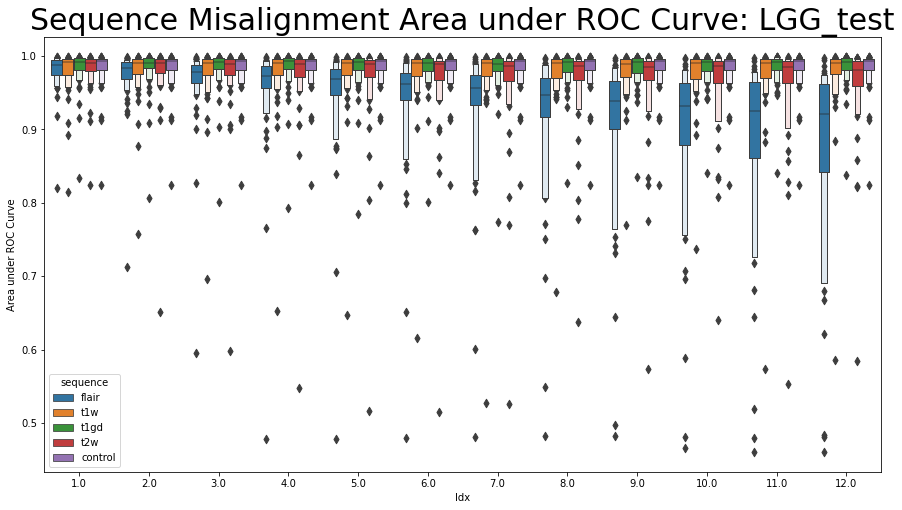

In [528]:
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPSMAMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPMMetricDict.values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    cmbMet['Idx'] = np.round(cmbMet['fraction'] * 48)
    metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
    for cMetric in metList:
        plt.figure(figsize=(15,8))
        plt.title('Sequence Misalignment %s: %s' % (cMetric,cDS),fontsize=30)
        hbox = sns.boxenplot(data=cmbMet,x="Idx", y=cMetric,hue="sequence")
        if cMetric == 'F1 / Dice':
            hbox.set_ylim([0,1])
        plt.show()

In [529]:
print('Sequence Misalignment')
for cDS in ['GBM_test','LGG_test']:
    cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPSMAMetricDict[cDS].values()]
    cmbMet = pd.concat(cmbMet,axis=0)
    for seq in modalList:
        aovrm2way = AnovaRM(cmbMet[cmbMet['sequence'] ==seq], 'F1 / Dice Score', 'TCGA_ID', within=['fraction'])
        res2way = aovrm2way.fit()
#         print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']), res2way)
        print('%s, %s: pVal = %g' % (cDS[0:3], seq,res2way.anova_table['Pr > F']))

Sequence Misalignment
GBM, flair: pVal = 2.29107e-105
GBM, t1w: pVal = 2.42336e-24
GBM, t1gd: pVal = 4.63181e-38
GBM, t2w: pVal = 6.51953e-39
LGG, flair: pVal = 5.01338e-121
LGG, t1w: pVal = 2.50358e-33
LGG, t1gd: pVal = 6.52224e-10
LGG, t2w: pVal = 1.03182e-20


# Testing Inhomogeneity Artifact

In [ ]:
testVals = np.asarray([[1,1.05,1.1,1.15,1.2,1.25,1.3,1.35,1.4],
                       [1,0.95,0.9,0.85,0.8,0.75,0.7,0.65,0.6]])
artD2Lbl = 25
RSTF = True
modalList = ['flair','t1w','t1gd','t2w']

artShort = 'InhField'
cPInhMetricDict = {}

for cDS in ['GBM_test','LGG_test']:
    cDS_dir = os.path.join(orig_data_dir,'image_data',cDS)

    ptList = []
    for root, dirs, files in os.walk(cDS_dir):
        for dn in dirs:
            ptList.append(dn)
    randAdd = 0
    pInhMetricDict = {}
    for pNo in range(len(ptList)):
    # for pNo in range(1):
        print('(%i/%i): %s' % (pNo,len(ptList),datetime.now().isoformat(timespec='minutes')))
        cDir = os.path.join(cDS_dir,ptList[pNo])
        (lbl_nib, imNibDict,transformed,tr_label,affine,TCGA_ID) = load_align_data(cDir)
        metricDict = {}
    #     artName = 'stepwise_rotation'
        artIntDir = os.path.join(root_dir,'data','artOutputs',cDS,artShort)
        if not os.path.exists(artIntDir):
            os.makedirs(artIntDir)

        lbl = lbl_nib.get_fdata()

        for artI in range(testVals.shape[1]):
            cVal = testVals[:,artI]
            print(cVal,datetime.now().isoformat(timespec='minutes'))
            randMax = (2**32) -1
            # hash for random seed
            fID = '%s' % (TCGA_ID)
            h = blake2s()
            h.update(fID.encode('utf-8'))
            h_int = int(h.hexdigest(), 16)

            random_hash = h_int + randAdd
            random_seed = random_hash % randMax

            artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}
            for cMIdx in range(len(modalList)):
                cModal = modalList[cMIdx]
                if cModal == 't1w':
                    cTP = np.transpose(transformed,axes = [1,0,2])
                else :
                    cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
                    cTP = np.transpose(cAligned,axes = [1,0,2])

                
                
                if cMIdx == 0:
                    seedLocs = generate_dist_seed_locs(tr_label,cTP,artDMid = artD2Lbl,
                                                       random_seed=random_seed,dispTF=False)

                aV = add_fake_skull(cTP,dispTF=False)

                artV = add_inhomogeneity_artifact(aV,seedLocs=seedLocs,random_seed=random_seed,
                                                  maxMult=cVal[0],minMult =cVal[1],dispTF=False)
                artV = remove_fake_skull(artV,cTP)
                artV = np.transpose(artV, axes = [1,0,2])
                artVOO = affine.transform_inverse(artV,interpolation = 'nearest')
                artDict[cModal] = artVOO
    #         for mIdx in range(len(modalList)):
    #             modal= modalList[mIdx]
    #             mri_utils.plot_img_arr(artDict[modal])

            bbox = combine_bboxes_dict(artDict,verbose=False)
            cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
            cropImDict = {modal : [] for modal in modalList}
            for mIdx in range(len(modalList)):
                modal= modalList[mIdx]
                cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
                cropImDict[modal] = cropMod
            cropImg = np.concatenate(list(cropImDict.values()),axis=3)

            output = np.zeros((144,144,144,1))
            for idx in range(cropImg.shape[0]):
                img = tf.expand_dims(cropImg[idx], axis=0)
                output[idx,:,:,:] = model.predict(img)

            artID = '%s_%02g_%s' % (artShort,cVal[0],TCGA_ID)
            np.save(os.path.join(artIntDir,'%s.npy' % artID),output)

            y_true = cropLbl.reshape(-1).astype(int)
            y_scores = output.reshape(-1,1)
            y_pred = np.where(y_scores > 0.5, 1, 0)

            id_dict = {}
            id_dict['artifact'] = artShort
    #         id_dict['sequence'] =  cModal
            id_dict['fraction'] =  cVal
            id_dict['TCGA_ID'] =  TCGA_ID
            id_dict['cDS'] = cDS

            (sm_names,sm_values) = data_metrics.similarity_metrics(y_true.ravel(),
                                                                   y_pred.ravel(),
                                                                   y_scores.ravel())
            sm_dict = {n: v for (n,v) in zip(sm_names,sm_values)}
#             id_dict['Area under ROC Curve'] = roc_auc_score(y_true.ravel(), y_scores.ravel())
    
            TN, FP, FN, TP = data_metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
            (cm_names,cm_values) = data_metrics.classical_metrics(TN, FP, FN, TP, y_true,y_pred,verbose=False)

            cm_dict = {n: v for (n,v) in zip(cm_names,cm_values)}

            id_dict.update(cm_dict)
            id_dict.update(sm_dict)

            metricDict[artID] = id_dict

        artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
        if not os.path.exists(artOutDir):
            os.makedirs(artOutDir)
        artFName = '%s_%s.csv' % (artShort,TCGA_ID)
        metDF = pd.DataFrame.from_dict(metricDict,orient='index')
        metDF.to_csv(os.path.join( artOutDir,artFName))

        pInhMetricDict[pNo] = metricDict
    cPInhMetricDict[cDS] = pInhMetricDict

In [159]:
# load metrics from file
artShort = 'InhField'
cMDict = {}
for cDS in ['GBM_test','LGG_test']:
    artOutDir = os.path.join(root_dir,'data','artMetrics',cDS,artShort,'patients')
    metFNList = []
    mDict = {}
    for root, dirs, files in os.walk(artOutDir):
        for dn in files:
            metFNList.append(dn)
    # print(metFNList)
    for pNo in range(len(metFNList)):
        metFN = metFNList[pNo]
        metDF = pd.read_csv(os.path.join(artOutDir,metFN))
        mDict[pNo] = metDF.to_dict(orient='index')
    cMDict[cDS] = mDict
cPInhMetricDict = cMDict

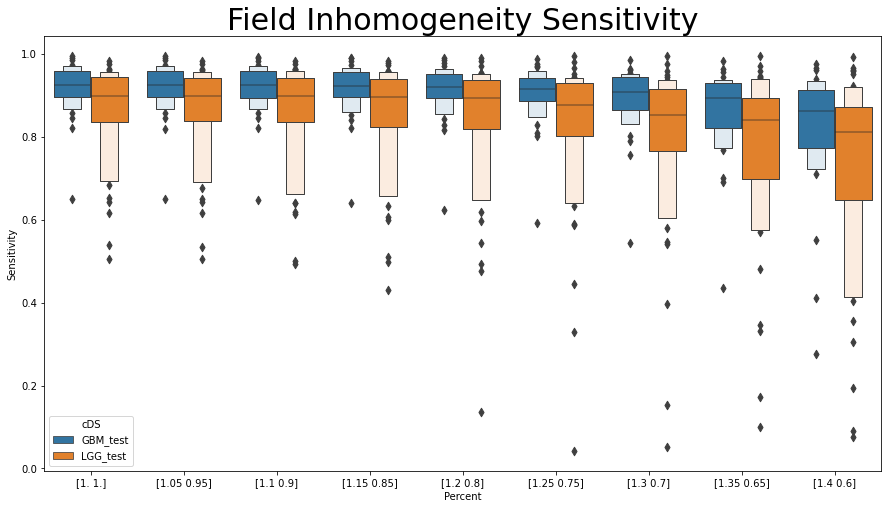

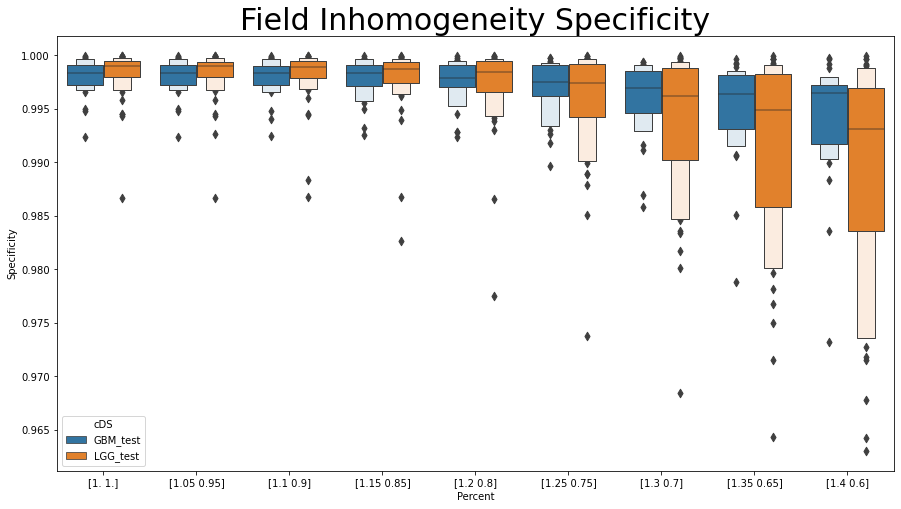

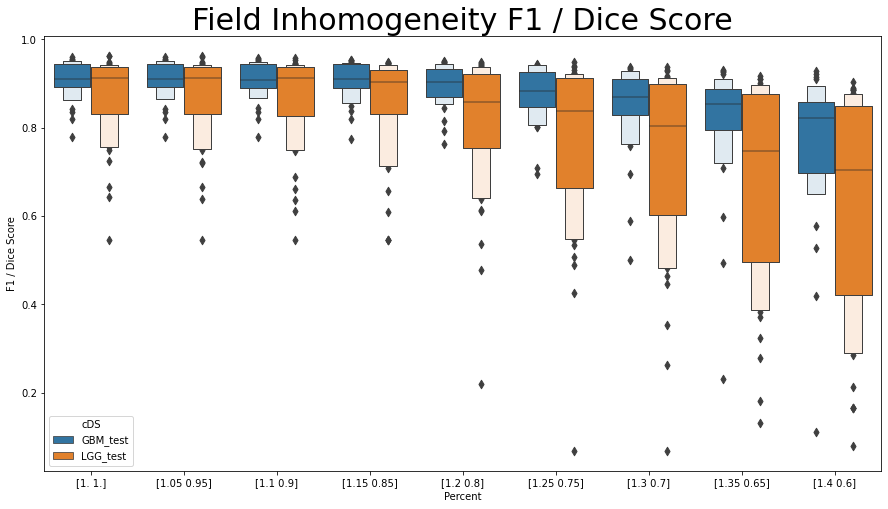

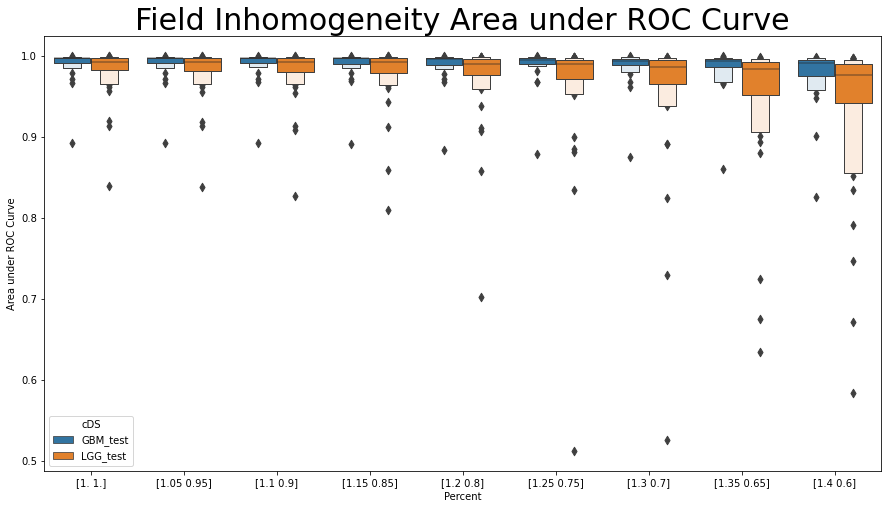

In [485]:
dfList = []
for cDS in ['GBM_test','LGG_test']:
    cmbDF = [pd.DataFrame.from_dict(mD,orient='index') for mD in cPInhMetricDict[cDS].values()]
#     cmbMet = [pd.DataFrame.from_dict(mD,orient='index') for mD in pANMetricDict.values()]
    cmbDF = pd.concat(cmbDF,axis=0)
    dfList.append(cmbDF)
cmbMet = pd.concat(dfList,axis=0)
cmbMet['Percent'] = cmbMet['fraction']
metList =['Sensitivity', 'Specificity', 'F1 / Dice Score','Area under ROC Curve']
for cMetric in metList:
    plt.figure(figsize=(15,8))
    plt.title('Field Inhomogeneity %s' % (cMetric),fontsize=30)
    sns.boxenplot(data=cmbMet,x="Percent", y=cMetric, hue="cDS")
    plt.show()

In [71]:
artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}

bbox = combine_bboxes_dict(artDict,verbose=False)
lbl = lbl_nib.get_fdata()
cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
cropImDict = {modal : [] for modal in modalList}
for mIdx in range(len(modalList)):
    modal= modalList[mIdx]
    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
    cropImDict[modal] = cropMod
cropImg = np.concatenate(list(cropImDict.values()),axis=3)

output = np.zeros((144,144,144,1))
for idx in range(cropImg.shape[0]):
    img = tf.expand_dims(cropImg[idx], axis=0)
    output[idx,:,:,:] = model.predict(img)

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

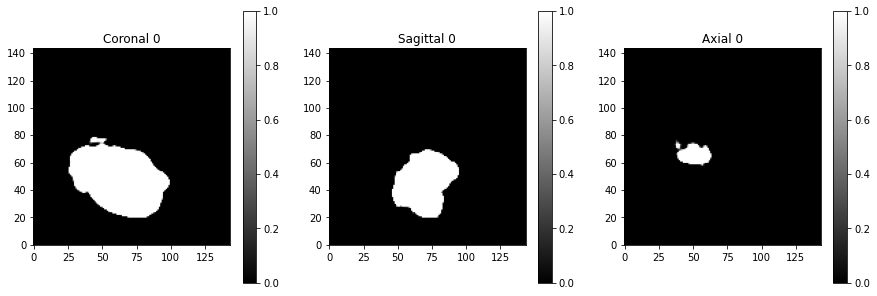

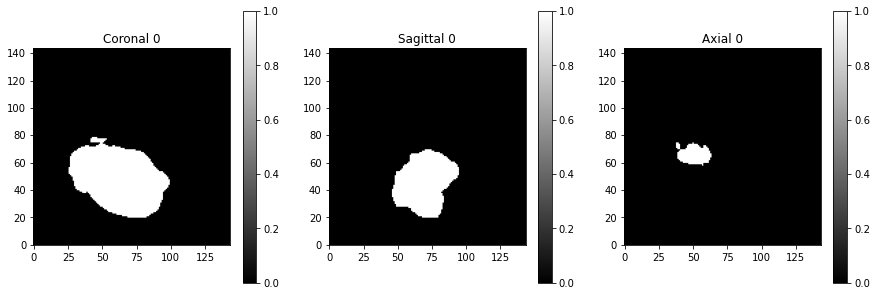

In [73]:
mri_utils.plot_img_arr(output)
mri_utils.plot_img_arr(output >.5)

In [89]:
from scipy.ndimage import zoom

unCropOut = np.zeros(imNibDict['t1w'].shape)
unCropOut[bbox[0,0]:bbox[0,1],bbox[1,0]:bbox[1,1],bbox[2,0]:bbox[2,1]]  
print(unCropOut.shape)
print(bbox)

(240, 240, 155)
[[ 51. 186.]
 [ 43. 214.]
 [ 11. 140.]]


[135.0, 171.0, 129.0]
[0.9375     1.1875     0.89583333]


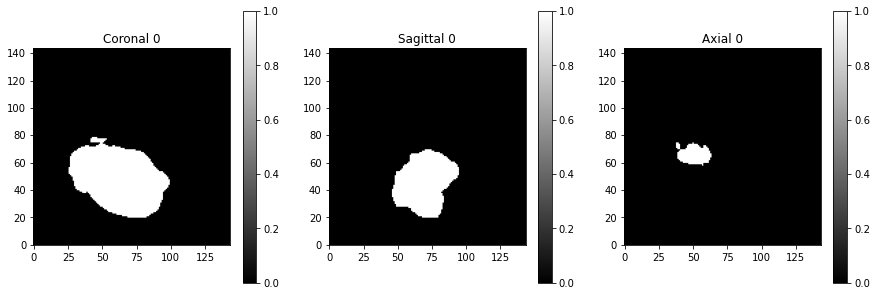

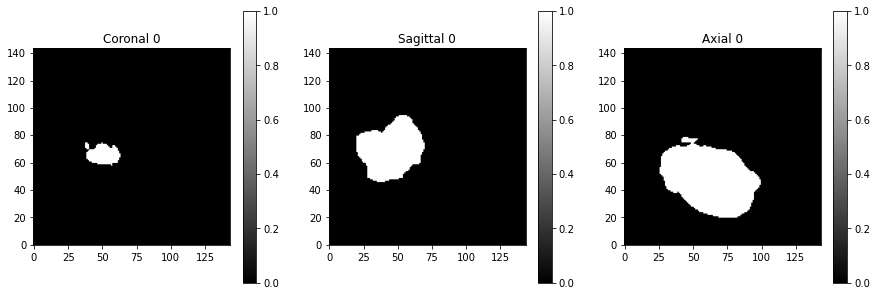

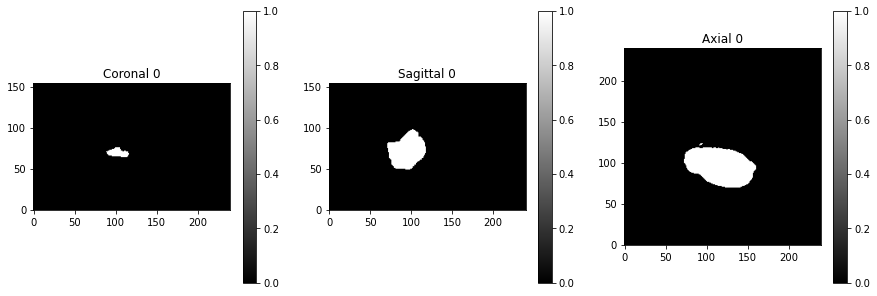

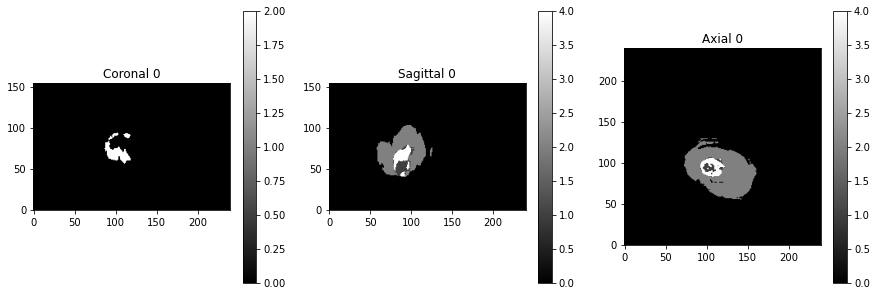

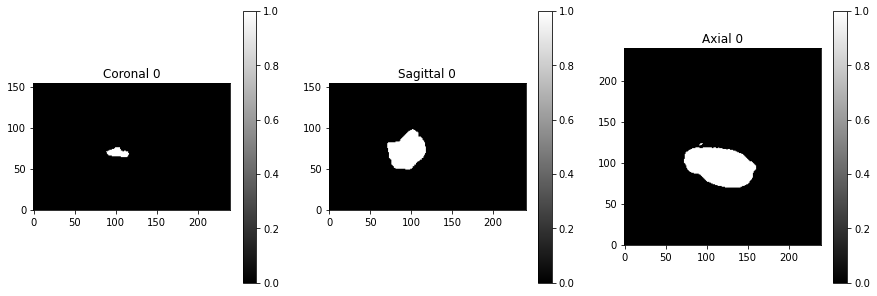

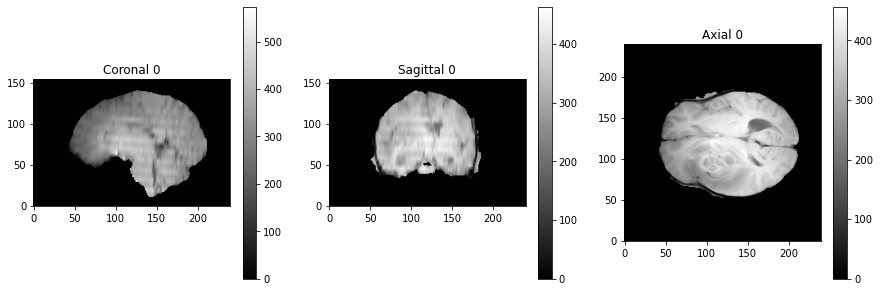

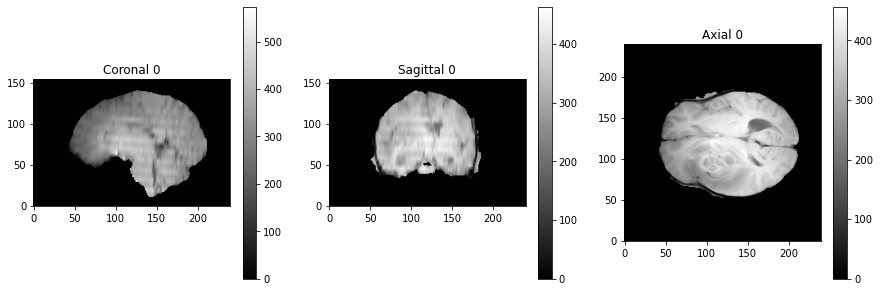

In [132]:
cropDim = [144,144,144]
origBBD = [bb[1]-bb[0] for bb in bbox]
print(origBBD)
RSMat = np.divide(origBBD,cropDim)
outTP = np.transpose(np.squeeze(output),[2,1,0])
unZoom = zoom(outTP, RSMat,cval = 0)
unCropOut[int(bbox[0,0]):int(bbox[0,1]),
          int(bbox[1,0]):int(bbox[1,1]),
          int(bbox[2,0]):int(bbox[2,1])]  = unZoom
# RSMat = np.tile(np.amin(RSMat),len(RSMat)) # long axis scaling
print(RSMat)
mri_utils.plot_img_arr(output >.5)
mri_utils.plot_img_arr(outTP >.5)
mri_utils.plot_img_arr(unCropOut >.5)


# outVOO = affine.transform_inverse(unCropOut,interpolation = 'nearest')
outNib = nib.nifti1.Nifti1Image(unCropOut,moving_img.affine,header=moving_img.header)
# empty_header = nib.Nifti1Header()
# temp = nib.Nifti1Image(unCropOut>0.5,moving_img.affine,header=empty_header)
mri_utils.plot_img_arr(lbl_nib.get_fdata())
mri_utils.plot_img_arr(temp.get_fdata())
mri_utils.plot_img_arr(moving_img.get_fdata())
# testNib = nib.nifti1.Nifti1Image(moving_img.get_fdata(),moving_img.affine,header=empty_header)
mri_utils.plot_img_arr(testNib.get_fdata())

outNibDir = os.path.join(root_dir,'data','nib_examples')
if not os.path.exists(outNibDir):
    os.makedirs(outNibDir)
nib.save(outNib, os.path.join(outNibDir, '%s_t1_out.nii.gz' % TCGA_ID))

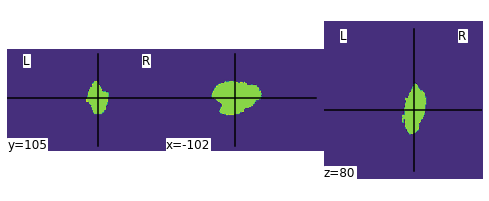

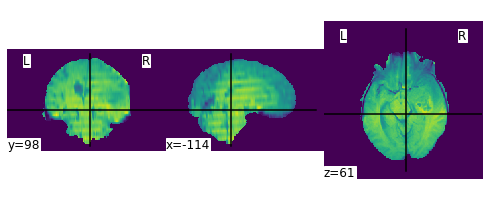

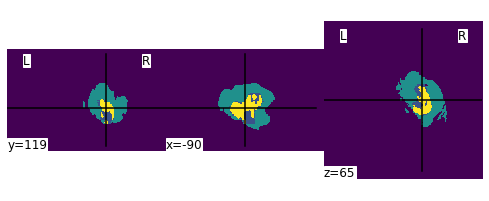

In [130]:
from nilearn import plotting
plotting.plot_img(outNib)
plotting.plot_img(moving_img)
plotting.plot_img(lbl_nib)
# print(TCGA_ID)

In [114]:
# outTP = np.transpose(np.squeeze(output),axes = [1,0,2])

# outVOO = affine.transform_inverse(np.squeeze(output>.5),interpolation = 'nearest')
# outNib = nib.nifti1.Nifti1Image(outVOO,moving_img.affine,header=moving_img.header)
outNibDir = os.path.join(root_dir,'data','nib_examples')
if not os.path.exists(outNibDir):
    os.makedirs(outNibDir)
nib.save(outNib, os.path.join(outNibDir, '%s_t1_out.nii.gz' % TCGA_ID))

# Debugging misalignment

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

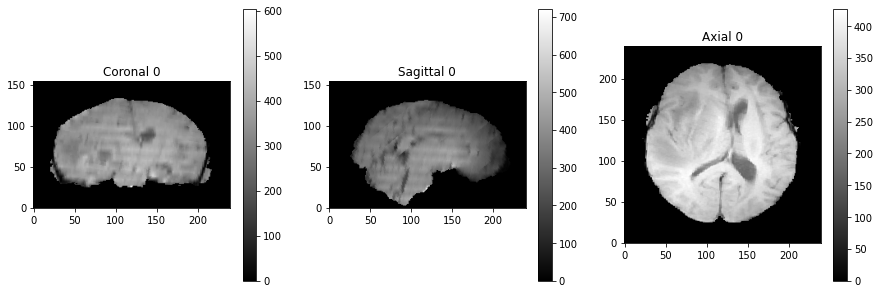

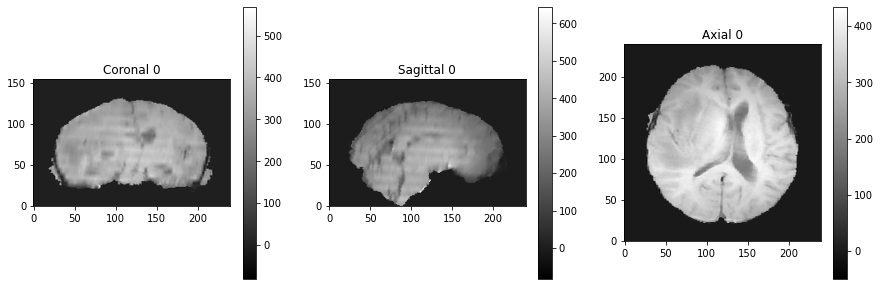

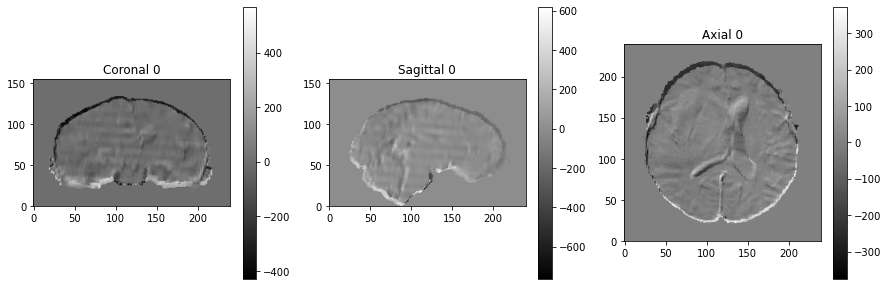

In [218]:
tp = np.transpose(transformed,axes = [1,0,2])
aV = add_misalignment_artifact(tp,phRot=0,thRot=0,dispTF=False)
mri_utils.plot_img_arr(tp)
mri_utils.plot_img_arr(aV)
mri_utils.plot_img_arr(aV-tp)
# for mIdx in range(len(modalList)):
#     modal= modalList[mIdx]
#     mri_utils.plot_img_arr(imNibDict[modal].get_fdata())

# Debugging Inhomogeneity

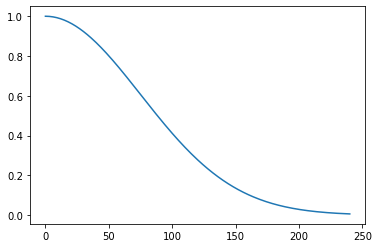

In [201]:
from scipy.signal import medfilt2d, gaussian
gSz = max(inArr.shape)
window = gaussian(gSz*2+1, std=75)
window = window[gSz:]
plt.plot(window)

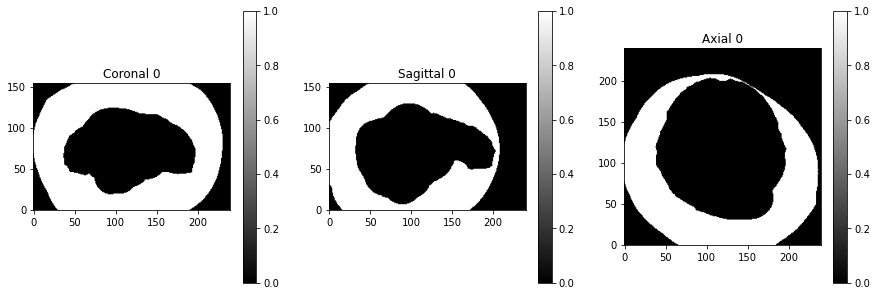

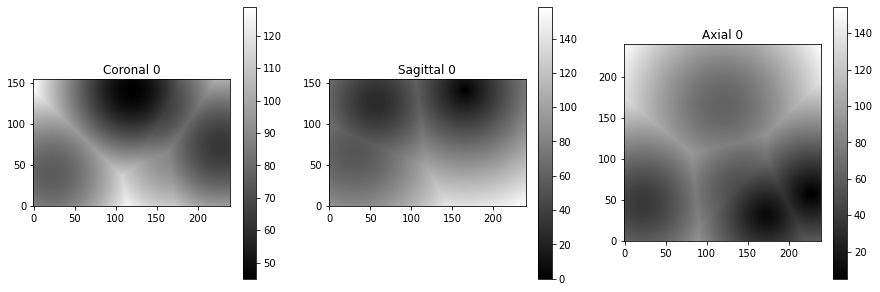

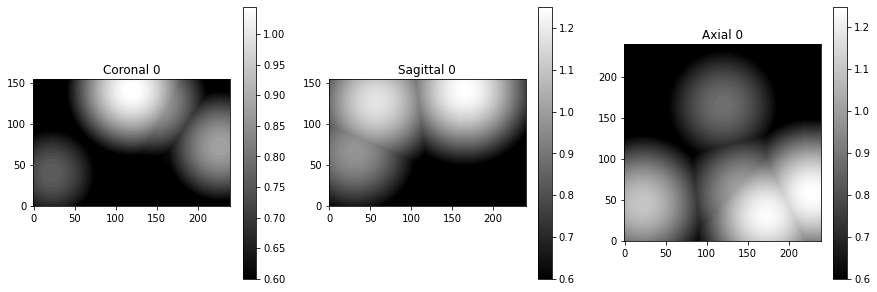

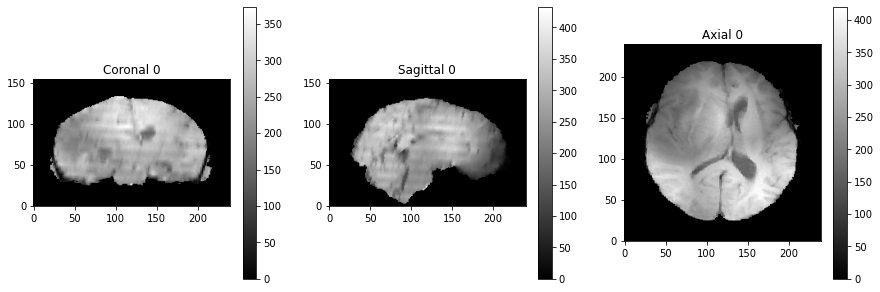

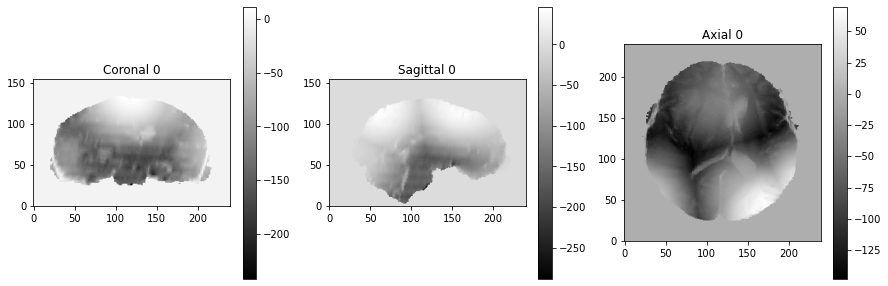

In [202]:
tp = np.transpose(transformed,axes = [1,0,2])
aV = add_inhomogeneity_artifact(tp,lblArr=lbl_nib)

# Debugging Signal Loss

2021-10-20T13:50
flair
t1w
t1gd
t2w


<Figure size 432x288 with 0 Axes>

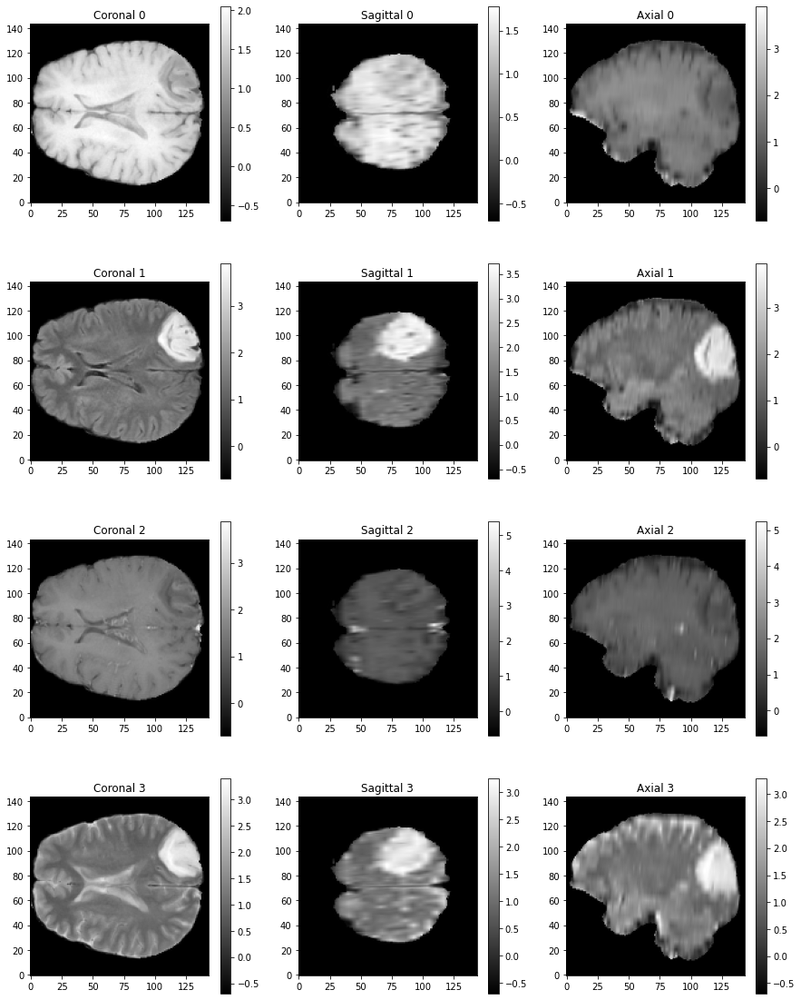

<Figure size 432x288 with 0 Axes>

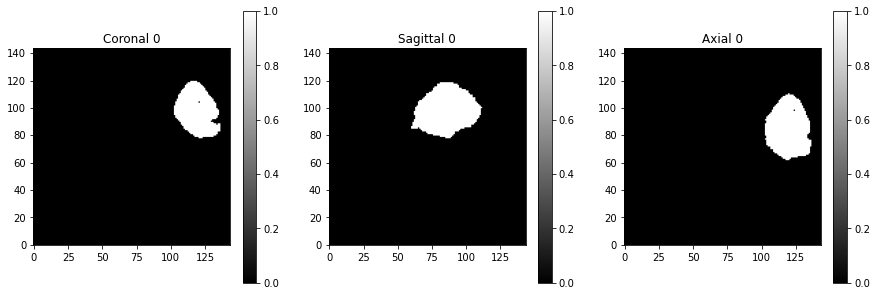

<Figure size 432x288 with 0 Axes>

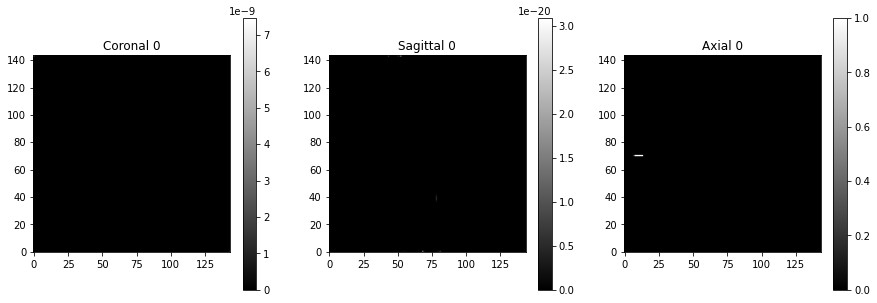

In [547]:
print(datetime.now().isoformat(timespec='minutes'))
cDir = os.path.join(cDS_dir,ptList[pNo])
    
(lbl_nib, imNibDict) = nii_utils.load_patient(cDir)

artDict = {modal: imNibDict[modal].get_fdata().copy() for modal in modalList}

bbox = combine_bboxes_dict(artDict,verbose=False)
lbl = lbl_nib.get_fdata()
cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)

cropOrigDict = {modal : [] for modal in modalList}
modalList = ['flair','t1w','t1gd','t2w']
for mIdx in range(len(modalList)):
    modal= modalList[mIdx]
    print(modal)
    cropModOrig = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
    cropOrigDict[modal] = cropModOrig
cropOrigImg = np.concatenate(list(cropOrigDict.values()),axis=3)

origOutput = np.zeros((144,144,144,1))
for idx in range(cropOrigImg.shape[0]):
    img = tf.expand_dims(cropOrigImg[idx], axis=0)
    origOutput[idx,:,:,:] = model.predict(img)

cutPt = [np.argmax(np.sum(cropLbl,axis=tuple(set([0,1,2])-set([axI])))) for axI in (0,1,2)]

plt.figure()
mri_utils.plot_img_arr(cropOrigImg,cutPt=cutPt)
plt.show()
    
plt.figure()
mri_utils.plot_img_arr(cropLbl,cutPt=cutPt)
plt.show()
plt.figure()
mri_utils.plot_img_arr(origOutput,cutPt=cutPt)
plt.show()

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

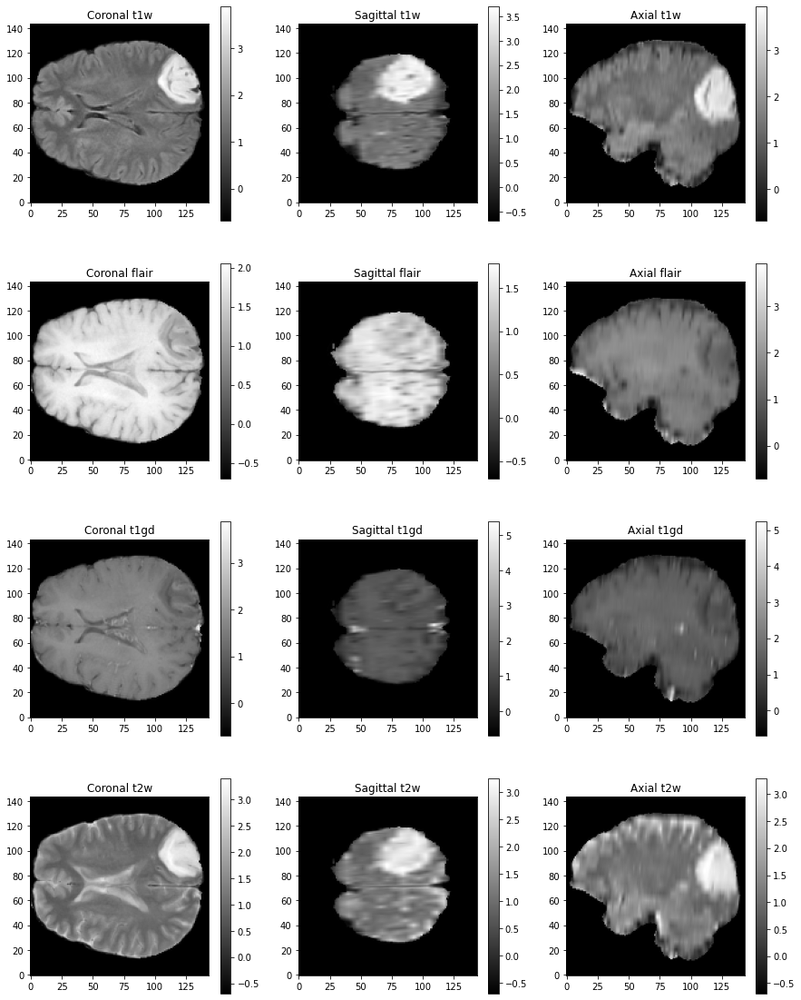

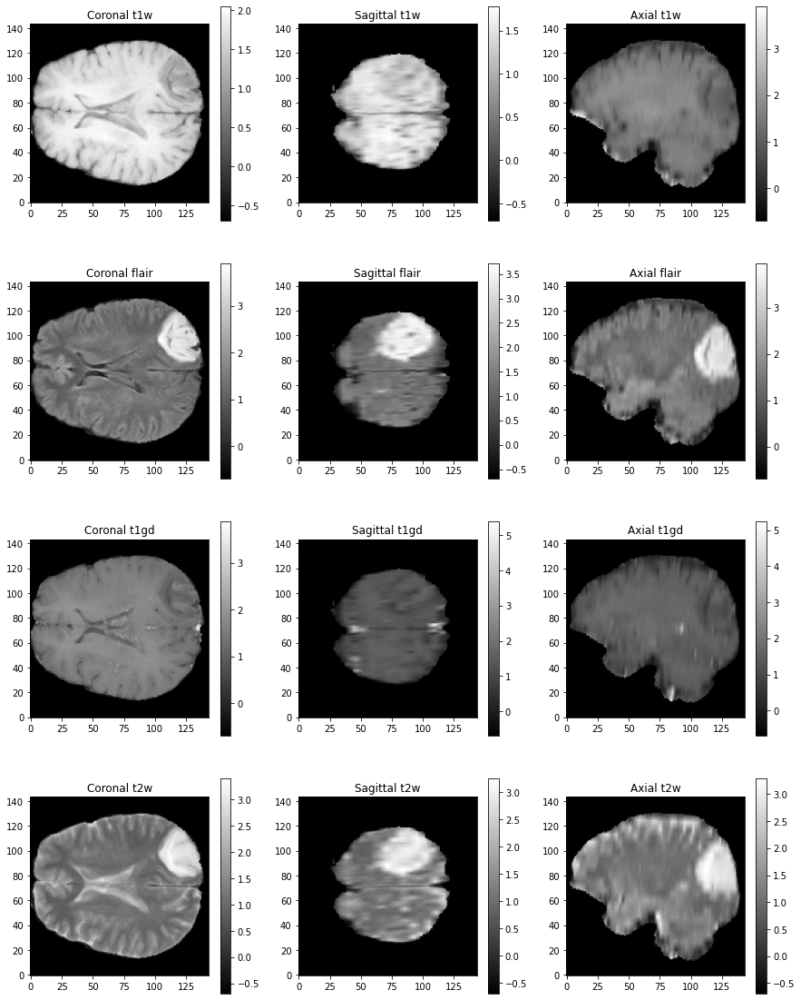

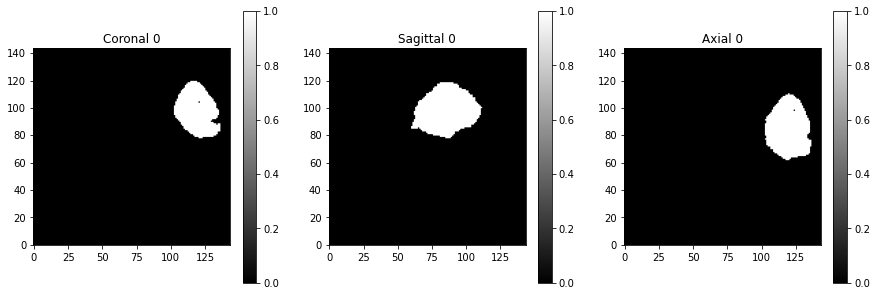

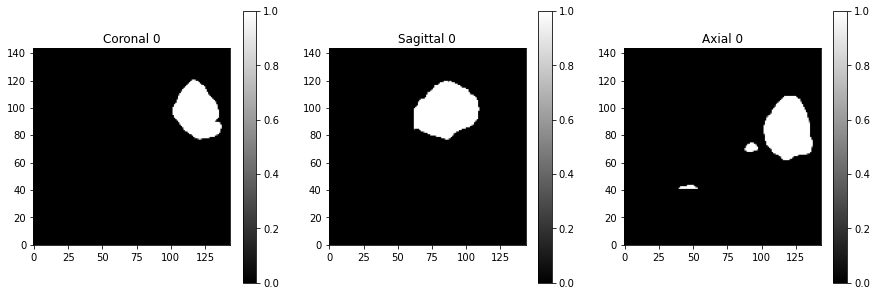

In [546]:
npPath = os.path.join(orig_data_dir,'npy_files','%s_images' % cDS)
origData = np.load(os.path.join(npPath,'%s_image.npy' % TCGA_ID))

cutPt = [np.argmax(np.sum(cropLbl,axis=tuple(set([0,1,2])-set([axI])))) for axI in (0,1,2)]

mri_utils.plot_img_arr(origData,cutPt=cutPt,nameList=modalList)
mri_utils.plot_img_arr(cropOrigImg,cutPt=cutPt,nameList=modalList)
npyOutput = np.zeros((144,144,144,1))

for idx in range(origData.shape[0]):
    img = tf.expand_dims(origData[idx], axis=0)
    npyOutput[idx,:,:,:] = model.predict(img)


mri_utils.plot_img_arr(cropLbl,cutPt=cutPt)

mri_utils.plot_img_arr(npyOutput,cutPt=cutPt)


In [537]:
cutPt = [np.argmax(np.sum(cropLbl,axis=tuple(set([0,1,2])-set([axI])))) for axI in (0,1,2)]
print(cutPt)

[84, 120, 95]


<Figure size 432x288 with 0 Axes>

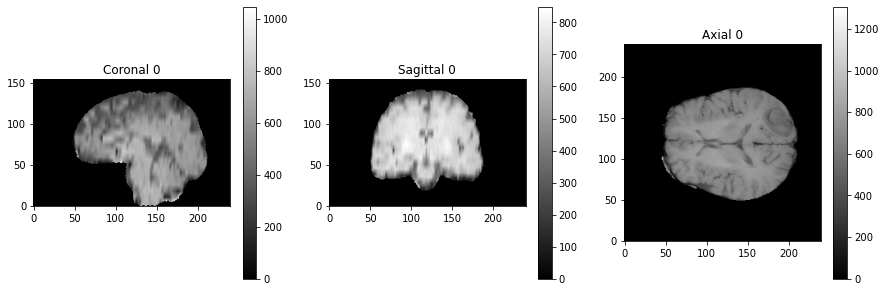

<Figure size 432x288 with 0 Axes>

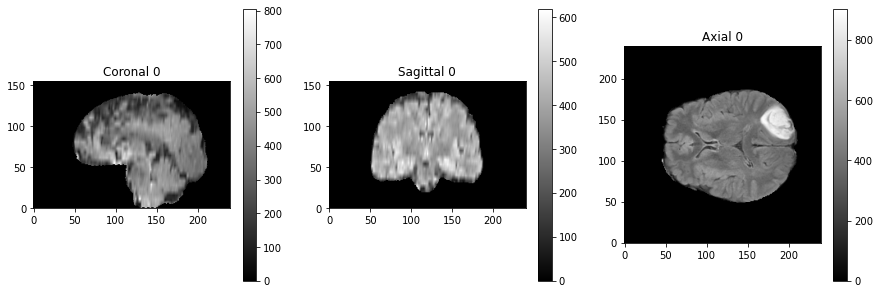

<Figure size 432x288 with 0 Axes>

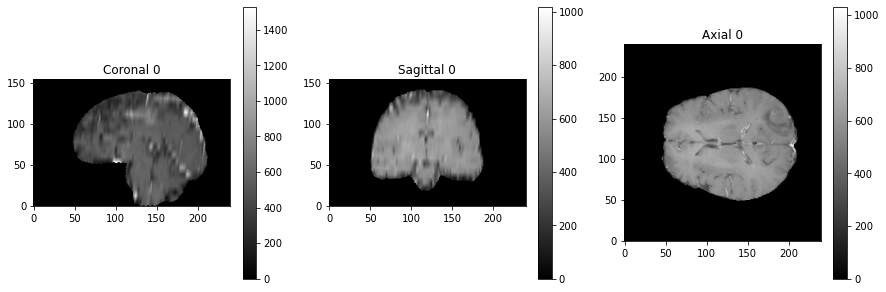

<Figure size 432x288 with 0 Axes>

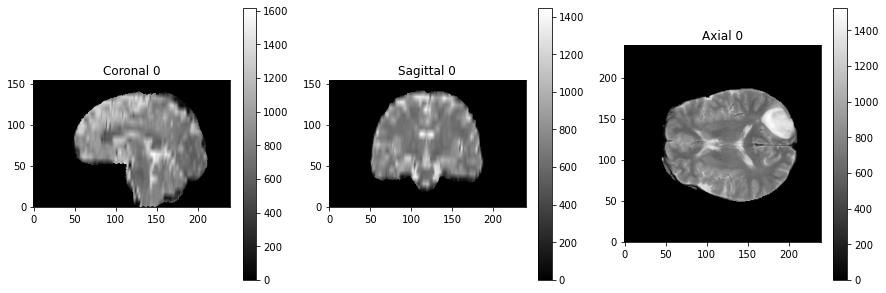

In [522]:
for modal in modalList:

    plt.figure()
    mri_utils.plot_img_arr(imNibDict[modal].get_fdata())
    plt.show()

In [520]:
cDir

'../../GBM_LGG_tradeoffs/data/image_data/LGG_test/TCGA-CS-6667'

# Development: Signal Loss Artifact

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

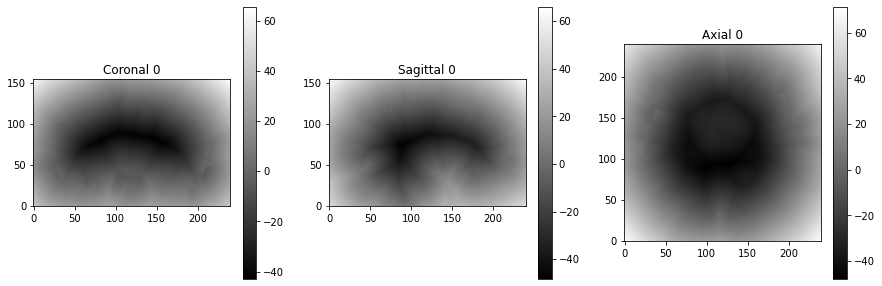

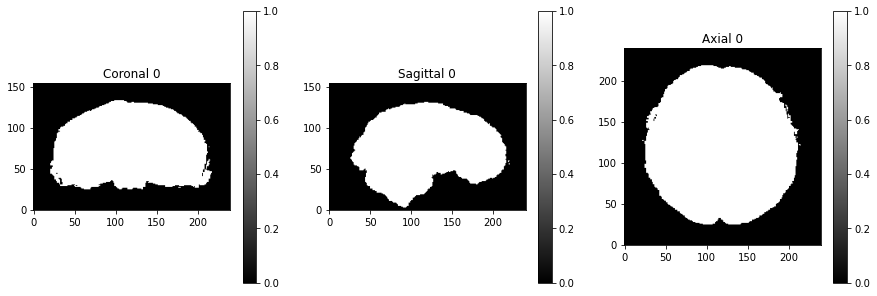

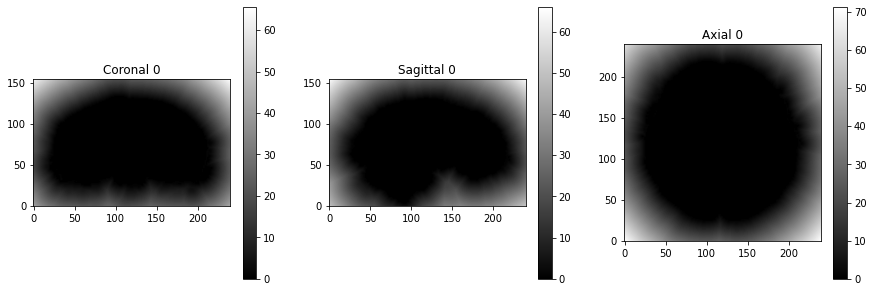

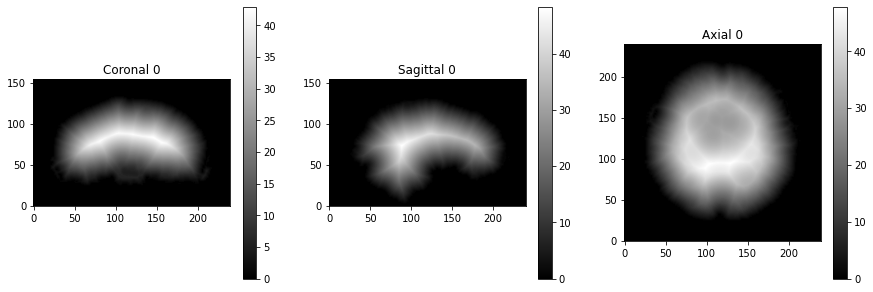

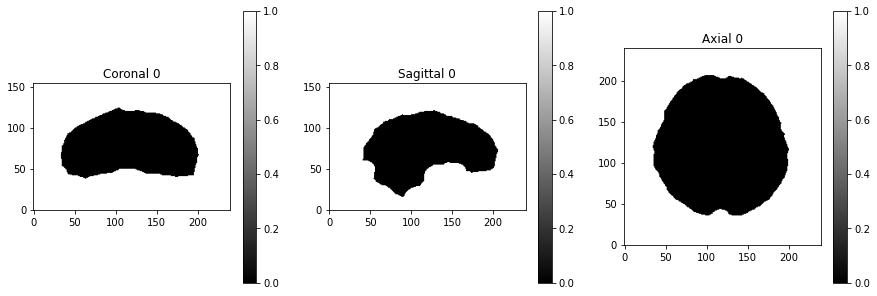

In [149]:
from skimage.morphology import area_closing

tp = np.transpose(transformed,axes = [1,0,2])
inArr = tp
bg = mri_utils.get_min_background(inArr)
if bg is None:
    bg = mri_utils.get_min_background(inArr)
dim = list(bg.shape)
bg = np.reshape(bg,(dim[0],dim[1],dim[2]))
fg = np.logical_not(bg)
fg = area_closing(fg,area_threshold=10) # make sure there's no small pixels inside the brain throwing things off

distMap = distance_transform_edt(bg) - distance_transform_edt(fg)

mri_utils.plot_img_arr(distMap)
mri_utils.plot_img_arr(fg)
mri_utils.plot_img_arr(distance_transform_edt(bg))
mri_utils.plot_img_arr(distance_transform_edt(fg))
mri_utils.plot_img_arr((distMap >0) + (distMap > -10))


# dDiff = (dMax-dMin)/2
# dAvg = (dMax + dMin)/2
# skullReg = np.logical_and(distMap <= dMax,distMap >= dMin)

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

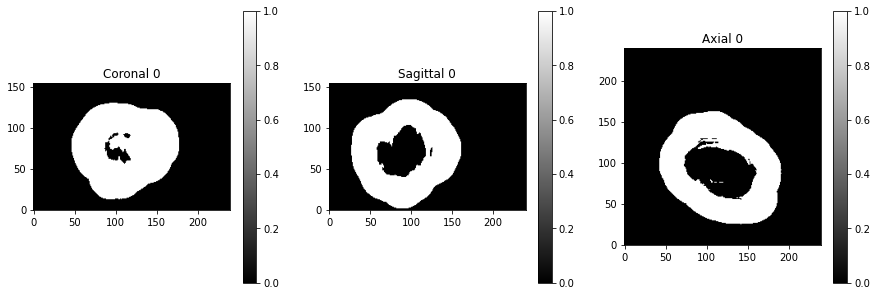

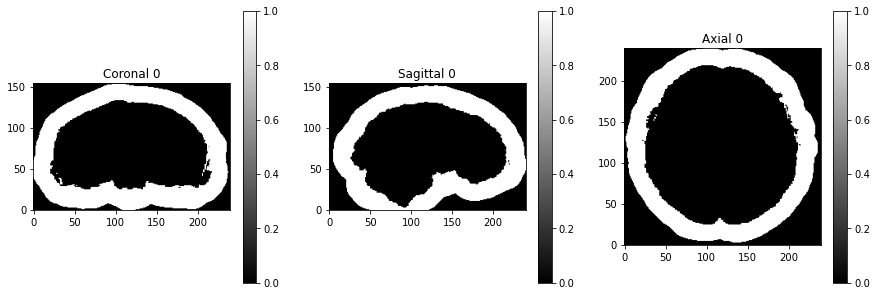

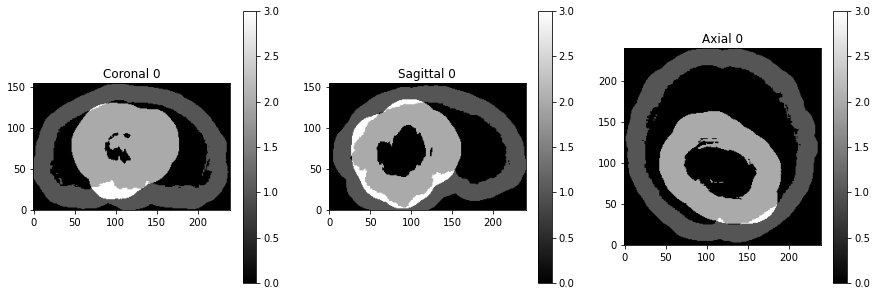

In [150]:
lbl = lbl_nib.get_fdata()
lblDist = get_distance_from_boundary(bg=lbl)
lblDMax = 0
lblDMin = -30
lblReg = np.logical_and((lblDist >= lblDMin),(lblDist <=lblDMax))

outDMax = 20
outDMin = 1
outReg = np.logical_and((distMap >= outDMin),(distMap <=outDMax))
mri_utils.plot_img_arr(lblReg)
mri_utils.plot_img_arr(outReg)
mri_utils.plot_img_arr((lblReg*2) + outReg)

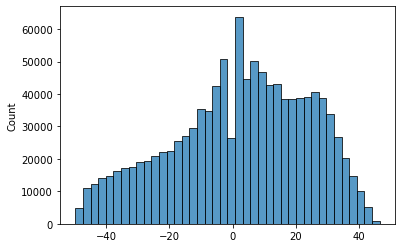

34.07345007480164


(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

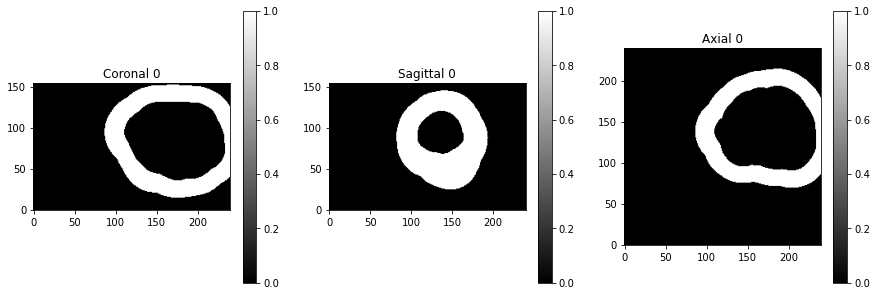

In [485]:
# sns.histplot(distMap[lblDist < 0])
# plt.show()
artDMax = 35
artDMid = 25 
artDDiff = np.abs(artDMax-artDMid)
lblReg = np.logical_and(lblDist <= -artDMid,lblDist >= -artDMid - (2*(artDDiff)))
# temp = distMap.copy()
# temp[np.logical_not(lblReg)] = -artDMid

sns.histplot(distMap[lblReg].flatten(),bins=int(np.abs(np.amin(temp))))
plt.show()
p95Dist = np.percentile(distMap[lblReg],95)
print(p95Dist)
if p95Dist >= artDDiff*2: # if we're too far from the surface of the brain, allow for starts inside
    outDMin = 0
else:
    outDMin = p95Dist - (artDDiff*2)

outDMax = outDMin + (artDDiff*2)
outReg = np.logical_and((distMap >= outDMin),(distMap <=outDMax))

mri_utils.plot_img_arr(lblReg)
# mri_utils.plot_img_arr(temp)

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

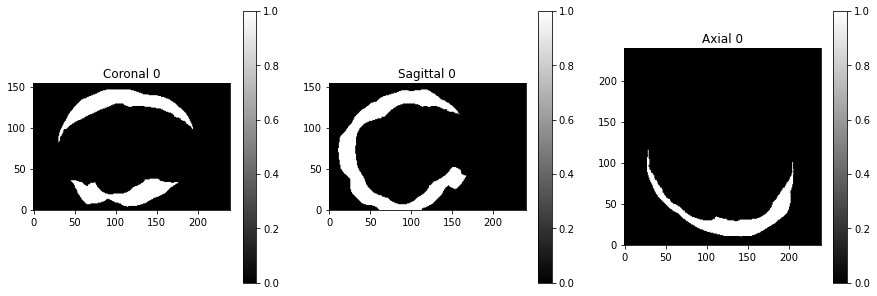

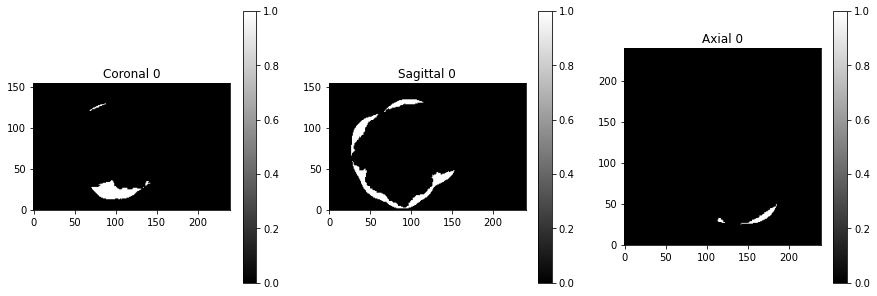

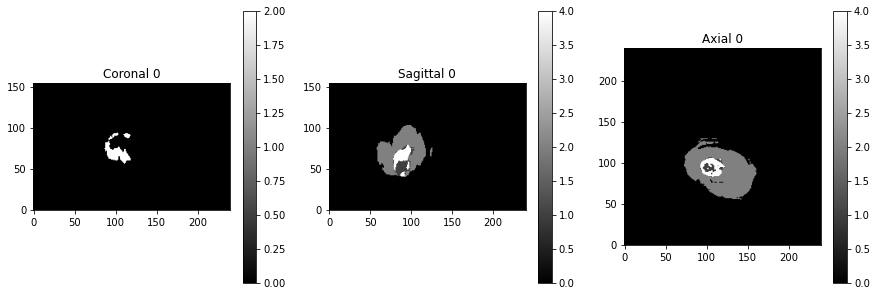

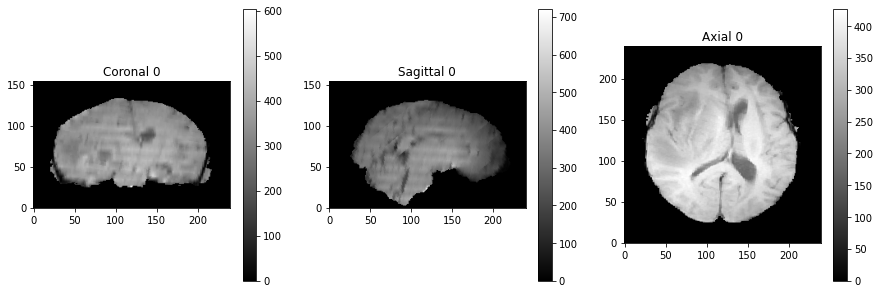

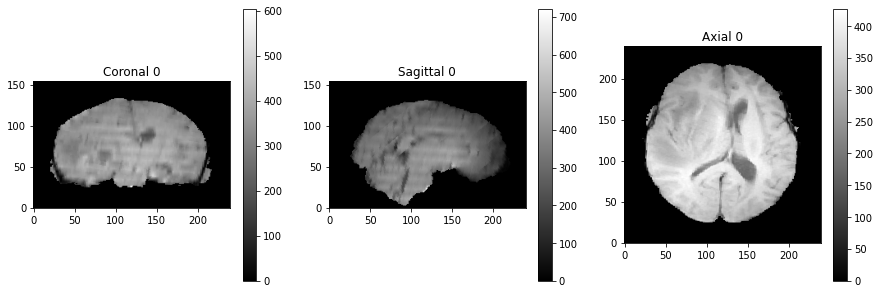

In [153]:
nArts = 1
random_seed = 1
nRAlts = 100
rAltDistAdj = 7.5
artDMax = 35
artDMid = 25 
debugDisp = False

seedLocs = generate_dist_seed_locs(lbl_nib,inArr,random_seed=1)
# create the distance map from the seed location(s)
randBW = np.ones(inArr.shape)
randBW[seedLocs[:,0],seedLocs[:,1],seedLocs[:,2]] = 0
randDistMap = distance_transform_edt(randBW)

artReg = np.logical_and(lblReg,outReg)

mri_utils.plot_img_arr(artReg)
artSubs = np.argwhere(artReg)
# print(artSubs.shape)

minV = np.amin(inArr)
maxV = np.amax(inArr)
artDDiff = np.abs(artDMax-artDMid)



if nRAlts is not None and nRAlts > 0:    
    rAltMin = artDMid - rAltDistAdj
    rAltMax = artDMid + rAltDistAdj

    np.random.seed(random_seed)
    rDistMap2 = randDistMap.copy()
    for multFac in [.5,-.5]: # one pass to add irregularity, one pass to subtract regions
        rAltReg = np.logical_and(rDistMap2>=rAltMin,rDistMap2<=rAltMax)
        rAltSubs = np.argwhere(rAltReg)
        randIdxs = np.random.randint(rAltSubs.shape[0],size=(nRAlts))
        rAltLocs = rAltSubs[randIdxs,:]

        randBW = np.ones(rAltReg.shape)
        randBW[rAltLocs[:,0],rAltLocs[:,1],rAltLocs[:,2]] = 0
        rAltDistMap = distance_transform_edt(randBW)
        rAltDistMap[rAltDistMap > rAltDistAdj] = rAltDistAdj * 2
        rDistMap2 = rDistMap2 - (((rAltDistAdj * 2) - rAltDistMap) * multFac)

        if debugDisp == True:
            temp = rDistMap2.copy()
            temp[rDistMap2> artDMax] = artDMax
            mri_utils.plot_img_arr(temp,cutPt=(rAltLocs[0,:]))
    for idx in range(rDistMap2.shape[2]):
        # smooth the irregularities added
        rDistMap2[:,:,idx] = medfilt2d(rDistMap2[:,:,idx],kernel_size=15)
    randDistMap = rDistMap2

artV = inArr.copy()
artV[randDistMap<=artDMid] = minV
maskReg = np.logical_and(randDistMap>=artDMid,randDistMap<=artDMax)
dVal = (artDMax-randDistMap)/(artDDiff)
artV[maskReg] = ((artV[maskReg]* (1-dVal[maskReg])) + (dVal[maskReg]*(minV)))  
artV[artV>maxV] = maxV
artV[artV<minV] = minV

mri_utils.plot_img_arr(lbl)
mri_utils.plot_img_arr(inArr)
mri_utils.plot_img_arr(artV)


In [ ]:
artV = add_signal_loss_artifact(tp,lblArr=lbl_nib,random_seed=42)

0.0 721.0
0.0 1.0


No handles with labels found to put in legend.
No handles with labels found to put in legend.


(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

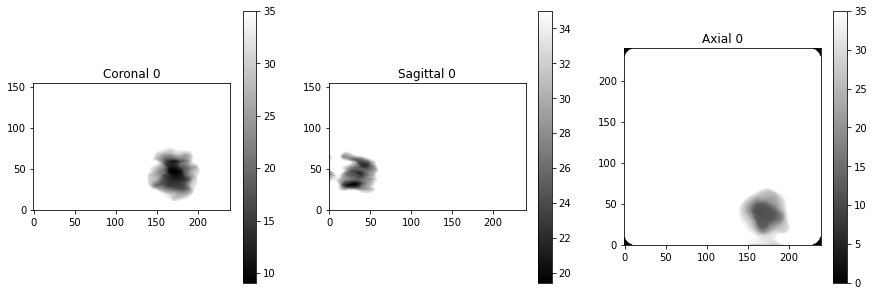

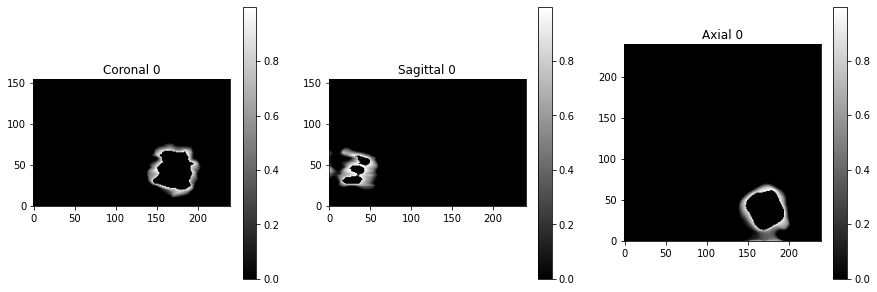

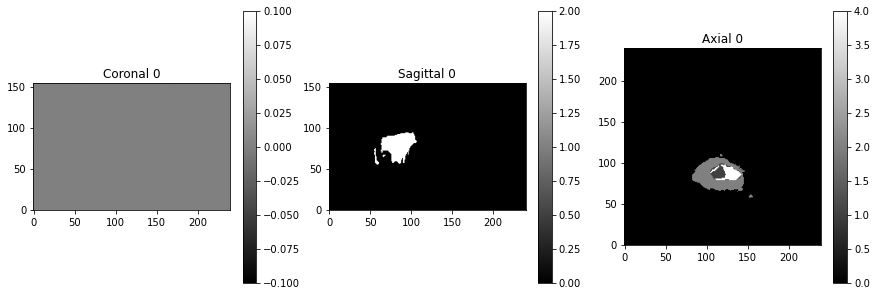

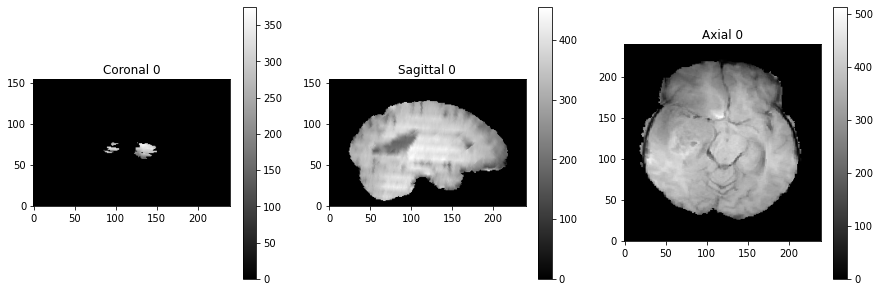

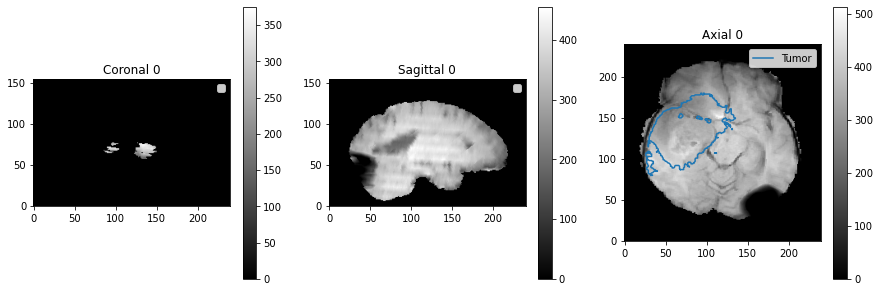

In [157]:
from scipy.signal import medfilt2d
debugDisp = False

rAltDistAdj = 7.5
rAltMin = artDMid - rAltDistAdj
rAltMax = artDMid + rAltDistAdj

nRAlts = 100
random_seed = 1
np.random.seed(random_seed)
rDistMap2 = randDistMap.copy()
for multFac in [.5,-.5]: # one pass to add irregularity, one pass to subtract regions
    rAltReg = np.logical_and(rDistMap2>=rAltMin,rDistMap2<=rAltMax)
    rAltSubs = np.argwhere(rAltReg)
    randIdxs = np.random.randint(rAltSubs.shape[0],size=(nRAlts))
    rAltLocs = rAltSubs[randIdxs,:]

    randBW = np.ones(rAltReg.shape)
    randBW[rAltLocs[:,0],rAltLocs[:,1],rAltLocs[:,2]] = 0
    rAltDistMap = distance_transform_edt(randBW)
    rAltDistMap[rAltDistMap > rAltDistAdj] = rAltDistAdj * 2
    rDistMap2 = rDistMap2 - (((rAltDistAdj * 2) - rAltDistMap) * multFac)
    
    if debugDisp == True:
        temp = rDistMap2.copy()
        temp[rDistMap2> artDMax] = artDMax
        mri_utils.plot_img_arr(temp,cutPt=(rAltLocs[0,:]))
for idx in range(rDistMap2.shape[2]):
    # smooth the irregularities added
    rDistMap2[:,:,idx] = medfilt2d(rDistMap2[:,:,idx],kernel_size=15)
temp = rDistMap2.copy()
temp[rDistMap2> artDMax]= artDMax
mri_utils.plot_img_arr(temp,cutPt=(rAltLocs[0,:]))

artV = tp.copy()
artV[rDistMap2<=artDMid] = minV
maskReg = np.logical_and(rDistMap2>=artDMid,rDistMap2<=artDMax)
dVal = (artDMax-rDistMap2)/(artDMax-artDMid)
artV[maskReg] = ((artV[maskReg]* (1-dVal[maskReg])) + (dVal[maskReg]*(minV)))
print(minV,maxV)
print(np.amin(dVal[maskReg]),np.amax(dVal[maskReg]))
artV[artV>maxV] = maxV
artV[artV<minV] = minV

tp_lbl = np.transpose(tr_label,axes = [1,0,2])
# mri_utils.plot_img_arr(randDistMap>=-artDMid)
mri_utils.plot_img_arr(dVal * maskReg,cutPt=(rAltLocs[0,:]))
# mri_utils.plot_img_arr(maskReg)
mri_utils.plot_img_arr(lbl,cutPt=(rAltLocs[0,:]))
mri_utils.plot_img_arr(tp,cutPt=(rAltLocs[0,:]))
mri_utils.plot_img_arr(artV,cutPt=(rAltLocs[0,:]),ctrArr=tp_lbl,ctrNames=['Tumor'])

# Development: Skull strip failure

In [ ]:
tp = np.transpose(transformed,axes = [1,0,2])
inArr = tp
bg = mri_utils.get_min_background(inArr)
dim = list(bg.shape)

skullDist = get_distance_from_boundary(bg=bg)

seedLocs = generate_dist_seed_locs(tr_label,inArr,random_seed=1,nArts=4,artDMid=10)



In [ ]:

randBW = np.ones(inArr.shape)
randBW[seedLocs[:,0],seedLocs[:,1],seedLocs[:,2]] = 0
randDistMap = distance_transform_edt(randBW)

artV = inArr.copy()
skV = add_fake_skull(inArr.copy())
skMask = inArr != skV
distThresh = np.percentile(randDistMap[skMask],10)
artV[randDistMap<=distThresh] = skV[randDistMap<=distThresh]


mri_utils.plot_img_arr(artV)
mri_utils.plot_img_arr(((randDistMap<=distThresh)*2)+(skMask))

print(np.count_nonzero(randDistMap[skMask]))
print(np.count_nonzero(randDistMap[skMask]<=distThresh))

In [ ]:
add_skull_strip_failure_artifact(inArr,lblArr=tr_label)

In [ ]:
importlib.reload(data_metrics)

# Calculate Metrics

In [ ]:
origImDict = {}
for mIdx in range(len(modalList)):
    modal= modalList[mIdx]
    origMod = nii_utils.preprocess_inputs(imNibDict[modal].get_fdata(),bbox,RSTF=RSTF)
    origImDict[modal] = origMod
origImg = np.concatenate(list(origImDict.values()),axis=3)

In [ ]:
tp = np.transpose(transformed,axes = [1,0,2])
aV = add_fake_skull(tp,dispTF=False)
artV = add_stepwise_rotation_motion_artifact(aV,random_seed=1,dispTF=False)
artV = remove_fake_skull(artV,tp)
artV = np.transpose(artV, axes = [1,0,2])
artVOO = affine.transform_inverse(artV,interpolation = 'nearest')

modalList = ['flair','t1w','t1gd','t2w']
RSTF = True
artDict = {modal: imNibDict[modal].get_fdata() for modal in modalList}
artDict['t1w'] = artVOO
for mIdx in range(len(modalList)):
    modal= modalList[mIdx]
    mri_utils.plot_img_arr(artDict[modal])

bbox = combine_bboxes_dict(artDict)
lbl = lbl_nib.get_fdata()
cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
cropImDict = {modal : [] for modal in modalList}
for mIdx in range(len(modalList)):
    modal= modalList[mIdx]
    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
    cropImDict[modal] = cropMod
cropImg = np.concatenate(list(cropImDict.values()),axis=3)


In [ ]:
output = np.zeros((144,144,144,1))
origOut = np.zeros((144,144,144,1))
for idx in range(cropImg.shape[0]):
    img = tf.expand_dims(cropImg[idx], axis=0)
    output[idx,:,:,:] = model.predict(img)

    orSlice = tf.expand_dims(origImg[idx], axis=0)
    origOut[idx,:,:,:] = model.predict(orSlice)
mri_utils.plot_img_arr(cropImg)
mri_utils.plot_img_arr(output)
mri_utils.plot_img_arr(origOut)
mri_utils.plot_img_arr(cropLbl)

In [ ]:
cModal = 'flair'
cAligned = affine.transform(imNibDict[cModal].get_fdata(),interpolation = 'nearest')
tp = np.transpose(cAligned,axes = [1,0,2])
aV = add_fake_skull(tp,dMax=10,dispTF=False)
artV = add_stepwise_rotation_motion_artifact(aV,random_seed=1,dispTF=False)
artV = remove_fake_skull(artV,tp)
artV = np.transpose(artV, axes = [1,0,2])
artVOO = affine.transform_inverse(artV,interpolation = 'nearest')

modalList = ['flair','t1w','t1gd','t2w']
RSTF = True
artDict = {modal: imNibDict[modal].get_fdata() for modal in modalList}
artDict[cModal] = artVOO
for mIdx in range(len(modalList)):
    modal= modalList[mIdx]
    mri_utils.plot_img_arr(artDict[modal])

bbox = combine_bboxes_dict(artDict)
lbl = lbl_nib.get_fdata()
cropLbl = nii_utils.preprocess_labels(lbl,bbox,RSTF=RSTF)
cropImDict = {modal : [] for modal in modalList}
for mIdx in range(len(modalList)):
    modal= modalList[mIdx]
    cropMod = nii_utils.preprocess_inputs(artDict[modal],bbox,RSTF=RSTF)
    cropImDict[modal] = cropMod
cropImg = np.concatenate(list(cropImDict.values()),axis=3)

output = np.zeros((144,144,144,1))
origOut = np.zeros((144,144,144,1))
for idx in range(cropImg.shape[0]):
    img = tf.expand_dims(cropImg[idx], axis=0)
    output[idx,:,:,:] = model.predict(img)

    orSlice = tf.expand_dims(origImg[idx], axis=0)
    origOut[idx,:,:,:] = model.predict(orSlice)
mri_utils.plot_img_arr(cropImg)
mri_utils.plot_img_arr(output)
mri_utils.plot_img_arr(origOut)
mri_utils.plot_img_arr(cropLbl)

In [ ]:
model.predict(cropImg).shape

In [ ]:
tp = np.transpose(transformed,axes = [2,1,0])

aV = add_rotation_motion_artifact(tp,random_seed=0)

In [ ]:
tp = np.transpose(transformed,axes = [2,1,0])

aV = add_rotation_motion_artifact(tp,random_seed=1,nKL = 3,phRot = 0)

# Try motion artifact with skull

In [ ]:
from scipy.ndimage import distance_transform_edt
# importlib.reload(mri_utils)


tp = np.transpose(transformed,axes = [2,1,0])
bg = mri_utils.get_min_background(tp)
fg = np.logical_not(bg)
mri_utils.plot_img_arr(tp)
mri_utils.plot_img_arr(bg)
distMap = distance_transform_edt(bg)

dMax = 15
dMin = 5
dDiff = (dMax-dMin)/2
dAvg = (dMax + dMin)/2
skullReg = np.logical_and(distMap <= dMax,distMap >= dMin)

# mri_utils.plot_img_arr(np.multiply(distMap,skullReg))
aV = tp.copy()
aV[skullReg] = np.percentile(aV[fg],80)
skullNum = np.maximum(1-np.square((dAvg - distMap)/dDiff),0)*1.2
aV[skullReg] = aV[skullReg] * skullNum[skullReg]
mri_utils.plot_img_arr(aV)
mri_utils.plot_img_arr(np.multiply(skullNum,skullReg))
artV = add_rotation_motion_artifact(aV,random_seed=1)
artV[bg] = tp[bg]
mri_utils.plot_img_arr(artV)

In [ ]:
tp = np.transpose(transformed,axes = [2,1,0])
bg = mri_utils.get_min_background(tp)
fg = np.logical_not(bg)
mri_utils.plot_img_arr(tp)
mri_utils.plot_img_arr(bg)
distMap = distance_transform_edt(bg)

dMax = 15
dMin = 5
dDiff = (dMax-dMin)/2
dAvg = (dMax + dMin)/2
skullReg = np.logical_and(distMap <= dMax,distMap >= dMin)

# mri_utils.plot_img_arr(np.multiply(distMap,skullReg))
aV = tp.copy()
aV[skullReg] = np.percentile(aV[fg],80)
skullNum = np.maximum(1-np.square((dAvg - distMap)/dDiff),0)*1.2
aV[skullReg] = aV[skullReg] * skullNum[skullReg]
mri_utils.plot_img_arr(aV)
# mri_utils.plot_img_arr(np.multiply(skullNum,skullReg))
artV = add_stepwise_rotation_motion_artifact(aV,random_seed=1)
artV[bg] = tp[bg]
mri_utils.plot_img_arr(artV)

In [ ]:
print(type(imDict[modal]))


In [ ]:

import tensorflow as tf
import tensorflow.keras as keras

modalList = ['flair','t1w','t1gd','t2w']

## find images
bboxes  = np.empty((3,2,len(modalList)))
bboxes[:] = np.NaN
modDim  = np.empty((3,len(modalList)))
modDim[:] = np.NaN
imDict = {modal : [] for modal in modalList}
for mIdx in range(len(modalList)):
    modal= modalList[mIdx]
    matchStr = '(.*)%s\.nii(.gz)?$' % (reDict[modal])

    mList = [f for f in fList if re.match(matchStr,f,flags=re.IGNORECASE)]
    if len(mList) == 0:
        warnings.warn('Missing modal: %s, %s' % (modal,cDir))
        return None,None

    if len(mList) > 1:
        warnings.warn('Multiple Matches: %s, %s' % (modal,cDir))
        print(mList)

    data_filename = os.path.join(cDir, mList[0])
    im_nib = nib.load(data_filename)
    img = im_nib.get_fdata()

    imDict[modal] = img
    modDim[:,mIdx] = imDict[modal].shape
    bboxes[:,:,mIdx] = get_bbox(imDict[modal])

# check to see if the skull stripping is the same across the images
if not np.all(np.equal(np.amax(bboxes,axis = 2),np.amin(bboxes,axis = 2))):
    print(cPt)
    print(bboxes)

# check to make sure the images are the same size
if not np.all(np.equal(np.amax(modDim,axis = 1),np.amin(modDim,axis = 1))):
    print(cPt)
    print(modDim)
#     bbox = np.mean(bboxes,axis=2).astype(int)
bbox = np.vstack((np.amin(bboxes[:,0,:],axis=1),np.amin(bboxes[:,1,:],axis=1))).T


In [ ]:
modalList = ['flair','t1w','t1gd','t2w']
imDict = {}
for mIdx in range(len(modalList)):
    modal= modalList[mIdx]
    imDict[modal] = imNibDict[modal].get_fdata()
    mri_utils.plot_img_arr(imDict[modal])

In [ ]:
tp = np.transpose(transformed,axes = [2,1,0])
fftV = np.fft.fftn(tp)
cfftV = np.fft.fftshift(fftV)
mri_utils.plot_img_arr(np.log(np.abs(cfftV)))

dim = cfftT1w.shape
chPt = [round(dim[1]/3),round(dim[2]/3)]
afftV = cfftV.copy()
# kfftV = cfftV.copy()
rfftV = cfftV.copy()


# create a grid in frequency space
# iv = (np.arange(dim[0]) - dim[0]/2) *1.00001
# jv = (np.arange(dim[1]) - dim[1]/2) *1.00001
# kv = (np.arange(dim[2]) - dim[2]/2) *1.00001
iv = np.arange(dim[0]) - dim[0]/2
jv = np.arange(dim[1]) - dim[1]/2
kv = np.arange(dim[2]) - dim[2]/2
# ig, jg ,kg = np.meshgrid(iv, jv, kv, indexing='ij', sparse=True)

cFFTInterp = RegularGridInterpolator((iv, jv, kv), cfftV,fill_value=np.mean(cfftV),
                                     bounds_error=False,method='nearest')

np.random.seed(40)
nKL = 10
nSz = 35

# randPhase = (np.random.rand(nKL) - .5)*0 
phEnc = 0
frEnc = 1
othDim = list(set([0,1,2])-set([phEnc,frEnc]))[0]

# chVec1 = np.random.randint(dim[frEnc],size = (nKL+1,1))
# chVec2 = np.random.randint(dim[othDim],size = (nKL+1,1))

chVec1 = np.random.normal(loc = dim[frEnc]/2, scale = dim[frEnc]/8,size = (nKL+1,1))
chVec1[chVec1<0] = 0
chVec1[chVec1>dim[frEnc]] = dim[frEnc]
chVec1 = chVec1.astype(int)
chVec2 = np.random.normal(loc = dim[othDim]/2, scale = dim[othDim]/8,size = (nKL+1,1))
chVec2[chVec2<0] = 0
chVec2[chVec2>dim[othDim]] = dim[othDim]
chVec2 = chVec2.astype(int)

idxVec = np.hstack((chVec2,chVec1))

sIdxVec = idxVec[np.lexsort(idxVec.T[::-1])] # sort by first column then second column if matched
sIdxVec = sIdxVec[:,[1,0]] # swap so we're actually sorting by other dim, then frequency encoding
print(sIdxVec)
randTheta = (np.random.rand(nKL) - .5)*2 * np.pi/12
randPhi = (np.random.rand(nKL) - .5)*2 * np.pi/48

prevCoords = np.array([0,0])
# prevIdx = 0
rDim = [dim[othDim],dim[frEnc],dim[phEnc]]
afftFlat = np.transpose(afftV,[othDim,frEnc,phEnc]).flatten()

for kIdx in range(nKL):
    pSub = [sIdxVec[kIdx,1],sIdxVec[kIdx,0],dim[phEnc]-1]
    cSub = [sIdxVec[kIdx+1,1],sIdxVec[kIdx+1,0],dim[phEnc]-1]
    
    prevIdx = np.ravel_multi_index(pSub,rDim)
    ravIdx = np.ravel_multi_index(cSub,rDim)
    rVol = rotate_img_vol(tp.copy(),randTheta[kIdx], randPhi[kIdx])
    rfftV = np.fft.fftshift(np.fft.fftn(rVol))
    rfftFlat = np.transpose(rfftV,[othDim,frEnc,phEnc]).flatten()
    afftFlat[prevIdx:ravIdx] = rfftFlat[prevIdx:ravIdx]
    print(cSub,prevIdx,ravIdx)
#     prevIdx = ravIdx

# print(chPt)
afftV = afftFlat.reshape(rDim).transpose([othDim,frEnc,phEnc])
mri_utils.plot_img_arr(np.log(np.abs(afftV)))
# mri_utils.plot_img_arr(np.log(np.abs(kfftV)))
mri_utils.plot_img_arr(np.log(np.abs(rfftV)))


uV = np.abs(np.fft.ifftn(np.fft.ifftshift(cfftV)))
mri_utils.plot_img_arr(uV)

aV = np.abs(np.fft.ifftn(np.fft.ifftshift(afftV)))
mri_utils.plot_img_arr(aV)

mri_utils.plot_img_arr(aV-uV)

In [ ]:
prevCoords = np.array([0,0])
phV = np.arange(dim[phEnc])
frV = np.arange(dim[frEnc])
#     frV = np.arange(prevCoords[0],sIdxVec[kIdx,0])
othV = np.arange(prevCoords[1],sIdxVec[kIdx,1])
phG, frG ,othG  = np.meshgrid(phV, frV, othV, indexing='ij', sparse=True)
print(phV.shape,frV.shape,othG.shape)
print(phG.shape)

In [ ]:
mri_utils.plot_img_arr(tp)
rotImg = rotate_img_vol(tp,15, 0,dg=True)
print(randPhi[kIdx],randTheta[kIdx])
mri_utils.plot_img_arr(rotImg)


In [ ]:
transf_nib = nib.nifti1.Nifti1Image(transformed,template_img.affine,header=moving_img.header)
# rotObj = R.from_euler('xz', [randPhi[kIdx], randTheta[kIdx]], degrees=False)
rotObj = R.from_euler('xz', [45, -20], degrees=True)
mri_utils.plot_img_arr(tp)

offset = [d/2 for d in tp.shape]
tpAff =  np.diag(np.ones(4))
tpAff[0:3,3] = [d/2 for d in tp.shape]
# print(tpAff)
# tpNib = nib.nifti1.Nifti1Image(tp,tpAff)
# pl_anat = plotting.plot_anat(tpNib,cut_coords=(0,0,0))
rotAff = np.zeros((4,4))
rotAff[0:3,0:3] = rotObj.as_matrix()
rotAff[3,3] = 1

tpNegAff =  np.diag(np.ones(4))
tpNegAff[0:3,3] = [-d/2 for d in tp.shape]
# print(rotAff)
print(offset)
print(tpAff,rotAff,tpNegAff)
cmbAff = np.matmul(np.matmul(tpAff,rotAff),tpNegAff)

print(cmbAff)
rotTP = affine_transform(tp,cmbAff,offset=0,mode='nearest')
# mri_utils.plot_img_arr(rotTPNib.get_fdata())

mri_utils.plot_img_arr(rotTP)
# mri_utils.plot_img_arr(rotTP,cutPt=(0,0,0))


In [ ]:
sChVec1 = np.sort(chVec1)
iv = np.arange(dim[phEnc])
jv = np.arange(0:sChVec1[0])
jv = np.arange(0:sChVec1[0])
ig, jg ,kg = np.meshgrid(iv, jv, kv, indexing='ij', sparse=True)